# Notebook 3 - k-means Clustering


> Test for blockquote

<blockquote> Test for blockquote </blockquote>

`test for code hightlight`

```Python
str = "Test for writing code"
print(str)
```

The following work is the main clustering process for the project, including data loading and preparation, log normalization, feature selection through Pearson correlation and dendogram analysis, clustering process, and result visualization. The clustering in k-means including elbow plots. The visual representation of the clustering results including crossplots, KDEs, histograms, and well log plots. Also included testing using another clustering method for discussion purposes, such as GMM.


## Load Libraries


In [6]:
import pandas as pd
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch, PathPatch
from matplotlib.ticker import LogLocator

import math
from math import log, log10, log2, log1p

import seaborn as sns
import plotly.graph_objects as go

from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from scipy.spatial.distance import squareform

from sklearn.preprocessing import StandardScaler, PowerTransformer, MinMaxScaler
from sklearn.cluster import KMeans
from sklearn.metrics import confusion_matrix,classification_report
from sklearn.mixture import GaussianMixture

## Clustering model
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering

## Import well file (CSV format)

Import data from well file (CSV) to a pandas Dataframe called **data**. All datasets used is from an open-sourced geoscience subsurface data from _FORCE 2020 lithofacies prediction from well logs competition_, including well log las files, csv file data, NPD lithostratigraphy, well X-Y positions. The following will use training well data and hidden test data.


In [2]:
#Load data with new stratigraphy
data = pd.read_csv('mergedata.csv', sep=',')

#data = pd.read_csv("cenozoic_mergedata.csv", sep=',')
#data = pd.read_csv("cretaceous_mergedata.csv", sep=',')
#data = pd.read_csv("jurassic_mergedata.csv", sep=',')
#data = pd.read_csv("triassic_mergedata.csv", sep=',')
#data = pd.read_csv("lowertriassic_mergedata.csv", sep=',')

data = data[data.columns[1:]]

#well.head()
#data.dropna(subset=['RXO'])
#data['DEPTH'] = data['DEPTH'].abs()
#data.sample(10)
data.head(10)

C:\Users\V330\AppData\Local\Temp\ipykernel_29972\3064618148.py:2: DtypeWarning: Columns (20,21) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv('mergedata.csv', sep=',')


,WELL,DEPTH_MD,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,...,BS,DTS,DRHO,RMIC,RXO,LITHOLOGY,GROUP,FORMATION,GROUP_NEW,FORMATION_NEW
0,15/9-23,1518.280,15.506232,NaN,NaN,0.878615,NaN,103.451515,NaN,0.439925,...,17.5,326.451263,0.109706,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
1,15/9-23,1518.432,18.524611,NaN,NaN,0.874237,NaN,94.124893,NaN,0.504055,...,17.5,322.926361,-0.006418,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
2,15/9-23,1518.584,18.855669,NaN,NaN,0.869858,NaN,93.586487,NaN,0.512960,...,17.5,325.283142,0.022769,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
3,15/9-23,1518.736,19.163353,NaN,NaN,0.865479,NaN,91.113373,NaN,0.500070,...,17.5,334.233185,0.024972,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
4,15/9-23,1518.888,18.489744,NaN,0.849849,0.863804,NaN,100.228333,NaN,0.277670,...,17.5,330.952362,0.024527,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
5,15/9-23,1519.040,15.919361,NaN,0.929877,0.882300,NaN,97.489906,NaN,0.300810,...,17.5,316.437927,0.019025,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
6,15/9-23,1519.192,13.566401,NaN,0.973370,0.918941,NaN,96.966949,NaN,0.404170,...,17.5,316.381134,-0.008151,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
7,15/9-23,1519.344,12.201807,NaN,1.020846,0.948801,NaN,105.671333,NaN,0.359548,...,17.5,319.537354,-0.029403,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
8,15/9-23,1519.496,12.069018,NaN,1.064951,1.015625,NaN,111.120483,NaN,0.345833,...,17.5,328.520630,-0.051000,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
9,15/9-23,1519.648,12.012268,NaN,1.079303,1.046690,NaN,100.817406,NaN,0.421200,...,17.5,335.690613,-0.084551,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.


In [7]:
# If using old stratigraphy
#data = pd.read_csv('mergedata_old.csv', sep=',')

#data = pd.read_csv("cenozoic_mergedata_old.csv", sep=',')
#data = pd.read_csv("cretaceous_mergedata_old.csv", sep=',')
#data = pd.read_csv("jurassic_mergedata_old.csv", sep=',')
#data = pd.read_csv("triassic_mergedata_old.csv", sep=',')
#data = pd.read_csv("lowertriassic_mergedata_old.csv", sep=',')

data = data[data.columns[1:]]


#well.head()
#data.dropna(subset=['RXO'])
#data['DEPTH'] = data['DEPTH'].abs()
#data.sample(10)
data.head(10)

,WELL,DEPTH_MD,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,...,DTC,SP,BS,DTS,DRHO,RMIC,RXO,LITHOLOGY,GROUP,FORMATION
0,15/9-13,494.528,19.480835,NaN,1.611410,1.798681,1.884186,80.200851,NaN,NaN,...,161.131180,24.612379,NaN,NaN,-0.574928,NaN,NaN,65000,NORDLAND GP.,NaN
1,15/9-13,494.680,19.468800,NaN,1.618070,1.795641,1.889794,79.262886,NaN,NaN,...,160.603470,23.895531,NaN,NaN,-0.570188,NaN,NaN,65000,NORDLAND GP.,NaN
2,15/9-13,494.832,19.468800,NaN,1.626459,1.800733,1.896523,74.821999,NaN,NaN,...,160.173615,23.916357,NaN,NaN,-0.574245,NaN,NaN,65000,NORDLAND GP.,NaN
3,15/9-13,494.984,19.459282,NaN,1.621594,1.801517,1.891913,72.878922,NaN,NaN,...,160.149429,23.793688,NaN,NaN,-0.586315,NaN,NaN,65000,NORDLAND GP.,NaN
4,15/9-13,495.136,19.453100,NaN,1.602679,1.795299,1.880034,71.729141,NaN,NaN,...,160.128342,24.104078,NaN,NaN,-0.597914,NaN,NaN,65000,NORDLAND GP.,NaN
5,15/9-13,495.288,19.453100,NaN,1.585567,1.804719,1.879687,72.014420,NaN,NaN,...,160.149292,23.931278,NaN,NaN,-0.601600,NaN,NaN,65000,NORDLAND GP.,NaN
6,15/9-13,495.440,19.462496,NaN,1.576569,1.805498,1.878731,72.588089,NaN,NaN,...,161.250381,23.381790,NaN,NaN,-0.598369,NaN,NaN,65000,NORDLAND GP.,NaN
7,15/9-13,495.592,19.468800,NaN,1.587011,1.808367,1.867837,71.283051,NaN,NaN,...,162.214416,23.632166,NaN,NaN,-0.602039,NaN,NaN,65000,NORDLAND GP.,NaN
8,15/9-13,495.744,19.468800,NaN,1.613674,1.815813,1.847233,69.721436,NaN,NaN,...,161.575104,22.163542,NaN,NaN,-0.614364,NaN,NaN,65000,NORDLAND GP.,NaN
9,15/9-13,495.896,19.468800,NaN,1.634622,1.813916,1.836309,66.677727,NaN,NaN,...,160.583359,23.659925,NaN,NaN,-0.621813,NaN,NaN,65000,NORDLAND GP.,NaN


In [8]:
#Check statistics of each column
data.describe()

,DEPTH_MD,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,PEF,DTC,SP,BS,DTS,DRHO,RMIC,RXO,LITHOLOGY
count,1.292908e+06,1.201588e+06,656333.000000,1.244098e+06,1.281882e+06,1.122111e+06,1.292908e+06,70492.000000,861969.000000,772131.000000,1.207939e+06,910972.000000,757146.000000,247484.000000,1.100124e+06,191341.000000,336321.000000,1.292908e+06
mean,2.186532e+03,1.315525e+01,11.166054,4.845916e+00,1.192961e+01,2.289057e+00,7.102842e+01,64.983223,0.330318,6.234582,1.129213e+02,58.021485,11.854520,214.492657,1.265874e-02,7.423308,-89.184068,6.159963e+04
std,9.826791e+02,3.744633e+00,104.353080,5.301200e+01,1.124457e+02,2.507290e-01,3.433602e+01,38.282133,0.130079,10.477265,3.000136e+01,76.936308,3.221786,79.708217,7.086049e+00,86.163297,356.119523,1.389616e+04
min,1.360860e+02,2.344000e+00,0.000100,-8.418695e-03,3.170056e-02,7.209712e-01,1.092843e-01,-777.985962,-0.035822,0.099718,7.415132e+00,-999.000000,6.000000,69.163177,-7.429339e+03,0.056586,-999.900024,3.000000e+04
25%,1.436024e+03,9.525089e+00,0.849961,9.087349e-01,9.068642e-01,2.100158e+00,4.777239e+01,43.526122,0.239690,3.442174,8.736515e+01,30.771349,8.500000,156.457260,-8.966100e-03,0.892284,0.685684,6.500000e+04
50%,2.089219e+03,1.253714e+01,1.396211,1.432296e+00,1.433382e+00,2.326371e+00,6.886105e+01,69.425766,0.326417,4.370092,1.090862e+02,54.817402,12.250001,193.038910,2.503228e-03,1.908327,1.362388,6.500000e+04
75%,2.856347e+03,1.632767e+01,3.117024,2.656733e+00,2.585099e+00,2.490143e+00,8.974101e+01,87.695290,0.421328,5.981673,1.404832e+02,82.807846,12.250001,242.942638,2.478218e-02,4.848979,3.378612,6.500000e+04
max,5.436632e+03,2.827900e+01,2193.904541,1.988616e+03,1.999887e+03,3.457820e+00,1.141292e+03,963.608582,0.999570,383.129974,3.204789e+02,526.547302,26.000002,676.578125,2.836938e+00,10000.000000,35930.671875,9.900000e+04


In [9]:
# Filter invalid data 
data.loc[data['RXO'] < 0, 'RXO'] = np.NaN
data.loc[data['RMED'] < 0, 'RMED'] = np.NaN
data.loc[data['SP'] < -998, 'SP'] = np.NaN
data.loc[data['DRHO'] < -999, 'DRHO'] = np.NaN
data.loc[data['SGR'] < 0, 'SGR'] = np.NaN
data.describe()

,DEPTH_MD,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,PEF,DTC,SP,BS,DTS,DRHO,RMIC,RXO,LITHOLOGY
count,1.292908e+06,1.201588e+06,656333.000000,1.244091e+06,1.281882e+06,1.122111e+06,1.292908e+06,70453.000000,861969.000000,772131.000000,1.207939e+06,910570.000000,757146.000000,247484.000000,1.100123e+06,191341.000000,301709.000000,1.292908e+06
mean,2.186532e+03,1.315525e+01,11.166054,4.845943e+00,1.192961e+01,2.289057e+00,7.102842e+01,65.099165,0.330318,6.234582,1.129213e+02,58.488140,11.854520,214.492657,1.941194e-02,7.423308,14.824082,6.159963e+04
std,9.826791e+02,3.744633e+00,104.353080,5.301215e+01,1.124457e+02,2.507290e-01,3.433602e+01,37.727005,0.130079,10.477265,3.000136e+01,73.677170,3.221786,79.708217,2.003621e-01,86.163297,189.336599,1.389616e+04
min,1.360860e+02,2.344000e+00,0.000100,3.990377e-02,3.170056e-02,7.209712e-01,1.092843e-01,0.001417,-0.035822,0.099718,7.415132e+00,-608.786804,6.000000,69.163177,-6.043000e+00,0.056586,0.002298,3.000000e+04
25%,1.436024e+03,9.525089e+00,0.849961,9.087389e-01,9.068642e-01,2.100158e+00,4.777239e+01,43.588337,0.239690,3.442174,8.736515e+01,30.811418,8.500000,156.457260,-8.966062e-03,0.892284,0.861474,6.500000e+04
50%,2.089219e+03,1.253714e+01,1.396211,1.432299e+00,1.433382e+00,2.326371e+00,6.886105e+01,69.453705,0.326417,4.370092,1.090862e+02,54.832355,12.250001,193.038910,2.503231e-03,1.908327,1.563246,6.500000e+04
75%,2.856347e+03,1.632767e+01,3.117024,2.656753e+00,2.585099e+00,2.490143e+00,8.974101e+01,87.701874,0.421328,5.981673,1.404832e+02,82.825874,12.250001,242.942638,2.478237e-02,4.848979,3.972788,6.500000e+04
max,5.436632e+03,2.827900e+01,2193.904541,1.988616e+03,1.999887e+03,3.457820e+00,1.141292e+03,963.608582,0.999570,383.129974,3.204789e+02,526.547302,26.000002,676.578125,2.836938e+00,10000.000000,35930.671875,9.900000e+04


## Columns list

Including renaming them to make it easier to call the column


In [5]:
# If using new stratigraphy
data.rename(columns = {'DEPTH_MD':'DEPTH'}, inplace = True)
data= data[['WELL', 'DEPTH', 'CALI','RSHA','RMED','RDEP','RXO','RMIC','GR','SGR','NPHI','PEF','RHOB','SP','BS','DRHO','DTC','DTS', 'LITHOLOGY', 'GROUP_NEW', 'FORMATION_NEW']]
data.rename(columns = {'FORMATION_NEW':'FORMATION'}, inplace = True)
data.rename(columns = {'GROUP_NEW':'GROUP'}, inplace = True)

data.columns

Index(['WELL', 'DEPTH', 'CALI', 'RSHA', 'RMED', 'RDEP', 'RXO', 'RMIC', 'GR',
       'SGR', 'NPHI', 'PEF', 'RHOB', 'SP', 'BS', 'DRHO', 'DTC', 'DTS',
       'LITHOLOGY', 'GROUP', 'FORMATION'],
      dtype='object')

In [10]:
# If using old stratigraphy
data.rename(columns = {'DEPTH_MD':'DEPTH'}, inplace = True)
data= data[['WELL', 'DEPTH', 'CALI','RSHA','RMED','RDEP','RXO','RMIC','GR','SGR','NPHI','PEF','RHOB','SP','BS','DRHO','DTC','DTS', 'LITHOLOGY', 'GROUP', 'FORMATION']]
data.columns

Index(['WELL', 'DEPTH', 'CALI', 'RSHA', 'RMED', 'RDEP', 'RXO', 'RMIC', 'GR',
       'SGR', 'NPHI', 'PEF', 'RHOB', 'SP', 'BS', 'DRHO', 'DTC', 'DTS',
       'LITHOLOGY', 'GROUP', 'FORMATION'],
      dtype='object')

In [11]:
well = data.copy()
well

,WELL,DEPTH,CALI,RSHA,RMED,RDEP,RXO,RMIC,GR,SGR,...,PEF,RHOB,SP,BS,DRHO,DTC,DTS,LITHOLOGY,GROUP,FORMATION
0,15/9-13,494.5280,19.480835,NaN,1.611410,1.798681,NaN,NaN,80.200851,NaN,...,20.915468,1.884186,24.612379,NaN,-0.574928,161.131180,NaN,65000,NORDLAND GP.,NaN
1,15/9-13,494.6800,19.468800,NaN,1.618070,1.795641,NaN,NaN,79.262886,NaN,...,19.383013,1.889794,23.895531,NaN,-0.570188,160.603470,NaN,65000,NORDLAND GP.,NaN
2,15/9-13,494.8320,19.468800,NaN,1.626459,1.800733,NaN,NaN,74.821999,NaN,...,22.591518,1.896523,23.916357,NaN,-0.574245,160.173615,NaN,65000,NORDLAND GP.,NaN
3,15/9-13,494.9840,19.459282,NaN,1.621594,1.801517,NaN,NaN,72.878922,NaN,...,32.191910,1.891913,23.793688,NaN,-0.586315,160.149429,NaN,65000,NORDLAND GP.,NaN
4,15/9-13,495.1360,19.453100,NaN,1.602679,1.795299,NaN,NaN,71.729141,NaN,...,38.495632,1.880034,24.104078,NaN,-0.597914,160.128342,NaN,65000,NORDLAND GP.,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,35/9-7,2973.2988,8.276272,NaN,2.820439,3.158570,NaN,2.311106,90.720284,NaN,...,NaN,NaN,NaN,8.5,0.502458,75.260658,136.911575,65000,BAAT GP.,Etive Fm.
1292904,35/9-7,2973.4508,8.267273,NaN,3.020778,3.332977,NaN,1.853418,87.062027,NaN,...,NaN,NaN,NaN,8.5,0.374753,74.868301,137.583923,65000,BAAT GP.,Etive Fm.
1292905,35/9-7,2973.6028,8.250099,NaN,2.795711,3.044179,NaN,1.325961,86.115921,NaN,...,NaN,NaN,NaN,8.5,0.211487,74.848122,138.310898,65000,BAAT GP.,Etive Fm.
1292906,35/9-7,2973.7548,NaN,NaN,2.658694,2.847681,NaN,1.260347,89.497131,NaN,...,NaN,NaN,NaN,8.5,0.147950,74.964027,137.592819,65000,BAAT GP.,Etive Fm.


## Wells List


In [12]:
well_name=data['WELL'].unique()
print(len(well_name))
well_name

108


array(['15/9-13', '15/9-15', '15/9-17', '16/1-2', '16/1-6 A', '16/10-1',
       '16/10-2', '16/10-3', '16/10-5', '16/11-1 ST3', '16/2-11 A',
       '16/2-16', '16/2-6', '16/4-1', '16/5-3', '16/7-4', '16/7-5',
       '16/8-1', '17/11-1', '25/11-15', '25/11-19 S', '25/11-5',
       '25/2-13 T4', '25/2-14', '25/2-7', '25/3-1', '25/4-5', '25/5-1',
       '25/5-4', '25/6-1', '25/6-2', '25/6-3', '25/7-2', '25/8-5 S',
       '25/8-7', '25/9-1', '26/4-1', '29/6-1', '30/3-3', '30/3-5 S',
       '30/6-5', '31/2-1', '31/2-19 S', '31/2-7', '31/2-8', '31/2-9',
       '31/3-1', '31/3-2', '31/3-3', '31/3-4', '31/4-10', '31/4-5',
       '31/5-4 S', '31/6-5', '31/6-8', '32/2-1', '33/5-2', '33/6-3 S',
       '33/9-1', '33/9-17', '34/10-19', '34/10-21', '34/10-33',
       '34/10-35', '34/11-1', '34/11-2 S', '34/12-1', '34/2-4',
       '34/3-1 A', '34/4-10 R', '34/5-1 A', '34/5-1 S', '34/7-13',
       '34/7-20', '34/7-21', '34/8-1', '34/8-3', '34/8-7 R', '35/11-1',
       '35/11-10', '35/11-11', '35/11-12

## Groupby lithology


In [13]:
well['LIT'] = well.loc[:, 'LITHOLOGY']
well['LIT'].isnull()
well.replace({'LIT': {30000: 'Sandstone', 
                      65030: 'Sandy Shale', 
                      65000:'Shale', 
                      80000:'Marl', 
                      74000:'Dolomite', 
                      70000:'Limestone', 
                      70032:'Chalk', 
                      88000:'Halite', 
                      86000:'Anhydrite', 
                      99000:'Volcaniclastics', 
                      90000:'Coal', 
                      93000:'Basement'}}, inplace=True)
well['LIT']=well['LIT'].astype('category')

well['LITCOLOR'] = well.loc[:, 'LITHOLOGY']
well['LITCOLOR'].isnull()
well.replace({'LITCOLOR': {30000: '#ffff00', 
                      65030: '#ffe119', 
                      65000:'#bebebe', 
                      80000:'#7cfc00', 
                      74000:'#8080ff', 
                      70000:'#80ffff', 
                      70032:'#80ffff', 
                      88000:'#7ddfbe', 
                      86000:'#ff80ff', 
                      99000:'#ff8c00', 
                      90000:'black', 
                      93000:'#ef138a'}}, inplace=True)
well['LITCOLOR']=well['LITCOLOR'].astype('category')

litoname = list(set(well['LIT']))
litocolor = {'Sandstone': '#ffff00', 
             'Sandy Shale': '#c1f80a', 
             'Shale': '#bebebe', 
             'Marl': '#069af3', 
             'Dolomite': '#8080ff', 
             'Limestone': '#80ffff', 
             'Chalk': '#7bc8f6', 
             'Halite': '#7ddfbe', 
             'Anhydrite': '#ff80ff', 
             'Volcaniclastics': '#ff8c00', 
             'Coal': 'black', 
             'Basement': '#ef138a'}



In [14]:
grouped = well.groupby('LIT', sort=False)

keys = [key for key, _ in grouped] #groupby based on unique keys or categories (1)
keys #show groupby keys or categories
#grouped.groups.keys() #groupby based on unique keys or categories (1)
#grouped.apply(display) #show groupby data

C:\Users\V330\AppData\Local\Temp\ipykernel_1728\856599071.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = well.groupby('LIT', sort=False)


['Shale',
 'Sandstone',
 'Sandy Shale',
 'Limestone',
 'Volcaniclastics',
 'Marl',
 'Anhydrite',
 'Dolomite',
 'Chalk',
 'Coal',
 'Halite',
 'Basement']

## Log normalization


In [15]:
#Using log normalized
well_log = well.copy()
well_log['GR_log2'] = well_log['GR'].apply(lambda x: log2(x))
well_log['GR_log10'] = well_log['GR'].apply(lambda x: log10(x))
well_log['GR_log1p'] = well_log['GR'].apply(lambda x: log1p(x))
well_log['GR_logn'] = well_log['GR'].apply(lambda x: log(x))


In [16]:
#Using sklearn preprocessing

ss = StandardScaler()
well_log['GR_SS'] = ss.fit_transform(well_log[['GR']])

pt_yj = PowerTransformer(method='yeo-johnson', standardize=False)
well_log['GR_PTYJ'] = pt_yj.fit_transform(well_log[['GR']])

pt_bc = PowerTransformer(method='box-cox', standardize=False)
well_log['GR_PTBC'] = pt_bc.fit_transform(well_log[['GR']])

mms = MinMaxScaler()
well_log['GR_MMS'] = mms.fit_transform(well_log[['GR']])



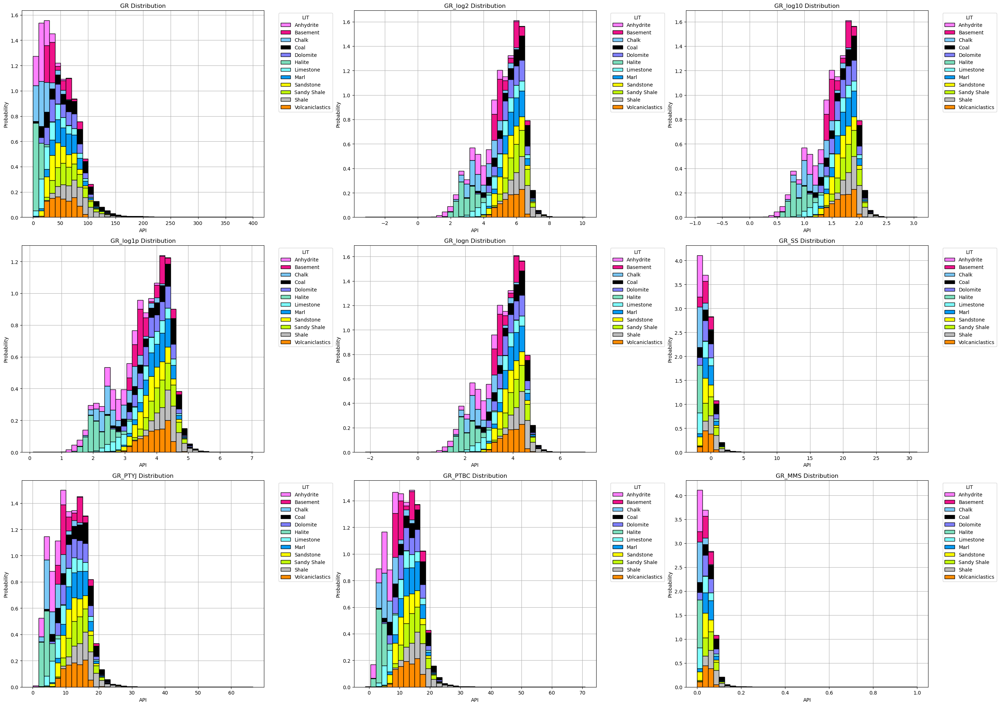

In [12]:
gr_curves=['GR', 'GR_log2', 'GR_log10', 'GR_log1p','GR_logn', 'GR_SS', 'GR_PTYJ', 'GR_PTBC', 'GR_MMS']
fig = plt.figure(figsize=(28,20))

for i, feature in enumerate(gr_curves):
    ax=fig.add_subplot(3,3,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    fig.suptitle('')
    
    #ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, binrange=(0,10),fill=True, log_scale=False, palette=litocolor, common_norm=False)
    #ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
    #ax.set_xscale("linear")
    #ax.set_xscale("log")
    #ax.set_xlabel('API')
    
    if i==0:
        #well_log.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, binrange=(0,400), fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('API')
    
    else:
        #well_log.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        #ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(800)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        #ax.set_xscale("log")
        ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('API')
    
    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()
#plt.subplots_adjust(top=0.95)
plt.subplots_adjust(hspace=0.15, wspace=0.5)

plt.tight_layout()
plt.savefig('grlognormalization_mergedata_new.png', bbox_inches='tight')
plt.show()

In [19]:
well_log10 = well.copy()
well_log10['RSHA_log10'] = well_log10['RSHA'].apply(lambda x: log10(x))
well_log10['RMED_log10'] = well_log10['RMED'].apply(lambda x: log10(x))
well_log10['RDEP_log10'] = well_log10['RDEP'].apply(lambda x: log10(x))
well_log10['RXO_log10'] = well_log10['RXO'].apply(lambda x: log10(x))
well_log10['RMIC_log10'] = well_log10['RMIC'].apply(lambda x: log10(x))
well_log10['GR_log10'] = well_log10['GR'].apply(lambda x: log10(x))
well_log10['SGR_log10'] = well_log10['SGR'].apply(lambda x: log10(x))
well_log10['PEF_log10'] = well_log10['PEF'].apply(lambda x: log10(x))
#well_log10.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)

In [17]:
well_logn = well.copy()
well_logn['RSHA_logn'] = well_logn['RSHA'].apply(lambda x: log(x))
well_logn['RMED_logn'] = well_logn['RMED'].apply(lambda x: log(x))
well_logn['RDEP_logn'] = well_logn['RDEP'].apply(lambda x: log(x))
well_logn['RXO_logn'] = well_logn['RXO'].apply(lambda x: log(x))
well_logn['RMIC_logn'] = well_logn['RMIC'].apply(lambda x: log(x))
well_logn['GR_logn'] = well_logn['GR'].apply(lambda x: log(x))
well_logn['SGR_logn'] = well_logn['SGR'].apply(lambda x: log(x))
well_logn['PEF_logn'] = well_logn['PEF'].apply(lambda x: log(x))
#well_logn.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)


In [18]:
well_logPTYJ = well.copy()
well_logPTYJ['RSHA_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RSHA']])
well_logPTYJ['RMED_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RMED']])
well_logPTYJ['RDEP_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RDEP']])
well_logPTYJ['RXO_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RXO']])
well_logPTYJ['RMIC_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RMIC']])
well_logPTYJ['GR_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['GR']])
well_logPTYJ['SGR_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['SGR']])
well_logPTYJ['PEF_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['PEF']])
#well_logPTYJ.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)

In [22]:
well_log['GR_PTBC'] = pt_bc.fit_transform(well_log[['GR']])

well_logPTBC = well.copy()
well_logPTBC['RSHA_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RSHA']])
well_logPTBC['RMED_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RMED']])
well_logPTBC['RDEP_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RDEP']])
well_logPTBC['RXO_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RXO']])
well_logPTBC['RMIC_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RMIC']])
well_logPTBC['GR_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['GR']])
well_logPTBC['SGR_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['SGR']])
well_logPTBC['PEF_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['PEF']])
#well_logPTBC.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)

## Well log Correlation (Pearson)


### Linear correlation


In [15]:
#Histogram on each specific column for more detail
well_corr = well.copy()
well_corr.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corr

,RSHA,RMED,RDEP,RXO,RMIC,GR,SGR,NPHI,PEF,RHOB,SP,DTC,DTS
0,NaN,1.611410,1.798681,NaN,NaN,80.200851,NaN,NaN,20.915468,1.884186,24.612379,161.131180,NaN
1,NaN,1.618070,1.795641,NaN,NaN,79.262886,NaN,NaN,19.383013,1.889794,23.895531,160.603470,NaN
2,NaN,1.626459,1.800733,NaN,NaN,74.821999,NaN,NaN,22.591518,1.896523,23.916357,160.173615,NaN
3,NaN,1.621594,1.801517,NaN,NaN,72.878922,NaN,NaN,32.191910,1.891913,23.793688,160.149429,NaN
4,NaN,1.602679,1.795299,NaN,NaN,71.729141,NaN,NaN,38.495632,1.880034,24.104078,160.128342,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,NaN,2.820439,3.158570,NaN,2.311106,90.720284,NaN,NaN,NaN,NaN,NaN,75.260658,136.911575
1292904,NaN,3.020778,3.332977,NaN,1.853418,87.062027,NaN,NaN,NaN,NaN,NaN,74.868301,137.583923
1292905,NaN,2.795711,3.044179,NaN,1.325961,86.115921,NaN,NaN,NaN,NaN,NaN,74.848122,138.310898
1292906,NaN,2.658694,2.847681,NaN,1.260347,89.497131,NaN,NaN,NaN,NaN,NaN,74.964027,137.592819


In [16]:
correlate = well_corr.corr(method = 'pearson')
correlate

,RSHA,RMED,RDEP,RXO,RMIC,GR,SGR,NPHI,PEF,RHOB,SP,DTC,DTS
RSHA,1.000000,0.160279,0.279110,0.386561,0.155407,-0.078461,-0.014238,-0.155101,-0.011509,0.071752,-0.027991,-0.133226,-0.104817
RMED,0.160279,1.000000,0.172936,0.077398,0.049032,-0.017747,0.010892,-0.050281,0.052361,-0.003718,-0.019755,-0.095783,-0.107865
RDEP,0.279110,0.172936,1.000000,0.146951,0.046494,-0.123036,-0.004638,-0.174234,-0.005508,-0.037563,-0.020157,-0.124172,-0.093584
RXO,0.386561,0.077398,0.146951,1.000000,0.333932,-0.042365,-0.016084,-0.090945,0.008471,0.041208,0.014768,-0.076327,-0.184158
RMIC,0.155407,0.049032,0.046494,0.333932,1.000000,-0.019807,-0.066772,-0.043278,-0.021177,0.056940,0.017231,-0.059283,-0.145858
GR,-0.078461,-0.017747,-0.123036,-0.042365,-0.019807,1.000000,0.585147,0.237103,-0.077988,0.151656,0.093000,0.052191,0.116663
SGR,-0.014238,0.010892,-0.004638,-0.016084,-0.066772,0.585147,1.000000,0.178179,0.063748,0.018022,0.123715,0.118693,0.168189
NPHI,-0.155101,-0.050281,-0.174234,-0.090945,-0.043278,0.237103,0.178179,1.000000,0.022193,-0.632356,-0.124492,0.792142,0.750116
PEF,-0.011509,0.052361,-0.005508,0.008471,-0.021177,-0.077988,0.063748,0.022193,1.000000,-0.099220,-0.003342,0.022905,-0.016490
RHOB,0.071752,-0.003718,-0.037563,0.041208,0.056940,0.151656,0.018022,-0.632356,-0.099220,1.000000,0.076907,-0.818009,-0.717091


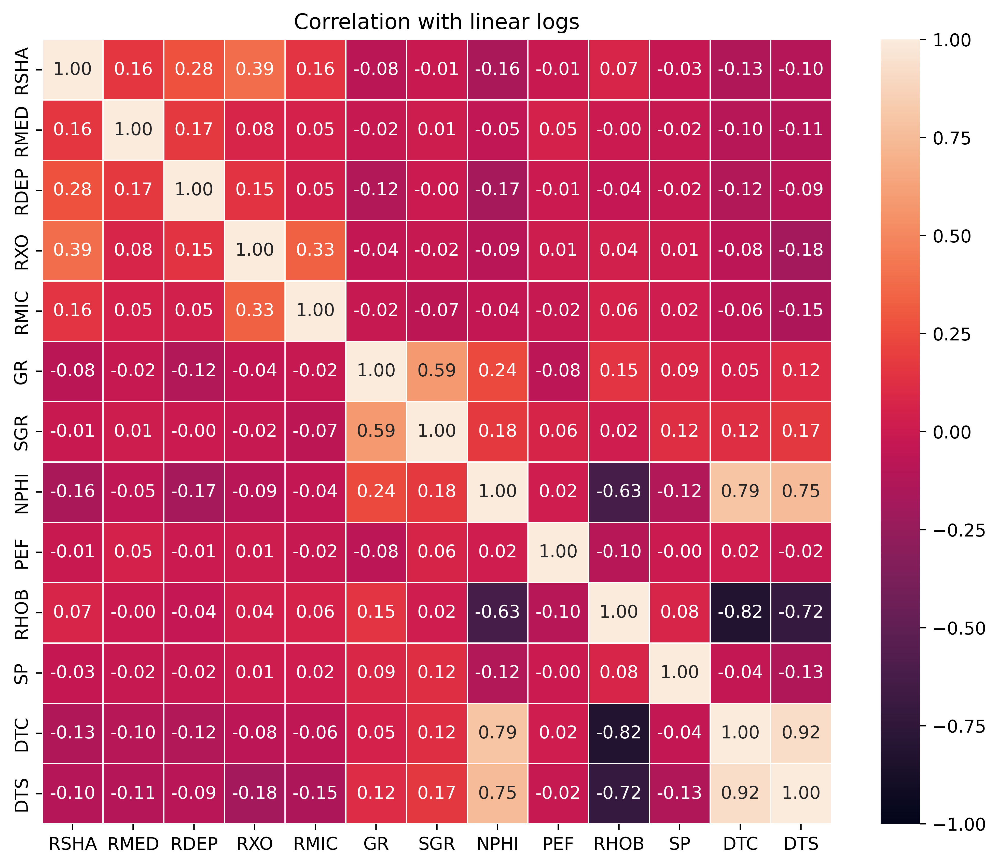

In [17]:
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with linear logs")
plt.savefig('pearsonlinear_mergedata_old.png', bbox_inches='tight')
plt.show()

### Log-lin correlation (with log10)


In [24]:
#Histogram on each specific column for more detail
well_corr10 = well_log10.copy()
well_corr10.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)
well_corr10.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corr10

,NPHI,RHOB,SP,DTC,DTS,RSHA_log10,RMED_log10,RDEP_log10,RXO_log10,RMIC_log10,GR_log10,SGR_log10,PEF_log10
0,NaN,1.884186,24.612379,161.131180,NaN,NaN,0.207206,0.254954,NaN,NaN,1.904179,NaN,1.320468
1,NaN,1.889794,23.895531,160.603470,NaN,NaN,0.208997,0.254220,NaN,NaN,1.899070,NaN,1.287421
2,NaN,1.896523,23.916357,160.173615,NaN,NaN,0.211243,0.255449,NaN,NaN,1.874029,NaN,1.353945
3,NaN,1.891913,23.793688,160.149429,NaN,NaN,0.209942,0.255638,NaN,NaN,1.862602,NaN,1.507747
4,NaN,1.880034,24.104078,160.128342,NaN,NaN,0.204847,0.254137,NaN,NaN,1.855696,NaN,1.585411
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,NaN,NaN,NaN,75.260658,136.911575,NaN,0.450317,0.499491,NaN,0.363820,1.957704,NaN,NaN
1292904,NaN,NaN,NaN,74.868301,137.583923,NaN,0.480119,0.522832,NaN,0.267973,1.939829,NaN,NaN
1292905,NaN,NaN,NaN,74.848122,138.310898,NaN,0.446492,0.483470,NaN,0.122531,1.935083,NaN,NaN
1292906,NaN,NaN,NaN,74.964027,137.592819,NaN,0.424668,0.454491,NaN,0.100490,1.951809,NaN,NaN


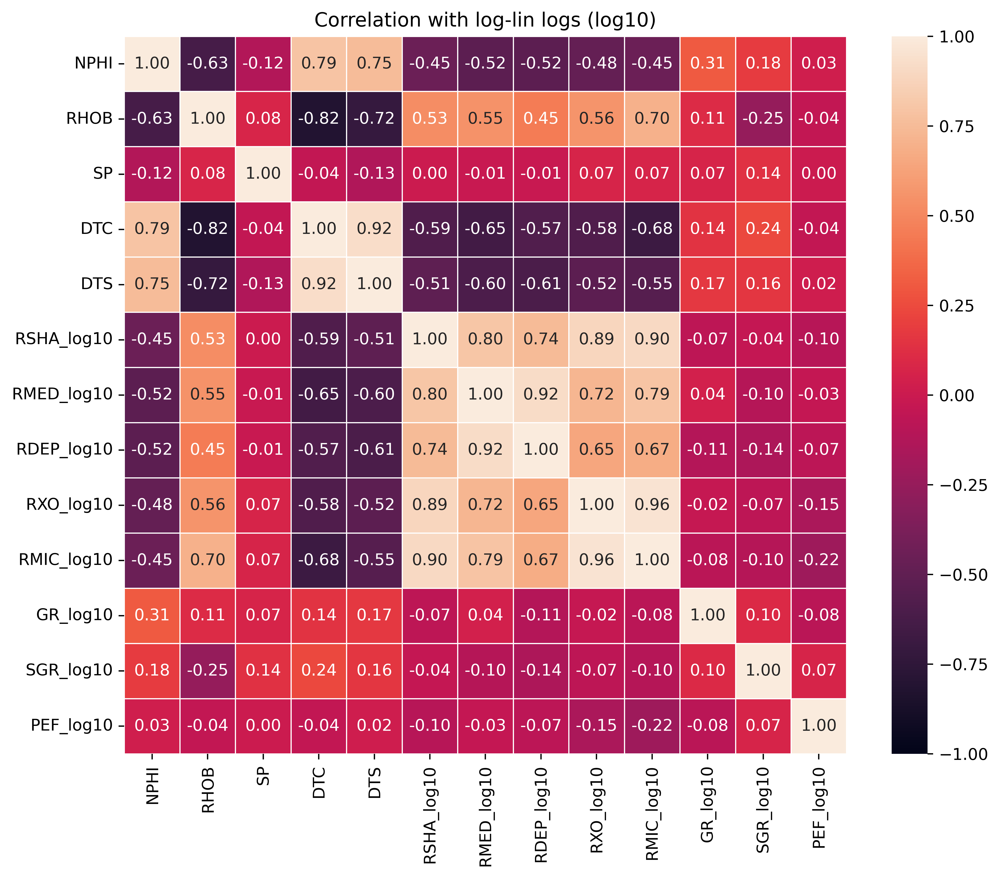

In [25]:
correlate_log10 = well_corr10.corr(method = 'pearson')
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_log10,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with log-lin logs (log10)")
plt.savefig('pearsonloglin_log10_mergedata_old.png', bbox_inches='tight')
plt.show()

### Log-lin correlation (with logn)


In [26]:
#Histogram on each specific column for more detail
well_corrn = well_logn.copy()
well_corrn.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)
well_corrn.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corrn

,NPHI,RHOB,SP,DTC,DTS,RSHA_logn,RMED_logn,RDEP_logn,RXO_logn,RMIC_logn,GR_logn,SGR_logn,PEF_logn
0,NaN,1.884186,24.612379,161.131180,NaN,NaN,0.477109,0.587054,NaN,NaN,4.384534,NaN,3.040489
1,NaN,1.889794,23.895531,160.603470,NaN,NaN,0.481234,0.585362,NaN,NaN,4.372770,NaN,2.964397
2,NaN,1.896523,23.916357,160.173615,NaN,NaN,0.486405,0.588194,NaN,NaN,4.315112,NaN,3.117575
3,NaN,1.891913,23.793688,160.149429,NaN,NaN,0.483410,0.588629,NaN,NaN,4.288799,NaN,3.471715
4,NaN,1.880034,24.104078,160.128342,NaN,NaN,0.471677,0.585172,NaN,NaN,4.272897,NaN,3.650545
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,NaN,NaN,NaN,75.260658,136.911575,NaN,1.036893,1.150119,NaN,0.837726,4.507781,NaN,NaN
1292904,NaN,NaN,NaN,74.868301,137.583923,NaN,1.105514,1.203866,NaN,0.617032,4.466621,NaN,NaN
1292905,NaN,NaN,NaN,74.848122,138.310898,NaN,1.028086,1.113231,NaN,0.282138,4.455694,NaN,NaN
1292906,NaN,NaN,NaN,74.964027,137.592819,NaN,0.977835,1.046505,NaN,0.231387,4.494207,NaN,NaN


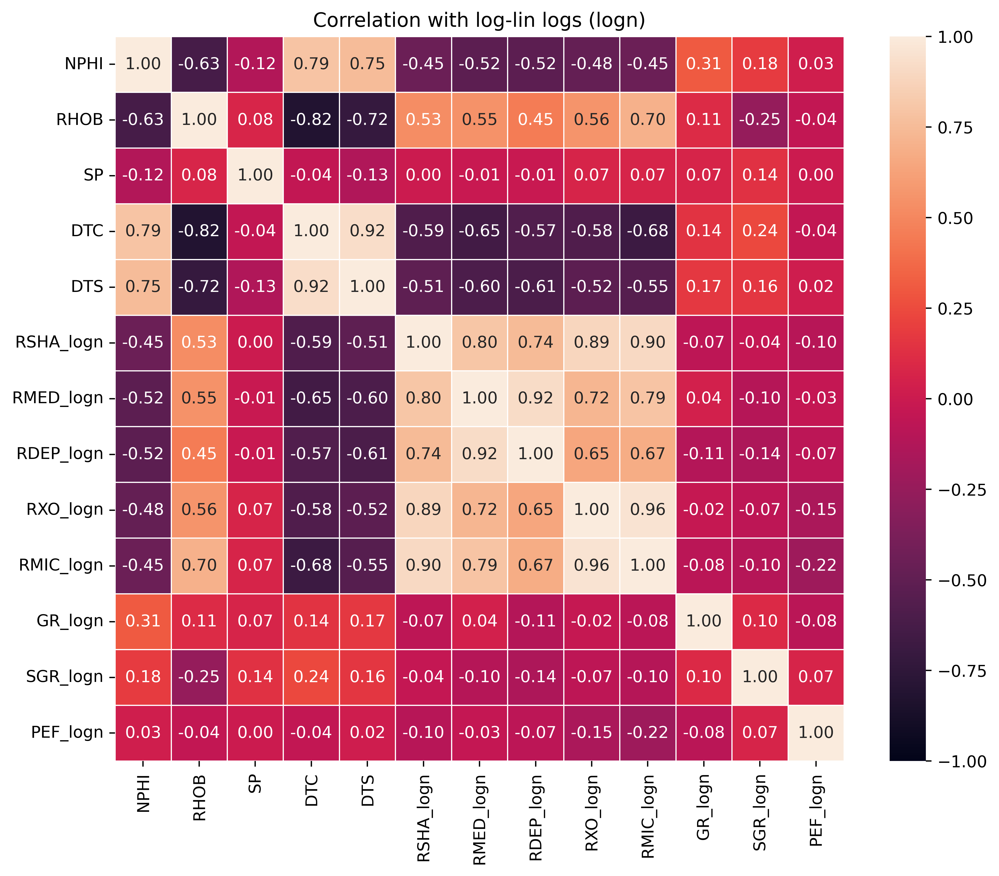

In [27]:
correlate_logn = well_corrn.corr(method = 'pearson')
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_logn,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with log-lin logs (logn)")
plt.savefig('pearsonloglin_logn_mergedata_old.png', bbox_inches='tight')
plt.show()

### Log-lin correlation (with PowerTransform yeo-johnson)


In [28]:
#Histogram on each specific column for more detail
well_corrptyj = well_logPTYJ.copy()
well_corrptyj.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)
well_corrptyj.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corrptyj

,NPHI,RHOB,SP,DTC,DTS,RSHA_logPTYJ,RMED_logPTYJ,RDEP_logPTYJ,RXO_logPTYJ,RMIC_logPTYJ,GR_logPTYJ,SGR_logPTYJ,PEF_logPTYJ
0,NaN,1.884186,24.612379,161.131180,NaN,NaN,0.604068,0.638004,NaN,NaN,16.159650,NaN,1.118853
1,NaN,1.889794,23.895531,160.603470,NaN,NaN,0.604994,0.637623,NaN,NaN,16.053923,NaN,1.112974
2,NaN,1.896523,23.916357,160.173615,NaN,NaN,0.606153,0.638262,NaN,NaN,15.544794,NaN,1.124480
3,NaN,1.891913,23.793688,160.149429,NaN,NaN,0.605482,0.638360,NaN,NaN,15.317373,NaN,1.146524
4,NaN,1.880034,24.104078,160.128342,NaN,NaN,0.602847,0.637580,NaN,NaN,15.181400,NaN,1.155583
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,NaN,NaN,NaN,75.260658,136.911575,NaN,0.718174,0.752444,NaN,0.866580,17.306196,NaN,NaN
1292904,NaN,NaN,NaN,74.868301,137.583923,NaN,0.730306,0.761886,NaN,0.788344,16.915269,NaN,NaN
1292905,NaN,NaN,NaN,74.848122,138.310898,NaN,0.716585,0.745805,NaN,0.669389,16.812860,NaN,NaN
1292906,NaN,NaN,NaN,74.964027,137.592819,NaN,0.707382,0.733470,NaN,0.651596,17.176366,NaN,NaN


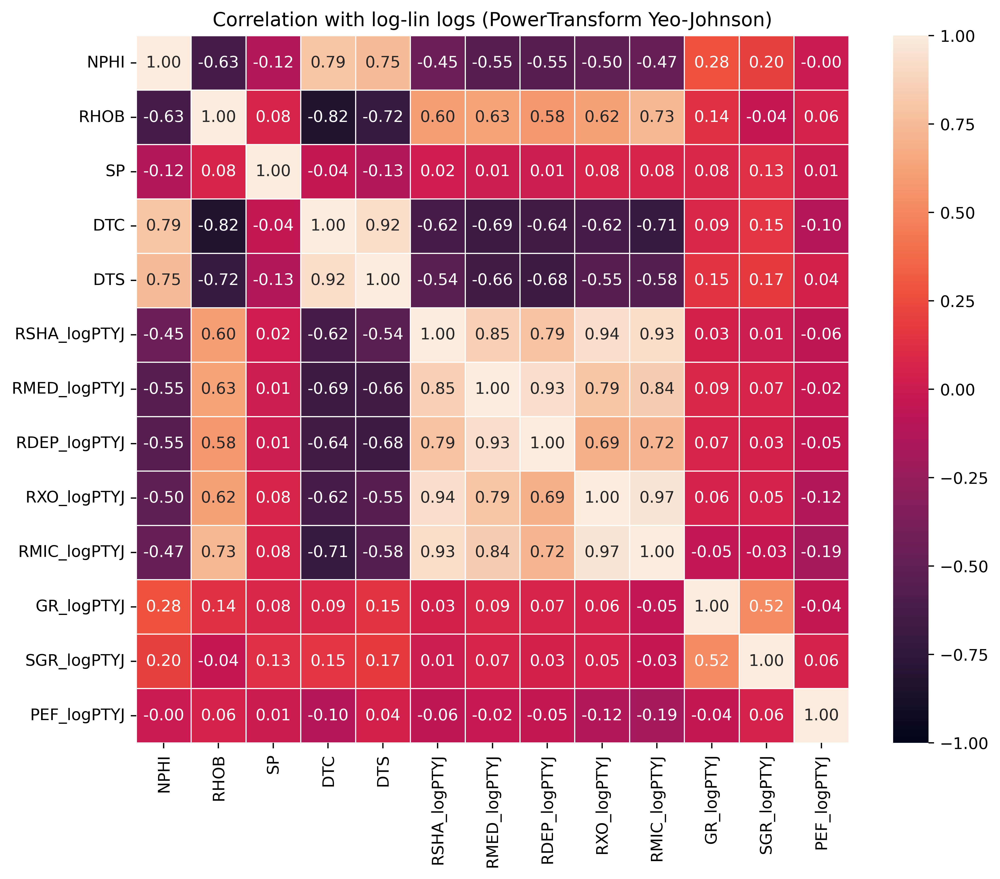

In [29]:
correlate_logptyj = well_corrptyj.corr(method = 'pearson')
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_logptyj,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with log-lin logs (PowerTransform Yeo-Johnson)")
plt.savefig('pearsonloglin_logptyj_mergedata_old.png', bbox_inches='tight')
plt.show()

### Log-lin correlation (with PowerTransform box-cox)


In [30]:
#Histogram on each specific column for more detail
well_corrptbc = well_logPTBC.copy()
well_corrptbc.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)
well_corrptbc.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corrptbc

,NPHI,RHOB,SP,DTC,DTS,RSHA_logPTBC,RMED_logPTBC,RDEP_logPTBC,RXO_logPTBC,RMIC_logPTBC,GR_logPTBC,SGR_logPTBC,PEF_logPTBC
0,NaN,1.884186,24.612379,161.131180,NaN,NaN,0.431839,0.515308,NaN,NaN,16.618892,NaN,1.747791
1,NaN,1.889794,23.895531,160.603470,NaN,NaN,0.435204,0.514012,NaN,NaN,16.506825,NaN,1.725255
2,NaN,1.896523,23.916357,160.173615,NaN,NaN,0.439413,0.516181,NaN,NaN,15.967270,NaN,1.769922
3,NaN,1.891913,23.793688,160.149429,NaN,NaN,0.436976,0.516514,NaN,NaN,15.726314,NaN,1.863167
4,NaN,1.880034,24.104078,160.128342,NaN,NaN,0.427398,0.513866,NaN,NaN,15.582263,NaN,1.905405
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,NaN,NaN,NaN,75.260658,136.911575,NaN,0.838555,0.895864,NaN,0.788042,17.834686,NaN,NaN
1292904,NaN,NaN,NaN,74.868301,137.583923,NaN,0.882078,0.927356,NaN,0.589788,17.420045,NaN,NaN
1292905,NaN,NaN,NaN,74.848122,138.310898,NaN,0.832877,0.873800,NaN,0.276348,17.311441,NaN,NaN
1292906,NaN,NaN,NaN,74.964027,137.592819,NaN,0.800068,0.832938,NaN,0.227483,17.696968,NaN,NaN


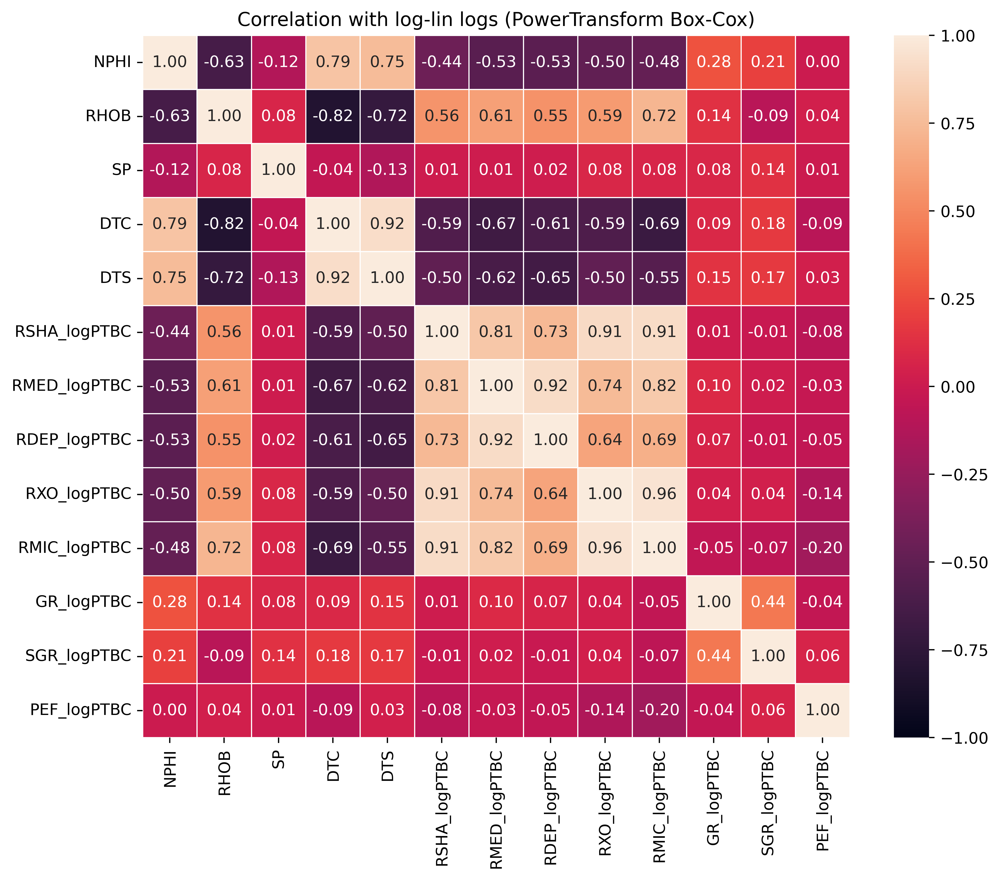

In [31]:
correlate_logptbc = well_corrptbc.corr(method = 'pearson')
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_logptbc,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with log-lin logs (PowerTransform Box-Cox)")
plt.savefig('pearsonloglin_logptbc_mergedata_old.png', bbox_inches='tight')
plt.show()

### Other correlation method (not used)


In [ ]:
correlate.style.background_gradient(cmap='coolwarm')

## Dendogram for Hierarchical Clustering


In [32]:
def link_dissimilarity (correlate):
    dissimilarity = 1 - abs(correlate)
    z = linkage(squareform(dissimilarity), 'complete')
    
    return z

In [33]:
def dendogram_cluster (z, well_data):
    # Clusterize the data
    threshold = 0.8
    labels = fcluster(z, threshold, criterion='distance')

    # Keep the indices to sort labels
    labels_order = np.argsort(labels)

    # Build a new dataframe with the sorted columns
    for idx, i in enumerate(well_data.columns[labels_order]):
        if idx == 0:
            clustered = pd.DataFrame(well_data[i])
        else:
            df_to_append = pd.DataFrame(well_data[i])
            clustered = pd.concat([clustered, df_to_append], axis=1)
    
    return clustered

### Linear dendogram


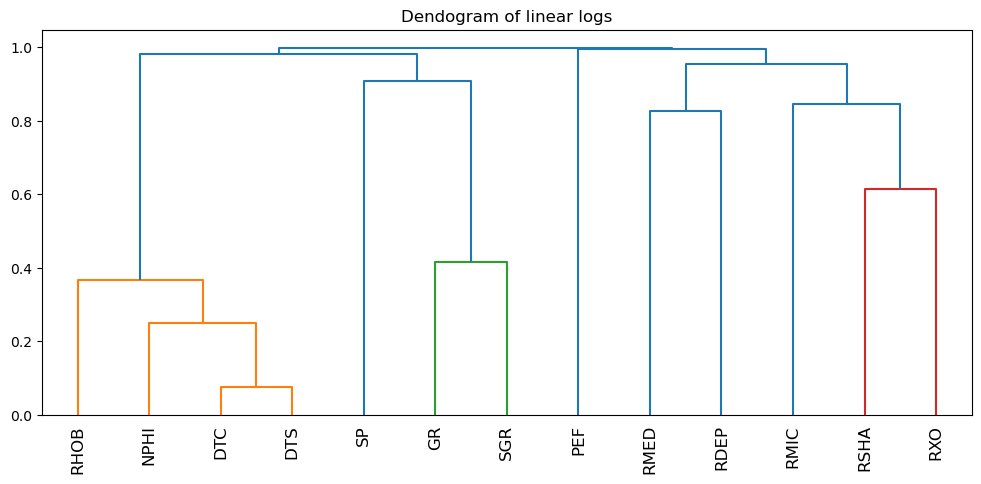

In [34]:
z = link_dissimilarity(correlate)

plt.figure(figsize=(12,5))
dendrogram(z, labels=well_corr.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of linear logs")
plt.savefig('dendogram_linear_mergedata_old.png', bbox_inches='tight')

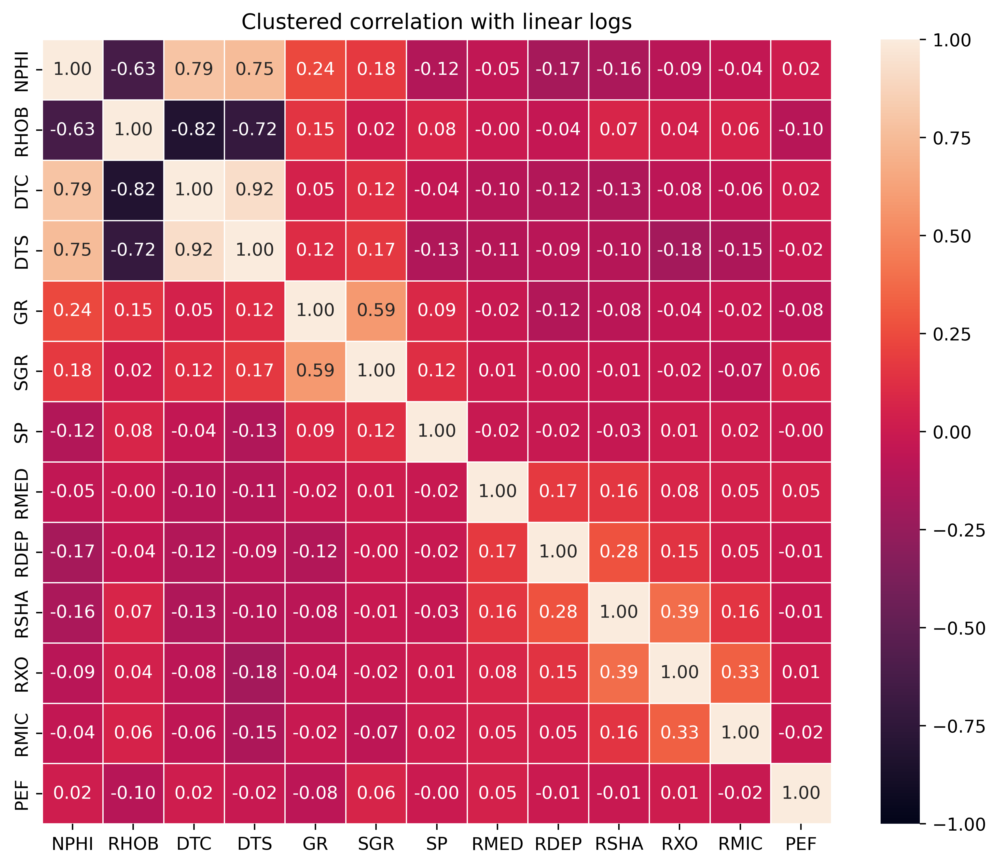

In [35]:
clustered = dendogram_cluster(z, well_corr)
correlate_clustered = clustered.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with linear logs")
plt.savefig('clusteredcorrelation_linear_mergedata_old.png', bbox_inches='tight')
plt.show()

### Log-lin dendogram (log10)


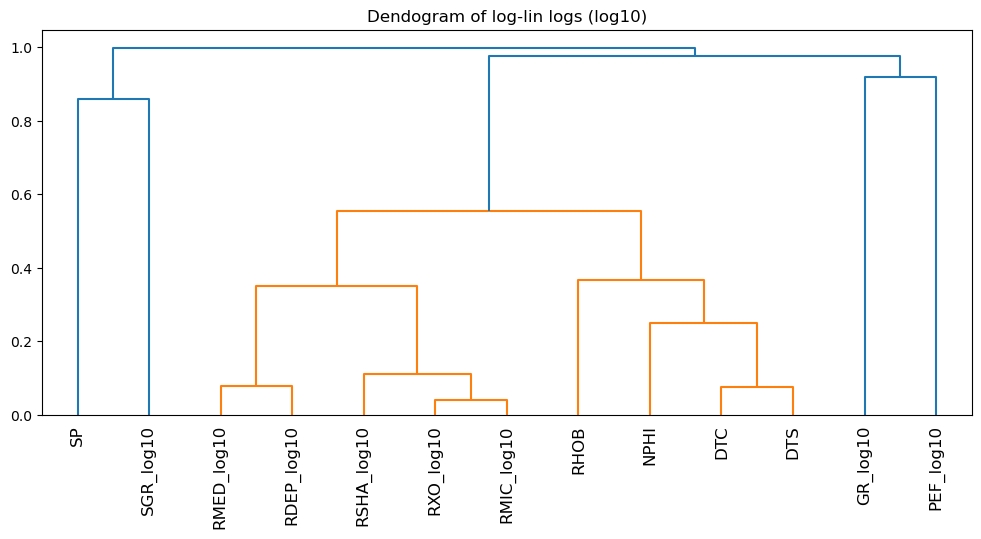

In [36]:
z_log10 = link_dissimilarity(correlate_log10)

plt.figure(figsize=(12,5))
dendrogram(z_log10, labels=well_corr10.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of log-lin logs (log10)")
plt.savefig('dendogram_loglin_log10_mergedata_old.png', bbox_inches='tight')

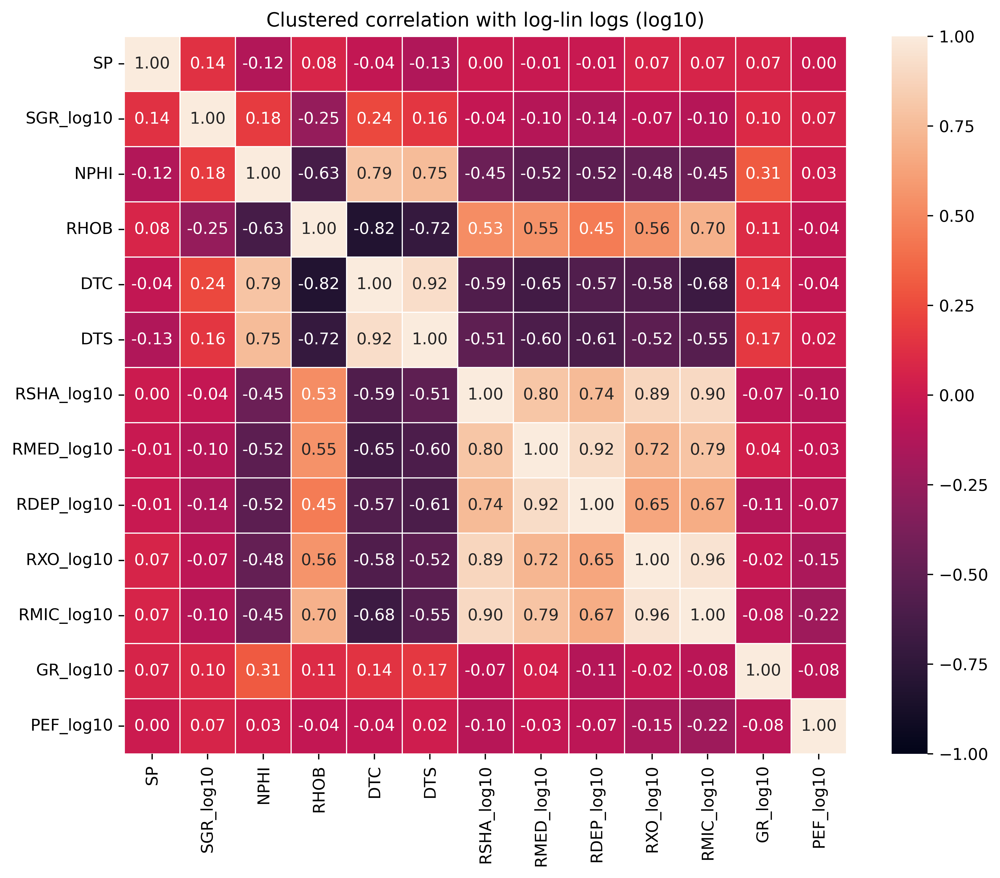

In [37]:
clustered_log10 = dendogram_cluster(z_log10, well_corr10)
correlate_clustered_log10 = clustered_log10.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered_log10,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with log-lin logs (log10)")
plt.savefig('clusteredcorrelation_loglin_log10_mergedata_old.png', bbox_inches='tight')
plt.show()

### Log-lin dendogram (logn)


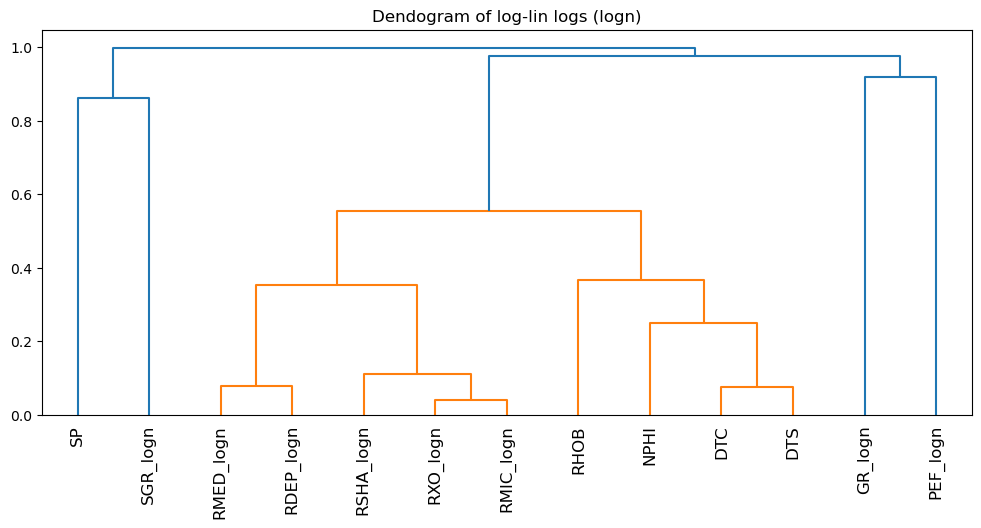

In [38]:
z_logn = link_dissimilarity(correlate_logn)

plt.figure(figsize=(12,5))
dendrogram(z_logn, labels=well_corrn.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of log-lin logs (logn)")
plt.savefig('dendogram_loglin_logn_mergedata_old.png', bbox_inches='tight')

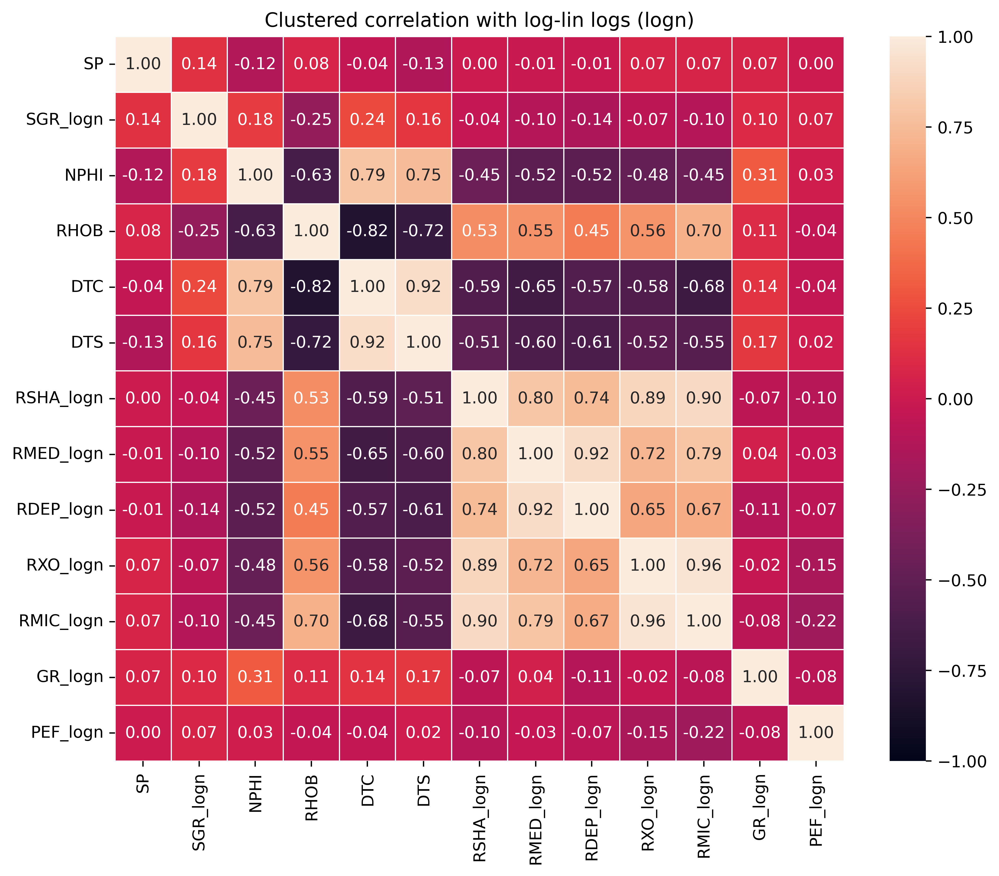

In [39]:
clustered_logn = dendogram_cluster(z_logn, well_corrn)
correlate_clustered_logn = clustered_logn.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered_logn,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with log-lin logs (logn)")
plt.savefig('clusteredcorrelation_loglin_logn_mergedata_old.png', bbox_inches='tight')
plt.show()

### Log-lin dendogram (PowerTransform yeo-johnson)


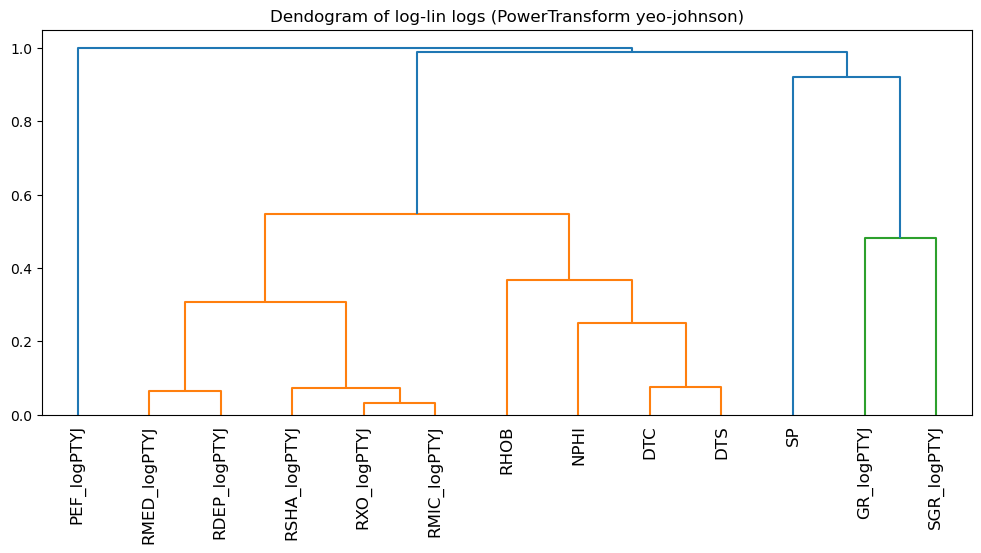

In [40]:
z_logptyj = link_dissimilarity(correlate_logptyj)

plt.figure(figsize=(12,5))
dendrogram(z_logptyj, labels=well_corrptyj.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of log-lin logs (PowerTransform yeo-johnson)")
plt.savefig('dendogram_loglin_logptyj_mergedata_old.png', bbox_inches='tight')

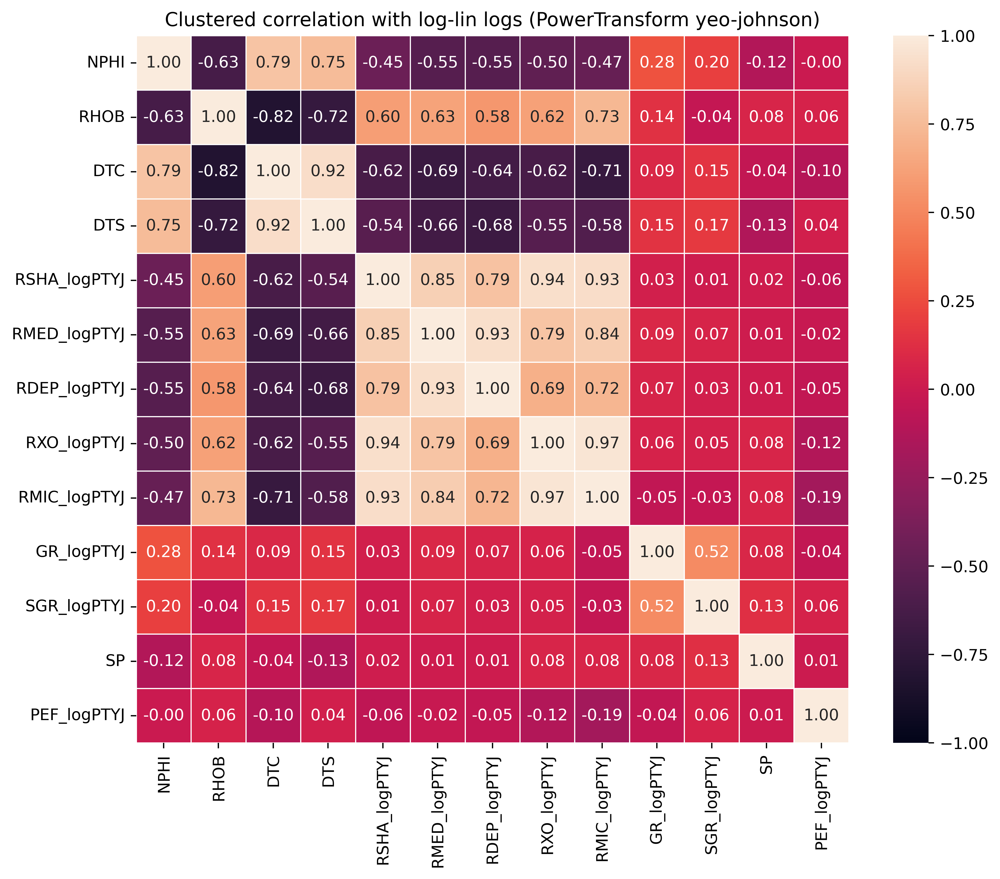

In [41]:
clustered_logptyj = dendogram_cluster(z_logptyj, well_corrptyj)
correlate_clustered_logptyj = clustered_logptyj.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered_logptyj,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with log-lin logs (PowerTransform yeo-johnson)")
plt.savefig('clusteredcorrelation_loglin_logptyj_mergedata_old.png', bbox_inches='tight')
plt.show()

### Log-lin dendogram (PowerTransform box-cox)


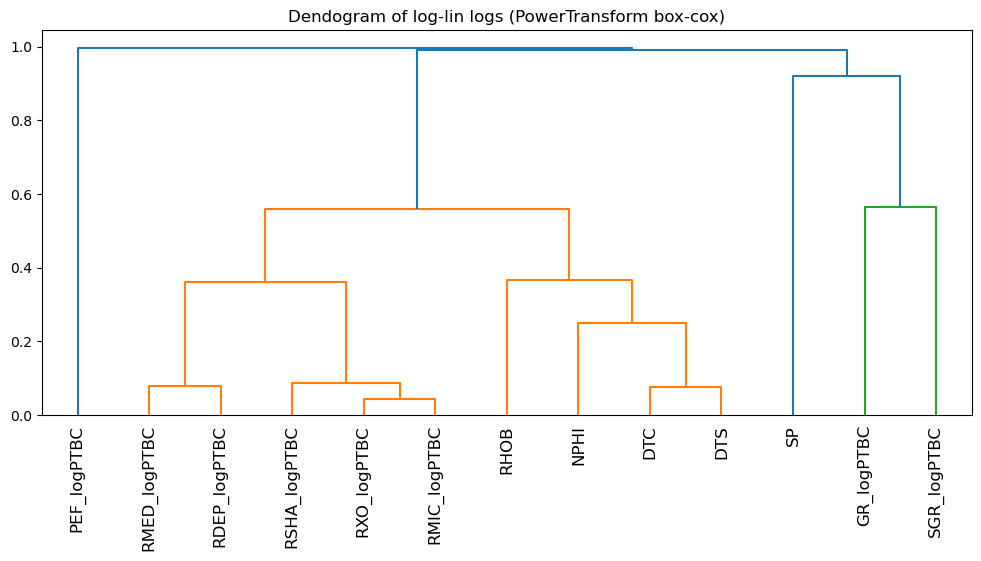

In [42]:
z_logptbc = link_dissimilarity(correlate_logptbc)

plt.figure(figsize=(12,5))
dendrogram(z_logptbc, labels=well_corrptbc.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of log-lin logs (PowerTransform box-cox)")
plt.savefig('dendogram_loglin_logptbc_mergedata_old.png', bbox_inches='tight')

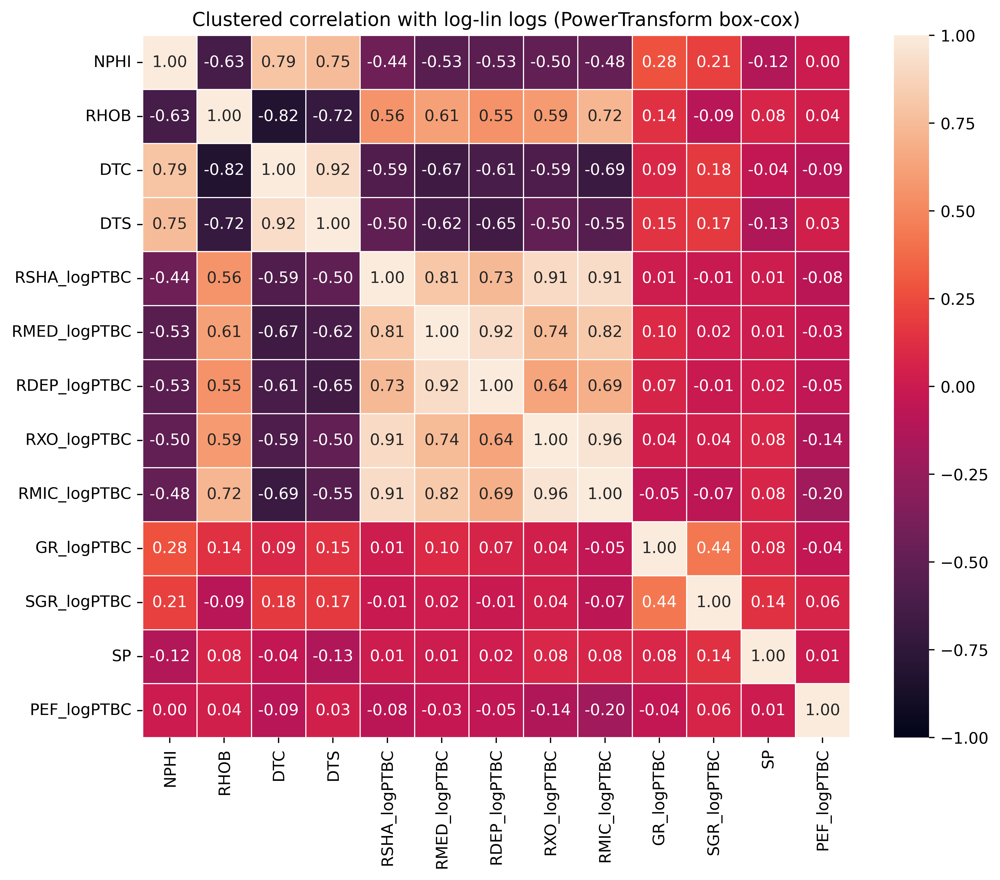

In [43]:
clustered_logptbc = dendogram_cluster(z_logptbc, well_corrptbc)
correlate_clustered_logptbc = clustered_logptbc.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered_logptbc,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with log-lin logs (PowerTransform box-cox)")
plt.savefig('clusteredcorrelation_loglin_logptbc_mergedata_old.png', bbox_inches='tight')
plt.show()

## k-means Clustering


### Data Initiation

Based on Pearson and dendogram analysis, well log data that normalized with PowerTransform yeo-johnson gives the best result and correlation.


In [19]:
well_clustered = well_logPTYJ.copy()
well_clustered

,WELL,DEPTH,CALI,RSHA,RMED,RDEP,RXO,RMIC,GR,SGR,...,LIT,LITCOLOR,RSHA_logPTYJ,RMED_logPTYJ,RDEP_logPTYJ,RXO_logPTYJ,RMIC_logPTYJ,GR_logPTYJ,SGR_logPTYJ,PEF_logPTYJ
0,15/9-13,494.5280,19.480835,NaN,1.611410,1.798681,NaN,NaN,80.200851,NaN,...,Shale,#bebebe,NaN,0.604068,0.638004,NaN,NaN,16.159650,NaN,1.118853
1,15/9-13,494.6800,19.468800,NaN,1.618070,1.795641,NaN,NaN,79.262886,NaN,...,Shale,#bebebe,NaN,0.604994,0.637623,NaN,NaN,16.053923,NaN,1.112974
2,15/9-13,494.8320,19.468800,NaN,1.626459,1.800733,NaN,NaN,74.821999,NaN,...,Shale,#bebebe,NaN,0.606153,0.638262,NaN,NaN,15.544794,NaN,1.124480
3,15/9-13,494.9840,19.459282,NaN,1.621594,1.801517,NaN,NaN,72.878922,NaN,...,Shale,#bebebe,NaN,0.605482,0.638360,NaN,NaN,15.317373,NaN,1.146524
4,15/9-13,495.1360,19.453100,NaN,1.602679,1.795299,NaN,NaN,71.729141,NaN,...,Shale,#bebebe,NaN,0.602847,0.637580,NaN,NaN,15.181400,NaN,1.155583
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,35/9-7,2973.2988,8.276272,NaN,2.820439,3.158570,NaN,2.311106,90.720284,NaN,...,Shale,#bebebe,NaN,0.718174,0.752444,NaN,0.866580,17.306196,NaN,NaN
1292904,35/9-7,2973.4508,8.267273,NaN,3.020778,3.332977,NaN,1.853418,87.062027,NaN,...,Shale,#bebebe,NaN,0.730306,0.761886,NaN,0.788344,16.915269,NaN,NaN
1292905,35/9-7,2973.6028,8.250099,NaN,2.795711,3.044179,NaN,1.325961,86.115921,NaN,...,Shale,#bebebe,NaN,0.716585,0.745805,NaN,0.669389,16.812860,NaN,NaN
1292906,35/9-7,2973.7548,NaN,NaN,2.658694,2.847681,NaN,1.260347,89.497131,NaN,...,Shale,#bebebe,NaN,0.707382,0.733470,NaN,0.651596,17.176366,NaN,NaN


In [180]:
#Test if the best data is logn
well_clustered = well_logn.copy()
well_clustered

,WELL,DEPTH,CALI,RSHA,RMED,RDEP,RXO,RMIC,GR,SGR,...,LIT,LITCOLOR,RSHA_logn,RMED_logn,RDEP_logn,RXO_logn,RMIC_logn,GR_logn,SGR_logn,PEF_logn
0,15/9-13,494.5280,19.480835,NaN,1.611410,1.798681,NaN,NaN,80.200851,NaN,...,Shale,#bebebe,NaN,0.477109,0.587054,NaN,NaN,4.384534,NaN,3.040489
1,15/9-13,494.6800,19.468800,NaN,1.618070,1.795641,NaN,NaN,79.262886,NaN,...,Shale,#bebebe,NaN,0.481234,0.585362,NaN,NaN,4.372770,NaN,2.964397
2,15/9-13,494.8320,19.468800,NaN,1.626459,1.800733,NaN,NaN,74.821999,NaN,...,Shale,#bebebe,NaN,0.486405,0.588194,NaN,NaN,4.315112,NaN,3.117575
3,15/9-13,494.9840,19.459282,NaN,1.621594,1.801517,NaN,NaN,72.878922,NaN,...,Shale,#bebebe,NaN,0.483410,0.588629,NaN,NaN,4.288799,NaN,3.471715
4,15/9-13,495.1360,19.453100,NaN,1.602679,1.795299,NaN,NaN,71.729141,NaN,...,Shale,#bebebe,NaN,0.471677,0.585172,NaN,NaN,4.272897,NaN,3.650545
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,35/9-7,2973.2988,8.276272,NaN,2.820439,3.158570,NaN,2.311106,90.720284,NaN,...,Shale,#bebebe,NaN,1.036893,1.150119,NaN,0.837726,4.507781,NaN,NaN
1292904,35/9-7,2973.4508,8.267273,NaN,3.020778,3.332977,NaN,1.853418,87.062027,NaN,...,Shale,#bebebe,NaN,1.105514,1.203866,NaN,0.617032,4.466621,NaN,NaN
1292905,35/9-7,2973.6028,8.250099,NaN,2.795711,3.044179,NaN,1.325961,86.115921,NaN,...,Shale,#bebebe,NaN,1.028086,1.113231,NaN,0.282138,4.455694,NaN,NaN
1292906,35/9-7,2973.7548,NaN,NaN,2.658694,2.847681,NaN,1.260347,89.497131,NaN,...,Shale,#bebebe,NaN,0.977835,1.046505,NaN,0.231387,4.494207,NaN,NaN


In [20]:
well_clustered.isnull().sum()

WELL                  0
DEPTH                 0
CALI              91320
RSHA             636575
RMED              48817
RDEP              11026
RXO              991199
RMIC            1101567
GR                    0
SGR             1222455
NPHI             430939
PEF              520777
RHOB             170797
SP               382338
BS               535762
DRHO             192785
DTC               84969
DTS             1045424
LITHOLOGY             0
GROUP              1278
FORMATION        145143
LIT                   0
LITCOLOR              0
RSHA_logPTYJ     636575
RMED_logPTYJ      48817
RDEP_logPTYJ      11026
RXO_logPTYJ      991199
RMIC_logPTYJ    1101567
GR_logPTYJ            0
SGR_logPTYJ     1222455
PEF_logPTYJ      520777
dtype: int64

In [21]:
well_clustered.columns

Index(['WELL', 'DEPTH', 'CALI', 'RSHA', 'RMED', 'RDEP', 'RXO', 'RMIC', 'GR',
       'SGR', 'NPHI', 'PEF', 'RHOB', 'SP', 'BS', 'DRHO', 'DTC', 'DTS',
       'LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR', 'RSHA_logPTYJ',
       'RMED_logPTYJ', 'RDEP_logPTYJ', 'RXO_logPTYJ', 'RMIC_logPTYJ',
       'GR_logPTYJ', 'SGR_logPTYJ', 'PEF_logPTYJ'],
      dtype='object')

In [49]:
#With SP
well_clustered = well_clustered[['WELL', 'DEPTH','GR_logPTYJ', 'RDEP_logPTYJ', 'PEF_logPTYJ', 'NPHI', 'RHOB', 'SP', 'DTC', 'CALI', 'GR', 'RDEP', 'PEF', 'LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR']]

well_clustered.rename(columns = {'RDEP_logPTYJ':'RDEP_log'}, inplace = True)
well_clustered.rename(columns = {'GR_logPTYJ':'GR_log'}, inplace = True)
well_clustered.rename(columns = {'PEF_logPTYJ':'PEF_log'}, inplace = True)

well_clustered


C:\Users\V330\AppData\Local\Temp\ipykernel_39768\2089836737.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.rename(columns = {'RDEP_logPTYJ':'RDEP_log'}, inplace = True)
C:\Users\V330\AppData\Local\Temp\ipykernel_39768\2089836737.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.rename(columns = {'GR_logPTYJ':'GR_log'}, inplace = True)
C:\Users\V330\AppData\Local\Temp\ipykernel_39768\2089836737.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/

,WELL,DEPTH,GR_log,RDEP_log,PEF_log,NPHI,RHOB,SP,DTC,CALI,GR,RDEP,PEF,LITHOLOGY,GROUP,FORMATION,LIT,LITCOLOR
0,15/9-13,494.5280,16.159650,0.638004,1.118853,NaN,1.884186,24.612379,161.131180,19.480835,80.200851,1.798681,20.915468,65000,NORDLAND GP.,NaN,Shale,#bebebe
1,15/9-13,494.6800,16.053923,0.637623,1.112974,NaN,1.889794,23.895531,160.603470,19.468800,79.262886,1.795641,19.383013,65000,NORDLAND GP.,NaN,Shale,#bebebe
2,15/9-13,494.8320,15.544794,0.638262,1.124480,NaN,1.896523,23.916357,160.173615,19.468800,74.821999,1.800733,22.591518,65000,NORDLAND GP.,NaN,Shale,#bebebe
3,15/9-13,494.9840,15.317373,0.638360,1.146524,NaN,1.891913,23.793688,160.149429,19.459282,72.878922,1.801517,32.191910,65000,NORDLAND GP.,NaN,Shale,#bebebe
4,15/9-13,495.1360,15.181400,0.637580,1.155583,NaN,1.880034,24.104078,160.128342,19.453100,71.729141,1.795299,38.495632,65000,NORDLAND GP.,NaN,Shale,#bebebe
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,35/9-7,2973.2988,17.306196,0.752444,NaN,NaN,NaN,NaN,75.260658,8.276272,90.720284,3.158570,NaN,65000,BAAT GP.,Etive Fm.,Shale,#bebebe
1292904,35/9-7,2973.4508,16.915269,0.761886,NaN,NaN,NaN,NaN,74.868301,8.267273,87.062027,3.332977,NaN,65000,BAAT GP.,Etive Fm.,Shale,#bebebe
1292905,35/9-7,2973.6028,16.812860,0.745805,NaN,NaN,NaN,NaN,74.848122,8.250099,86.115921,3.044179,NaN,65000,BAAT GP.,Etive Fm.,Shale,#bebebe
1292906,35/9-7,2973.7548,17.176366,0.733470,NaN,NaN,NaN,NaN,74.964027,NaN,89.497131,2.847681,NaN,65000,BAAT GP.,Etive Fm.,Shale,#bebebe


In [22]:
#Without SP
well_clustered = well_clustered[['WELL', 'DEPTH','GR_logPTYJ', 'RDEP_logPTYJ', 'PEF_logPTYJ', 
                                 'NPHI', 'RHOB', 'DTC', 'GR', 'RDEP', 'PEF', 'CALI',
                                 'LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR']]

well_clustered.rename(columns = {'RDEP_logPTYJ':'RDEP_log'}, inplace = True)
well_clustered.rename(columns = {'GR_logPTYJ':'GR_log'}, inplace = True)
well_clustered.rename(columns = {'PEF_logPTYJ':'PEF_log'}, inplace = True)

well_clustered

C:\Users\V330\AppData\Local\Temp\ipykernel_1728\3297859463.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.rename(columns = {'RDEP_logPTYJ':'RDEP_log'}, inplace = True)
C:\Users\V330\AppData\Local\Temp\ipykernel_1728\3297859463.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.rename(columns = {'GR_logPTYJ':'GR_log'}, inplace = True)
C:\Users\V330\AppData\Local\Temp\ipykernel_1728\3297859463.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/ind

,WELL,DEPTH,GR_log,RDEP_log,PEF_log,NPHI,RHOB,DTC,GR,RDEP,PEF,CALI,LITHOLOGY,GROUP,FORMATION,LIT,LITCOLOR
0,15/9-13,494.5280,16.159650,0.638004,1.118853,NaN,1.884186,161.131180,80.200851,1.798681,20.915468,19.480835,65000,NORDLAND GP.,NaN,Shale,#bebebe
1,15/9-13,494.6800,16.053923,0.637623,1.112974,NaN,1.889794,160.603470,79.262886,1.795641,19.383013,19.468800,65000,NORDLAND GP.,NaN,Shale,#bebebe
2,15/9-13,494.8320,15.544794,0.638262,1.124480,NaN,1.896523,160.173615,74.821999,1.800733,22.591518,19.468800,65000,NORDLAND GP.,NaN,Shale,#bebebe
3,15/9-13,494.9840,15.317373,0.638360,1.146524,NaN,1.891913,160.149429,72.878922,1.801517,32.191910,19.459282,65000,NORDLAND GP.,NaN,Shale,#bebebe
4,15/9-13,495.1360,15.181400,0.637580,1.155583,NaN,1.880034,160.128342,71.729141,1.795299,38.495632,19.453100,65000,NORDLAND GP.,NaN,Shale,#bebebe
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,35/9-7,2973.2988,17.306196,0.752444,NaN,NaN,NaN,75.260658,90.720284,3.158570,NaN,8.276272,65000,BAAT GP.,Etive Fm.,Shale,#bebebe
1292904,35/9-7,2973.4508,16.915269,0.761886,NaN,NaN,NaN,74.868301,87.062027,3.332977,NaN,8.267273,65000,BAAT GP.,Etive Fm.,Shale,#bebebe
1292905,35/9-7,2973.6028,16.812860,0.745805,NaN,NaN,NaN,74.848122,86.115921,3.044179,NaN,8.250099,65000,BAAT GP.,Etive Fm.,Shale,#bebebe
1292906,35/9-7,2973.7548,17.176366,0.733470,NaN,NaN,NaN,74.964027,89.497131,2.847681,NaN,NaN,65000,BAAT GP.,Etive Fm.,Shale,#bebebe


In [183]:
#Without SP for logn
well_clustered = well_clustered[['WELL', 'DEPTH','GR_logn', 'RDEP_logn', 'PEF_logn', 
                                 'NPHI', 'RHOB', 'DTC', 'GR', 'RDEP', 'PEF', 'CALI',
                                 'LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR']]

well_clustered.rename(columns = {'RDEP_logn':'RDEP_log'}, inplace = True)
well_clustered.rename(columns = {'GR_logn':'GR_log'}, inplace = True)
well_clustered.rename(columns = {'PEF_logn':'PEF_log'}, inplace = True)

C:\Users\V330\AppData\Local\Temp\ipykernel_39768\195667422.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.rename(columns = {'RDEP_logn':'RDEP_log'}, inplace = True)
C:\Users\V330\AppData\Local\Temp\ipykernel_39768\195667422.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.rename(columns = {'GR_logn':'GR_log'}, inplace = True)
C:\Users\V330\AppData\Local\Temp\ipykernel_39768\195667422.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.

In [23]:
well_clustered.dropna(inplace=True)
well_clustered

C:\Users\V330\AppData\Local\Temp\ipykernel_1728\1168242641.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.dropna(inplace=True)


,WELL,DEPTH,GR_log,RDEP_log,PEF_log,NPHI,RHOB,DTC,GR,RDEP,PEF,CALI,LITHOLOGY,GROUP,FORMATION,LIT,LITCOLOR
4238,15/9-13,1138.7040,13.186658,0.518990,0.666955,0.765867,1.774626,147.837677,55.892757,1.091499,1.631495,19.322735,30000,NORDLAND GP.,Utsira Fm.,Sandstone,#ffff00
4239,15/9-13,1138.8560,13.847989,0.525930,0.669271,0.800262,1.800986,142.382431,60.929138,1.122706,1.645080,18.613674,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe
4240,15/9-13,1139.0080,14.000061,0.531436,0.669406,0.765957,1.817696,138.258331,62.117264,1.148141,1.645873,18.212072,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe
4241,15/9-13,1139.1600,13.858495,0.536270,0.665015,0.702521,1.829333,139.198914,61.010860,1.170984,1.620216,18.134182,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe
4242,15/9-13,1139.3120,13.532657,0.538995,0.644262,0.639708,1.813854,144.290085,58.501236,1.184080,1.504854,18.033762,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292884,35/9-7,2970.4108,15.382661,0.619545,0.877733,0.162661,2.364000,77.891953,73.434174,1.658935,3.748971,8.317346,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00
1292885,35/9-7,2970.5628,15.374335,0.621334,0.875642,0.162905,2.363551,76.698967,73.363243,1.671857,3.713399,8.334090,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00
1292886,35/9-7,2970.7148,15.042288,0.623383,0.875119,0.162685,2.363479,75.748085,70.562103,1.686821,3.704569,8.346820,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00
1292887,35/9-7,2970.8668,14.611376,0.620159,0.877262,0.160029,2.364090,76.182335,67.006660,1.663354,3.740919,8.350366,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00


### Elbow plot


In [52]:
def optimal_cluster(data, maxcluster):
    means=[]
    inertias = []
    
    for k in range(1, maxcluster):
        kmeans= KMeans(n_clusters = k)
        kmeans.fit(data)
        
        means.append(k)
        inertias.append(kmeans.inertia_)
    
    return means, inertias


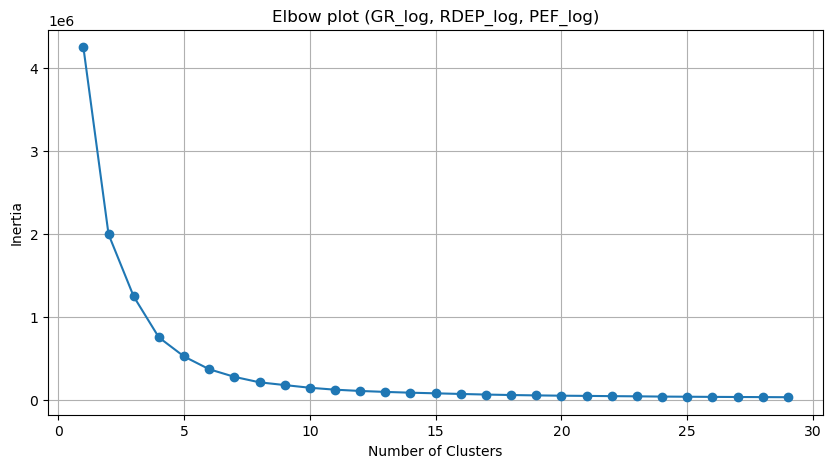

In [53]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log)')
plt.grid(True)
plt.savefig('elbowplot_grrdeppef_mergedata_old.png', bbox_inches='tight')
plt.show()

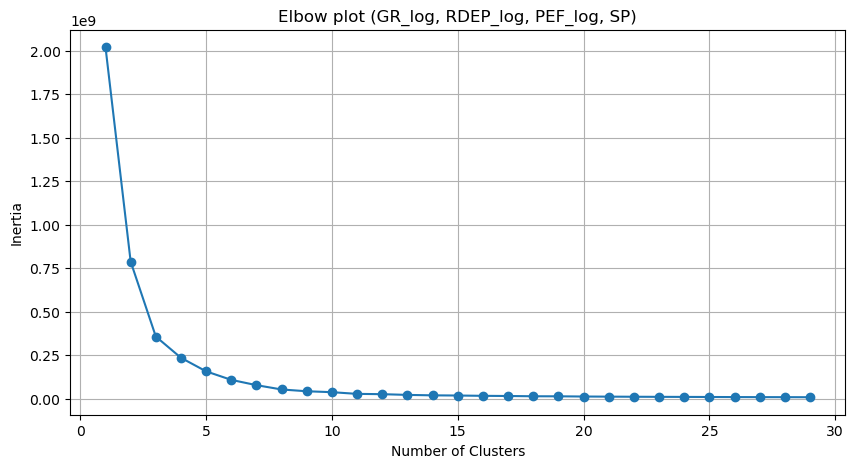

In [54]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, SP)')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefsp_mergedata_old.png', bbox_inches='tight')
plt.show()

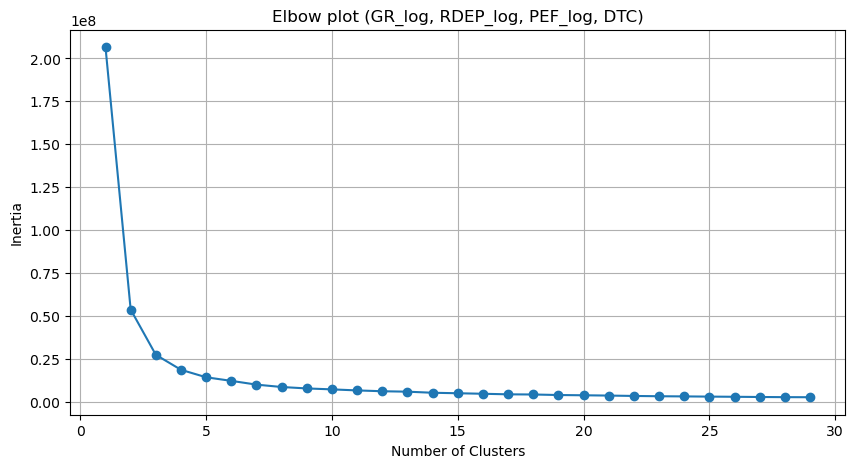

In [55]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'DTC']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, DTC)')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefdtc_mergedata_old.png', bbox_inches='tight')
plt.show()

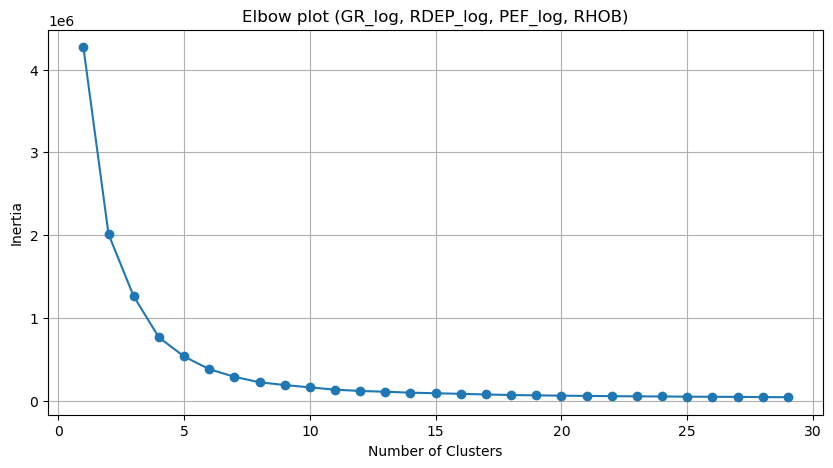

In [56]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB)')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefrhob_mergedata_old.png', bbox_inches='tight')
plt.show()

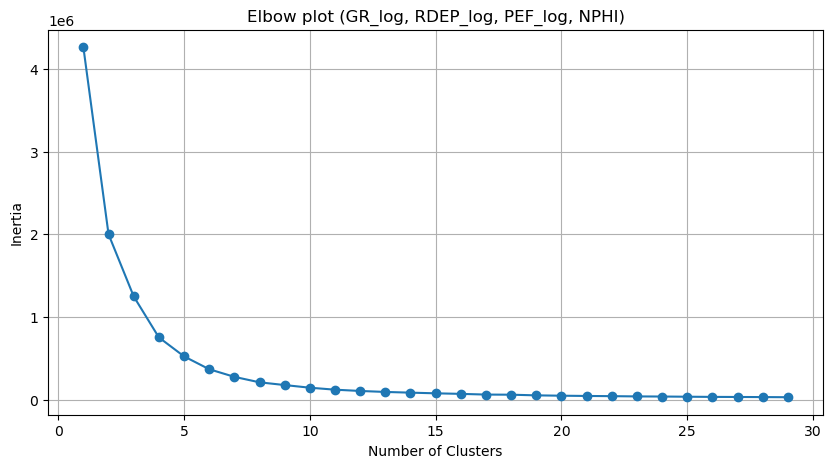

In [57]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI)')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefnphi_mergedata_old.png', bbox_inches='tight')
plt.show()

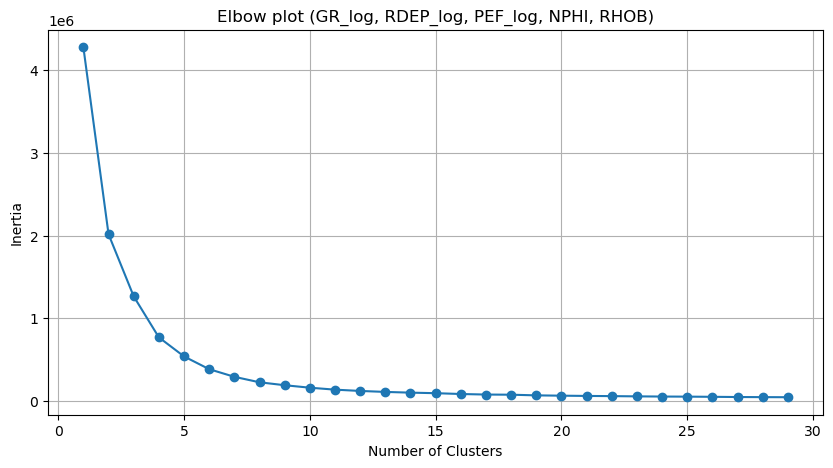

In [58]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB)')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefnphirhob_mergedata_old.png', bbox_inches='tight')
plt.show()

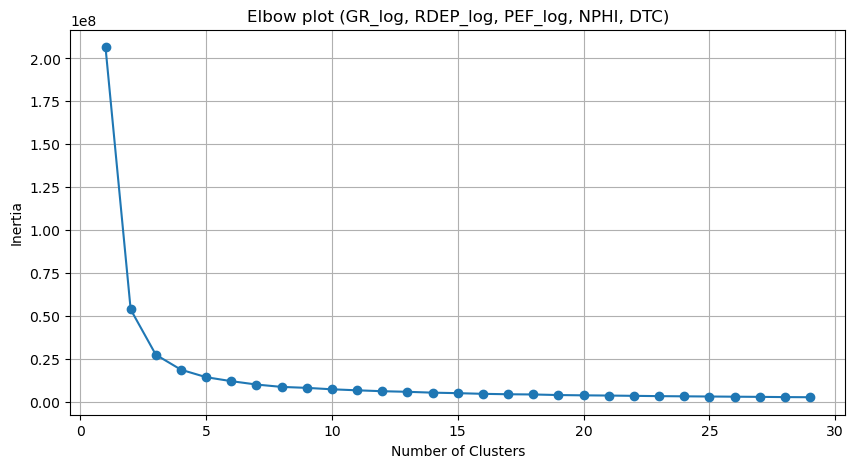

In [59]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'DTC']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, DTC)')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefnphidtc_mergedata_old.png', bbox_inches='tight')
plt.show()

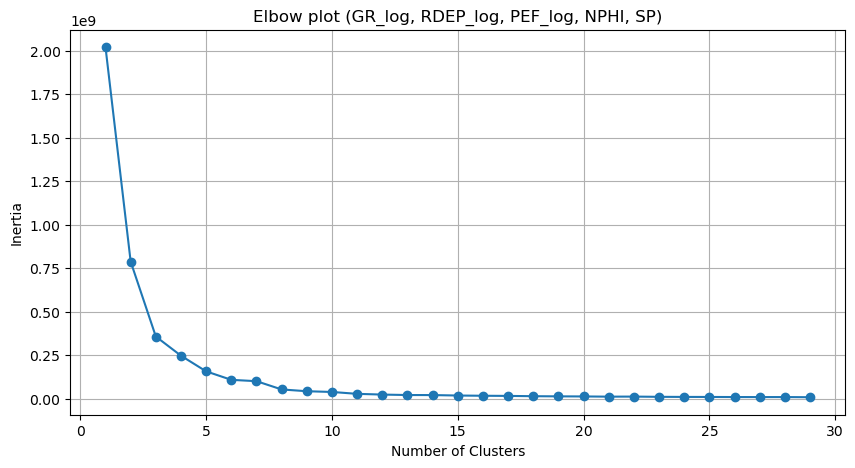

In [60]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, SP)')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefnphisp_mergedata_old.png', bbox_inches='tight')
plt.show()

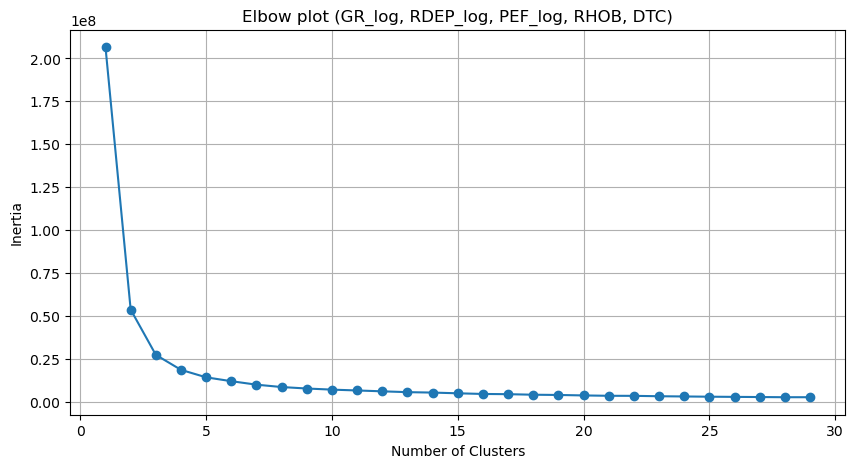

In [61]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB', 'DTC']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB, DTC)')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefrhobdtc_mergedata_old.png', bbox_inches='tight')
plt.show()

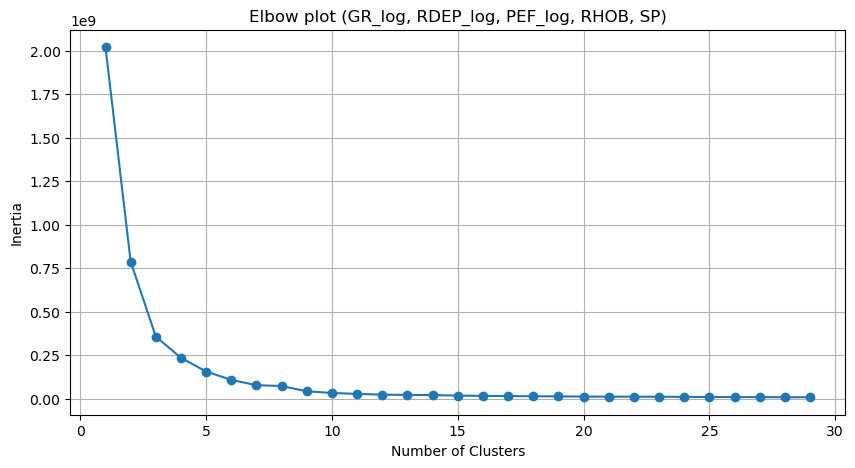

In [62]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB, SP)')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefrhobsp_mergedata_old.png', bbox_inches='tight')
plt.show()

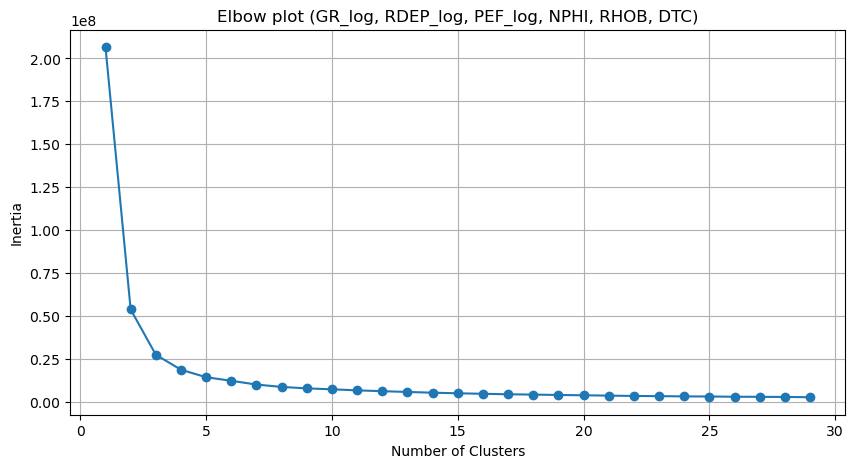

In [63]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'DTC']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, DTC)')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefnphirhobdtc_mergedata_old.png', bbox_inches='tight')
plt.show()

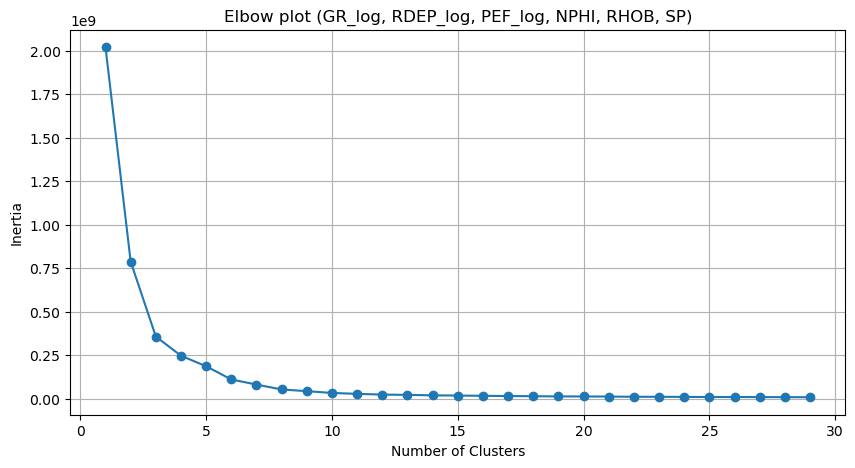

In [64]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, SP)')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefnphirhobsp_mergedata_old.png', bbox_inches='tight')
plt.show()

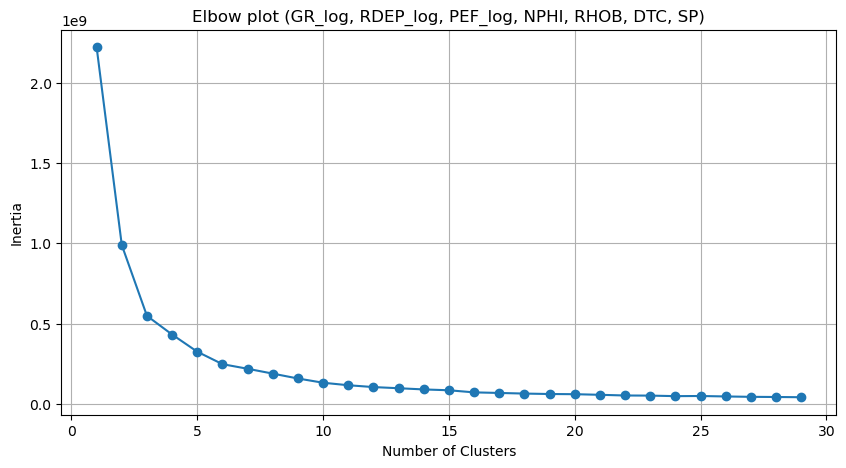

In [65]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'DTC', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, DTC, SP)')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefnphirhobdtcsp_mergedata_old.png', bbox_inches='tight')
plt.show()

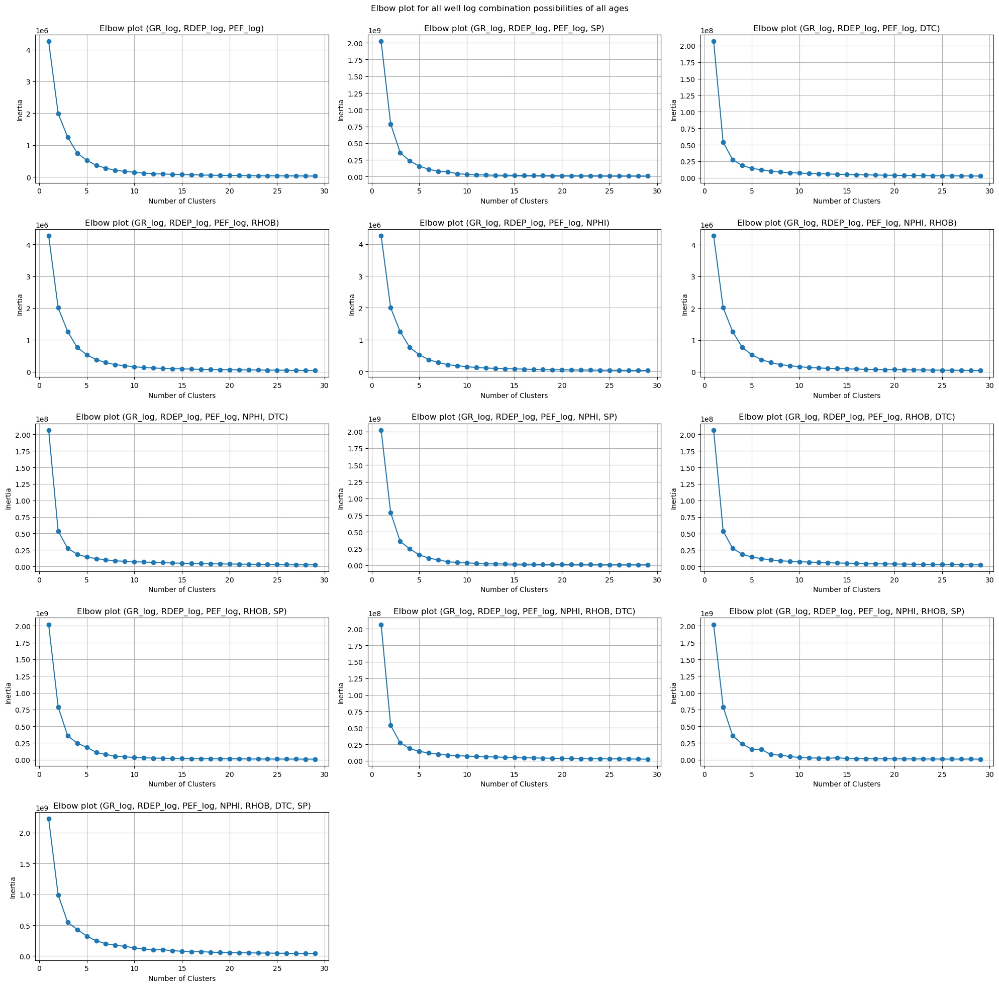

In [66]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Elbow plot for all well log combination possibilities of all ages')
for i in range(15):
    ax = fig.add_subplot(5,3, i+1)
    ax.set_axisbelow(True)
    ax.set_xlabel('Number of Clusters')
    ax.set_ylabel('Inertia')
    
    if i==0:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log)')
    elif i==1:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'SP']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, SP)')
    elif i==2:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'DTC']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, DTC)')
    elif i==3:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB)')
    elif i==4:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI)')
    elif i==5:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB)')
    elif i==6:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'DTC']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, DTC)')
    elif i==7:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'SP']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, SP)')
    elif i==8:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB', 'DTC']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB, DTC)')
    elif i==9:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB', 'SP']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB, SP)')
    elif i==10:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'DTC']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, DTC)')
    elif i==11:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'SP']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, SP)')
    elif i==12:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'DTC', 'SP']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, DTC, SP)')
    else:
        ax.remove()
        
    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('elbowplot_all_mergedata_old.png', bbox_inches='tight')
plt.show()
    

### Clustering


In [53]:
Kmeans = KMeans(n_clusters = 5, init='k-means++', n_init=20, max_iter=1000, random_state=42)


In [54]:
Kmeans.fit(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB']])

KMeans(max_iter=1000, n_clusters=5, n_init=20, random_state=42)

In [55]:
means1=Kmeans.cluster_centers_
means1

array([[26.53424951,  0.68361661,  0.92433307,  0.40048871,  2.36384691],
       [16.30400029,  0.62922997,  0.90915108,  0.34815433,  2.37132649],
       [ 8.13651995,  0.66849433,  0.9253957 ,  0.19266375,  2.4008165 ],
       [19.40732603,  0.69099925,  0.90646031,  0.34924664,  2.42959375],
       [12.83312582,  0.58942209,  0.91824035,  0.31410807,  2.30826184]])

In [56]:
well_clustered['KMeans'] = Kmeans.labels_
well_clustered

C:\Users\V330\AppData\Local\Temp\ipykernel_1728\870997332.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered['KMeans'] = Kmeans.labels_


,WELL,DEPTH,GR_log,RDEP_log,PEF_log,NPHI,RHOB,DTC,GR,RDEP,PEF,CALI,LITHOLOGY,GROUP,FORMATION,LIT,LITCOLOR,KMeans,GMM
4238,15/9-13,1138.7040,13.186658,0.518990,0.666955,0.765867,1.774626,147.837677,55.892757,1.091499,1.631495,19.322735,30000,NORDLAND GP.,Utsira Fm.,Sandstone,#ffff00,4,2
4239,15/9-13,1138.8560,13.847989,0.525930,0.669271,0.800262,1.800986,142.382431,60.929138,1.122706,1.645080,18.613674,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,4,2
4240,15/9-13,1139.0080,14.000061,0.531436,0.669406,0.765957,1.817696,138.258331,62.117264,1.148141,1.645873,18.212072,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,4,2
4241,15/9-13,1139.1600,13.858495,0.536270,0.665015,0.702521,1.829333,139.198914,61.010860,1.170984,1.620216,18.134182,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,4,2
4242,15/9-13,1139.3120,13.532657,0.538995,0.644262,0.639708,1.813854,144.290085,58.501236,1.184080,1.504854,18.033762,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,4,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292884,35/9-7,2970.4108,15.382661,0.619545,0.877733,0.162661,2.364000,77.891953,73.434174,1.658935,3.748971,8.317346,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00,1,3
1292885,35/9-7,2970.5628,15.374335,0.621334,0.875642,0.162905,2.363551,76.698967,73.363243,1.671857,3.713399,8.334090,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00,1,3
1292886,35/9-7,2970.7148,15.042288,0.623383,0.875119,0.162685,2.363479,75.748085,70.562103,1.686821,3.704569,8.346820,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00,1,3
1292887,35/9-7,2970.8668,14.611376,0.620159,0.877262,0.160029,2.364090,76.182335,67.006660,1.663354,3.740919,8.350366,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00,1,3


In [57]:
print(confusion_matrix(well_clustered['KMeans'],Kmeans.labels_))
print(classification_report(well_clustered['KMeans'],Kmeans.labels_))

[[ 11938      0      0      0      0]
 [     0 198560      0      0      0]
 [     0      0  45177      0      0]
 [     0      0      0 114934      0]
 [     0      0      0      0 135290]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     11938
           1       1.00      1.00      1.00    198560
           2       1.00      1.00      1.00     45177
           3       1.00      1.00      1.00    114934
           4       1.00      1.00      1.00    135290

    accuracy                           1.00    505899
   macro avg       1.00      1.00      1.00    505899
weighted avg       1.00      1.00      1.00    505899



In [58]:
well_clustered['KMeans'].unique()

array([4, 1, 2, 3, 0])

In [59]:
well_clustered['KMeans'] = well_clustered['KMeans'].apply(lambda x: x+1)
well_clustered['KMeans'].unique()

C:\Users\V330\AppData\Local\Temp\ipykernel_1728\1861890788.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered['KMeans'] = well_clustered['KMeans'].apply(lambda x: x+1)


array([5, 2, 3, 4, 1], dtype=int64)

In [60]:
kmeanscolor = {1: '#bebebe',
               2: '#ffff00',
               3: '#ff8c00',
               4: '#80ffff',
               5: '#008100'}

## Test other clustering methods

### Gaussian Mixture Models

In [61]:
gmm = GaussianMixture(n_components=5, random_state=42)
gmm_labels = gmm.fit_predict(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB']])


In [62]:
well_clustered['GMM'] = gmm_labels
well_clustered

C:\Users\V330\AppData\Local\Temp\ipykernel_1728\3491001460.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered['GMM'] = gmm_labels


,WELL,DEPTH,GR_log,RDEP_log,PEF_log,NPHI,RHOB,DTC,GR,RDEP,PEF,CALI,LITHOLOGY,GROUP,FORMATION,LIT,LITCOLOR,KMeans,GMM
4238,15/9-13,1138.7040,13.186658,0.518990,0.666955,0.765867,1.774626,147.837677,55.892757,1.091499,1.631495,19.322735,30000,NORDLAND GP.,Utsira Fm.,Sandstone,#ffff00,5,1
4239,15/9-13,1138.8560,13.847989,0.525930,0.669271,0.800262,1.800986,142.382431,60.929138,1.122706,1.645080,18.613674,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,5,1
4240,15/9-13,1139.0080,14.000061,0.531436,0.669406,0.765957,1.817696,138.258331,62.117264,1.148141,1.645873,18.212072,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,5,1
4241,15/9-13,1139.1600,13.858495,0.536270,0.665015,0.702521,1.829333,139.198914,61.010860,1.170984,1.620216,18.134182,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,5,1
4242,15/9-13,1139.3120,13.532657,0.538995,0.644262,0.639708,1.813854,144.290085,58.501236,1.184080,1.504854,18.033762,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,5,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292884,35/9-7,2970.4108,15.382661,0.619545,0.877733,0.162661,2.364000,77.891953,73.434174,1.658935,3.748971,8.317346,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00,2,2
1292885,35/9-7,2970.5628,15.374335,0.621334,0.875642,0.162905,2.363551,76.698967,73.363243,1.671857,3.713399,8.334090,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00,2,2
1292886,35/9-7,2970.7148,15.042288,0.623383,0.875119,0.162685,2.363479,75.748085,70.562103,1.686821,3.704569,8.346820,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00,2,2
1292887,35/9-7,2970.8668,14.611376,0.620159,0.877262,0.160029,2.364090,76.182335,67.006660,1.663354,3.740919,8.350366,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00,2,2


In [63]:
well_clustered['GMM'].unique()

array([1, 4, 3, 2, 0], dtype=int64)

In [64]:
well_clustered['GMM'] = well_clustered['GMM'].apply(lambda x: x+1)
well_clustered['GMM'].unique()

C:\Users\V330\AppData\Local\Temp\ipykernel_1728\4207833585.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered['GMM'] = well_clustered['GMM'].apply(lambda x: x+1)


array([2, 5, 4, 3, 1], dtype=int64)

## Clustering result


### Groupby and lists


In [85]:
grouped_kmeans = well_clustered.groupby('KMeans', sort=True)

keys_kmeans = [key for key, _ in grouped_kmeans] #groupby based on unique keys or categories (1)
keys_kmeans #show groupby keys or categories
#grouped.groups.keys() #groupby based on unique keys or categories (1)
#grouped.apply(display) #show groupby data

[1, 2, 3, 4, 5]

In [86]:
grouped_lithology = well_clustered.groupby('LIT', sort=False)

keys_lithology = [key for key, _ in grouped_lithology] #groupby based on unique keys or categories (1)
keys_lithology #show groupby keys or categories
#grouped.groups.keys() #groupby based on unique keys or categories (1)
#grouped.apply(display) #show groupby data

C:\Users\V330\AppData\Local\Temp\ipykernel_1728\2648459692.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_lithology = well_clustered.groupby('LIT', sort=False)


['Sandstone',
 'Shale',
 'Sandy Shale',
 'Limestone',
 'Volcaniclastics',
 'Marl',
 'Chalk',
 'Dolomite',
 'Coal',
 'Halite',
 'Anhydrite',
 'Basement']

In [87]:
#Histogram on each specific column for more detail
well_clustered_curves = list(well_clustered) #Create a list of curve names
well_clustered_curves.remove("WELL") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("DEPTH") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("LITHOLOGY") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("GROUP") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("FORMATION") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("LIT") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("LITCOLOR") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("GR_log") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("RDEP_log") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("PEF_log") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("KMeans") #Remove the depth curve to focus only on curves

well_clustered_curves = ['RDEP', 'GR', 'PEF', 'NPHI', 'RHOB', 'SP', 'DTC']
well_clustered_curves

['RDEP', 'GR', 'PEF', 'NPHI', 'RHOB', 'SP', 'DTC']

In [88]:
# Without SP
well_clustered_curves = ['RDEP', 'GR', 'PEF', 'NPHI', 'RHOB', 'DTC']
well_clustered_curves

['RDEP', 'GR', 'PEF', 'NPHI', 'RHOB', 'DTC']

### Crossplot


#### NPHI-RHOB


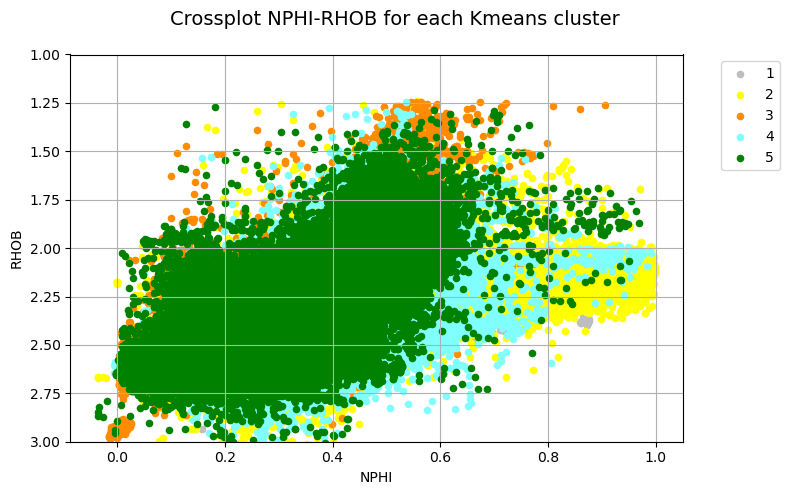

In [89]:
#Crossplot NPHI-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot NPHI-RHOB for each Kmeans cluster', fontsize=14)
for key, group in grouped_kmeans:
    group.plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=kmeanscolor[key])
    
plt.ylim(3,1)
#plt.xlim(0,200)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('NPHI')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotnphirhoball_kmeans_mergedata_old.png', bbox_inches='tight')
plt.show()

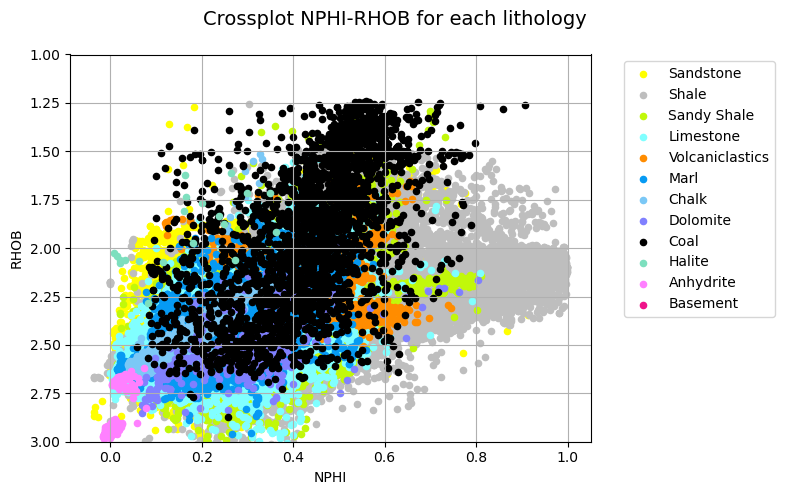

In [90]:
#Crossplot NPHI-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot NPHI-RHOB for each lithology', fontsize=14)
for key, group in grouped_lithology:
    group.plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=litocolor[key])
    
plt.ylim(3,1)
#plt.xlim(0,200)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('NPHI')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotnphirhoball_lithology_mergedata_old.png', bbox_inches='tight')
plt.show()

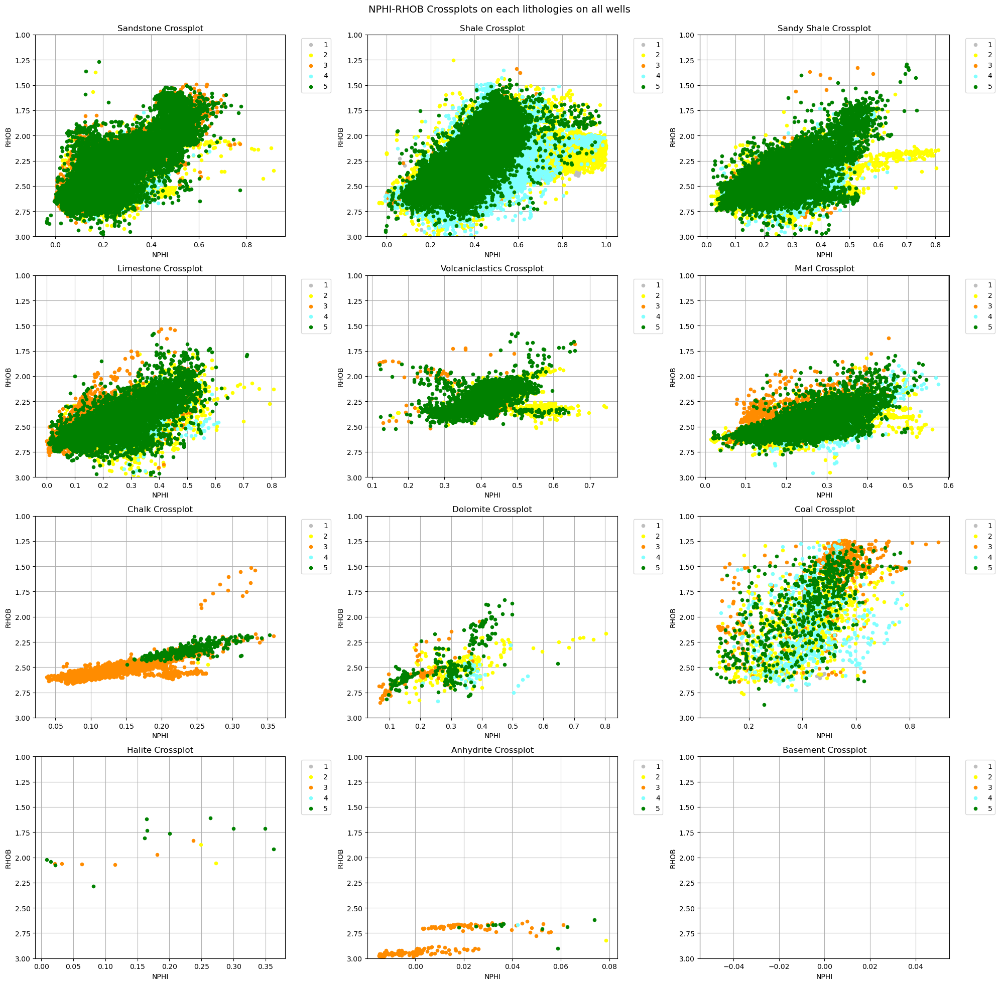

In [91]:
fig = plt.figure(figsize=(20,20))

for i, litho in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(litho+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('NPHI-RHOB Crossplots on each lithologies on all wells', fontsize=14)
    
    for key, group in grouped_kmeans:
        group[group['LIT'].isin([litho])].plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=kmeanscolor[key])
    
    ax.set_ylim(3,1)
    #ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('NPHI')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotnphirhoblithology_mergedata_old.png', bbox_inches='tight')
plt.show()

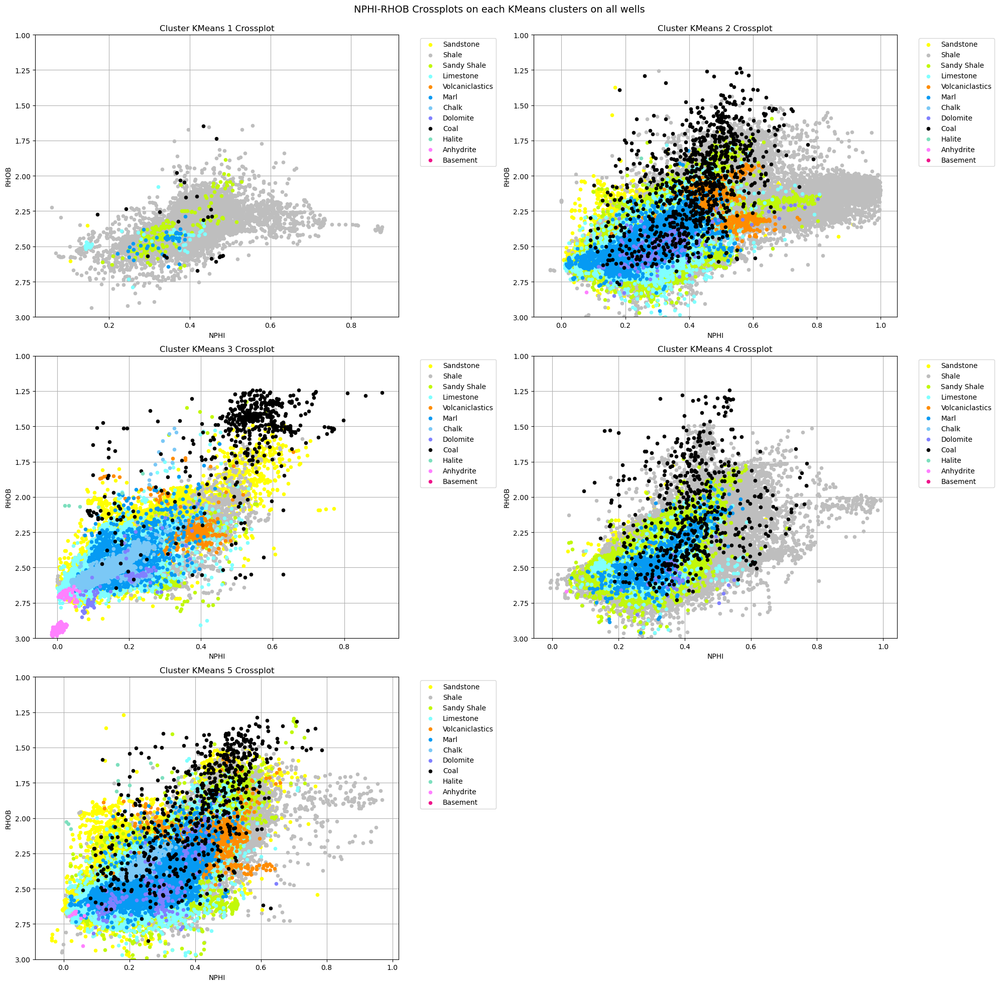

In [92]:
fig = plt.figure(figsize=(20,20))

for i, kmeans in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(kmeans)+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('NPHI-RHOB Crossplots on each KMeans clusters on all wells', fontsize=14)
    
    for key, group in grouped_lithology:
        group[group['KMeans'].isin([kmeans])].plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=litocolor[key])
    
    ax.set_ylim(3,1)
    #ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('NPHI')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotnphirhobkmeans_mergedata_old.png', bbox_inches='tight')
plt.show()

#### GR-RHOB


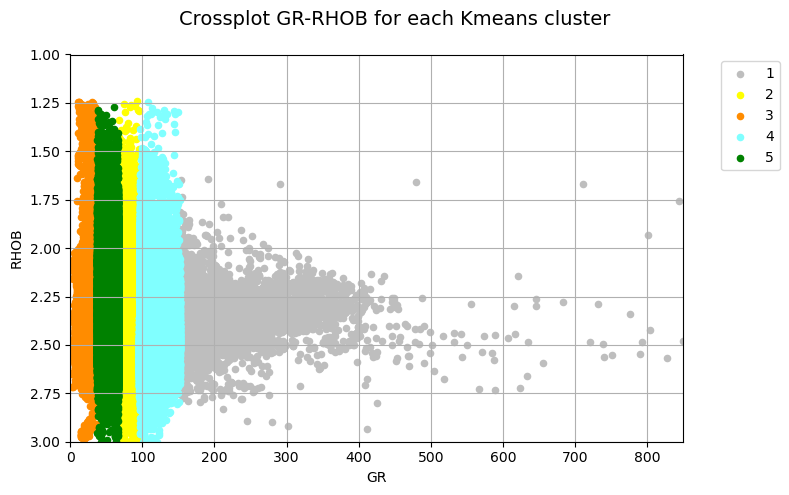

In [93]:
#Crossplot GR-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot GR-RHOB for each Kmeans cluster', fontsize=14)
for key, group in grouped_kmeans:
    group.plot(ax=ax, kind='scatter', x='GR', y='RHOB', label=key, color=kmeanscolor[key])
    
plt.ylim(3,1)
plt.xlim(0,850)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('GR')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotgrrhoball_kmeans_mergedata_old.png', bbox_inches='tight')
plt.show()

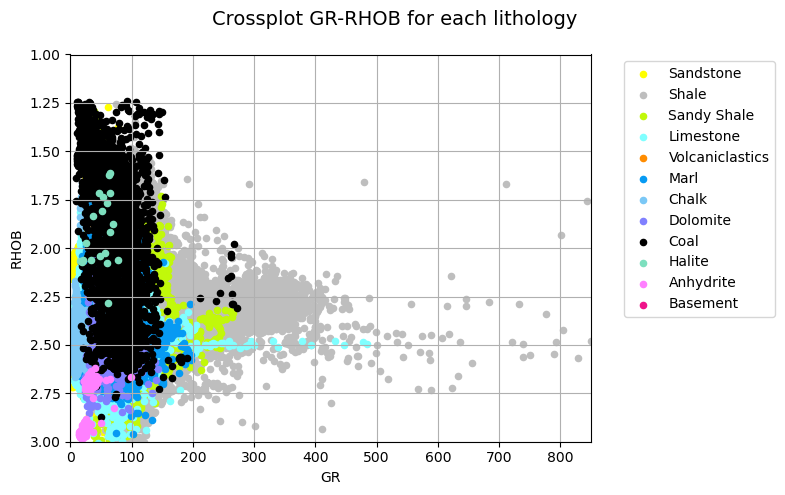

In [94]:
#Crossplot GR-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot GR-RHOB for each lithology', fontsize=14)
for key, group in grouped_lithology:
    group.plot(ax=ax, kind='scatter', x='GR', y='RHOB', label=key, color=litocolor[key])
    
plt.ylim(3,1)
plt.xlim(0,850)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('GR')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotgrrhoball_lithology_mergedata_old.png', bbox_inches='tight')
plt.show()

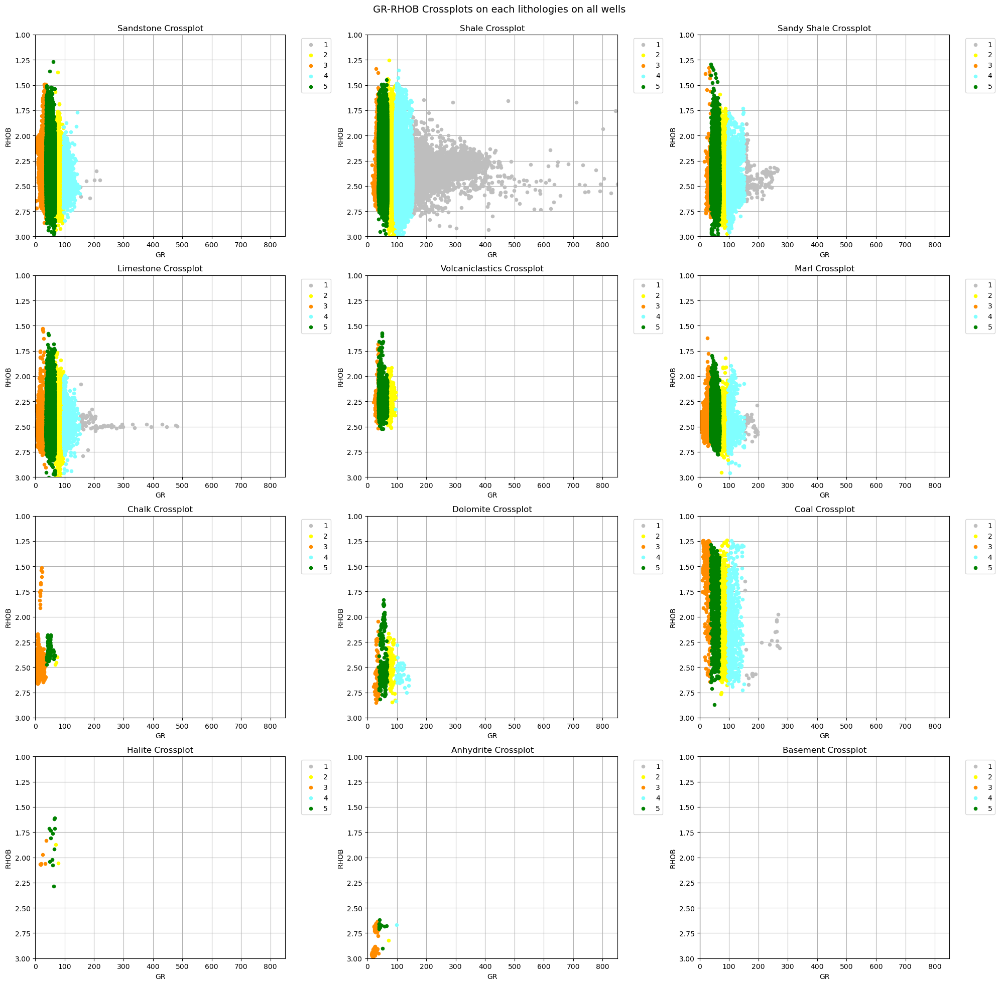

In [95]:
fig = plt.figure(figsize=(20,20))

for i, litho in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(litho+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('GR-RHOB Crossplots on each lithologies on all wells', fontsize=14)
    
    for key, group in grouped_kmeans:
        group[group['LIT'].isin([litho])].plot(ax=ax, kind='scatter', x='GR', y='RHOB', label=key, color=kmeanscolor[key])
    
    ax.set_ylim(3,1)
    ax.set_xlim(0, 850)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('GR')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotgrrhoblithology_mergedata_old.png', bbox_inches='tight')
plt.show()

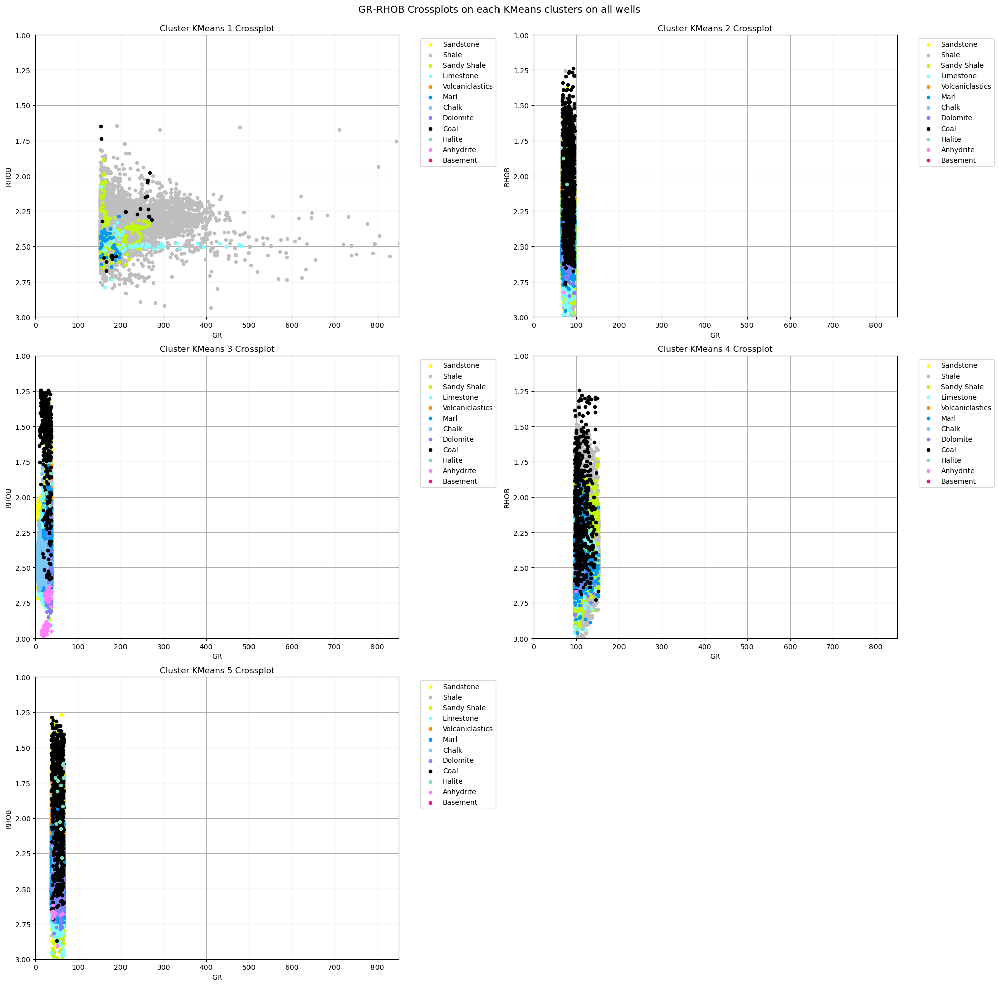

In [96]:
fig = plt.figure(figsize=(20,20))

for i, kmeans in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(kmeans)+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('GR-RHOB Crossplots on each KMeans clusters on all wells', fontsize=14)
    
    for key, group in grouped_lithology:
        group[group['KMeans'].isin([kmeans])].plot(ax=ax, kind='scatter', x='GR', y='RHOB', label=key, color=litocolor[key])
    
    ax.set_ylim(3,1)
    ax.set_xlim(0, 850)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('GR')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotgrrhobkmeans_mergedata_old.png', bbox_inches='tight')
plt.show()

#### PEF-RHOB


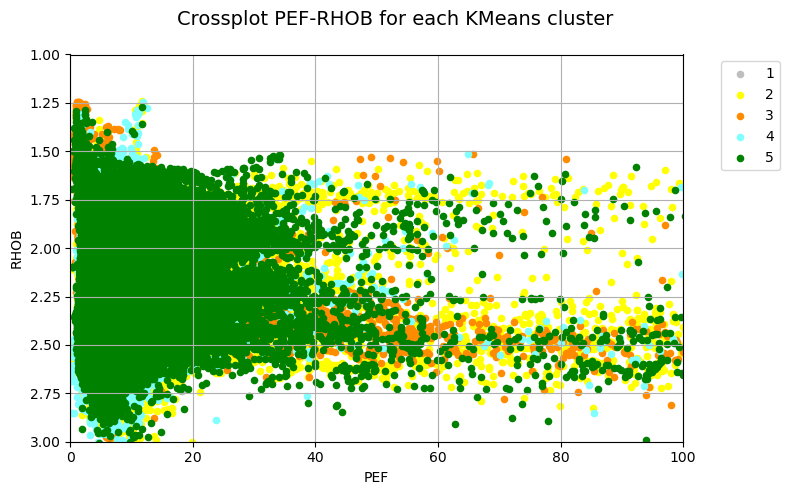

In [97]:
#Crossplot PEF-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot PEF-RHOB for each KMeans cluster', fontsize=14)
for key, group in grouped_kmeans:
    group.plot(ax=ax, kind='scatter', x='PEF', y='RHOB', label=key, color=kmeanscolor[key])
    
plt.ylim(3,1)
plt.xlim(0, 100)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('PEF')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotpefrhoball_kmeans_mergedata_old.png', bbox_inches='tight')
plt.show()

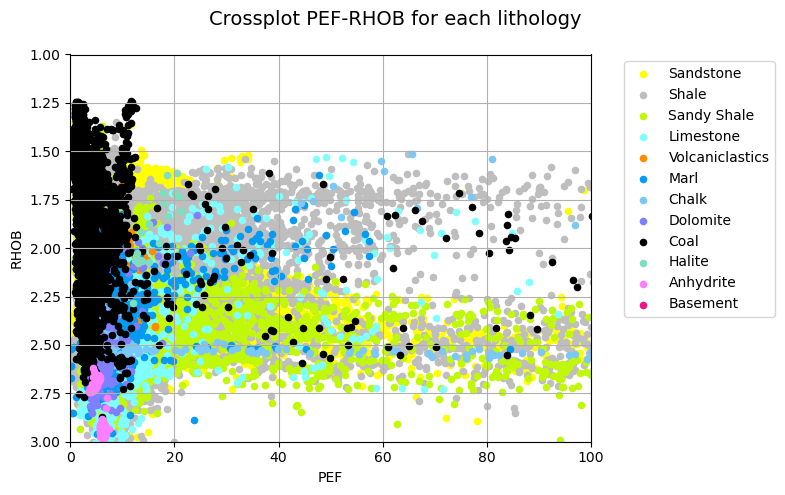

In [98]:
#Crossplot PEF-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot PEF-RHOB for each lithology', fontsize=14)
for key, group in grouped_lithology:
    group.plot(ax=ax, kind='scatter', x='PEF', y='RHOB', label=key, color=litocolor[key])
    
plt.ylim(3,1)
plt.xlim(0,100)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('PEF')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotpefrhoball_lithology_mergedata_old.png', bbox_inches='tight')
plt.show()

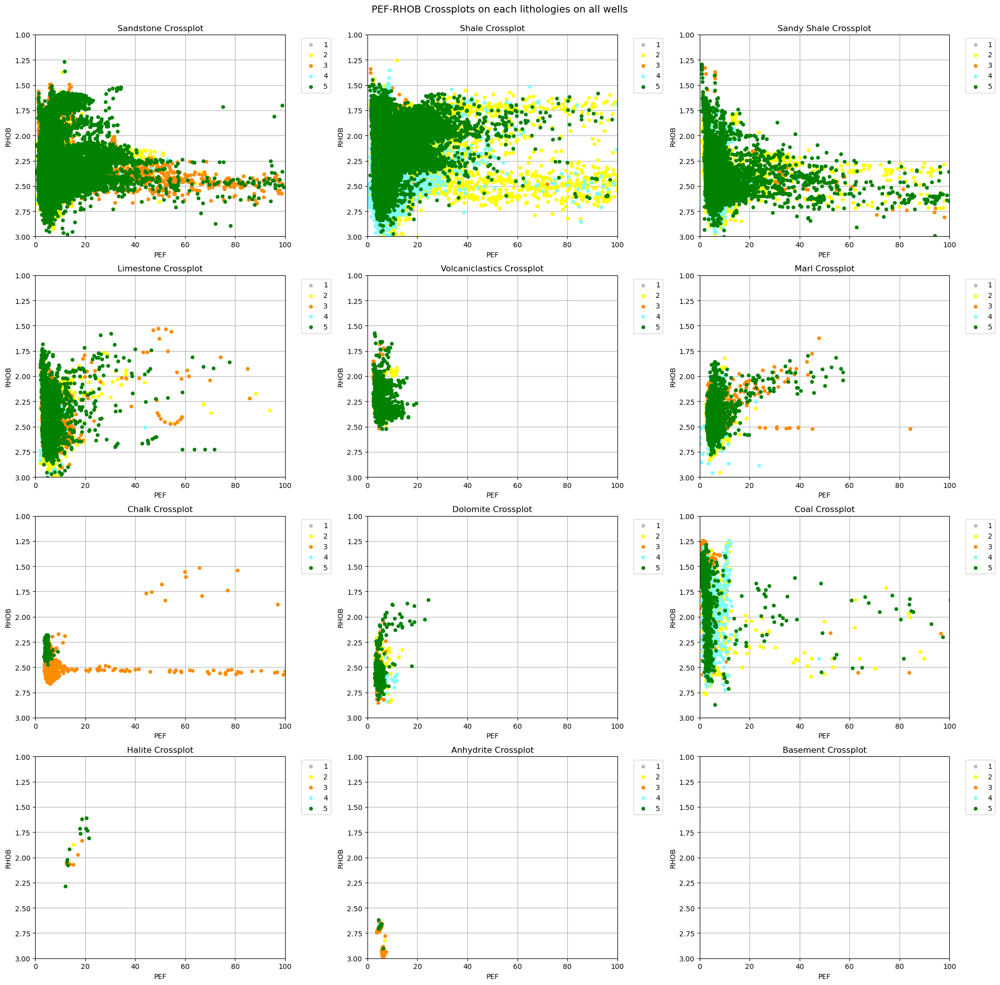

In [99]:
fig = plt.figure(figsize=(20,20))

for i, litho in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(litho+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('PEF-RHOB Crossplots on each lithologies on all wells', fontsize=14)
    
    for key, group in grouped_kmeans:
        group[group['LIT'].isin([litho])].plot(ax=ax, kind='scatter', x='PEF', y='RHOB', label=key, color=kmeanscolor[key])
    
    ax.set_ylim(3,1)
    ax.set_xlim(0, 100)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('PEF')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotpefrhoblithology_mergedata_old.png', bbox_inches='tight')
plt.show()

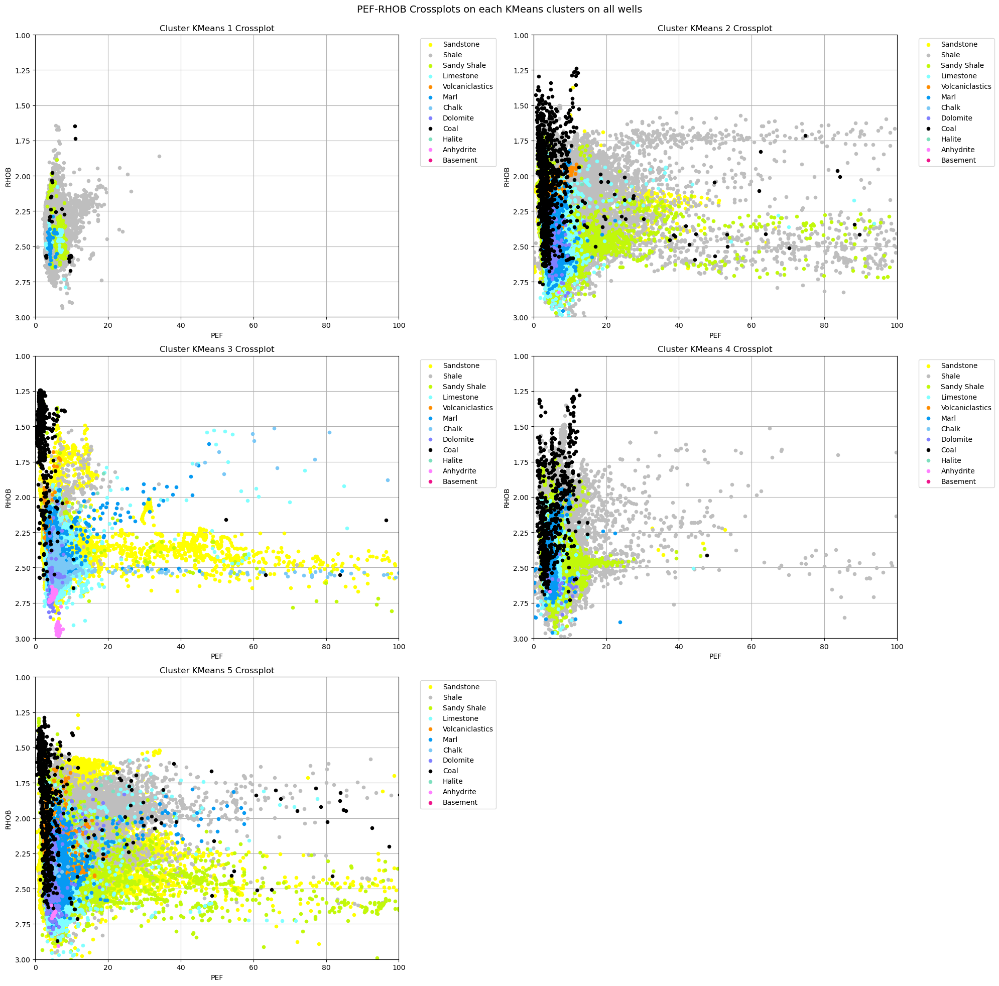

In [100]:
fig = plt.figure(figsize=(20,20))

for i, kmeans in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(kmeans)+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('PEF-RHOB Crossplots on each KMeans clusters on all wells', fontsize=14)
    
    for key, group in grouped_lithology:
        group[group['KMeans'].isin([kmeans])].plot(ax=ax, kind='scatter', x='PEF', y='RHOB', label=key, color=litocolor[key])
    
    ax.set_ylim(3,1)
    ax.set_xlim(0, 100)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('PEF')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotpefrhobkmeans_mergedata_old.png', bbox_inches='tight')
plt.show()

#### DTC-RHOB


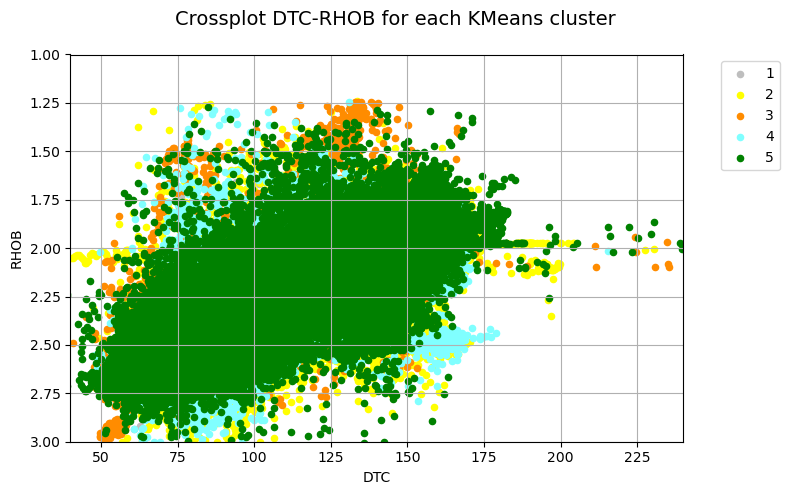

In [101]:
#Crossplot DTC-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot DTC-RHOB for each KMeans cluster', fontsize=14)
for key, group in grouped_kmeans:
    group.plot(ax=ax, kind='scatter', x='DTC', y='RHOB', label=key, color=kmeanscolor[key])
    
plt.ylim(3,1)
plt.xlim(40, 240)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('DTC')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotdtcrhoball_kmeans_mergedata_old.png', bbox_inches='tight')
plt.show()

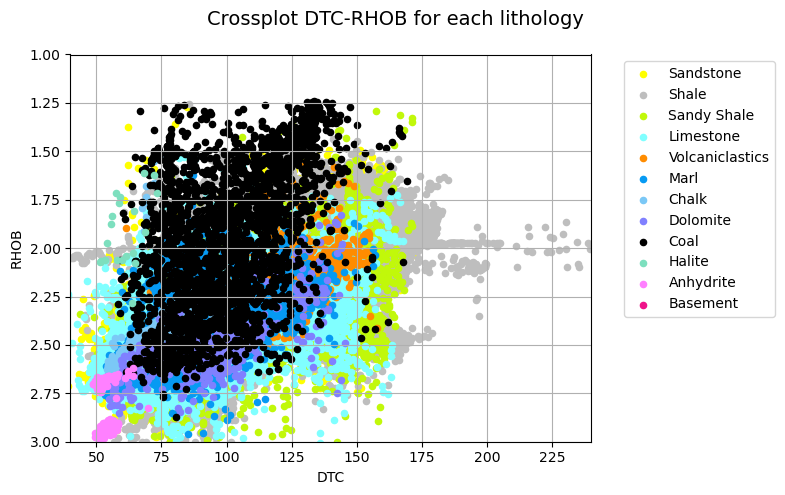

In [102]:
#Crossplot DTC-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot DTC-RHOB for each lithology', fontsize=14)
for key, group in grouped_lithology:
    group.plot(ax=ax, kind='scatter', x='DTC', y='RHOB', label=key, color=litocolor[key])
    
plt.ylim(3,1)
plt.xlim(40, 240)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('DTC')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotdtcrhoball_lithology_mergedata_old.png', bbox_inches='tight')
plt.show()

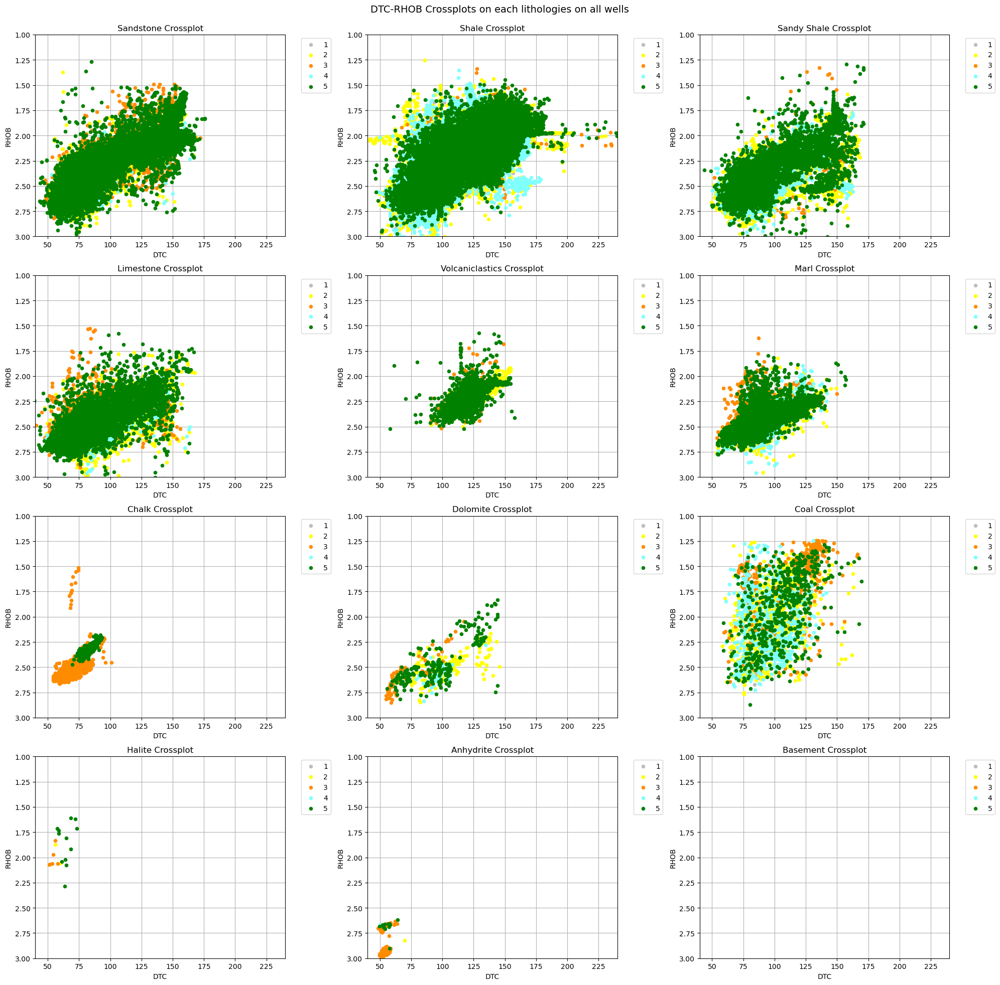

In [103]:
fig = plt.figure(figsize=(20,20))

for i, litho in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(litho+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('DTC-RHOB Crossplots on each lithologies on all wells', fontsize=14)
    
    for key, group in grouped_kmeans:
        group[group['LIT'].isin([litho])].plot(ax=ax, kind='scatter', x='DTC', y='RHOB', label=key, color=kmeanscolor[key])
    
    ax.set_ylim(3,1)
    ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('DTC')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotdtcrhoblithology_mergedata_old.png', bbox_inches='tight')
plt.show()

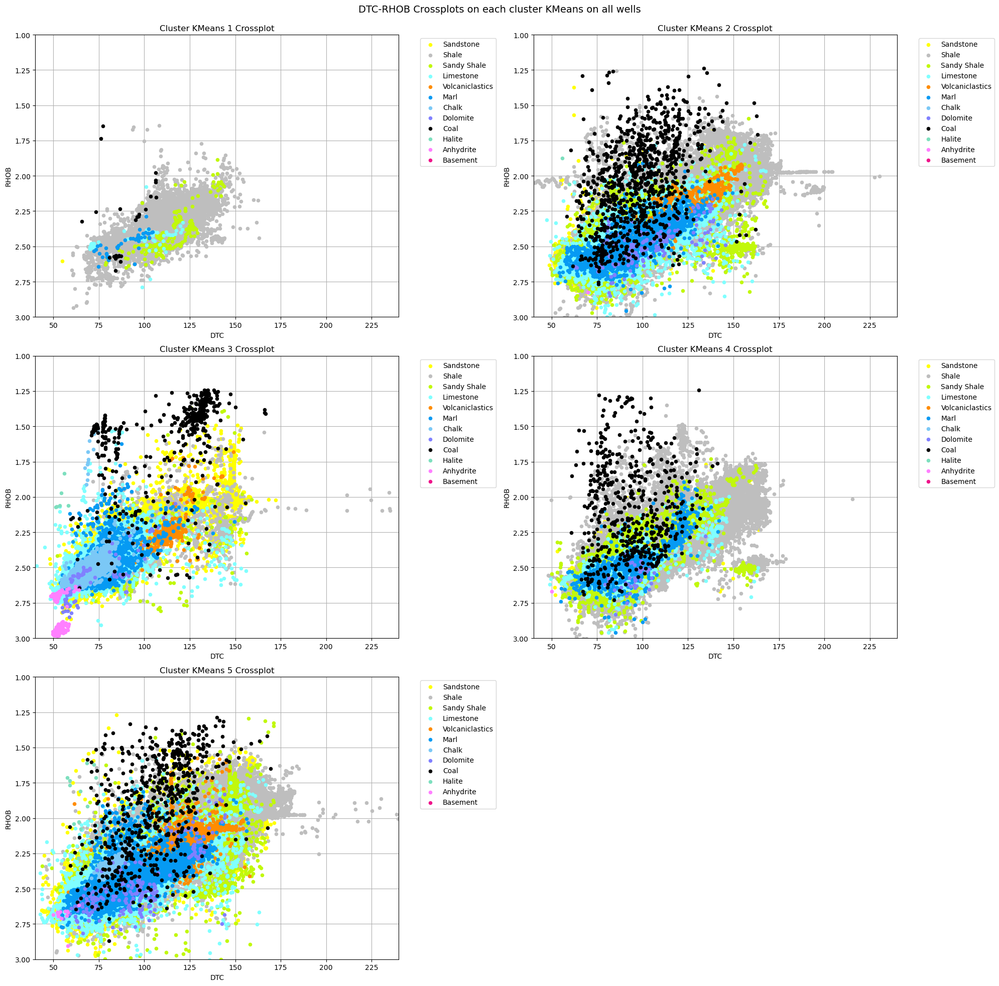

In [104]:
fig = plt.figure(figsize=(20,20))

for i, kmeans in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(kmeans)+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('DTC-RHOB Crossplots on each cluster KMeans on all wells', fontsize=14)
    
    for key, group in grouped_lithology:
        group[group['KMeans'].isin([kmeans])].plot(ax=ax, kind='scatter', x='DTC', y='RHOB', label=key, color=litocolor[key])
    
    ax.set_ylim(3,1)
    ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('DTC')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotdtcrhobkmeans_mergedata_old.png', bbox_inches='tight')
plt.show()

### Histograms


#### Histogram for cluster-lithology with frequency matrix (crosstab)


##### Frequency matrix

In [105]:
# calculate the distribution of `Clicked` per `Rank`
distribution1 = pd.crosstab(well_clustered.KMeans, well_clustered.LIT, normalize='index')
distribution1

LIT,Anhydrite,Chalk,Coal,Dolomite,Halite,Limestone,Marl,Sandstone,Sandy Shale,Shale,Volcaniclastics
KMeans,,,,,,,,,,,
1,0.000000,0.000000,0.002262,0.000000,0.000000,0.005696,0.003769,0.000586,0.016418,0.971268,0.000000
2,0.000005,0.000015,0.004452,0.000836,0.000010,0.019782,0.030424,0.091005,0.157403,0.692854,0.003213
3,0.004029,0.082276,0.010581,0.001859,0.000133,0.427076,0.047945,0.371760,0.013945,0.034420,0.005976
4,0.000009,0.000000,0.004516,0.000374,0.000000,0.007613,0.007500,0.022213,0.130518,0.827249,0.000009
5,0.000096,0.002299,0.004383,0.001641,0.000089,0.070301,0.056168,0.294264,0.115958,0.433890,0.020911


In [106]:
distribution2 = pd.crosstab(well_clustered.KMeans, well_clustered.LIT, normalize='columns')
distribution2

LIT,Anhydrite,Chalk,Coal,Dolomite,Halite,Limestone,Marl,Sandstone,Sandy Shale,Shale,Volcaniclastics
KMeans,,,,,,,,,,,
1,0.000000,0.000000,0.010796,0.000000,0.0,0.002019,0.002693,0.000091,0.003123,0.038078,0.000000
2,0.005076,0.000744,0.353459,0.322330,0.1,0.116641,0.361455,0.233958,0.497921,0.451795,0.170680
3,0.923858,0.922104,0.191124,0.163107,0.3,0.572930,0.129600,0.217450,0.010037,0.005107,0.072231
4,0.005076,0.000000,0.207517,0.083495,0.0,0.025983,0.051577,0.033055,0.238987,0.312243,0.000268
5,0.065990,0.077152,0.237105,0.431068,0.6,0.282427,0.454676,0.515446,0.249932,0.192776,0.756822


In [107]:
distribution3 = pd.crosstab(well_clustered.LIT, well_clustered.KMeans, normalize='index')
distribution3

KMeans,1,2,3,4,5
LIT,,,,,
Anhydrite,0.000000,0.005076,0.923858,0.005076,0.065990
Chalk,0.000000,0.000744,0.922104,0.000000,0.077152
Coal,0.010796,0.353459,0.191124,0.207517,0.237105
Dolomite,0.000000,0.322330,0.163107,0.083495,0.431068
Halite,0.000000,0.100000,0.300000,0.000000,0.600000
Limestone,0.002019,0.116641,0.572930,0.025983,0.282427
Marl,0.002693,0.361455,0.129600,0.051577,0.454676
Sandstone,0.000091,0.233958,0.217450,0.033055,0.515446
Sandy Shale,0.003123,0.497921,0.010037,0.238987,0.249932


In [108]:
distribution4 = pd.crosstab(well_clustered.LIT, well_clustered.KMeans, normalize='columns')
distribution4

KMeans,1,2,3,4,5
LIT,,,,,
Anhydrite,0.000000,0.000005,0.004029,0.000009,0.000096
Chalk,0.000000,0.000015,0.082276,0.000000,0.002299
Coal,0.002262,0.004452,0.010581,0.004516,0.004383
Dolomite,0.000000,0.000836,0.001859,0.000374,0.001641
Halite,0.000000,0.000010,0.000133,0.000000,0.000089
Limestone,0.005696,0.019782,0.427076,0.007613,0.070301
Marl,0.003769,0.030424,0.047945,0.007500,0.056168
Sandstone,0.000586,0.091005,0.371760,0.022213,0.294264
Sandy Shale,0.016418,0.157403,0.013945,0.130518,0.115958


##### Histogram result

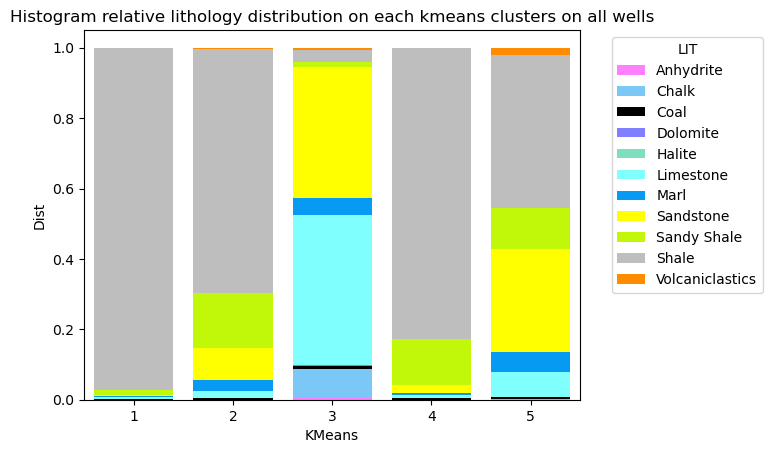

In [109]:
# plot the cumsum, with reverse hue order
ax=sns.barplot(data=distribution1.cumsum(axis=1).stack().reset_index(name='Dist'),
            x='KMeans', y='Dist', hue='LIT',
            hue_order = distribution1.columns[::-1],   # reverse hue order so that the taller bars got plotted first
            palette=litocolor, saturation=1, linewidth=1, 
            dodge=False)

sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0), reverse=True)
#plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram relative lithology distribution on each kmeans clusters on all wells")
plt.savefig('histogramrelative_lithologycount_mergedata_old.png', bbox_inches='tight')

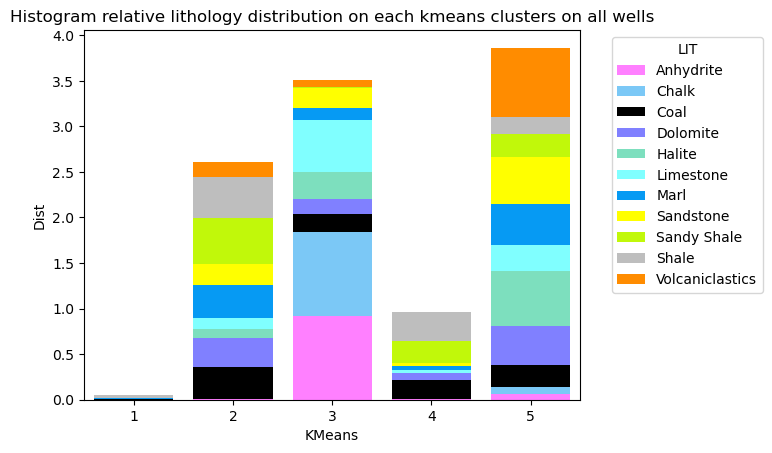

In [110]:
# plot the cumsum, with reverse hue order
ax=sns.barplot(data=distribution2.cumsum(axis=1).stack().reset_index(name='Dist'),
            x='KMeans', y='Dist', hue='LIT',
            hue_order = distribution2.columns[::-1],   # reverse hue order so that the taller bars got plotted first
            palette=litocolor, saturation=1,
            dodge=False)

sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0), reverse=True)
#plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram relative lithology distribution on each kmeans clusters on all wells")
plt.savefig('histogramrelative_lithologyproportion_mergedata_old.png', bbox_inches='tight')

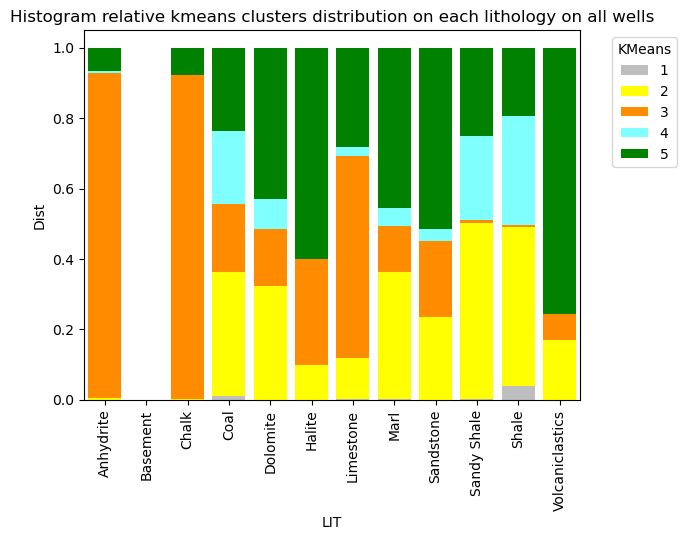

In [111]:
# plot the cumsum, with reverse hue order
ax=sns.barplot(data=distribution3.cumsum(axis=1).stack().reset_index(name='Dist'),
            x='LIT', y='Dist', hue='KMeans',
            hue_order = distribution3.columns[::-1],   # reverse hue order so that the taller bars got plotted first
            palette=kmeanscolor, saturation=1,
            dodge=False)

sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0), reverse=True)
plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram relative kmeans clusters distribution on each lithology on all wells")
plt.savefig('histogramrelative_kmeanscount_mergedata_old.png', bbox_inches='tight')

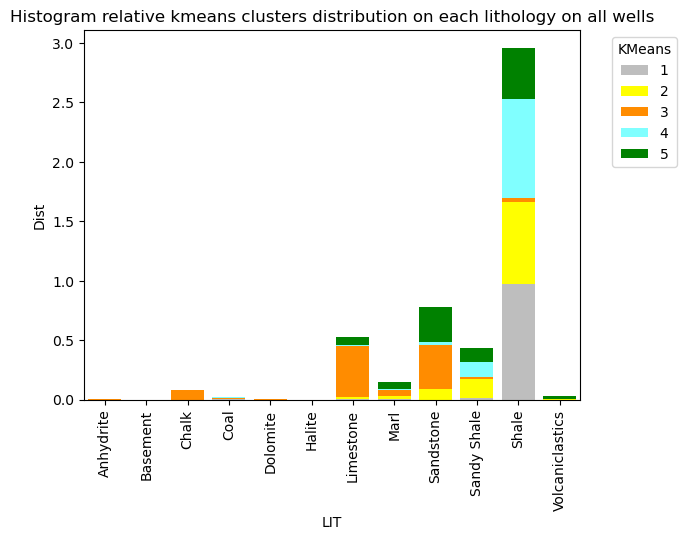

In [112]:
# plot the cumsum, with reverse hue order
ax=sns.barplot(data=distribution4.cumsum(axis=1).stack().reset_index(name='Dist'),
            x='LIT', y='Dist', hue='KMeans',
            hue_order = distribution4.columns[::-1],   # reverse hue order so that the taller bars got plotted first
            palette=kmeanscolor, saturation=1,
            dodge=False)

sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0), reverse=True)
plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram relative kmeans clusters distribution on each lithology on all wells")
plt.savefig('histogramrelative_kmeansproportion_mergedata_old.png', bbox_inches='tight')

#### Histogram for cluster-lithology


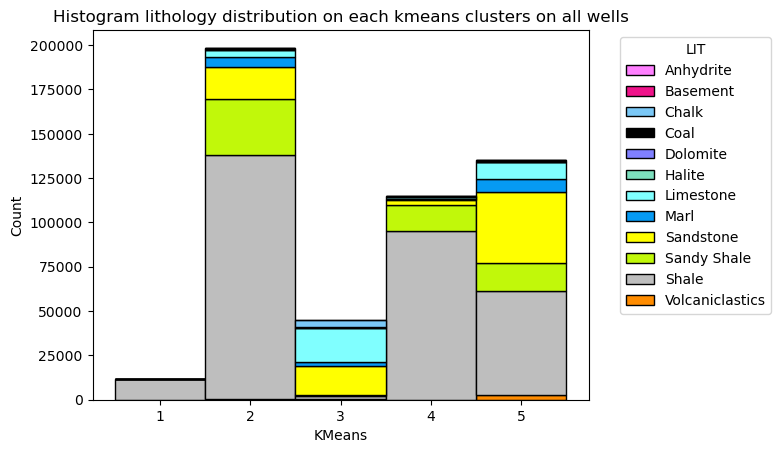

In [113]:
ax=sns.histplot(data=well_clustered, x='KMeans', hue='LIT', stat='count', multiple='stack', alpha=1, discrete=True, fill=True,  palette=litocolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.title("Histogram lithology distribution on each kmeans clusters on all wells")
plt.savefig('histogramlithologykmeans_stackcount_mergedata_old.png', bbox_inches='tight')

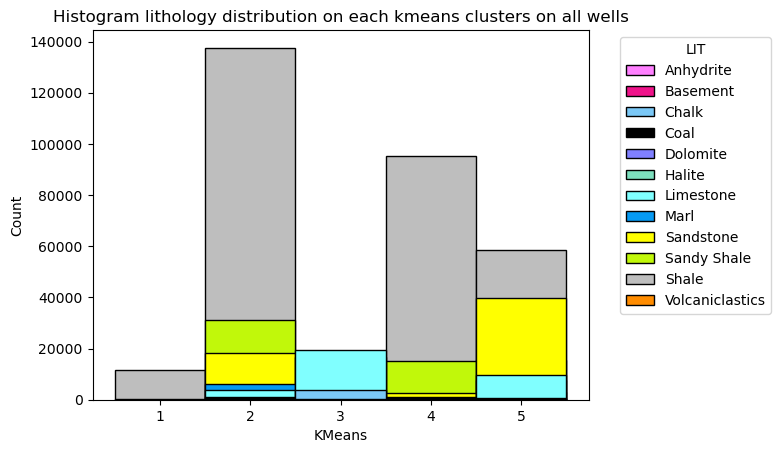

In [114]:
ax=sns.histplot(data=well_clustered, x='KMeans', hue='LIT', stat='count', multiple='layer', alpha=1, discrete=True, fill=True,  palette=litocolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.title("Histogram lithology distribution on each kmeans clusters on all wells")
plt.savefig('histogramlithologykmeans_layercount_mergedata_old.png', bbox_inches='tight')

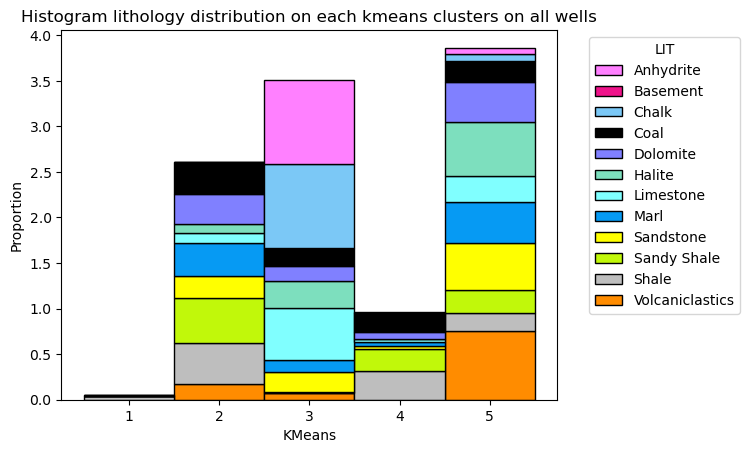

In [115]:
ax=sns.histplot(data=well_clustered, x='KMeans', hue='LIT', stat='proportion', multiple='stack', alpha=1, discrete=True, fill=True,  palette=litocolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.title("Histogram lithology distribution on each kmeans clusters on all wells")
plt.savefig('histogramlithologykmeans_stackproportion_mergedata_old.png', bbox_inches='tight')

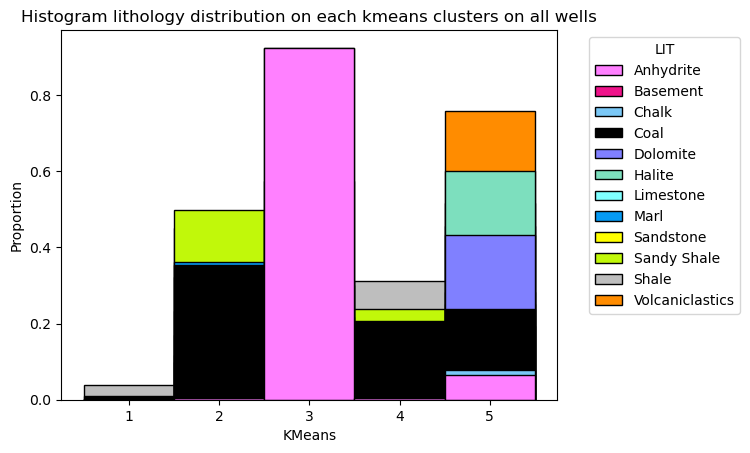

In [116]:
ax=sns.histplot(data=well_clustered, x='KMeans', hue='LIT', stat='proportion', multiple='layer', alpha=1, discrete=True, fill=True,  palette=litocolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.title("Histogram lithology distribution on each kmeans clusters on all wells")
plt.savefig('histogramlithologykmeans_layerproportion_old.png', bbox_inches='tight')

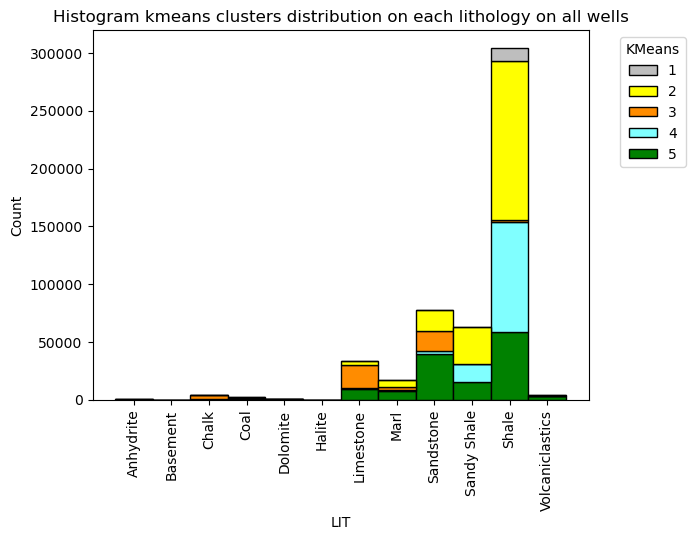

In [117]:
ax=sns.histplot(data=well_clustered, x='LIT', hue='KMeans', stat='count', multiple='stack', alpha=1, discrete=True, fill=True,  palette=kmeanscolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram kmeans clusters distribution on each lithology on all wells")
plt.savefig('histogramkmeanslithology_stackcount_mergedata_old.png', bbox_inches='tight')

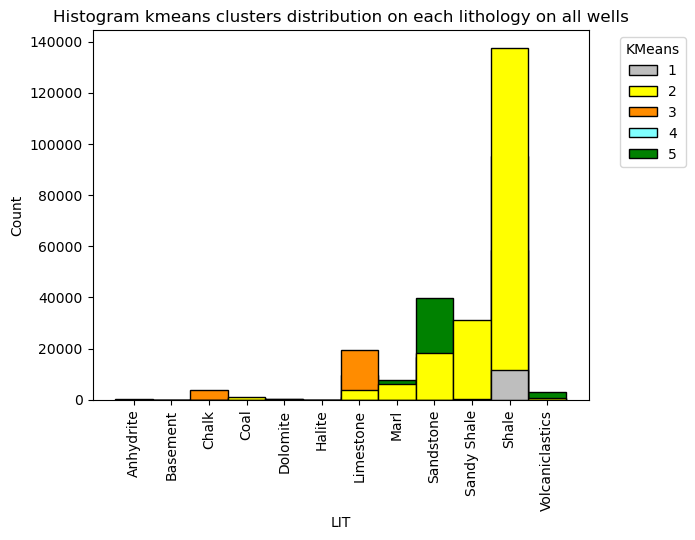

In [118]:
ax=sns.histplot(data=well_clustered, x='LIT', hue='KMeans', stat='count', multiple='layer', alpha=1, discrete=True, fill=True,  palette=kmeanscolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram kmeans clusters distribution on each lithology on all wells")
plt.savefig('histogramkmeanslithology_layercount_mergedata_old.png', bbox_inches='tight')

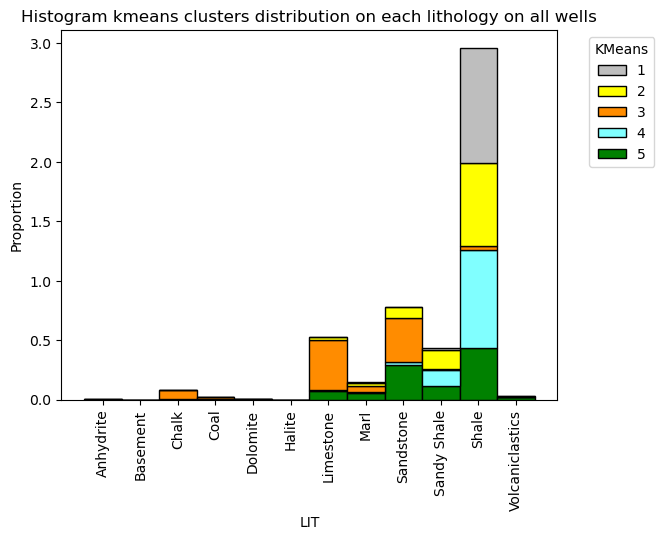

In [119]:
ax=sns.histplot(data=well_clustered, x='LIT', hue='KMeans', stat='proportion', multiple='stack', alpha=1, discrete=True, fill=True,  palette=kmeanscolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram kmeans clusters distribution on each lithology on all wells")
plt.savefig('histogramkmeanslithology_stackproportion_mergedata_old.png', bbox_inches='tight')

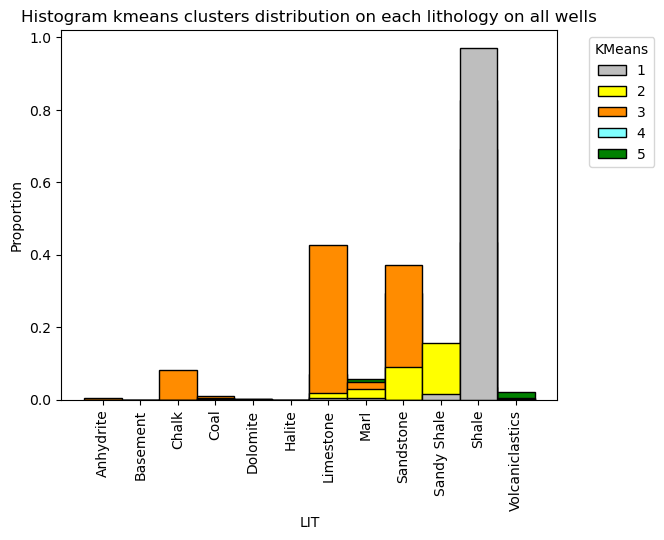

In [120]:
ax=sns.histplot(data=well_clustered, x='LIT', hue='KMeans', stat='proportion', multiple='layer', alpha=1, discrete=True, fill=True,  palette=kmeanscolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram kmeans clusters distribution on each lithology on all wells")
plt.savefig('histogramkmeanslithology_proportion_mergedata_old.png', bbox_inches='tight')

#### Histogram for cluster-lithology (detail)


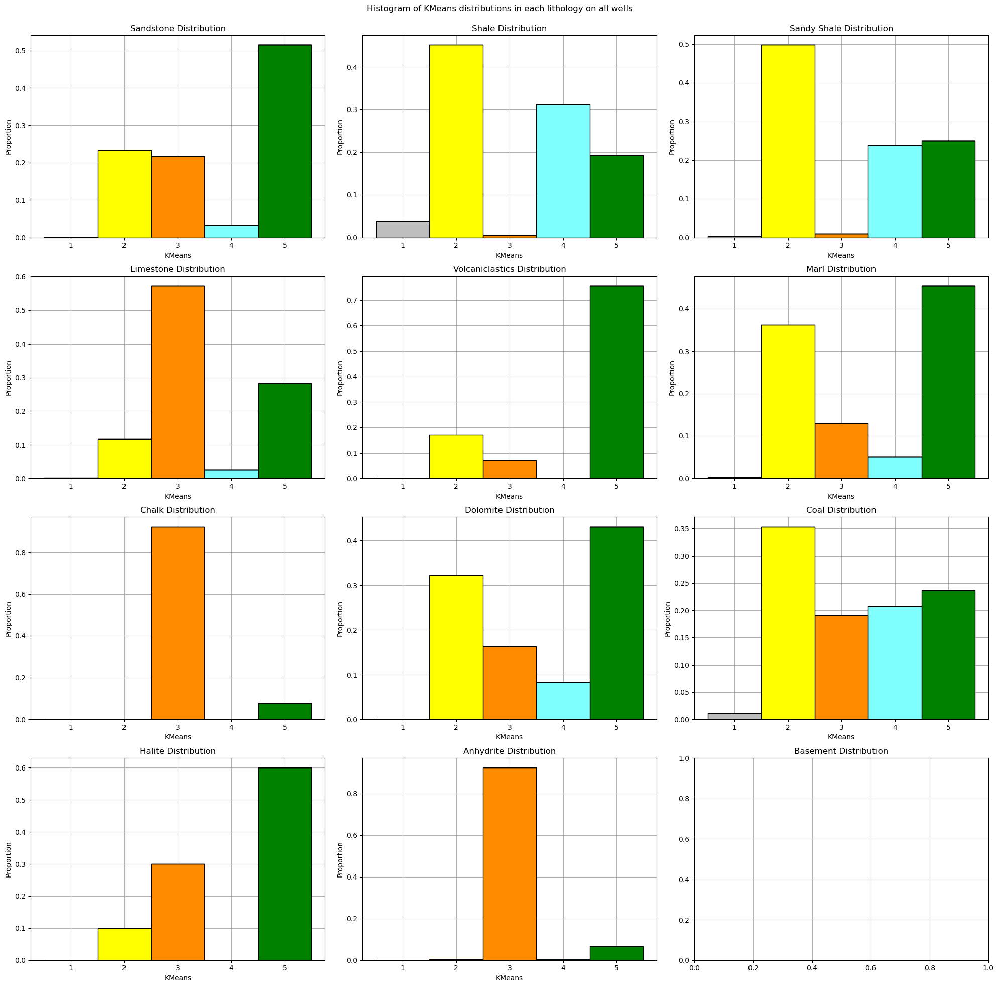

In [121]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of KMeans distributions in each lithology on all wells')

for i, feature in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    
    
    if well_clustered[well_clustered['LIT']==feature]['KMeans'].unique().sum()==0:
        pass
    else:
        ax=sns.histplot(data=well_clustered[well_clustered['LIT']==feature], x='KMeans', hue='KMeans', palette=kmeanscolor, stat='proportion', multiple='stack', alpha=1, discrete=True, binrange=(1,5), fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramkmeans_stackproportion_mergedata_old.png', bbox_inches='tight')
plt.show()

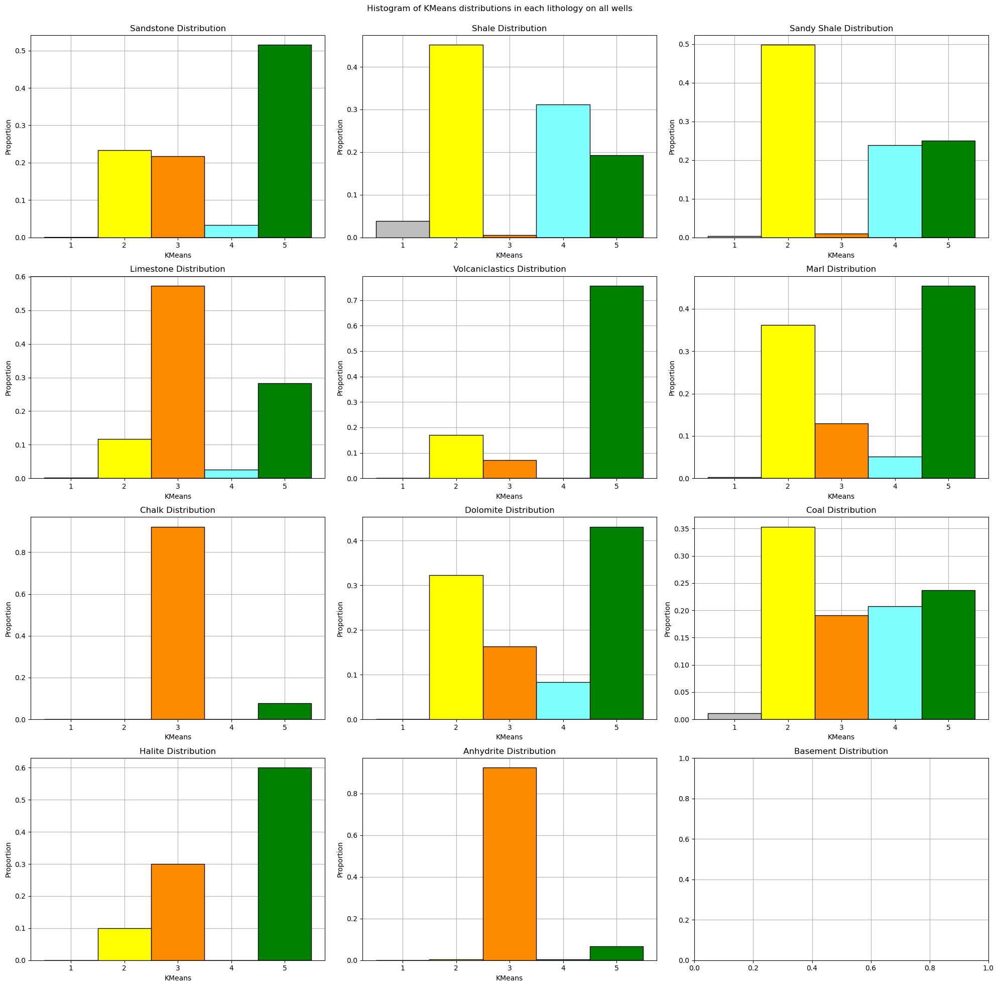

In [122]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of KMeans distributions in each lithology on all wells')

for i, feature in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    
    
    if well_clustered[well_clustered['LIT']==feature]['KMeans'].unique().sum()==0:
        pass
    else:
        ax=sns.histplot(data=well_clustered[well_clustered['LIT']==feature], x='KMeans', hue='KMeans', palette=kmeanscolor, stat='proportion', multiple='layer', alpha=1, discrete=True, binrange=(1,5), fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramkmeans_layerproportion_mergedata_old.png', bbox_inches='tight')
plt.show()

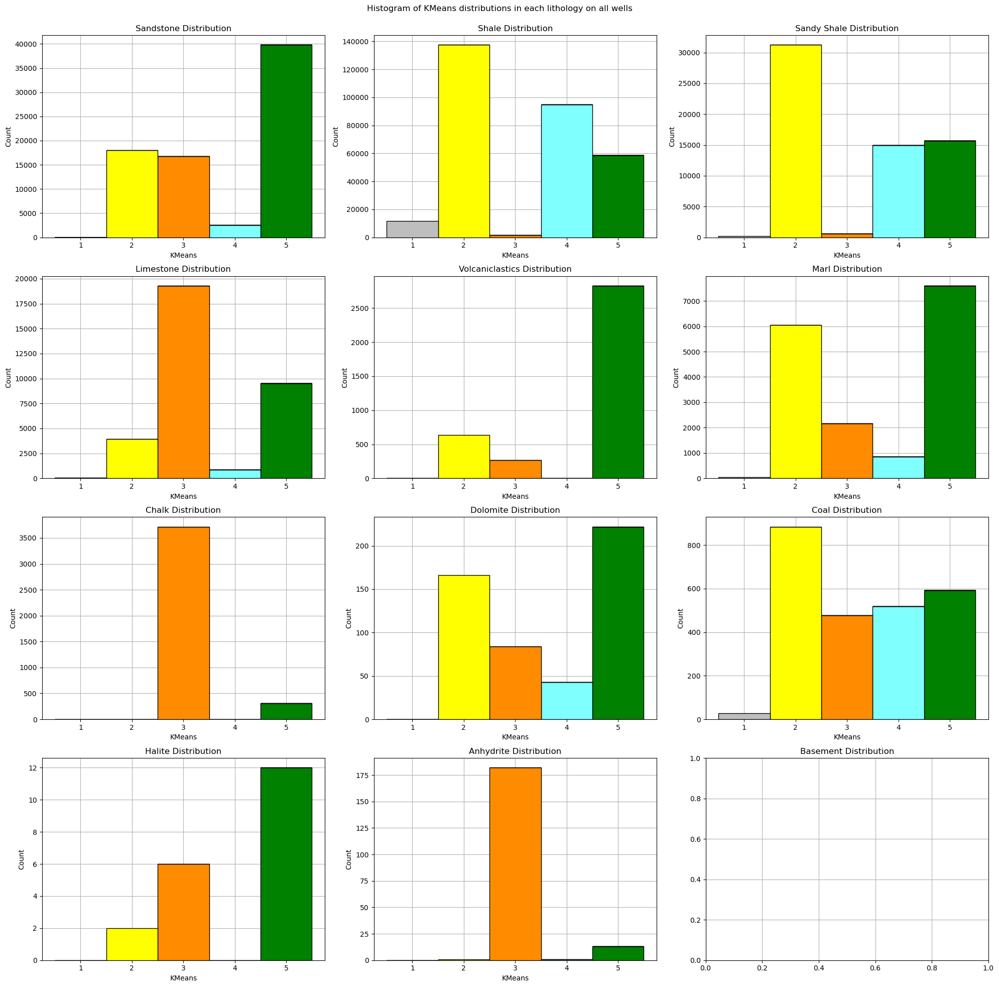

In [123]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of KMeans distributions in each lithology on all wells')

for i, feature in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    
    
    if well_clustered[well_clustered['LIT']==feature]['KMeans'].unique().sum()==0:
        pass
    else:
        ax=sns.histplot(data=well_clustered[well_clustered['LIT']==feature], x='KMeans', hue='KMeans', palette=kmeanscolor, stat='count', multiple='stack', alpha=1, discrete=True, binrange=(1,5), fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramkmeans_stackcount_mergedata_old.png', bbox_inches='tight')
plt.show()

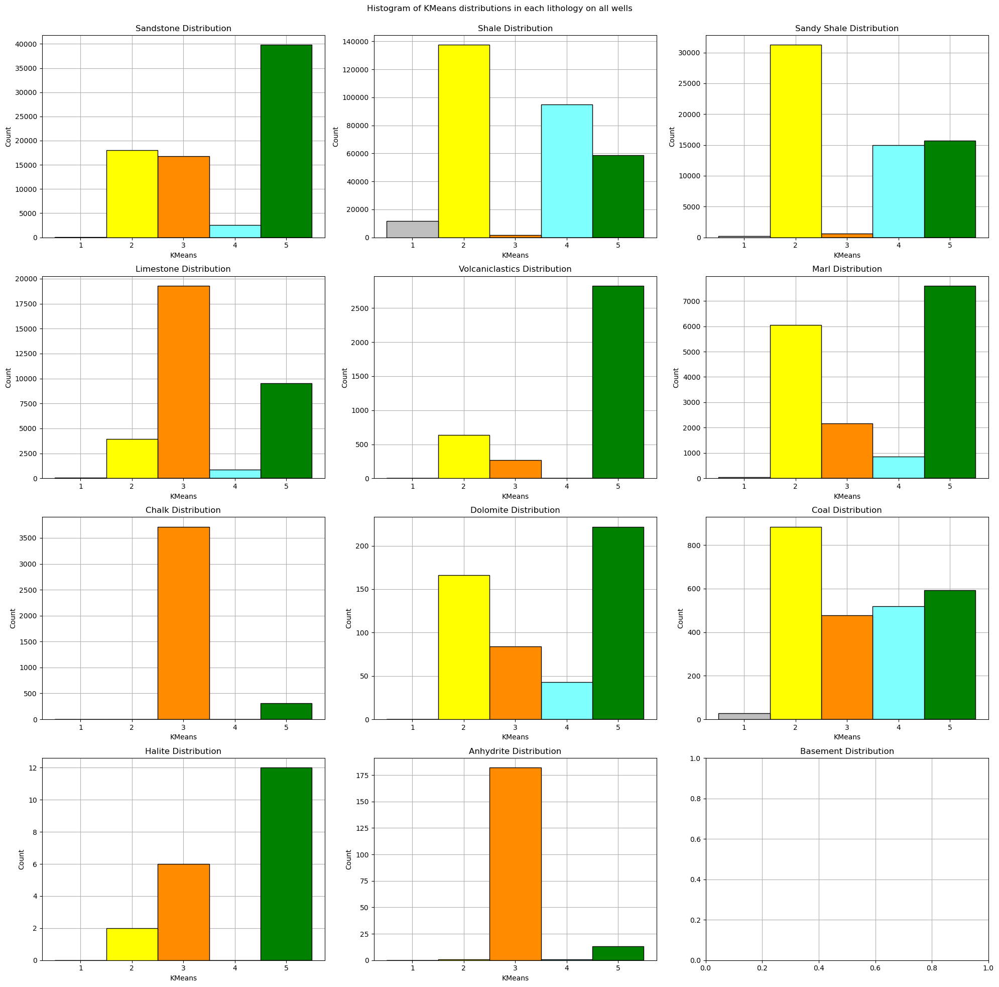

In [124]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of KMeans distributions in each lithology on all wells')

for i, feature in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    
    
    if well_clustered[well_clustered['LIT']==feature]['KMeans'].unique().sum()==0:
        pass
    else:
        ax=sns.histplot(data=well_clustered[well_clustered['LIT']==feature], x='KMeans', hue='KMeans', palette=kmeanscolor, stat='count', multiple='layer', alpha=1, discrete=True, binrange=(1,5), fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramkmeans_layercount_mergedata_old.png', bbox_inches='tight')
plt.show()

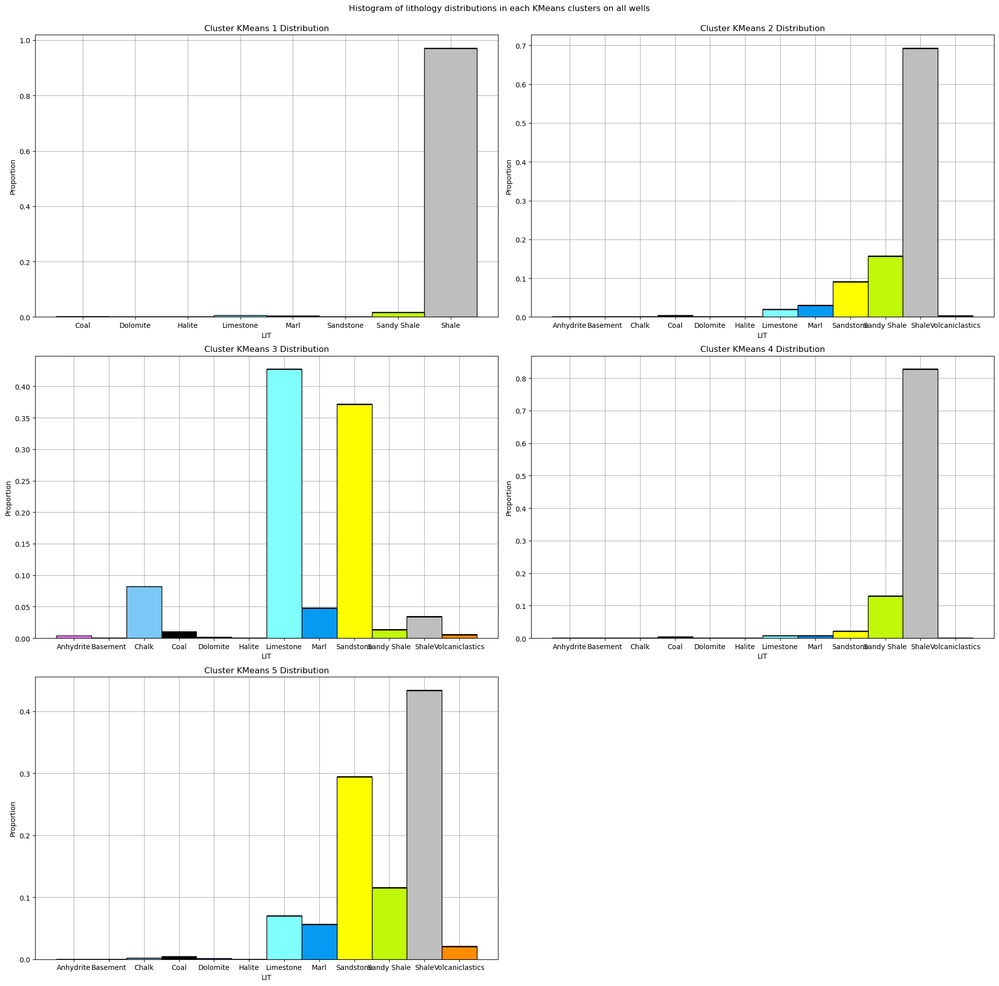

In [125]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of lithology distributions in each KMeans clusters on all wells')

for i, feature in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(feature)+" Distribution")
    ax.set_axisbelow(True)
    
    
    ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==feature], x='LIT', hue='LIT', palette=litocolor, stat='proportion', multiple='stack', alpha=1, discrete=True, fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramlithology_stackproportion_mergedata_old.png', bbox_inches='tight')
plt.show()

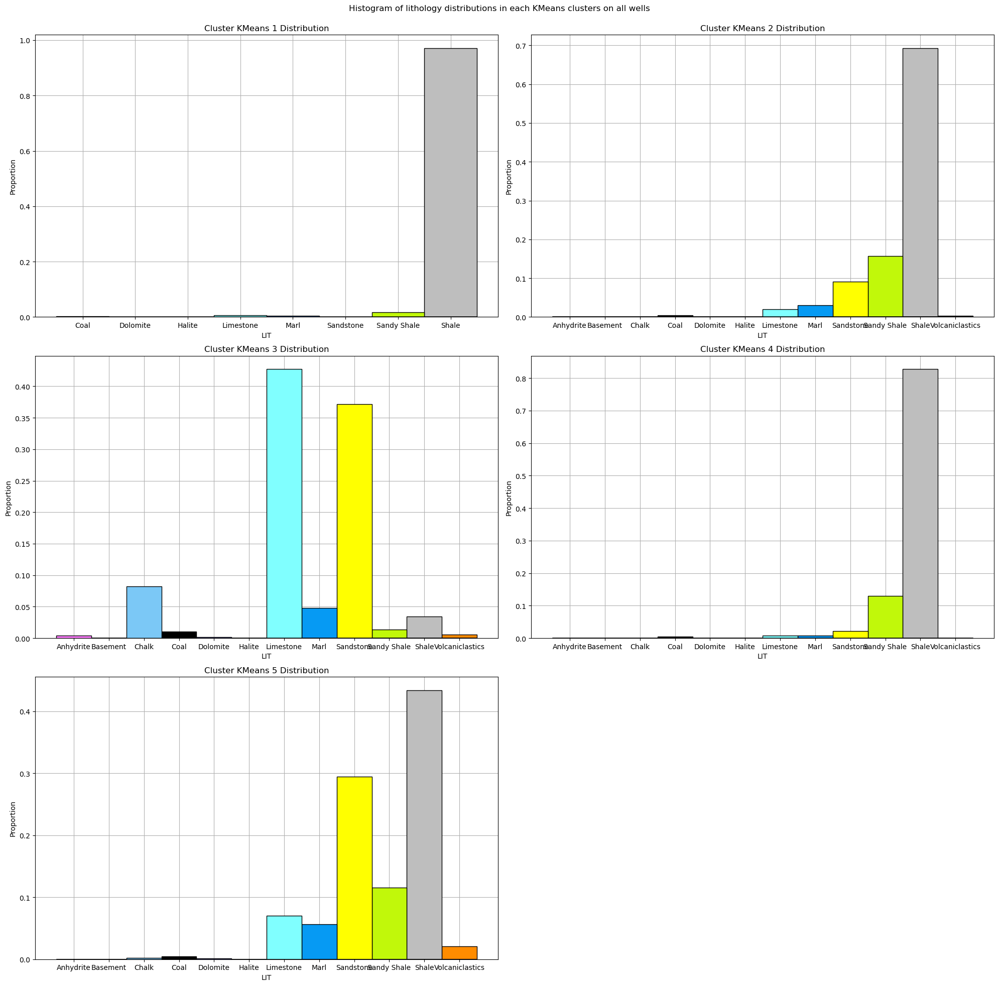

In [126]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of lithology distributions in each KMeans clusters on all wells')

for i, feature in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(feature)+" Distribution")
    ax.set_axisbelow(True)
    
    
    ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==feature], x='LIT', hue='LIT', palette=litocolor, stat='proportion', multiple='layer', alpha=1, discrete=True, fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramlithology_layerproportion_mergedata_old.png', bbox_inches='tight')
plt.show()

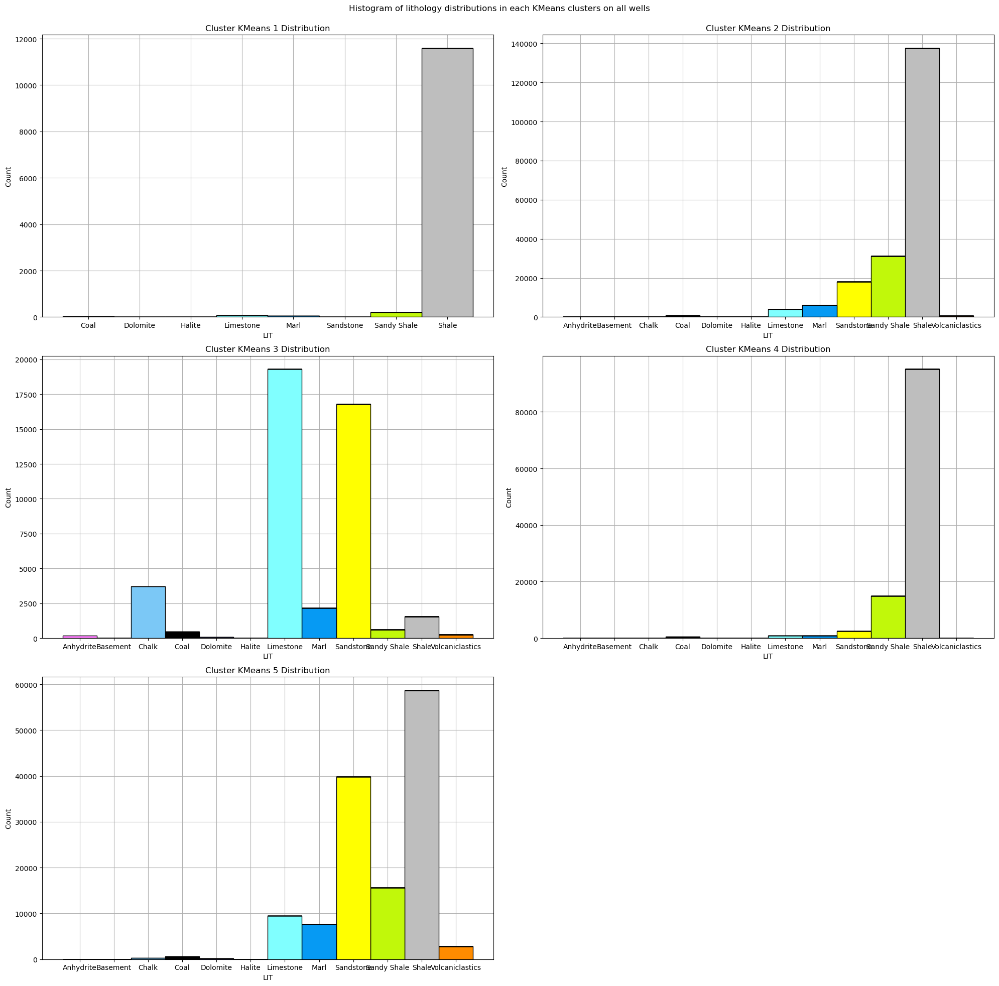

In [127]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of lithology distributions in each KMeans clusters on all wells')

for i, feature in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(feature)+" Distribution")
    ax.set_axisbelow(True)
    
    
    ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==feature], x='LIT', hue='LIT', palette=litocolor, stat='count', multiple='stack', alpha=1, discrete=True, fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramlithology_stackcount_mergedata_old.png', bbox_inches='tight')
plt.show()

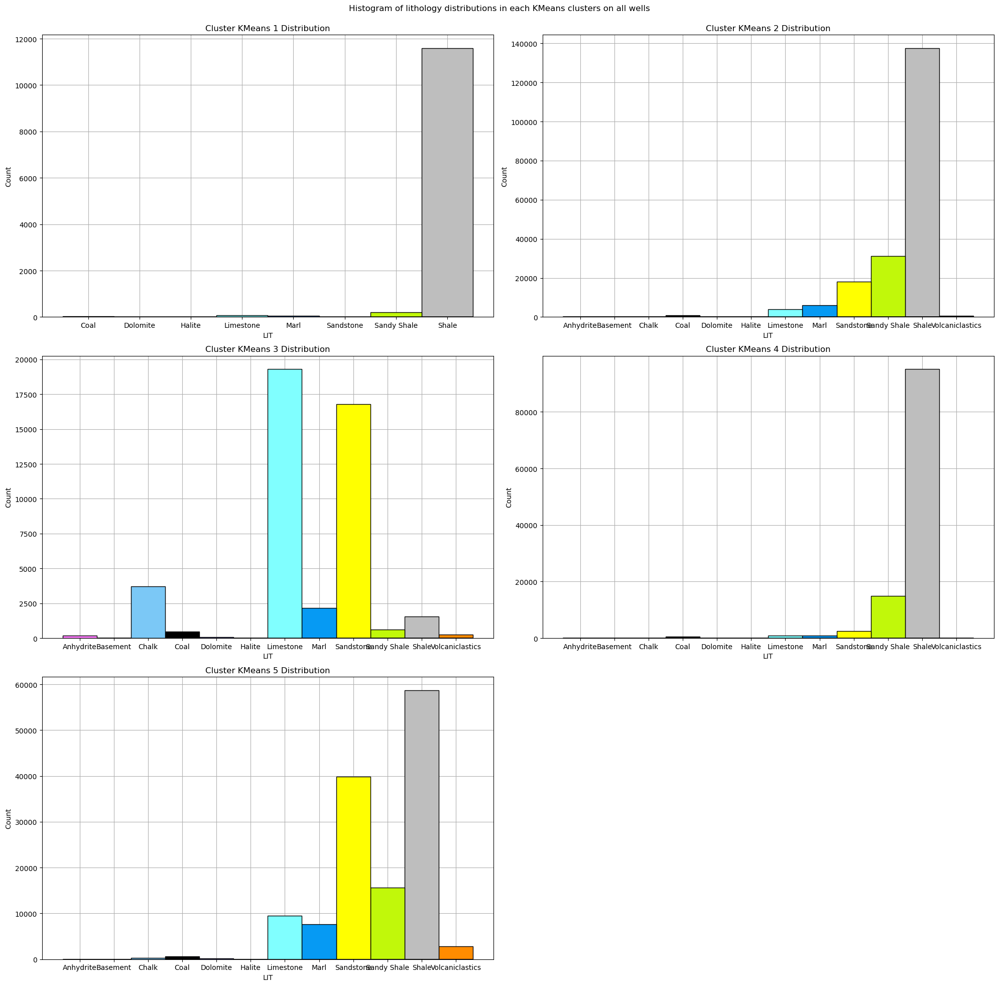

In [128]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of lithology distributions in each KMeans clusters on all wells')

for i, feature in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(feature)+" Distribution")
    ax.set_axisbelow(True)
    
    
    ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==feature], x='LIT', hue='LIT', palette=litocolor, stat='count', multiple='layer', alpha=1, discrete=True, fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramlithology_layercount_mergedata_old.png', bbox_inches='tight')
plt.show()

#### Histogram for each well logs (cluster group, lithology hue)


##### On all clusters

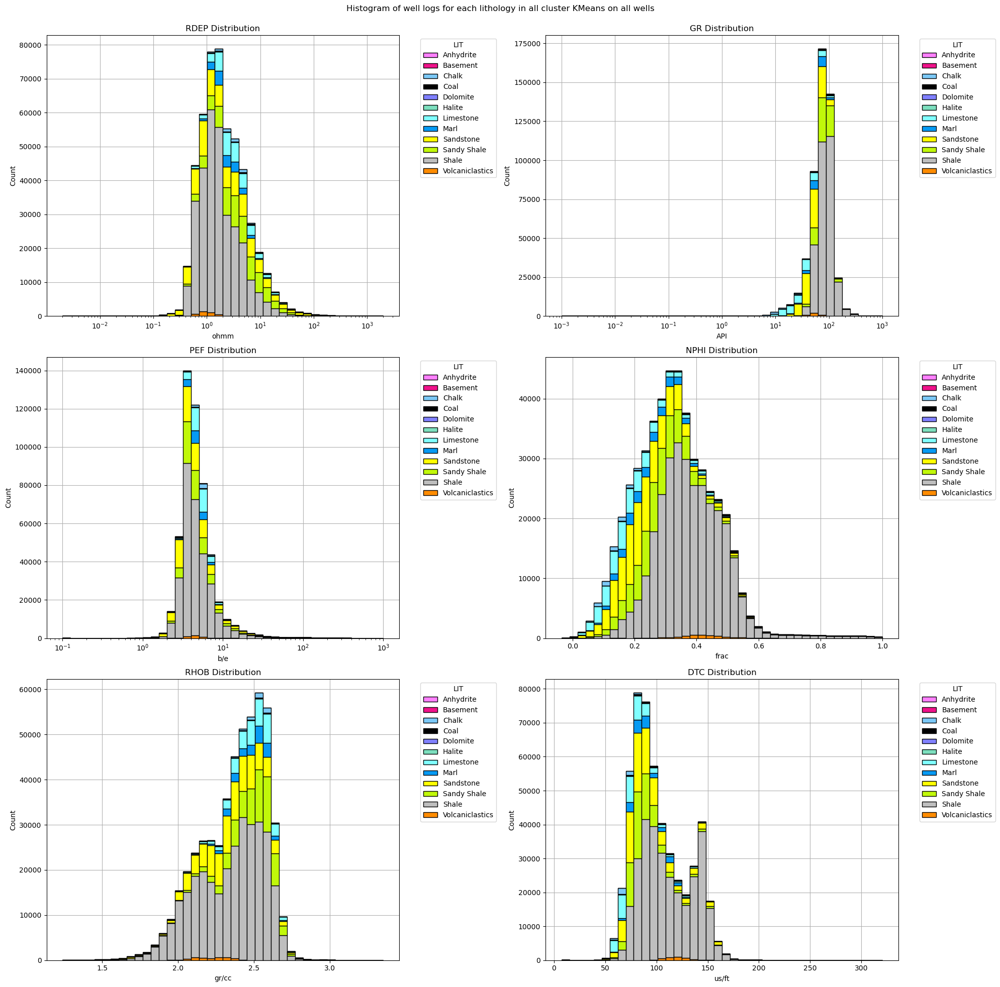

In [129]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each lithology in all cluster KMeans on all wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
  
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')

    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwellloglithology_allclusters_stackcount_mergedata_old.png', bbox_inches='tight')
plt.show()

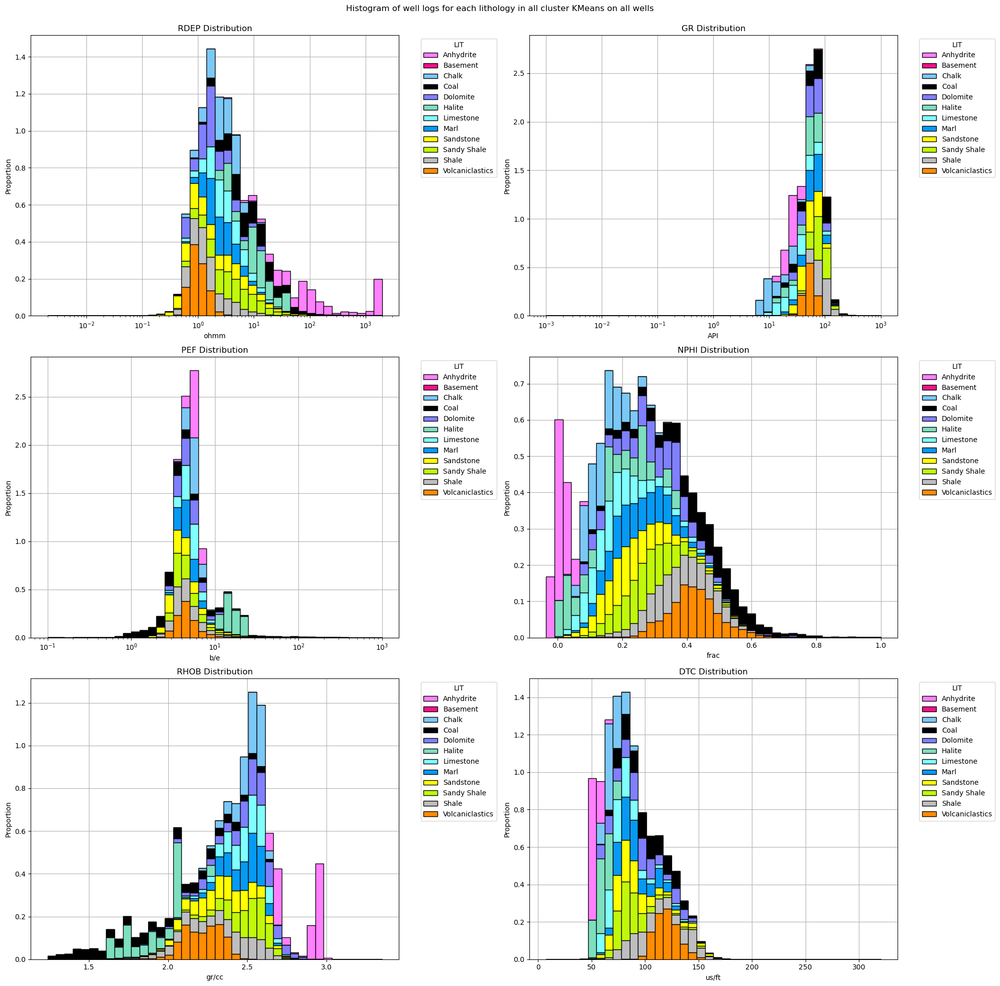

In [130]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each lithology in all cluster KMeans on all wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
  
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')

    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwellloglithology_allclusters_stackproportion_mergedata_old.png', bbox_inches='tight')
plt.show()

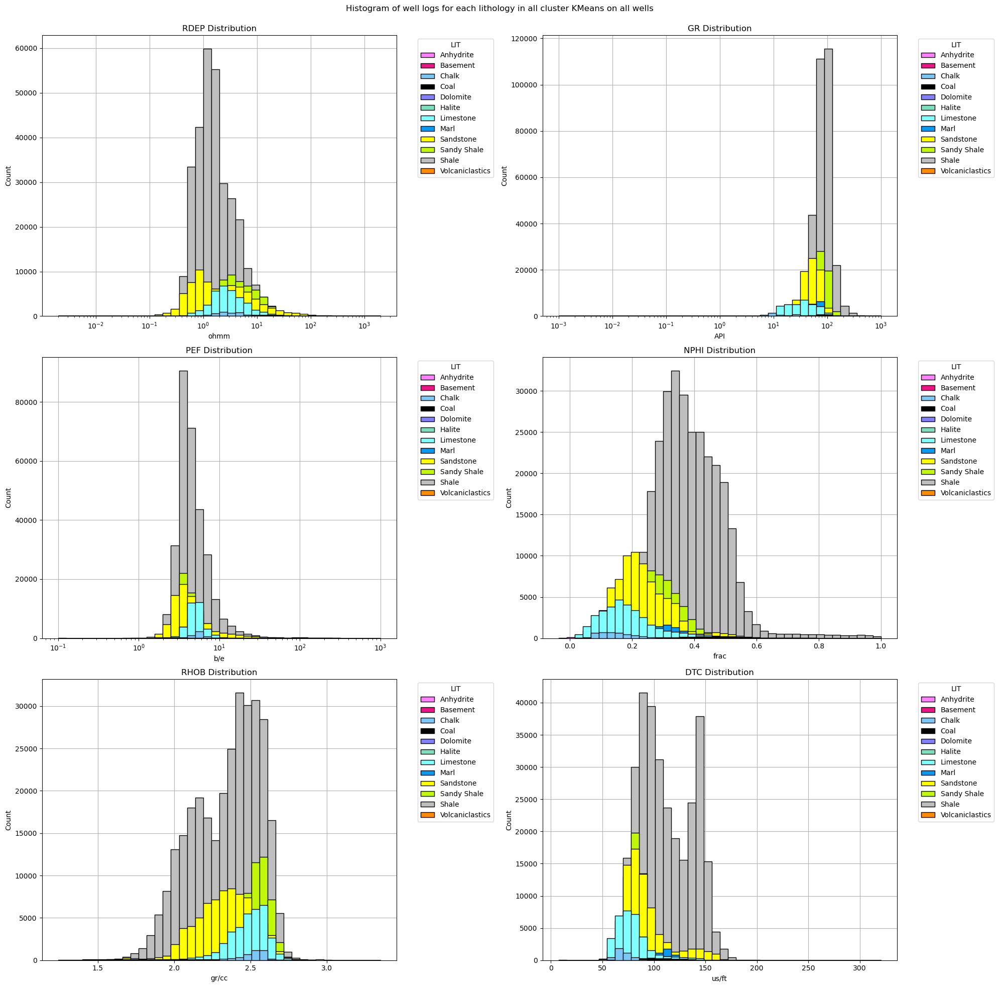

In [131]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each lithology in all cluster KMeans on all wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
  
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')

    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwellloglithology_allclusters_layercount_mergedata_old.png', bbox_inches='tight')
plt.show()

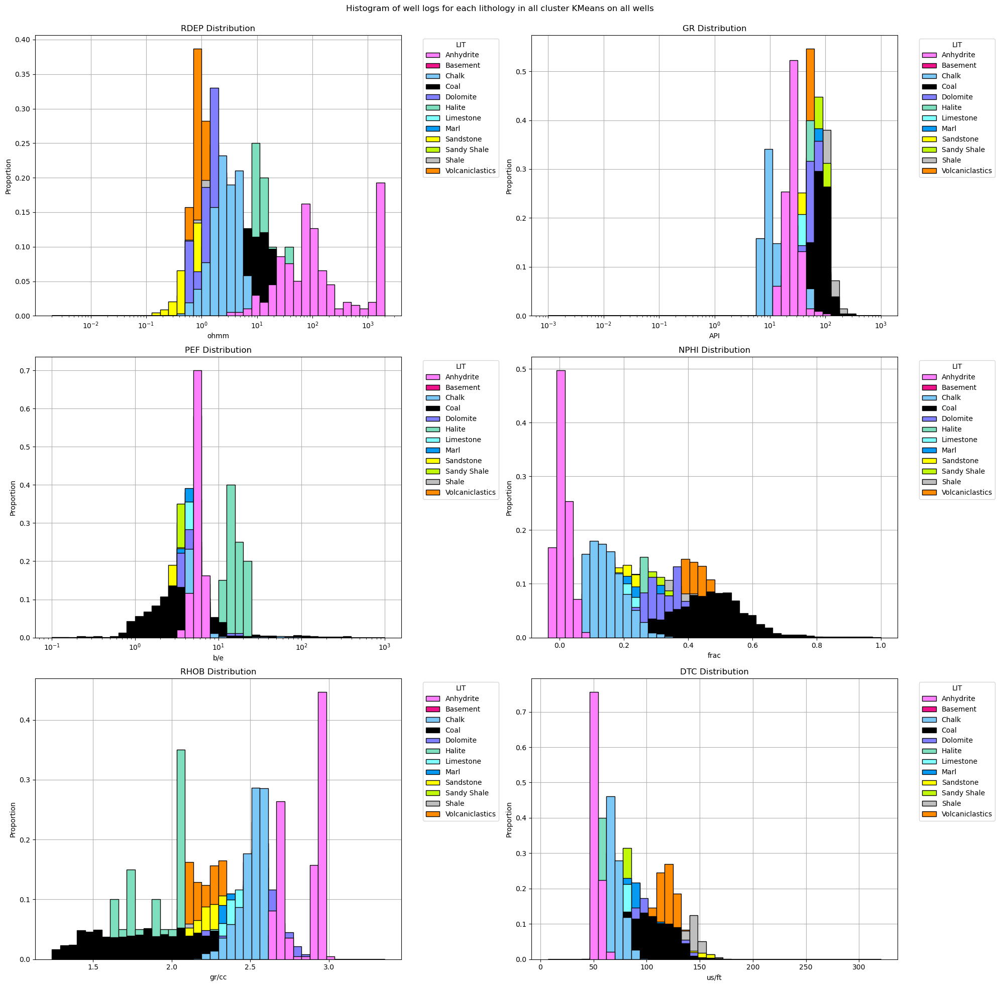

In [132]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each lithology in all cluster KMeans on all wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
  
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')

    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwellloglithology_allclusters_layerproportion_mergedata_old.png', bbox_inches='tight')
plt.show()

##### On each cluster KMeans

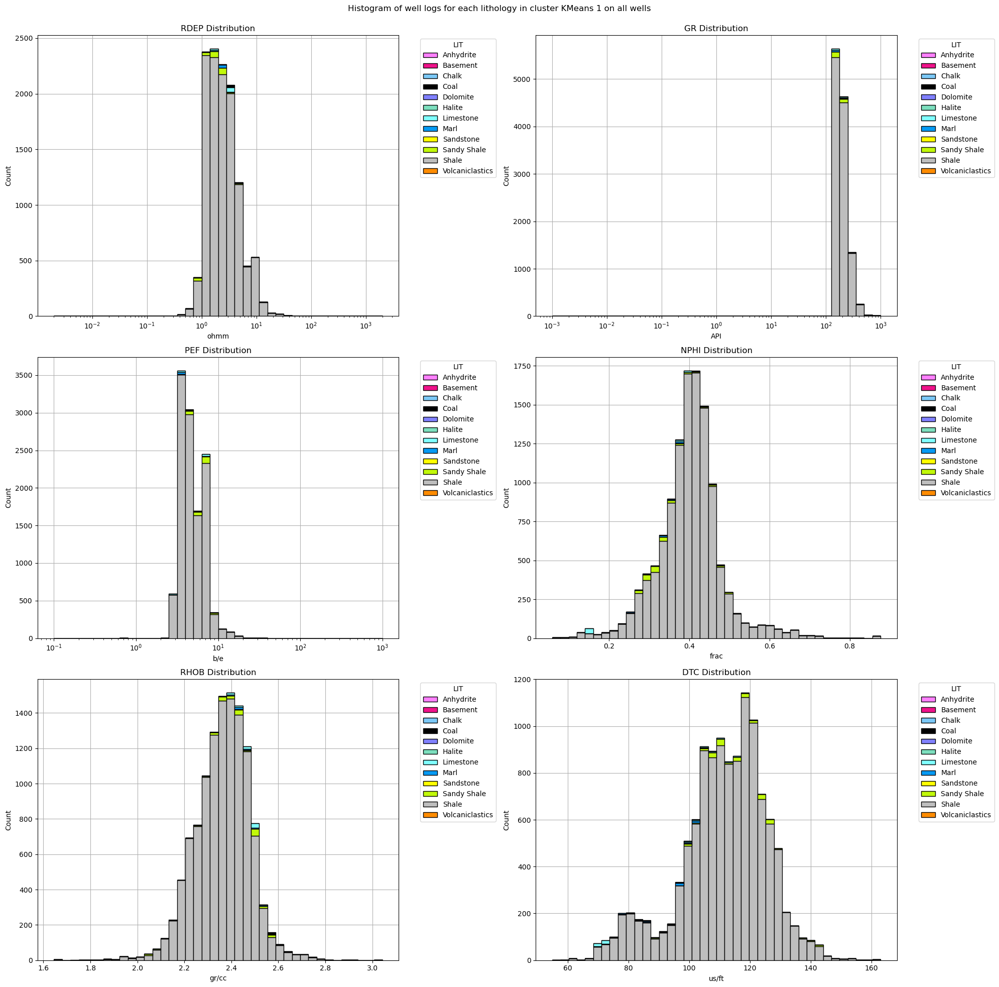

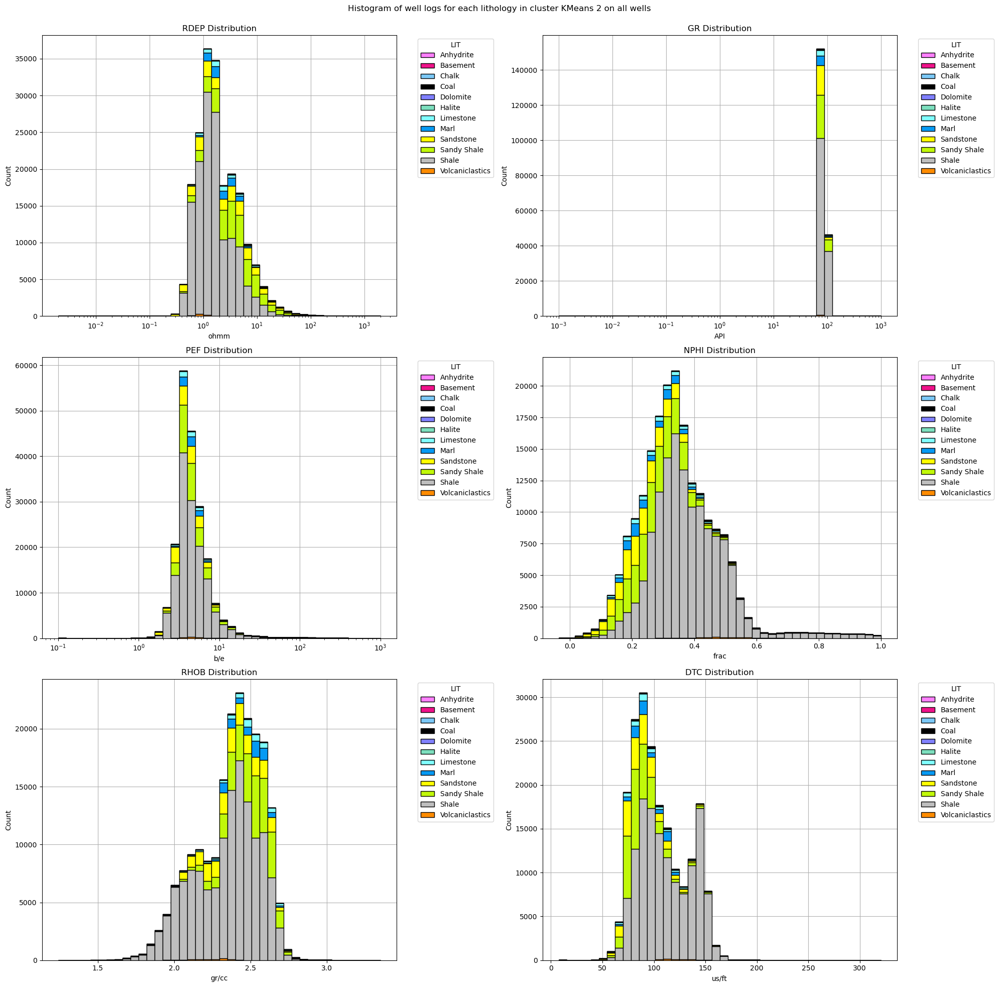

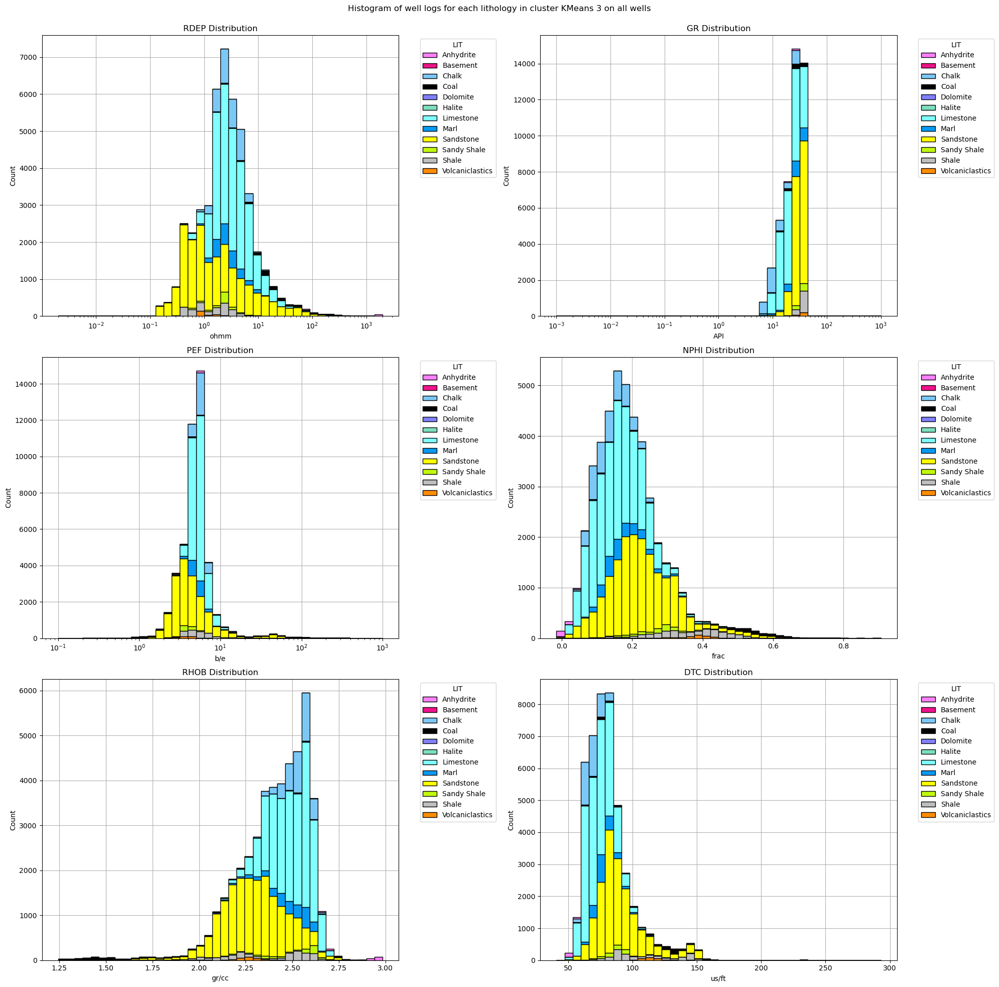

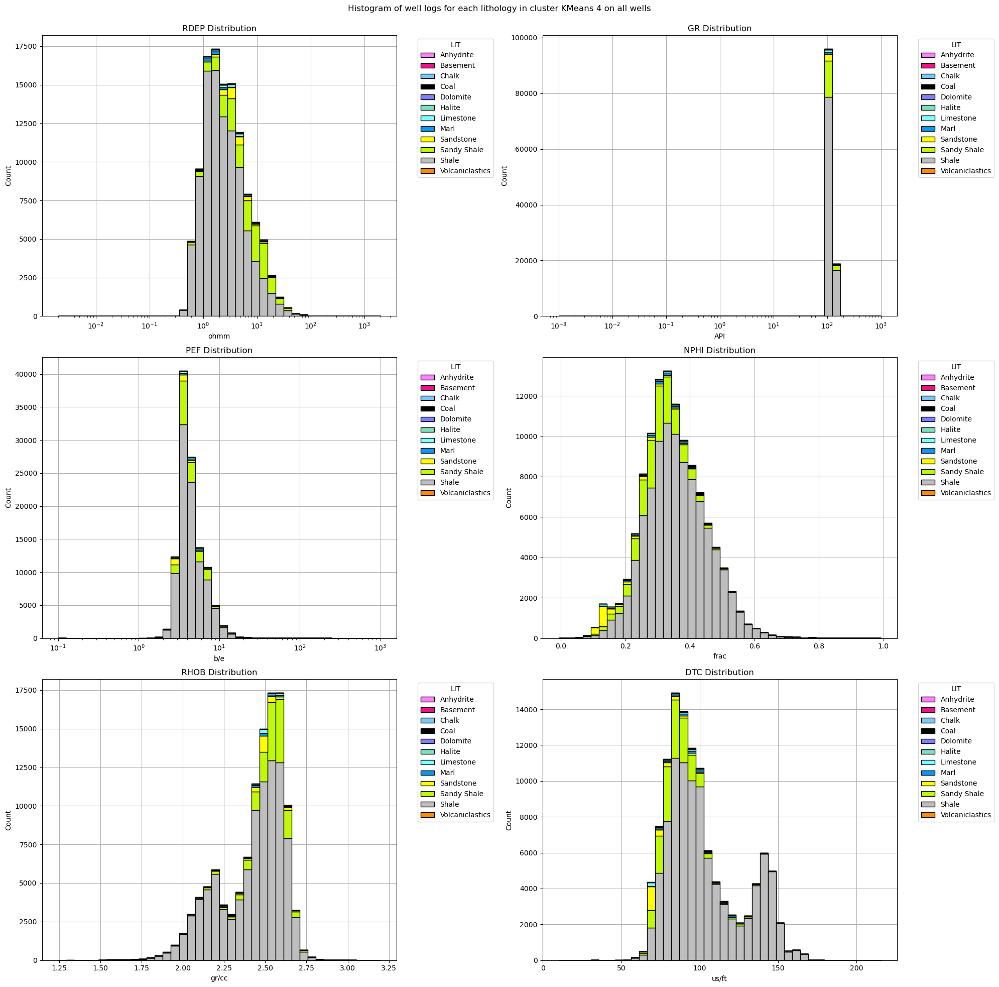

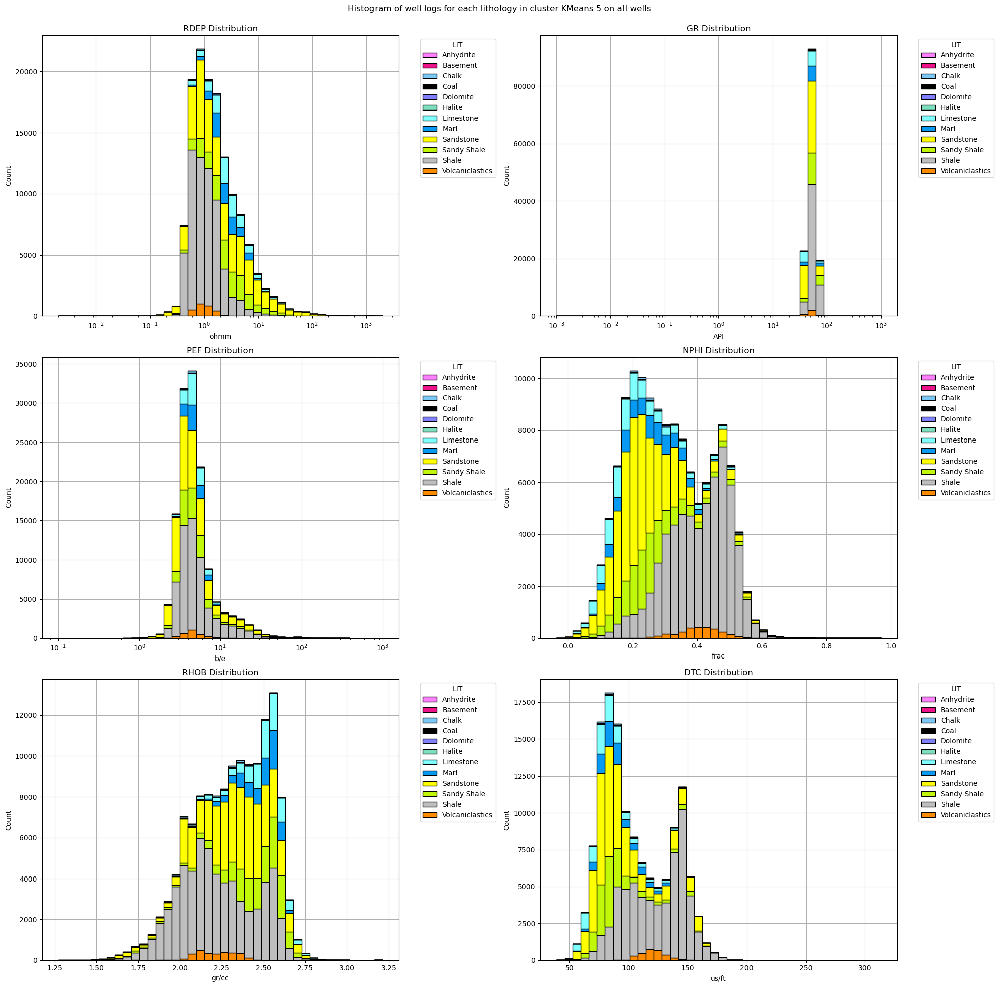

In [133]:
for i, kmeans in enumerate(keys_kmeans):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each lithology in cluster KMeans '+str(kmeans)+ ' on all wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            #ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwellloglithology_kmeanscluster'+str(kmeans)+'_stackcount_mergedata_old.png', bbox_inches='tight')
    plt.show()

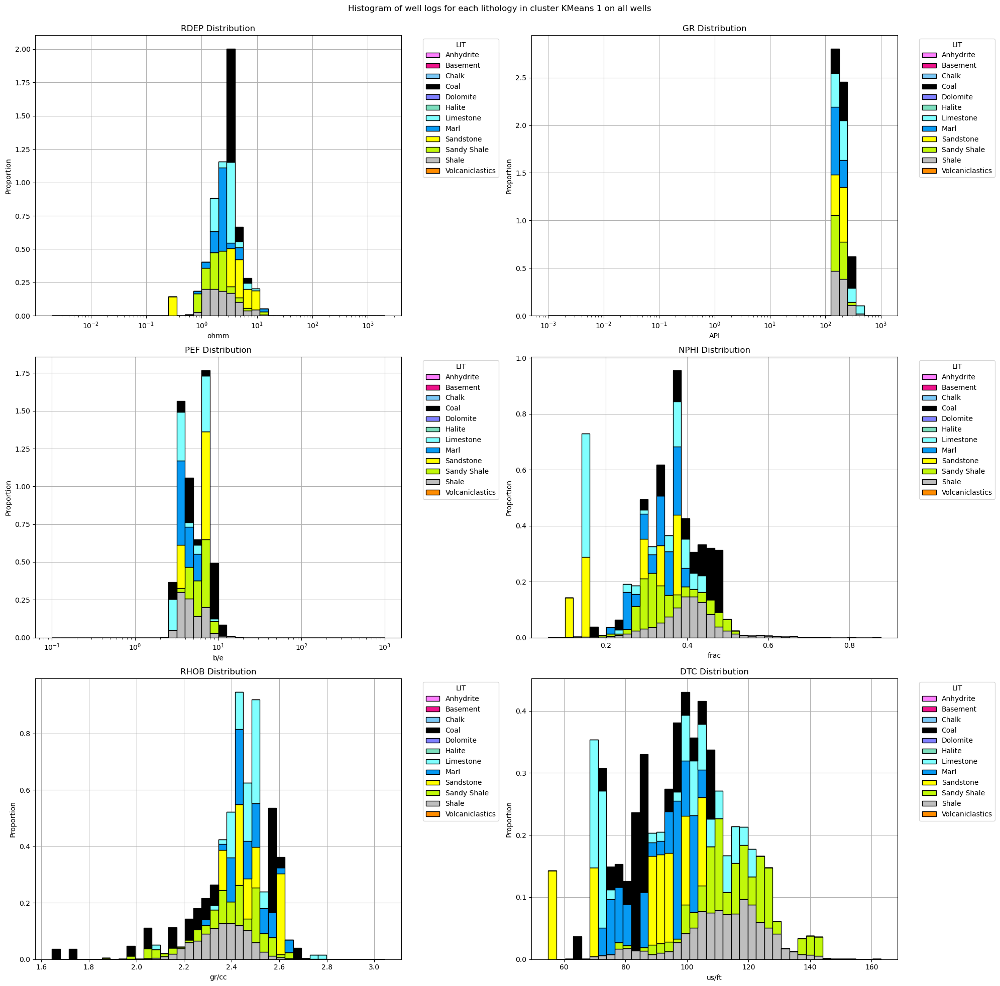

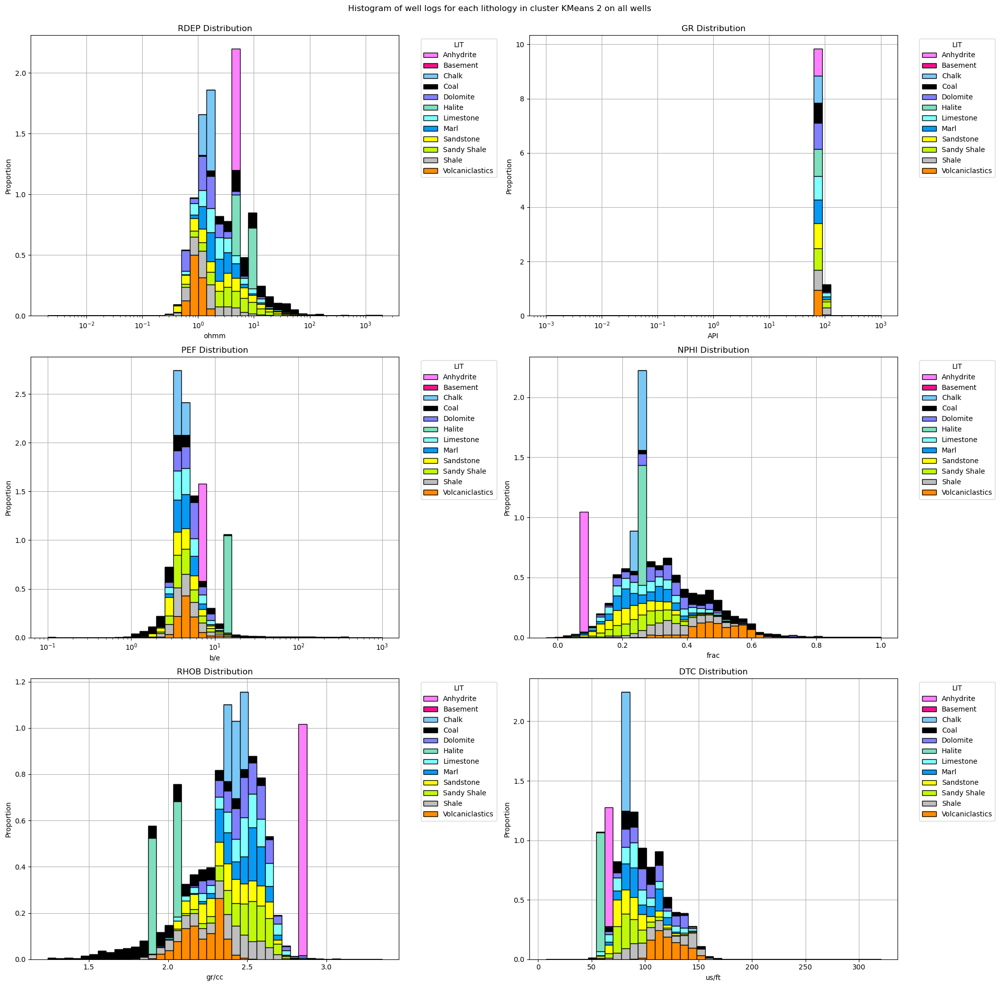

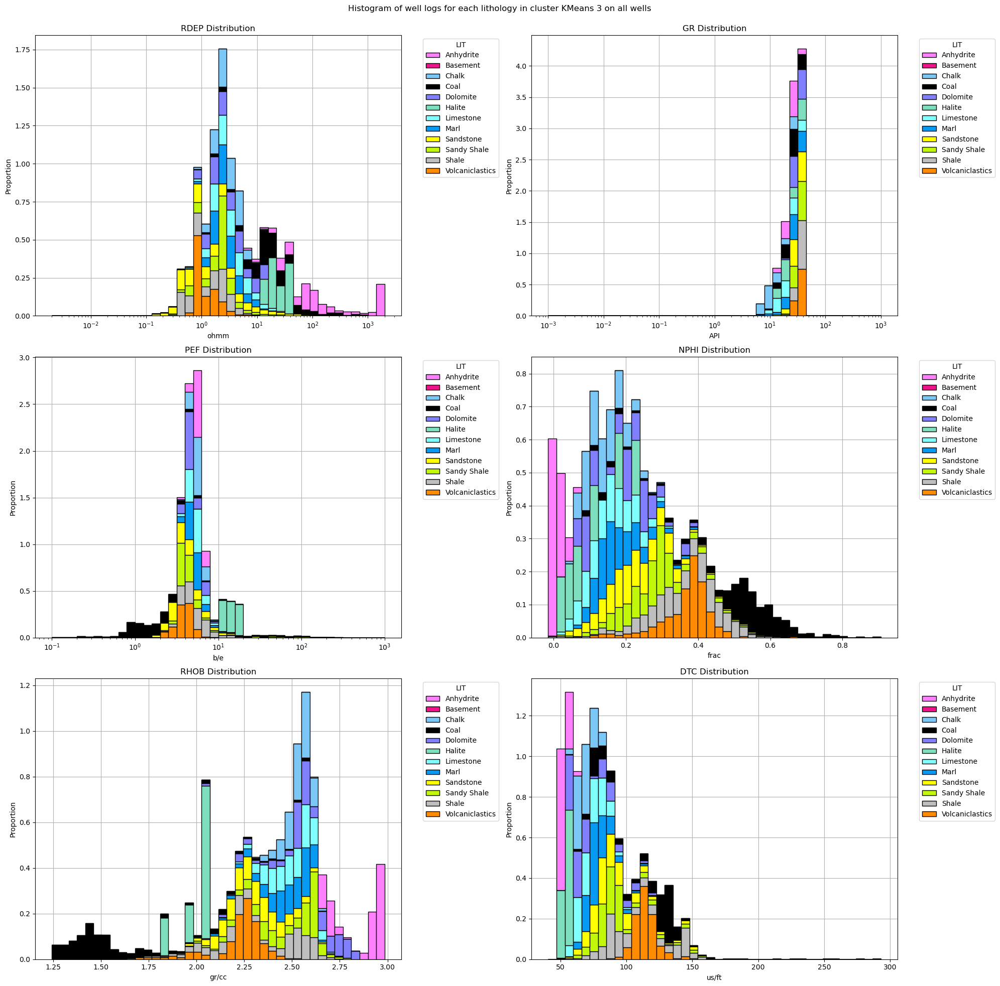

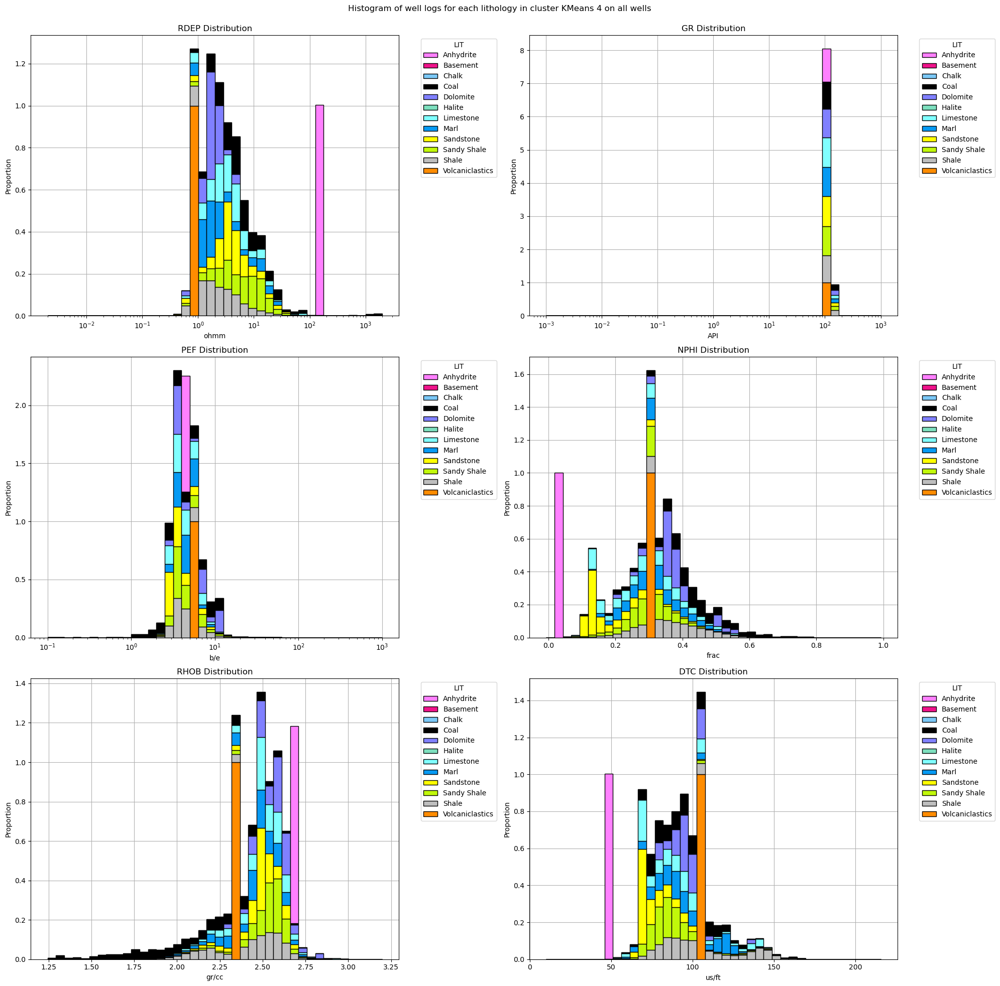

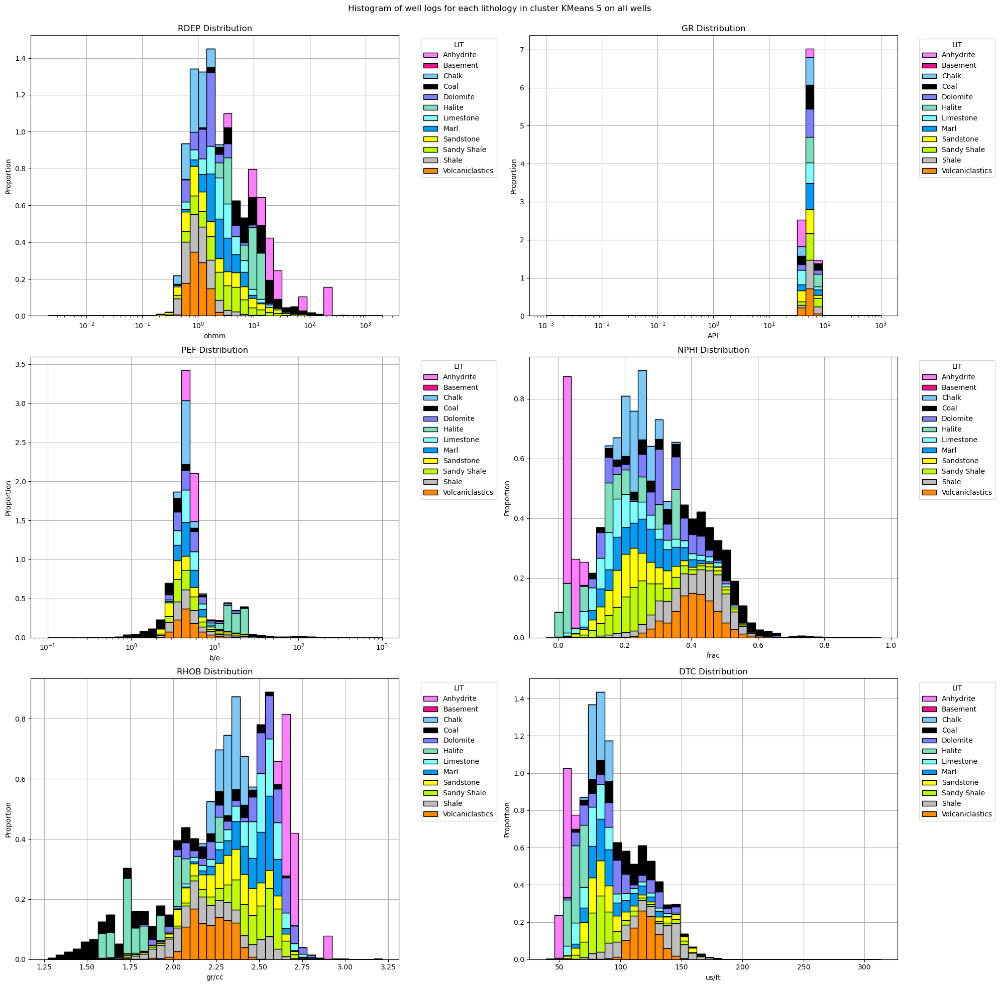

In [134]:
for i, kmeans in enumerate(keys_kmeans):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each lithology in cluster KMeans '+str(kmeans)+ ' on all wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            #ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwellloglithology_kmeanscluster'+str(kmeans)+'stackproportion_mergedata_old.png', bbox_inches='tight')
    plt.show()

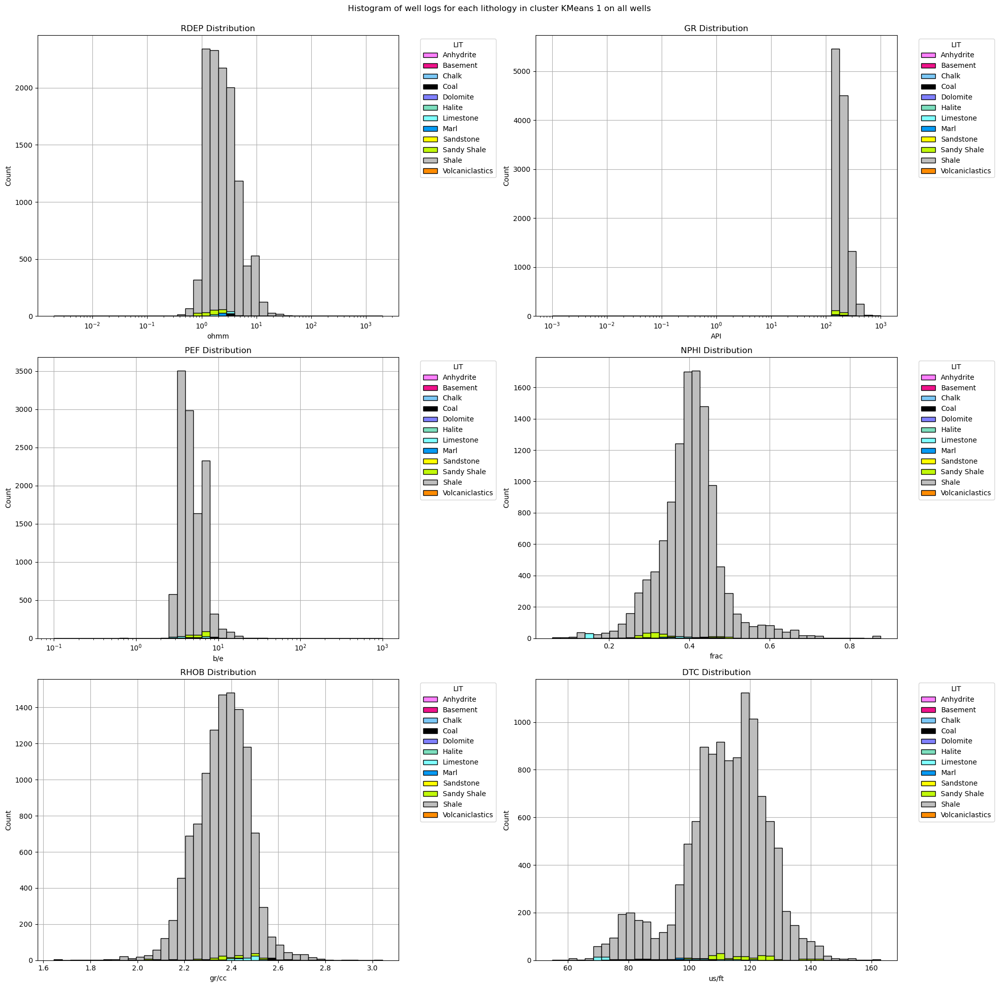

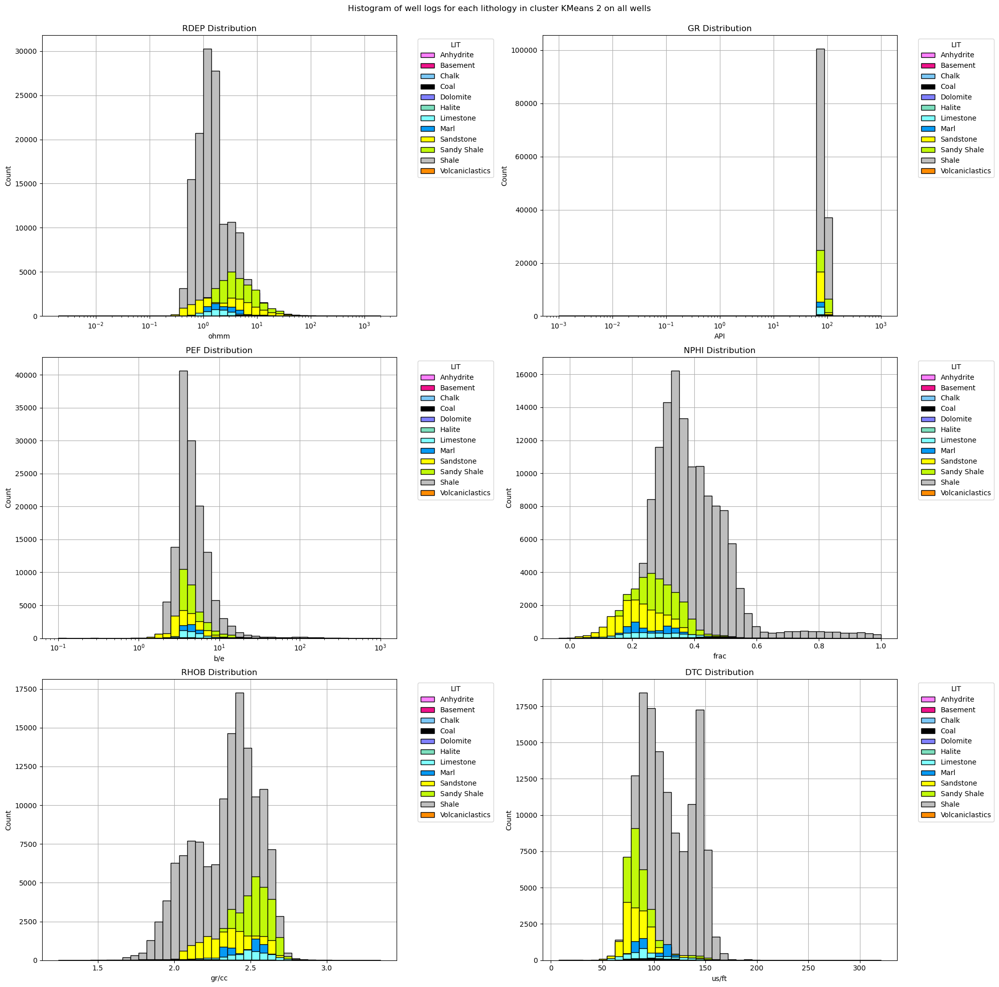

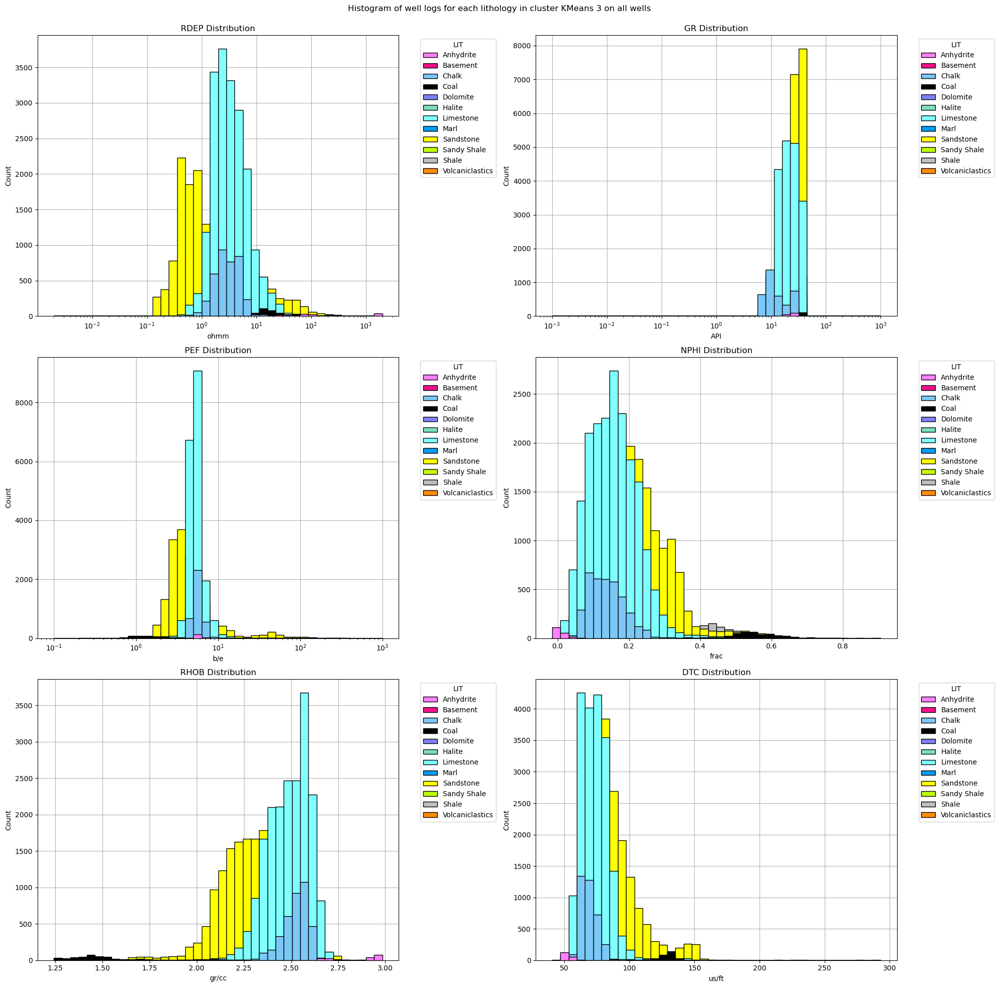

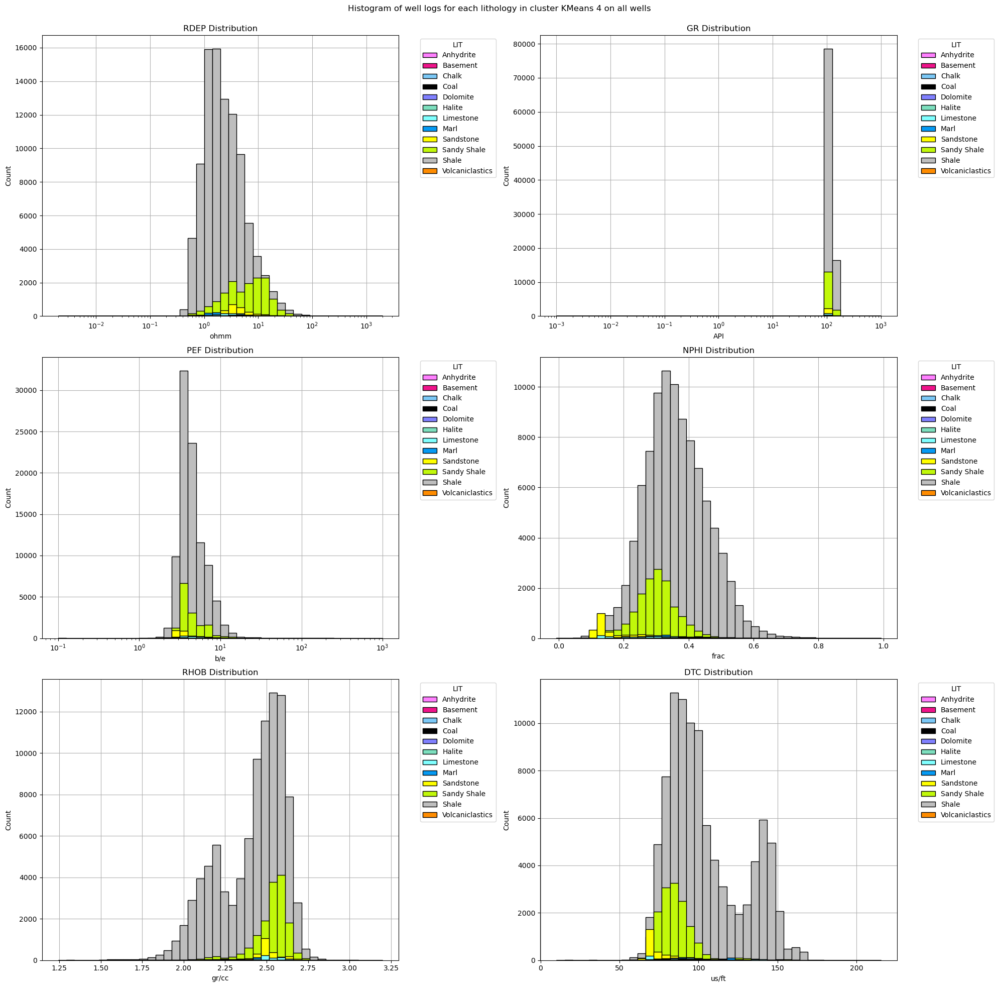

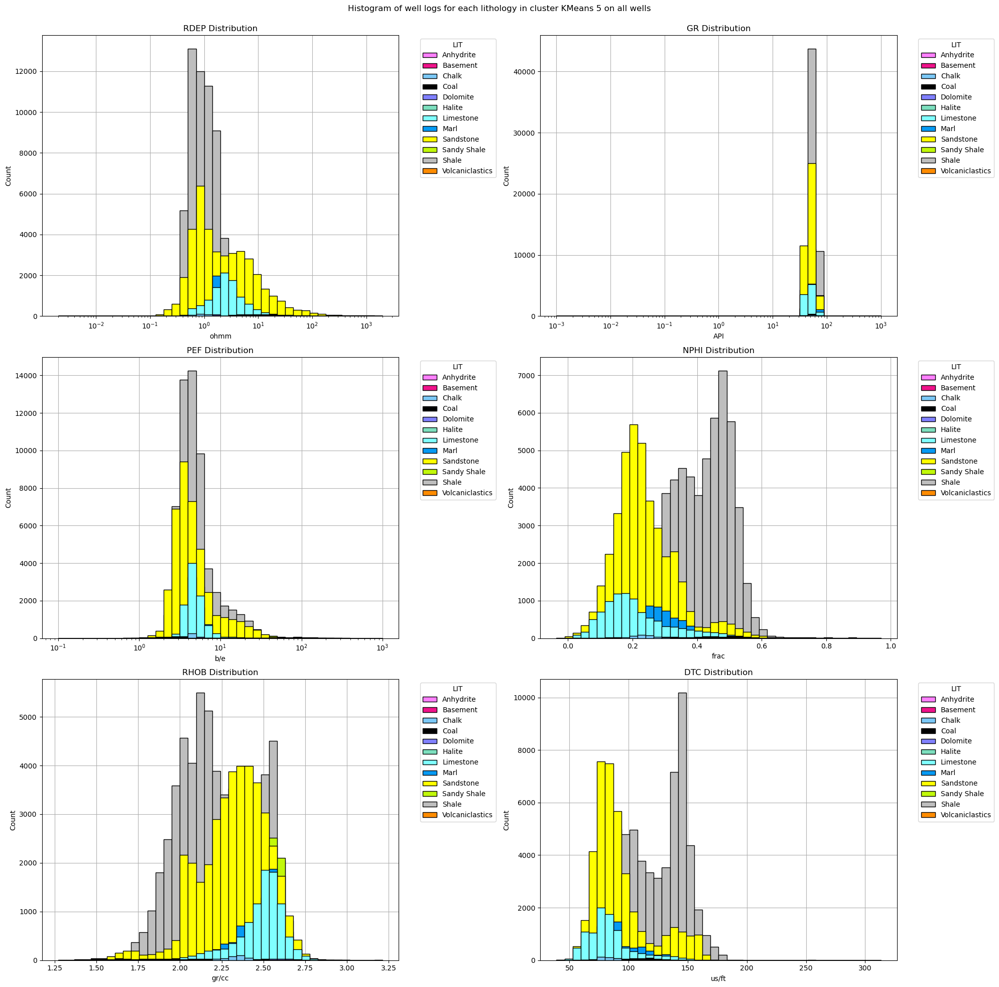

In [135]:
for i, kmeans in enumerate(keys_kmeans):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each lithology in cluster KMeans '+str(kmeans)+ ' on all wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            #ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwellloglithology_kmeanscluster'+str(kmeans)+'_layercount_mergedata_old.png', bbox_inches='tight')
    plt.show()

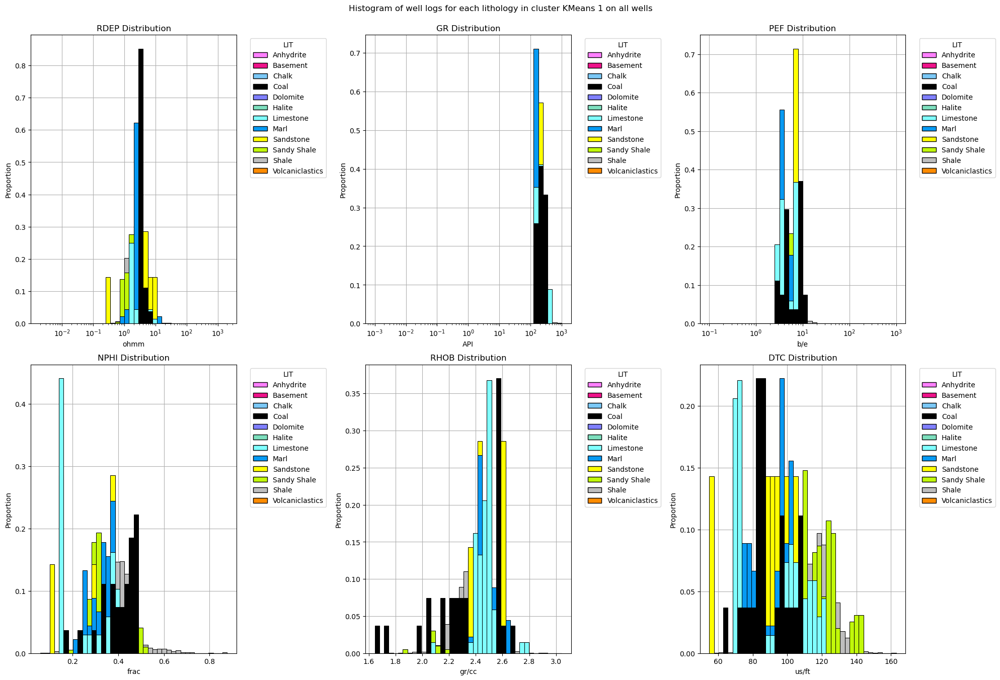

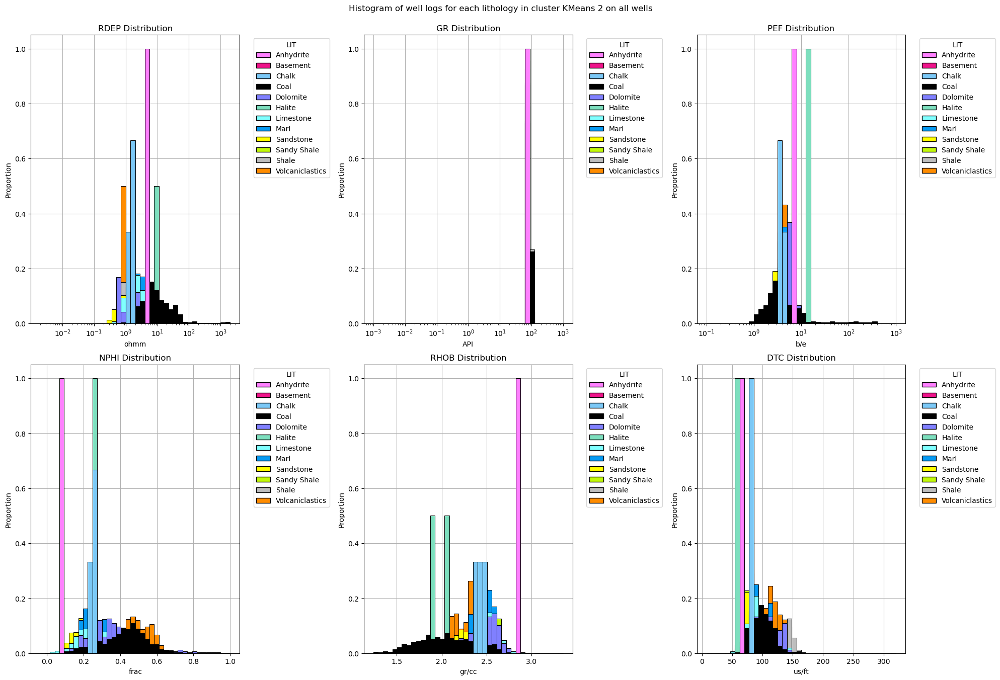

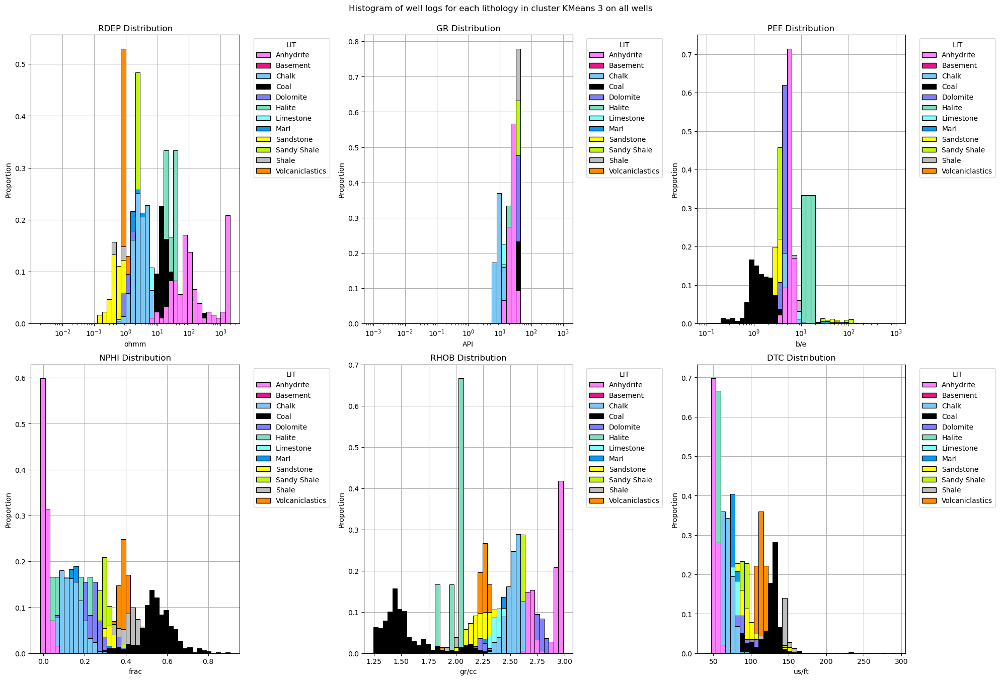

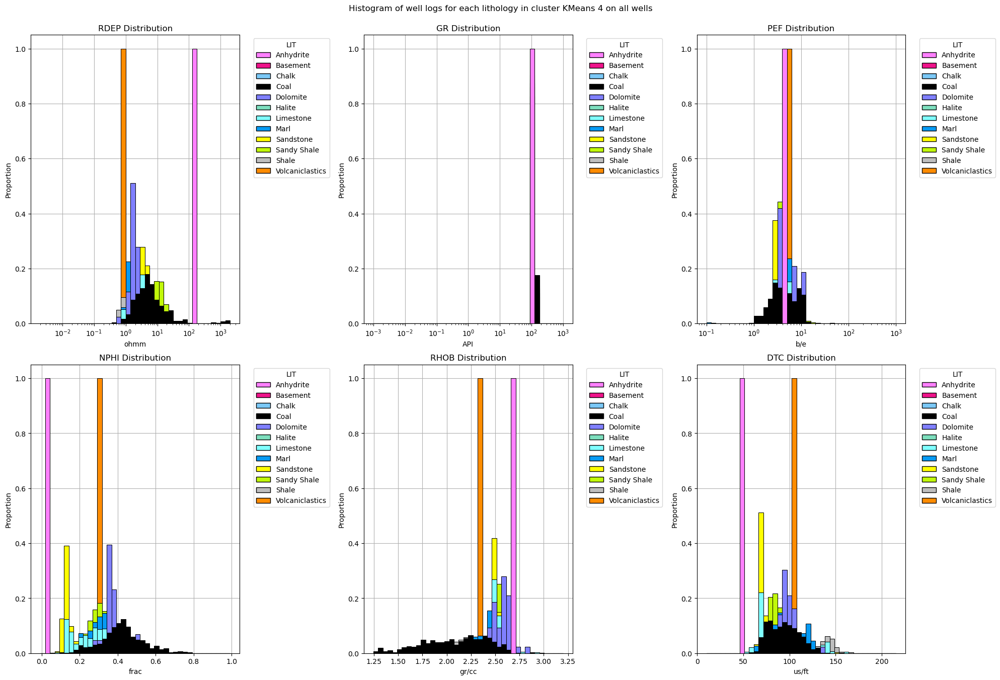

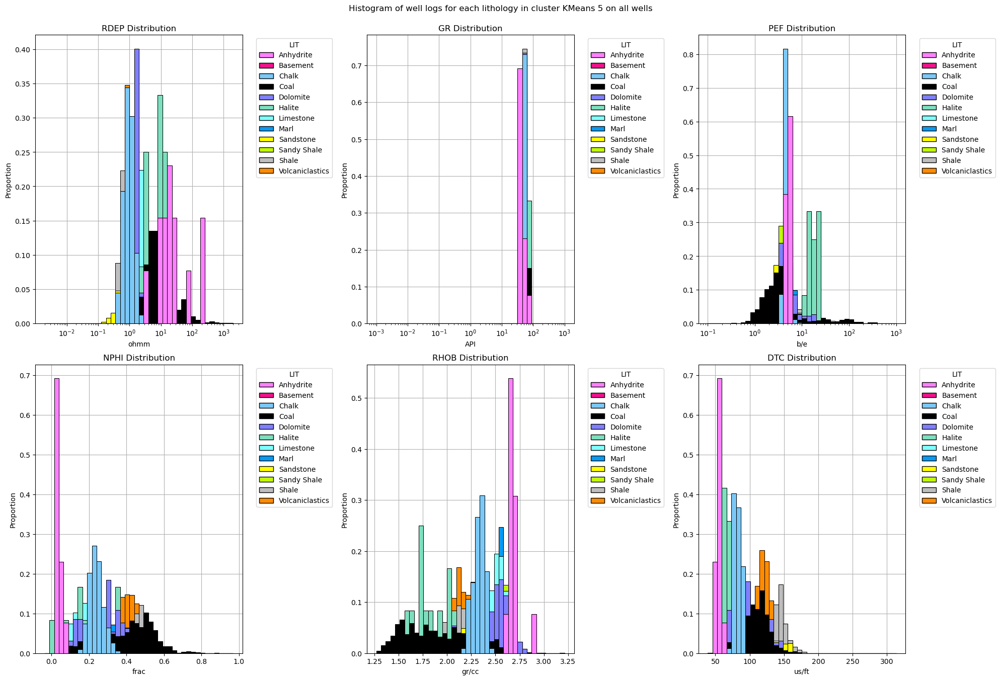

In [136]:
for i, kmeans in enumerate(keys_kmeans):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each lithology in cluster KMeans '+str(kmeans)+ ' on all wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,3,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            #ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwellloglithology_kmeanscluster'+str(kmeans)+'_layerproportion_mergedata_old.png', bbox_inches='tight')
    plt.show()

#### Histogram for each well logs (lithology group, cluster hue)


##### On all lithology

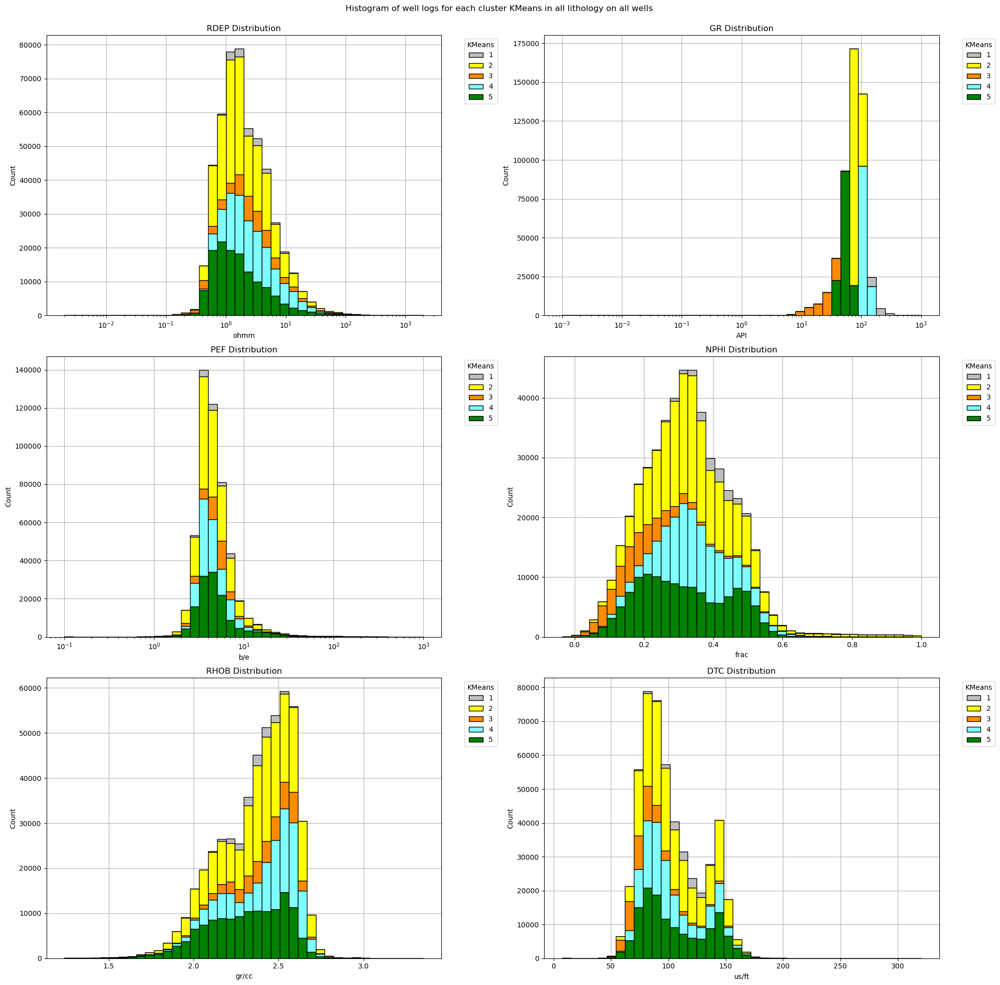

In [137]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each cluster KMeans in all lithology on all wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')
    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwelllogkmeans_alllithology_stackcount_mergedata_old.png', bbox_inches='tight')
plt.show()

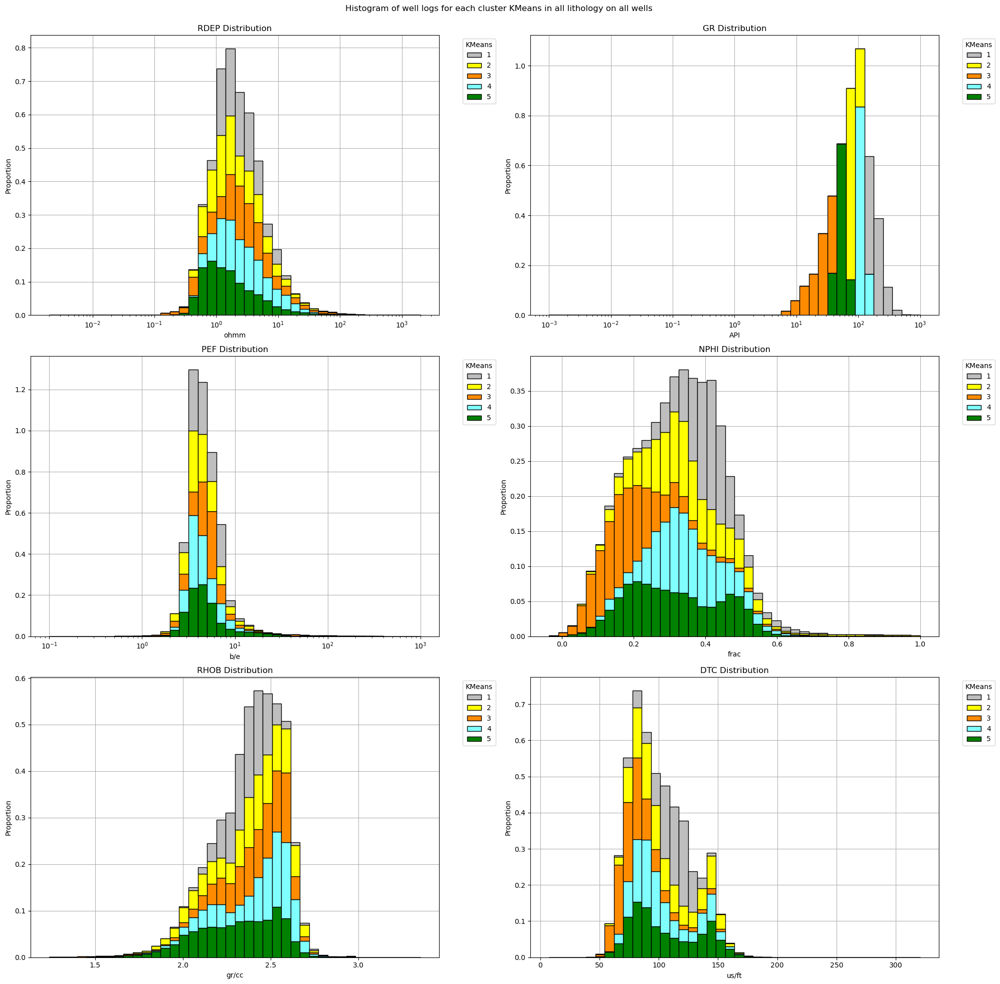

In [138]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each cluster KMeans in all lithology on all wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')
    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwelllogkmeans_alllithology_stackproportion_mergedata_old.png', bbox_inches='tight')
plt.show()

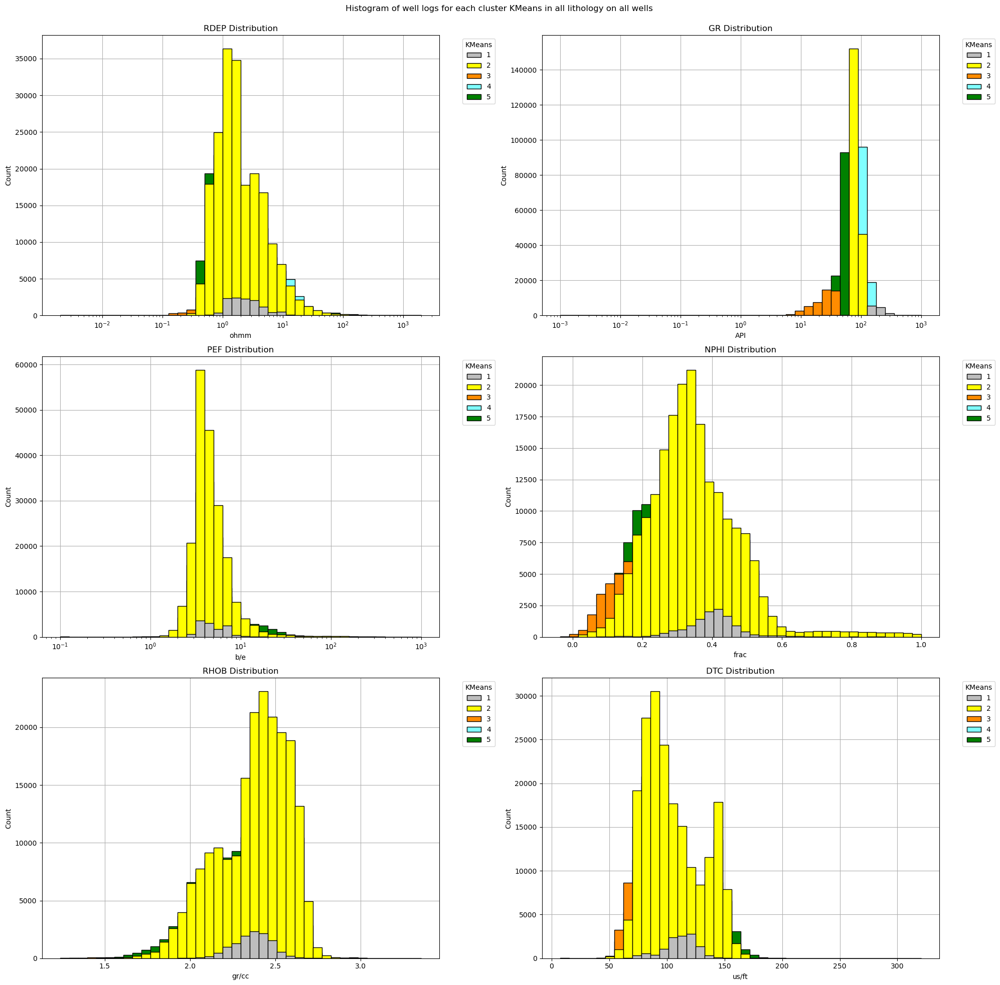

In [139]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each cluster KMeans in all lithology on all wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')
    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwelllogkmeans_alllithology_layercount_mergedata_old.png', bbox_inches='tight')
plt.show()

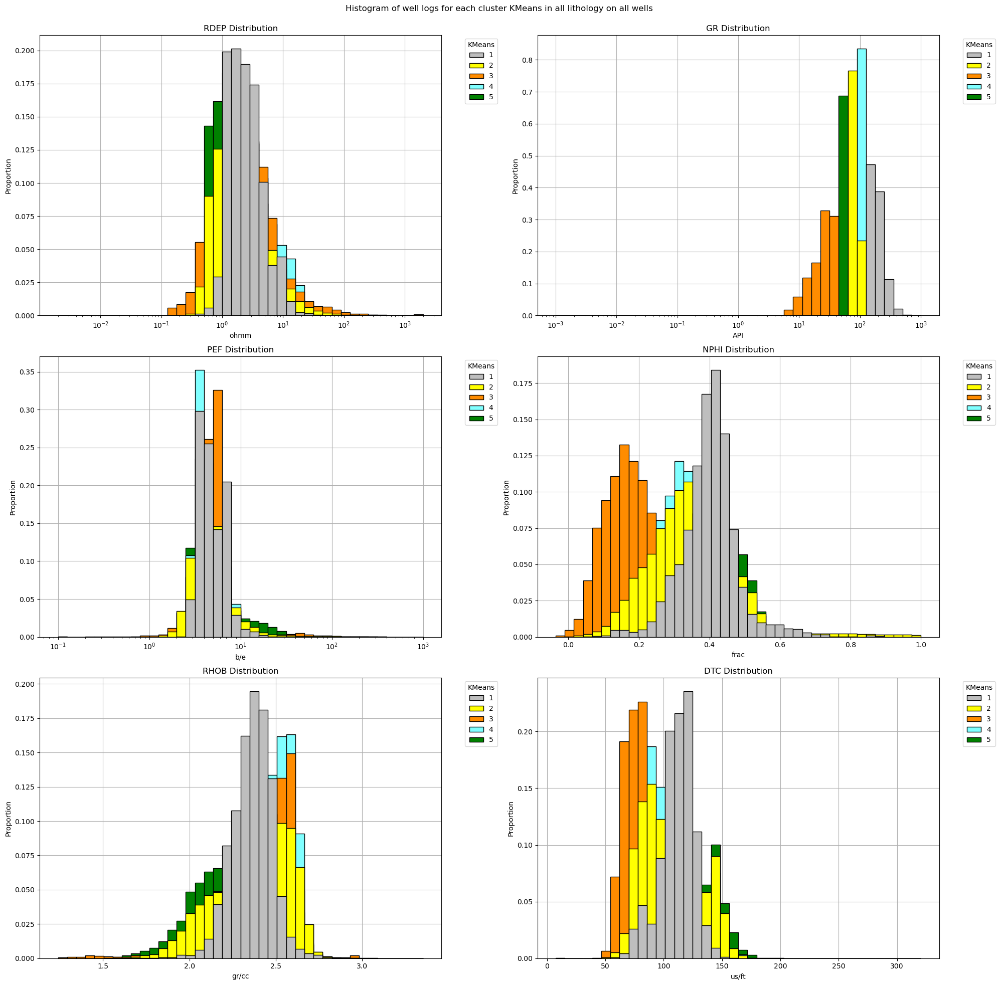

In [140]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each cluster KMeans in all lithology on all wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')
    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwelllogkmeans_alllithology_layerproportion_mergedata_old.png', bbox_inches='tight')
plt.show()

##### On each lithology

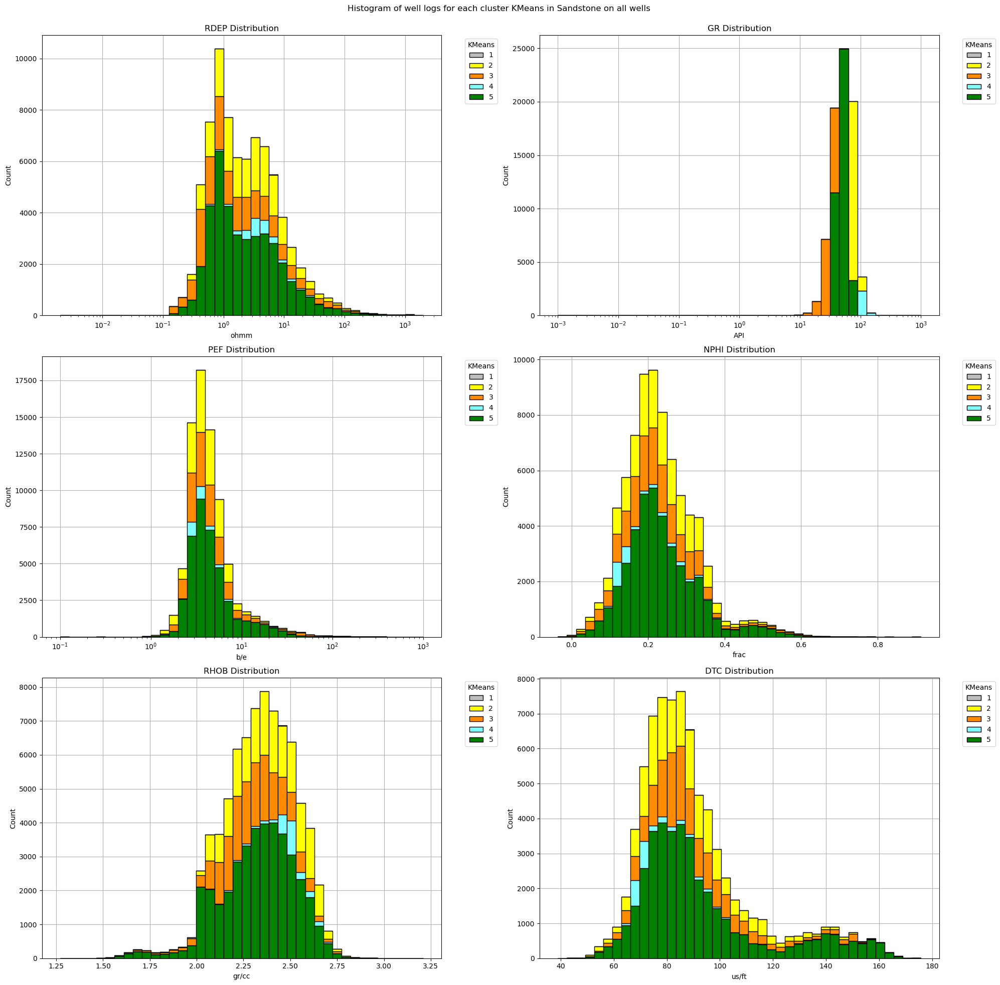

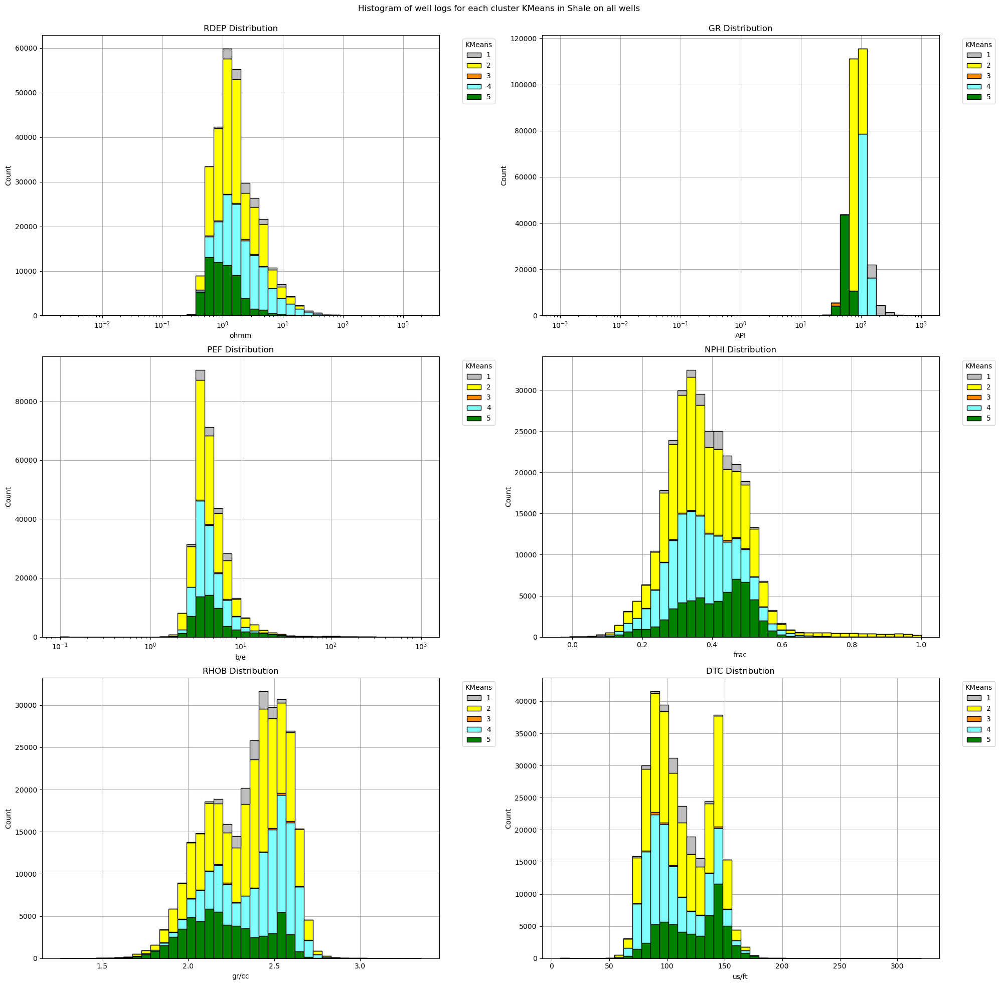

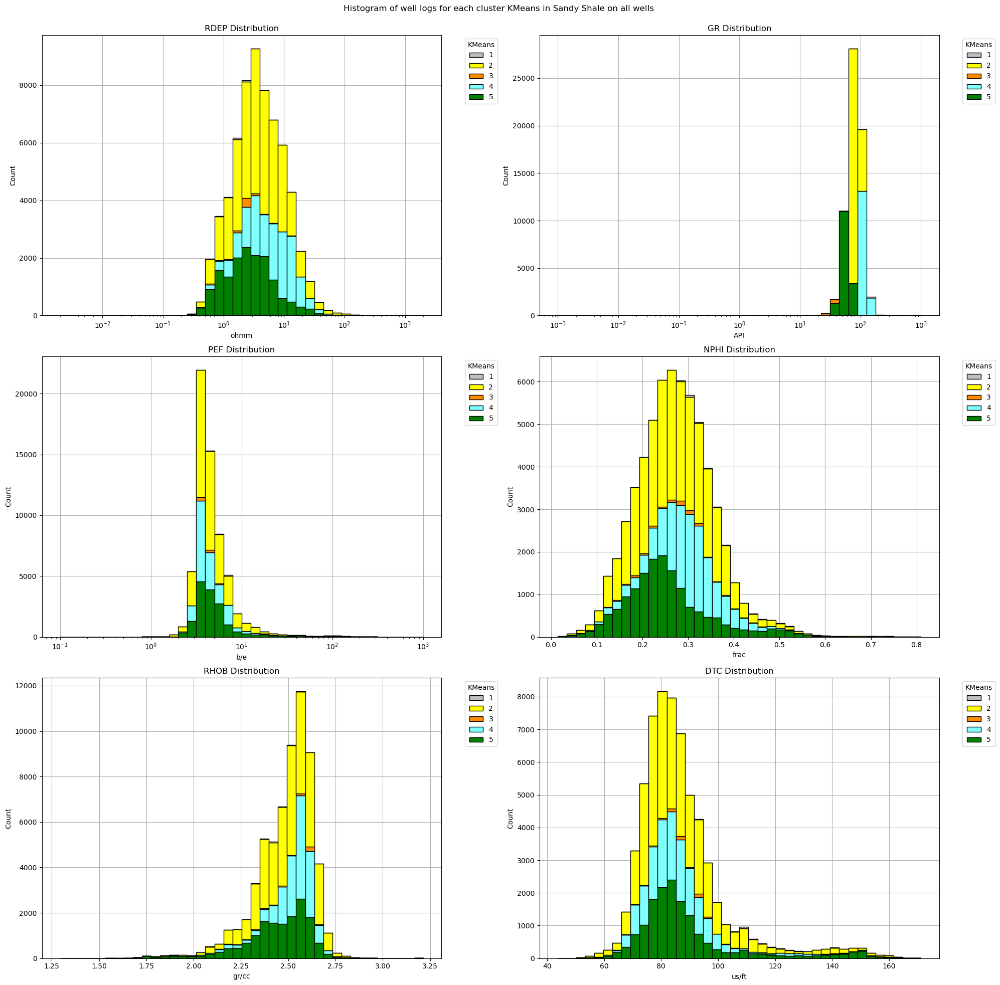

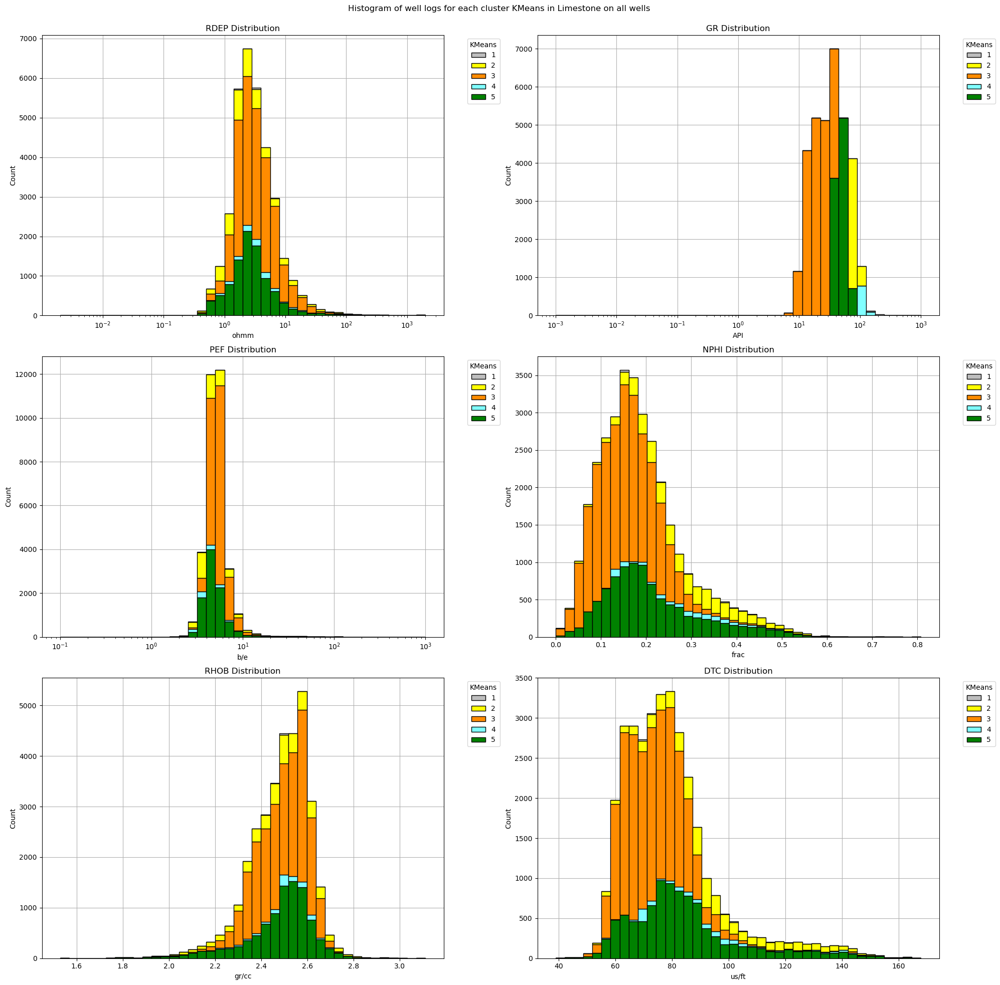

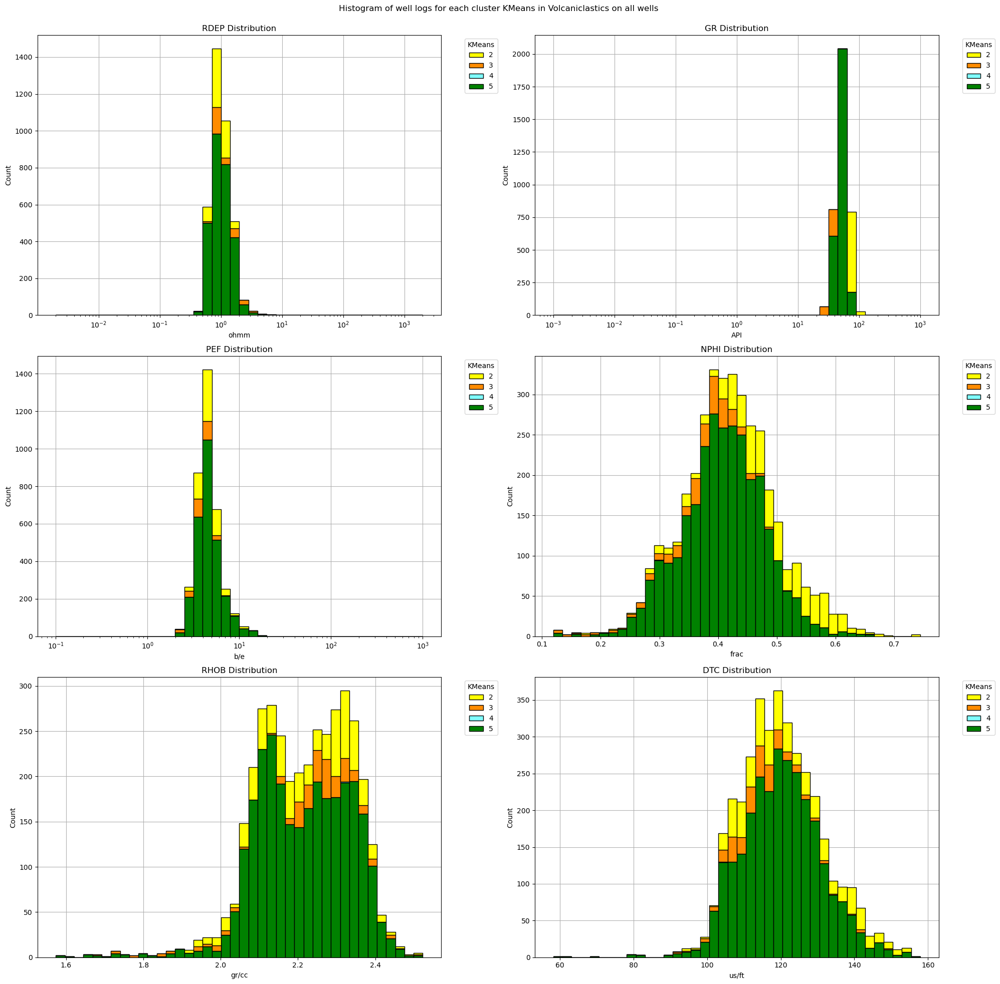

...

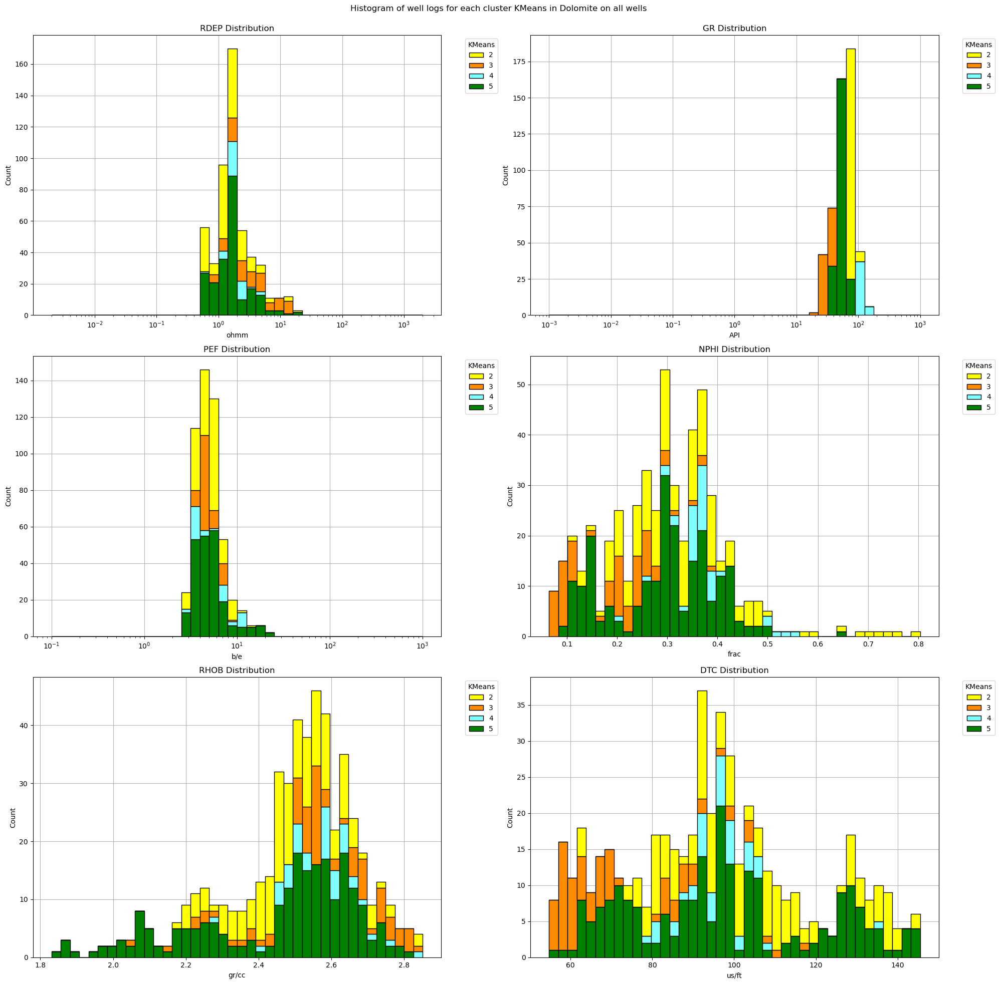

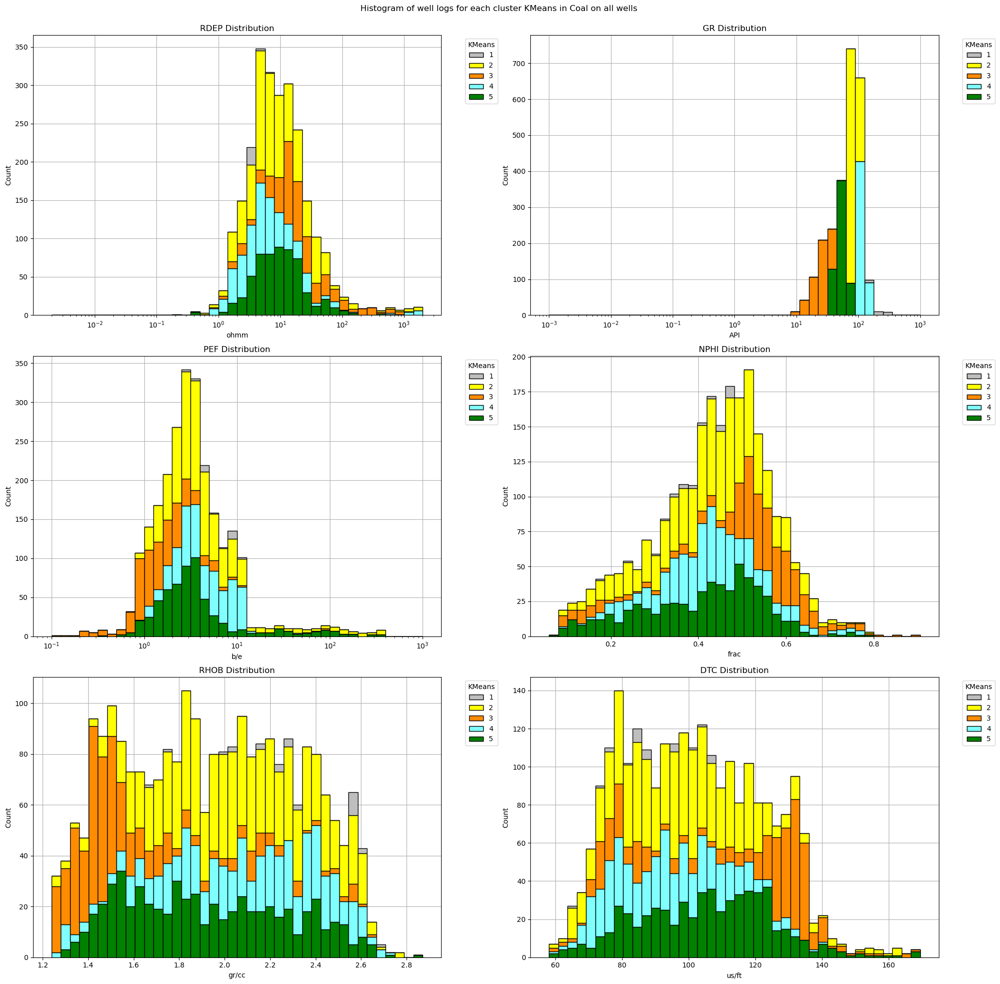

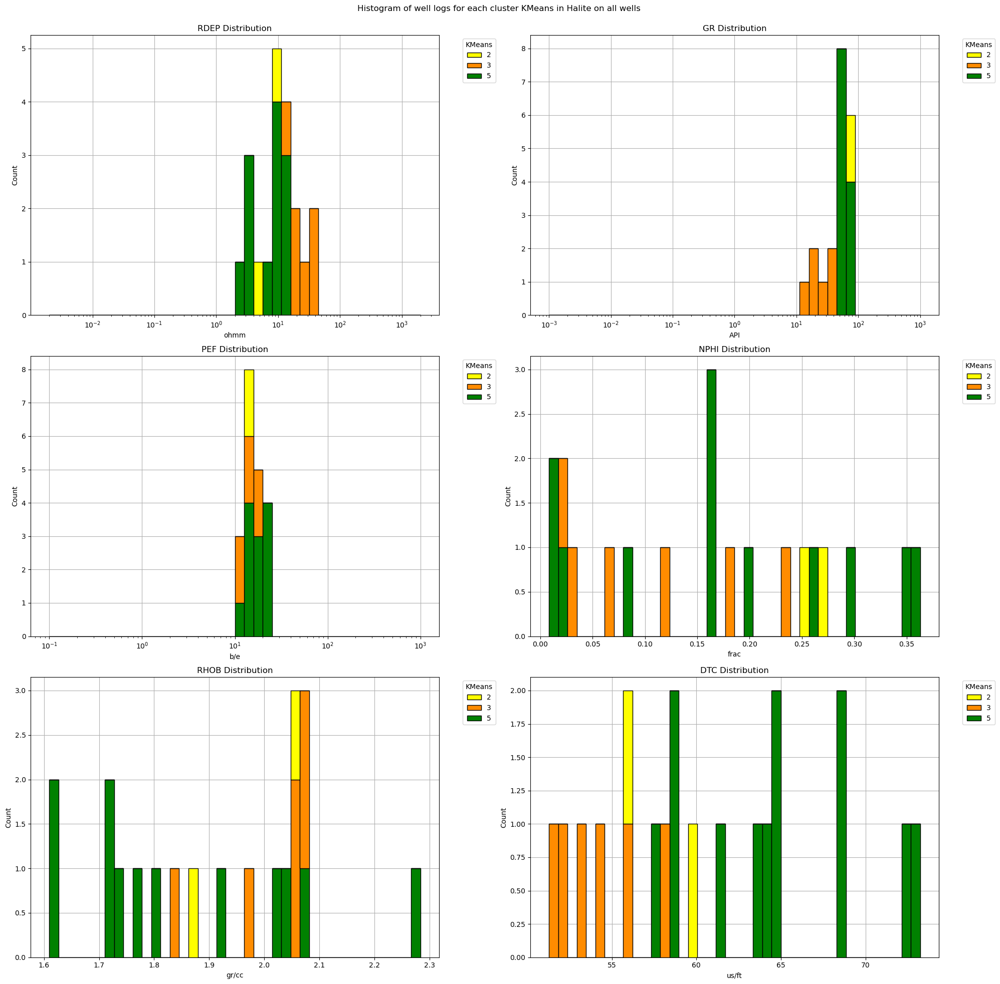

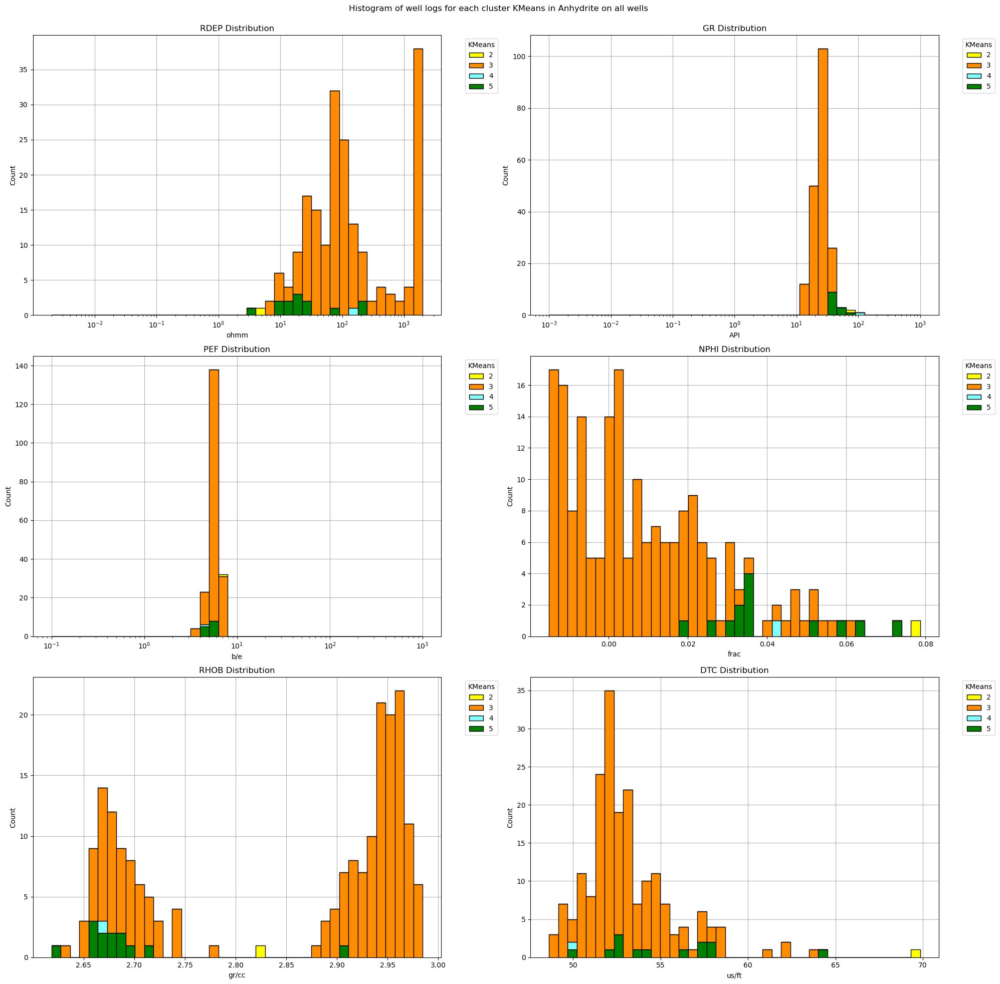

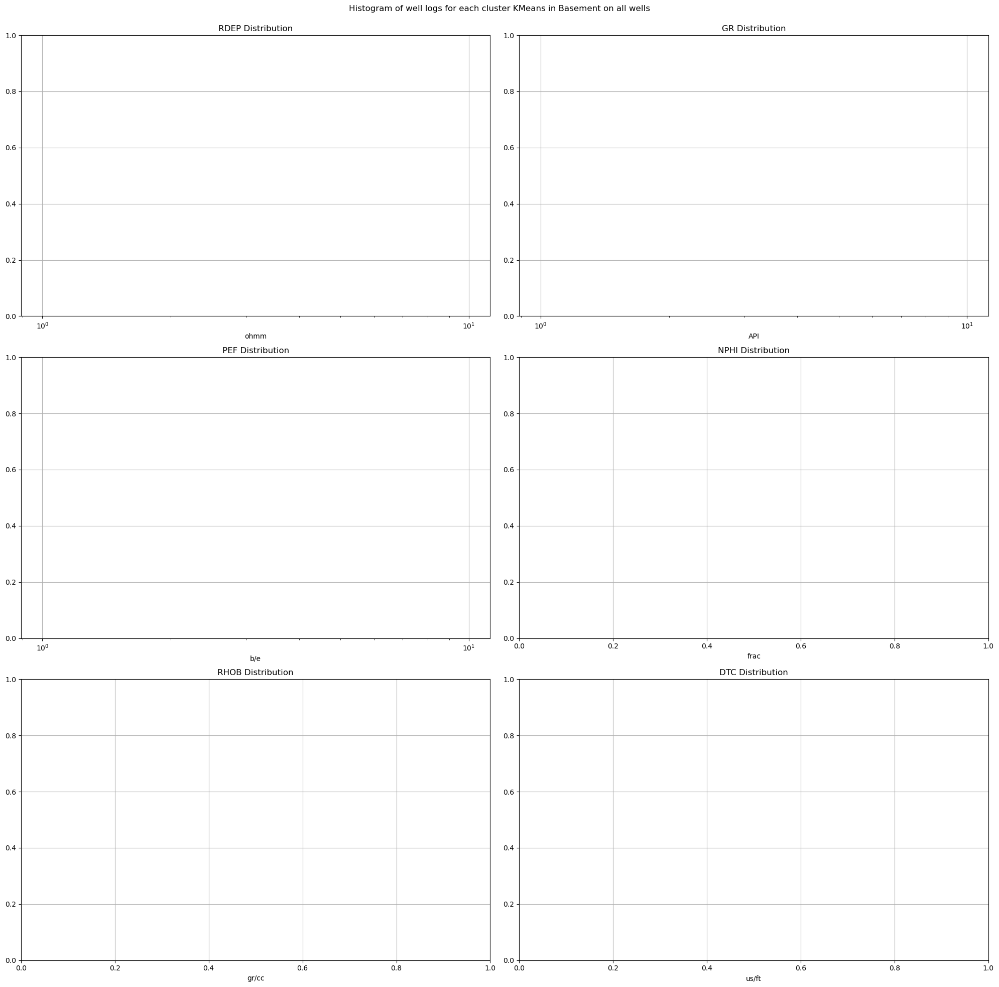

In [141]:
for i, litho in enumerate(keys_lithology):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each cluster KMeans in '+str(litho)+ ' on all wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                #pass
            #else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                #ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwelllogkmeans_'+str(litho)+'_stackcount_mergedata_old.png', bbox_inches='tight')
    plt.show()

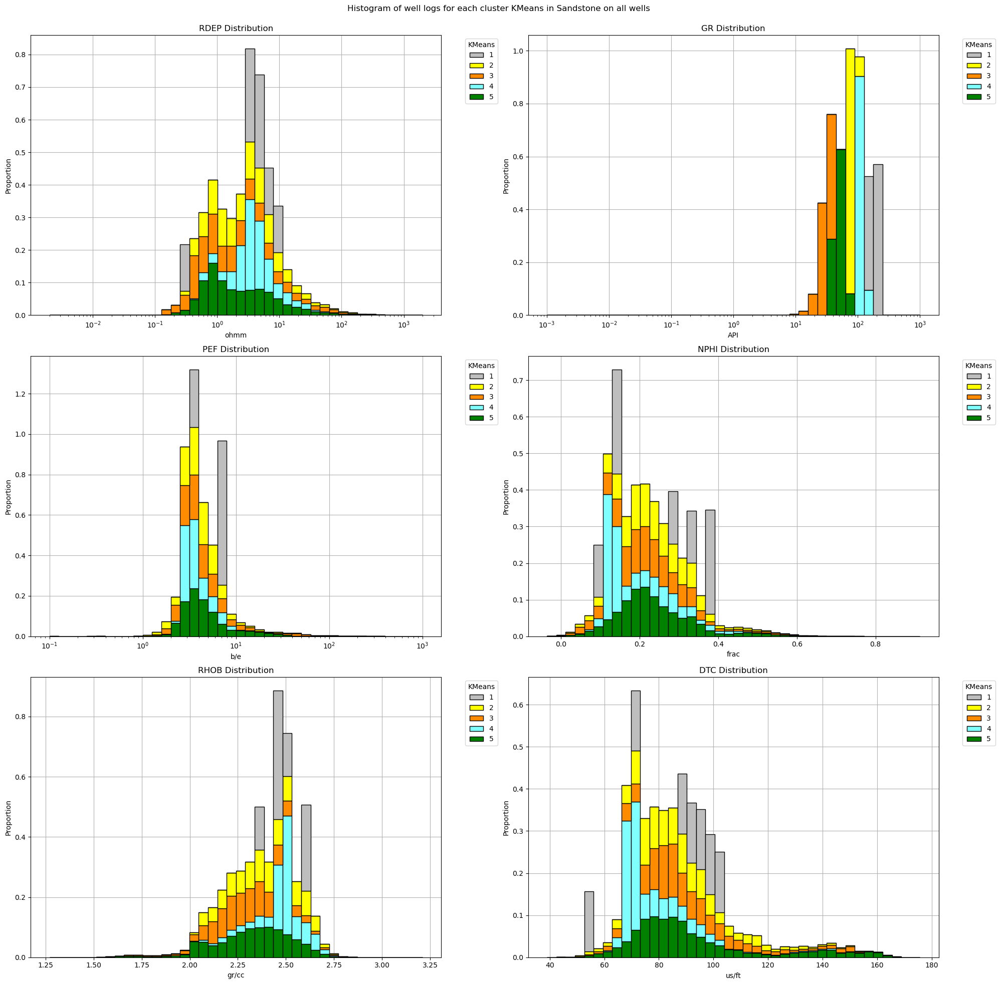

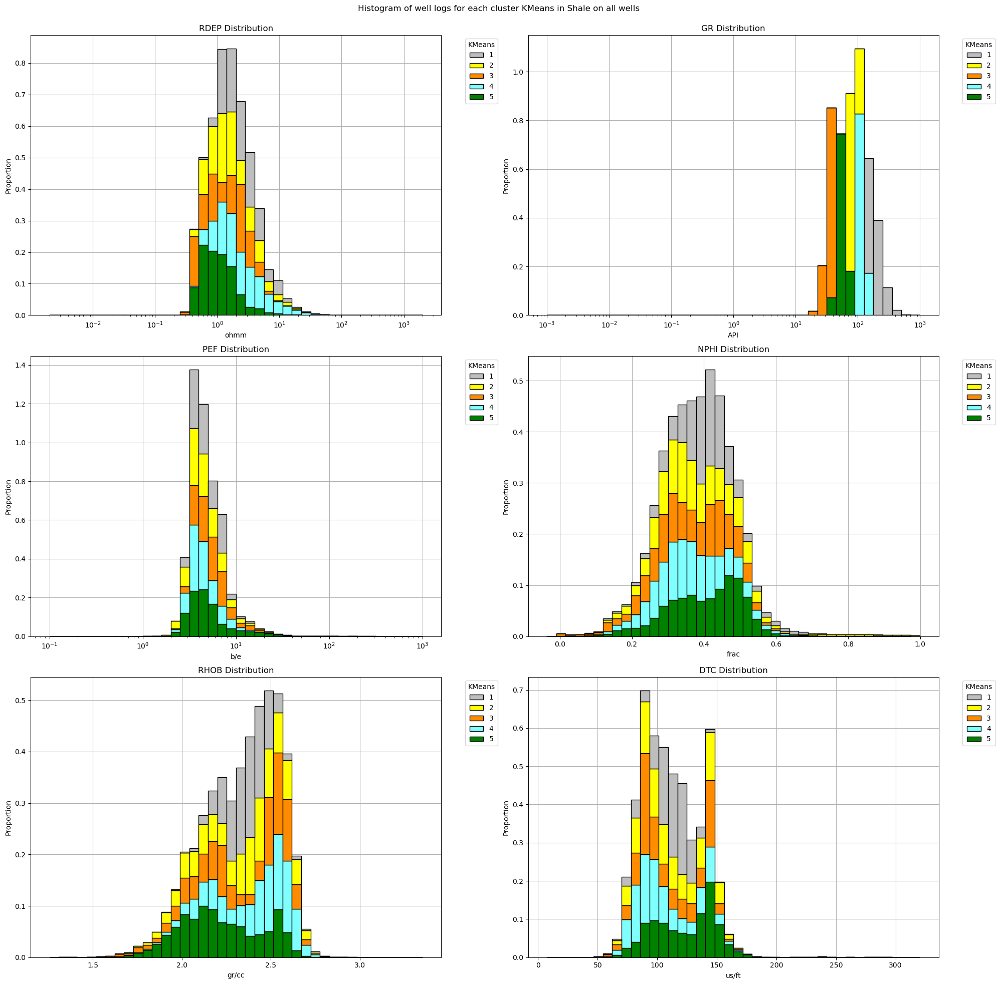

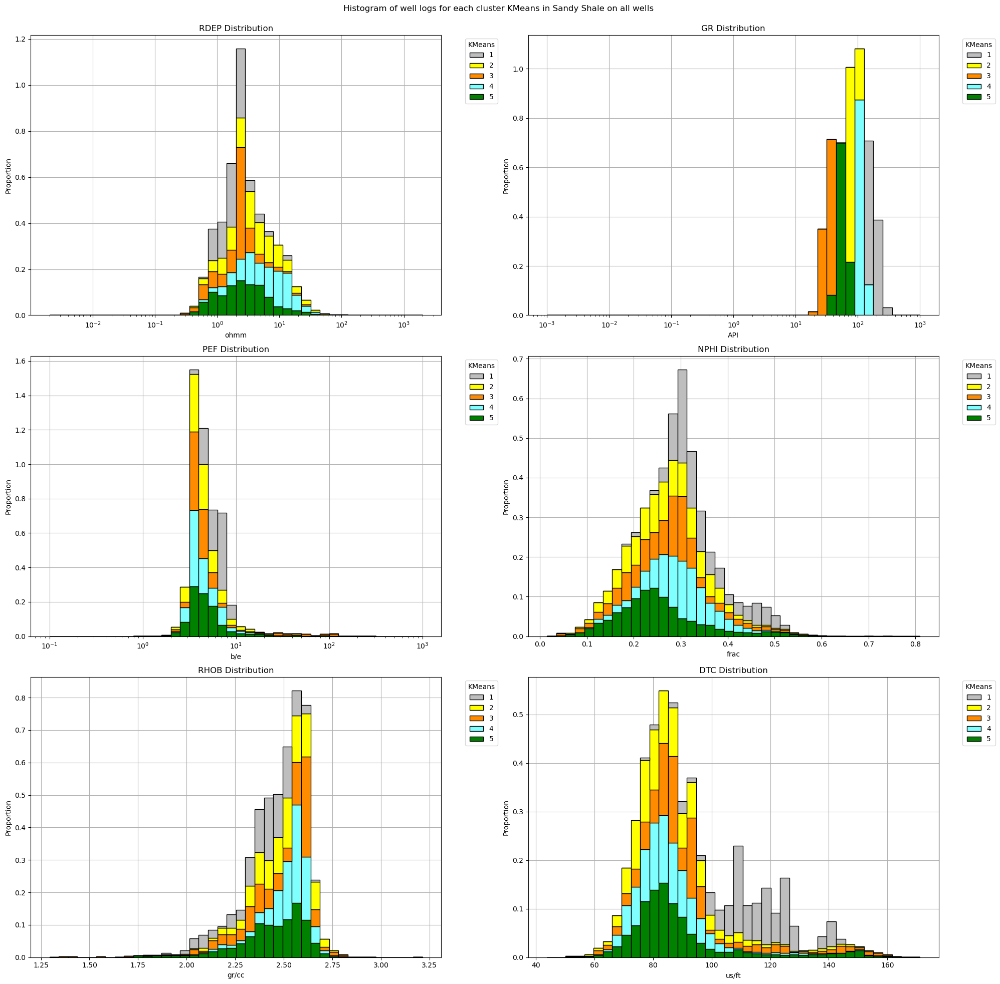

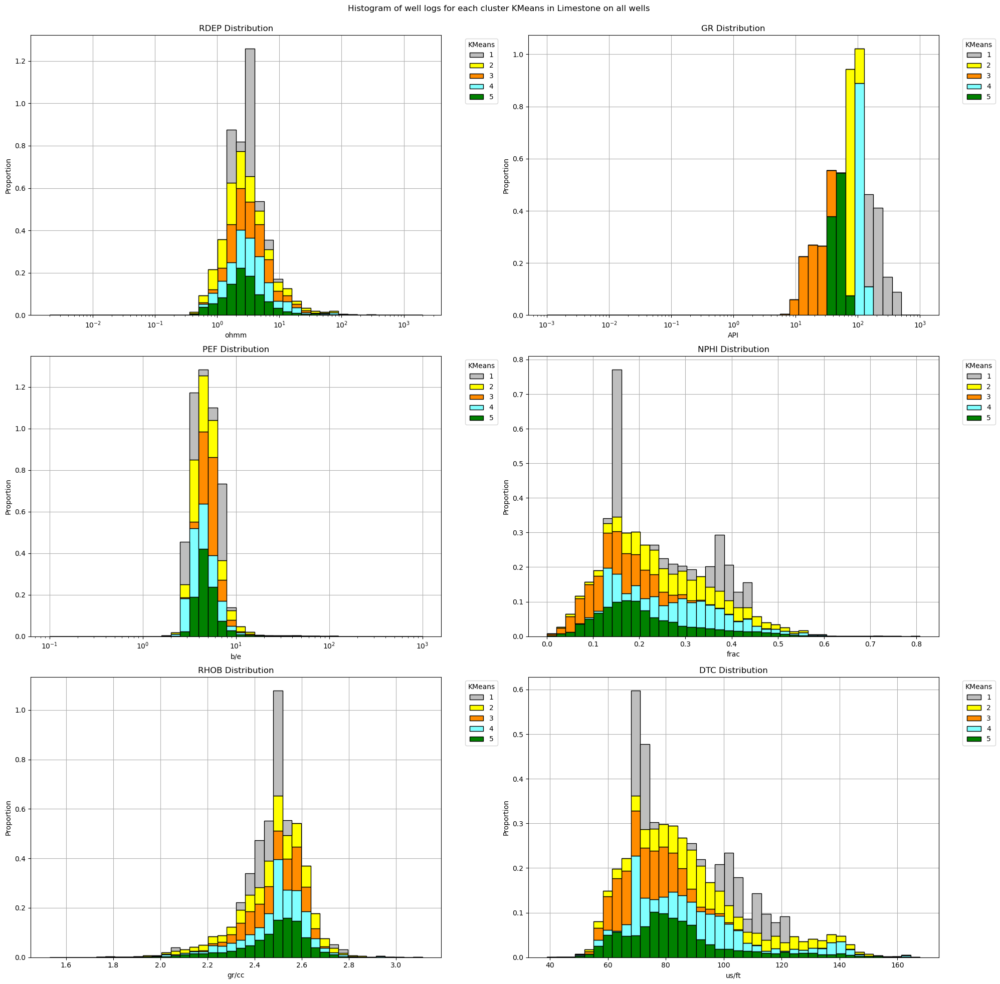

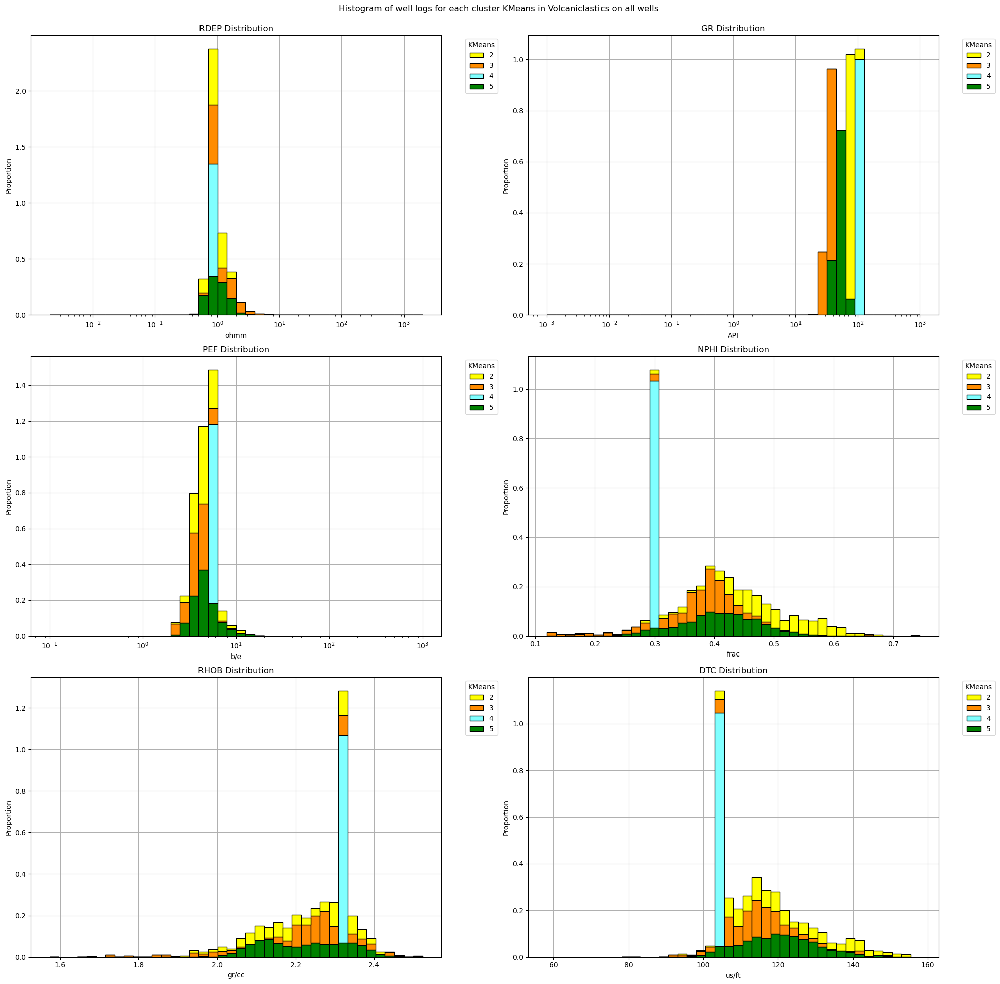

...

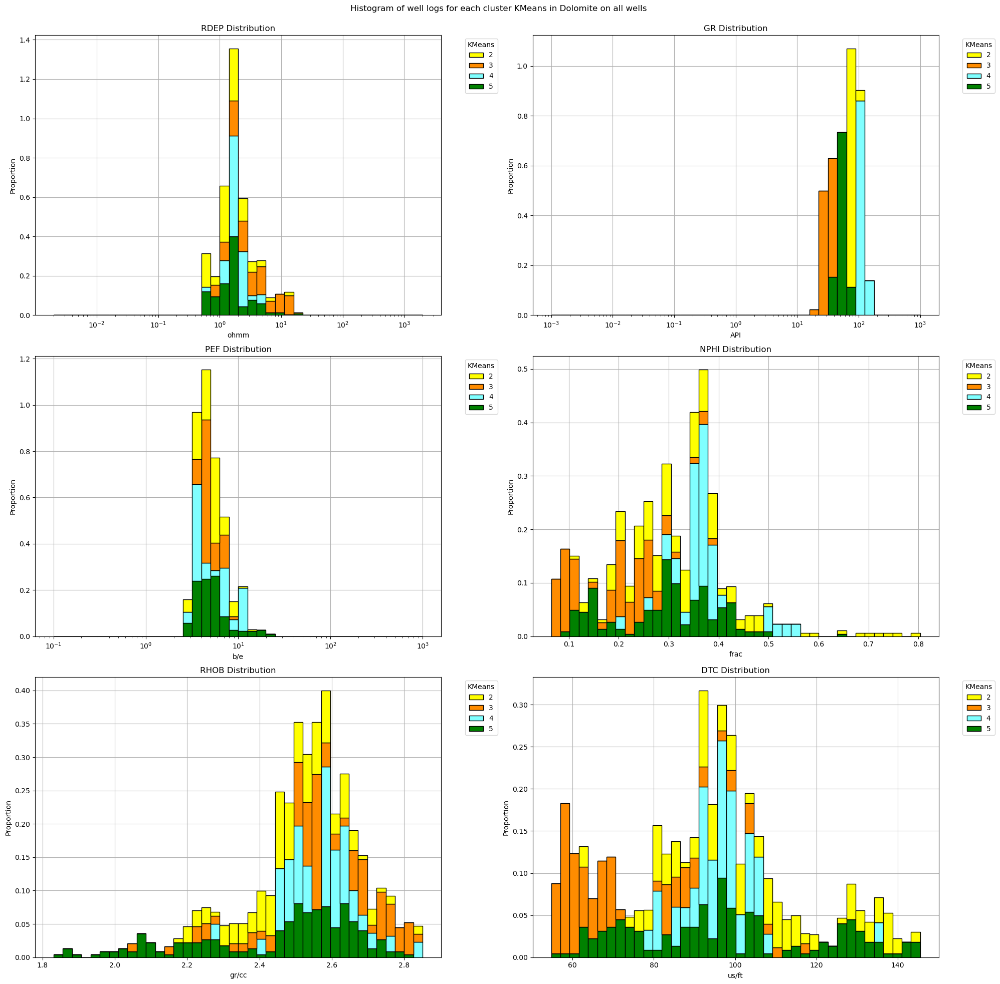

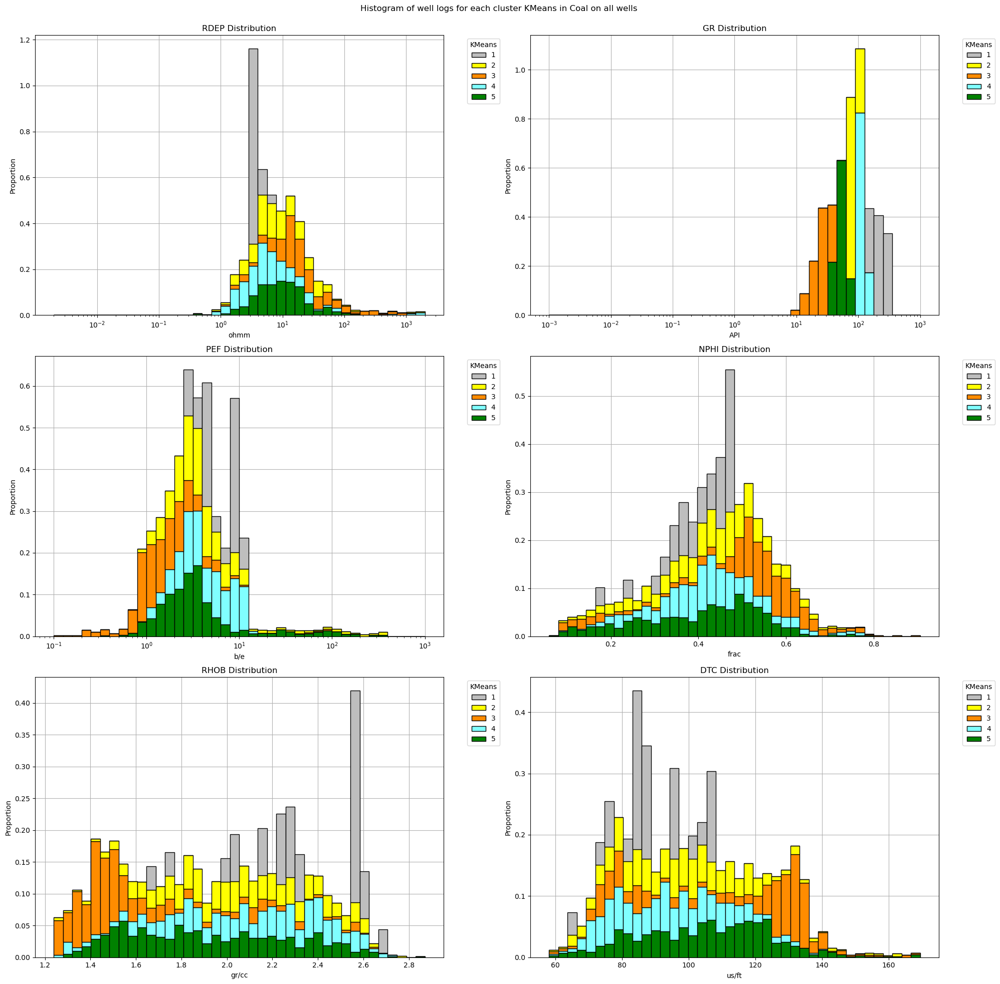

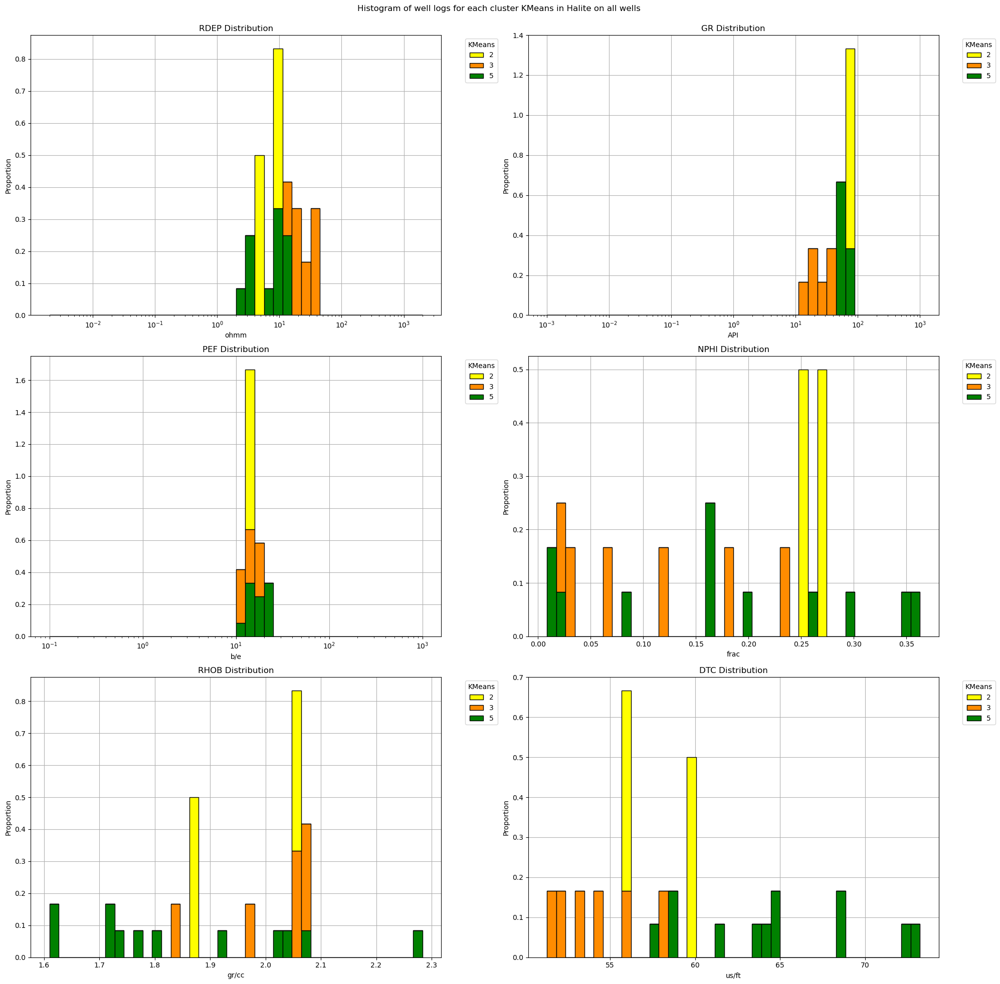

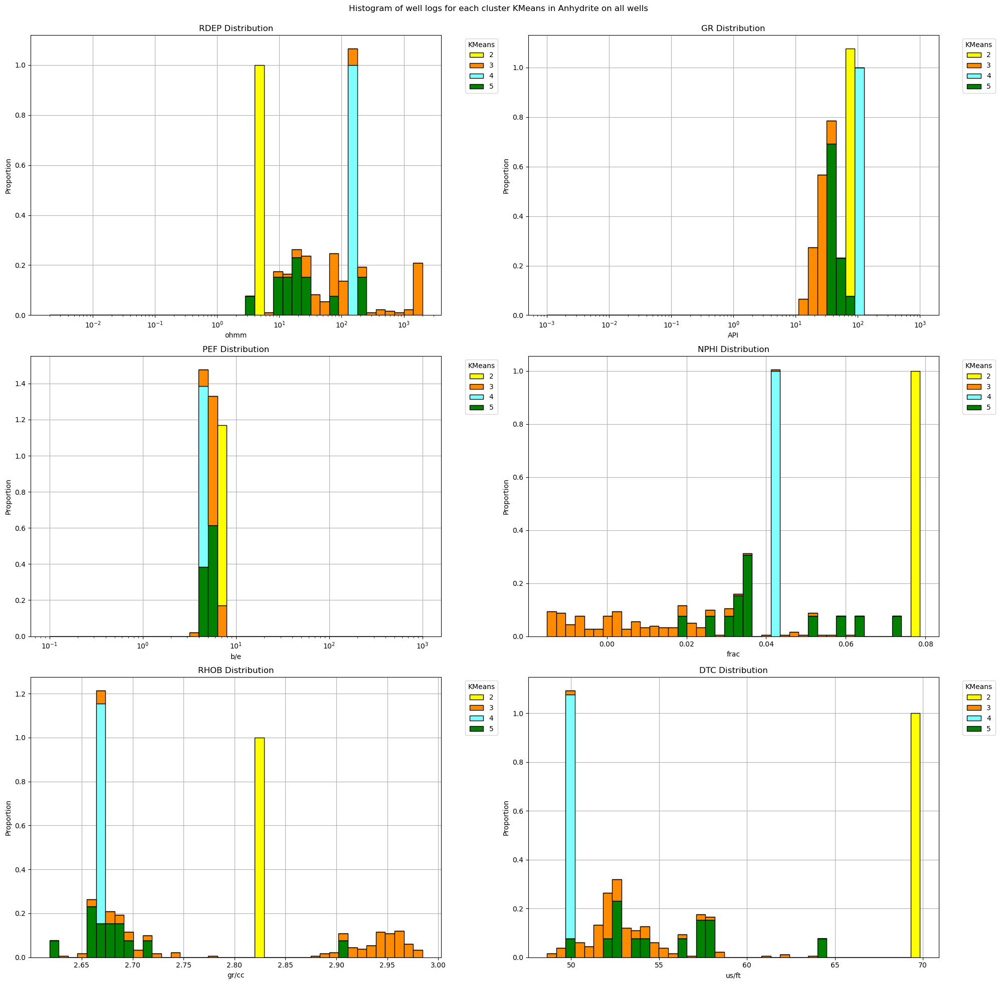

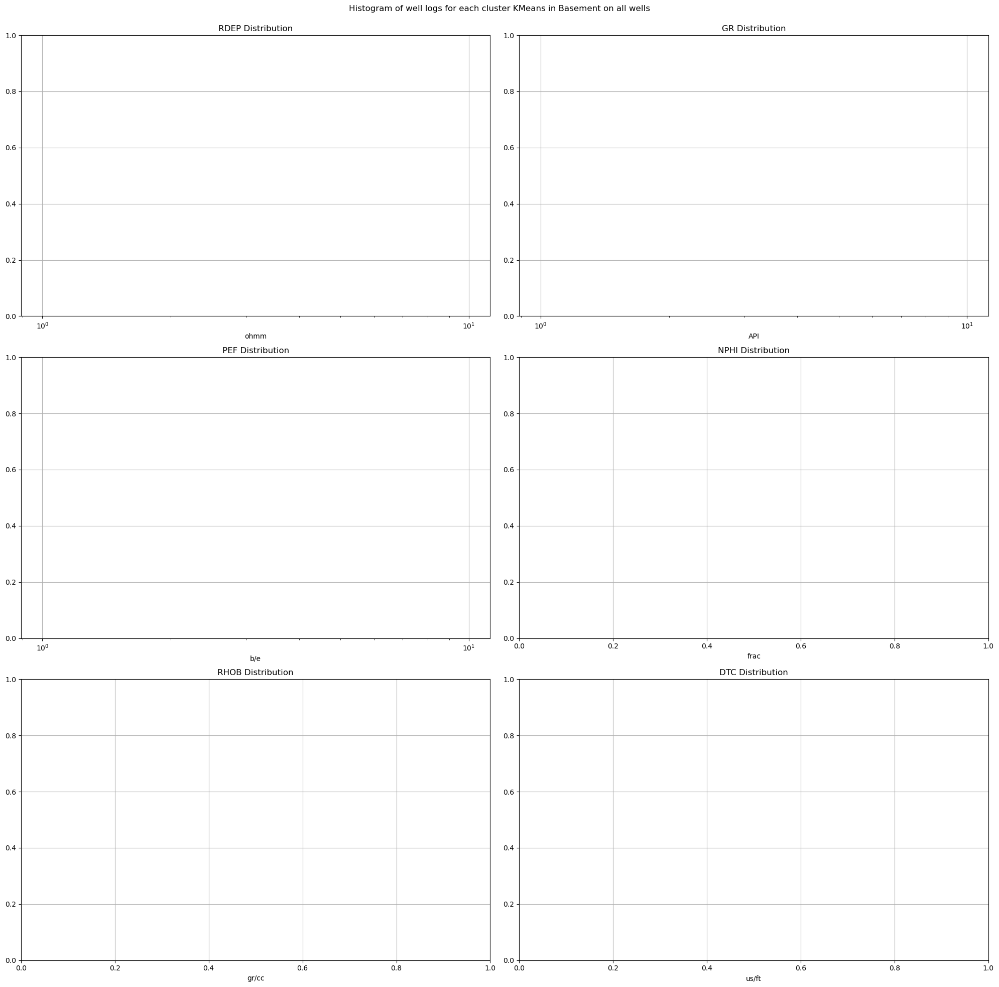

In [142]:
for i, litho in enumerate(keys_lithology):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each cluster KMeans in '+str(litho)+ ' on all wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                #pass
            #else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                #ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwelllogkmeans_'+str(litho)+'_stackproportion_mergedata_old.png', bbox_inches='tight')
    plt.show()

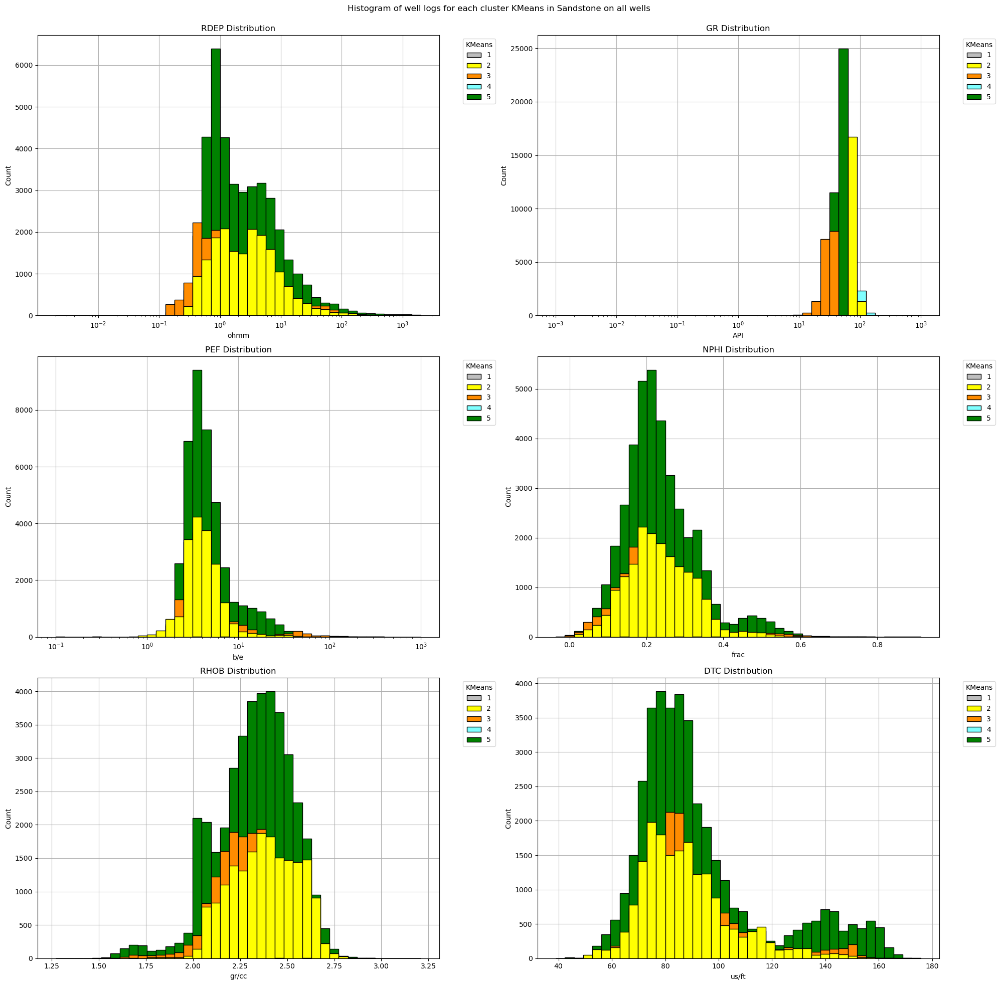

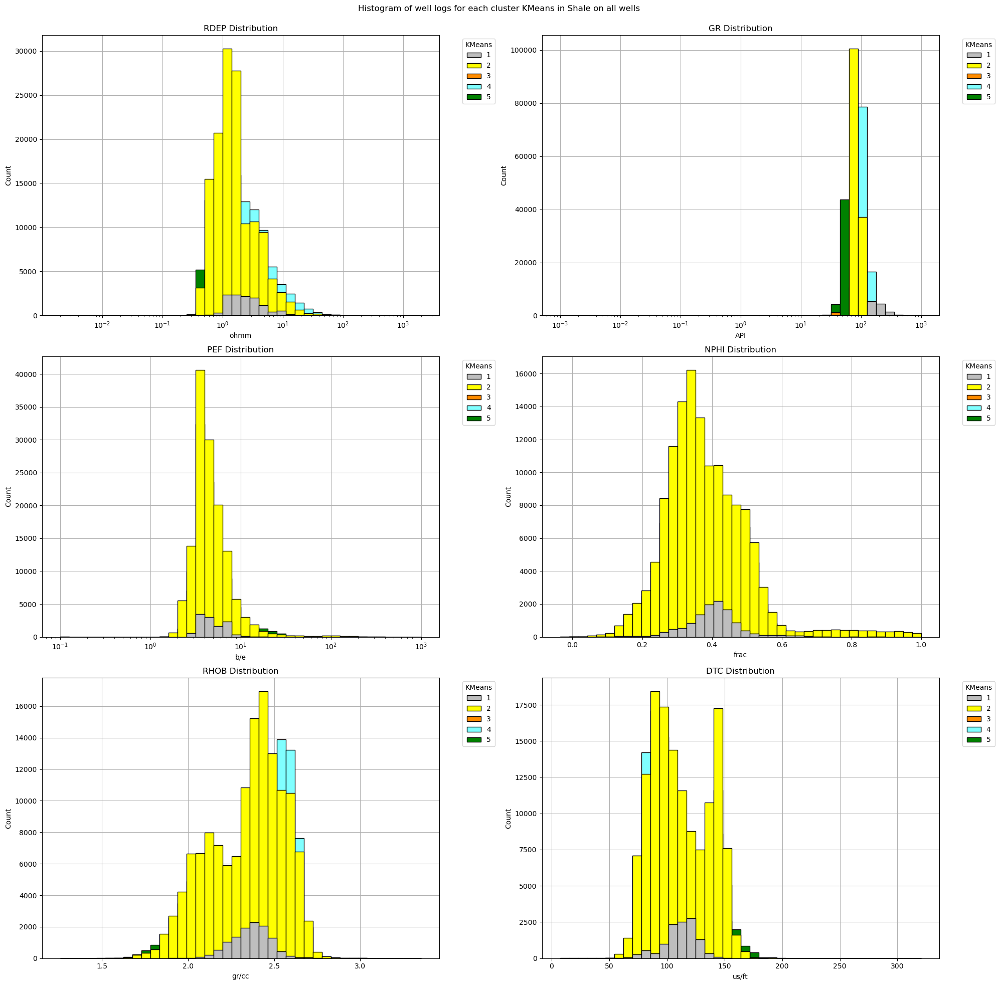

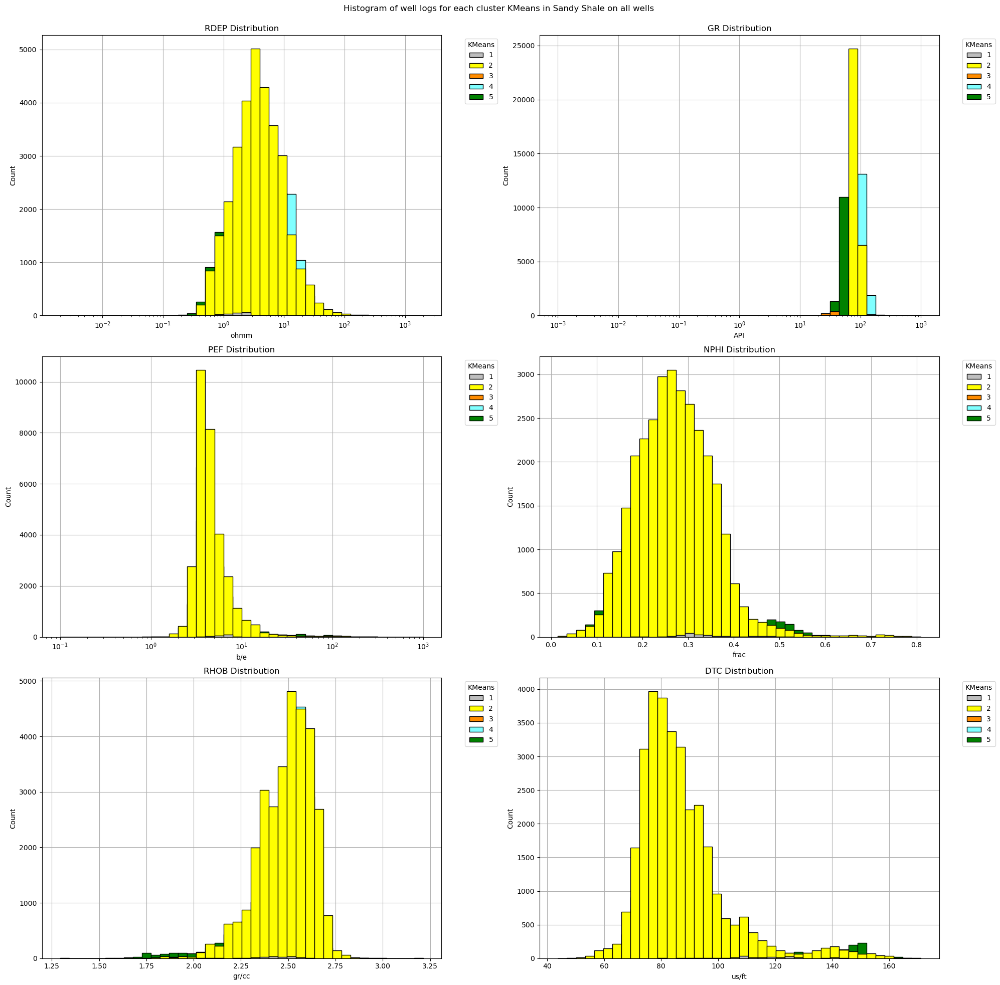

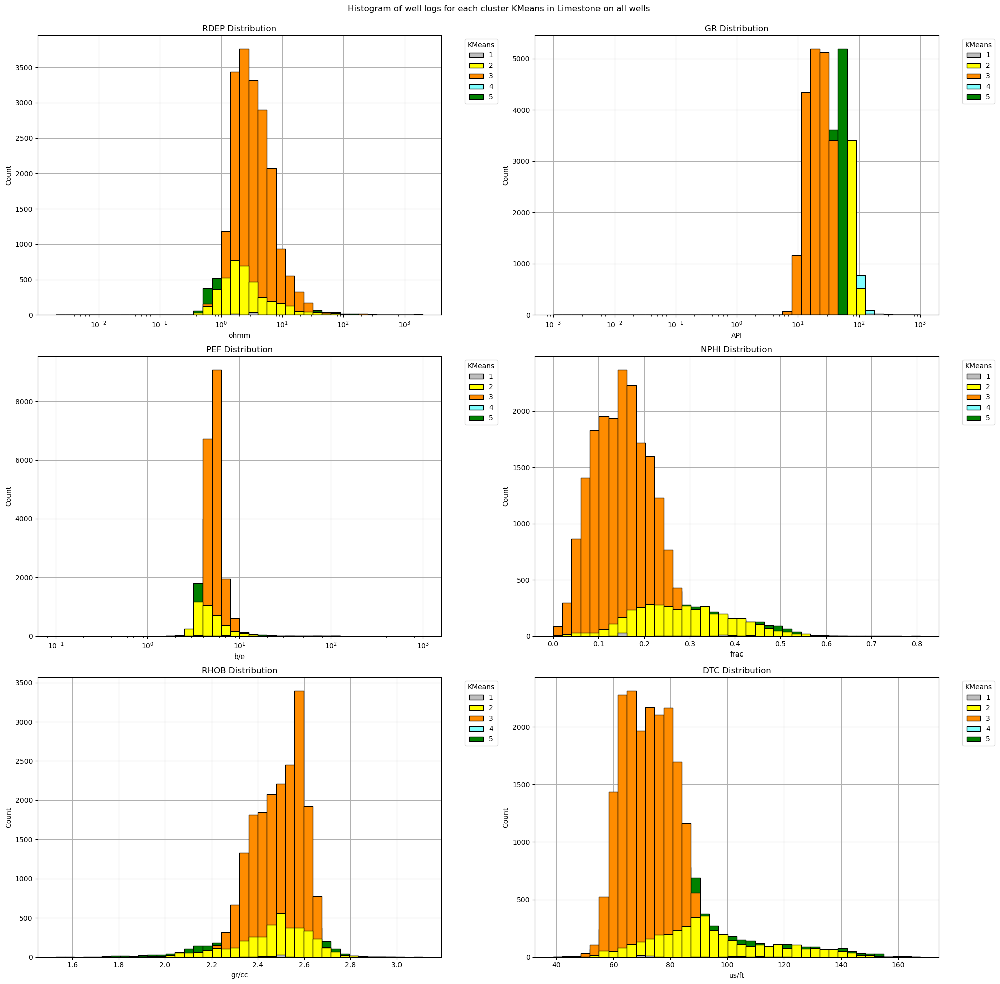

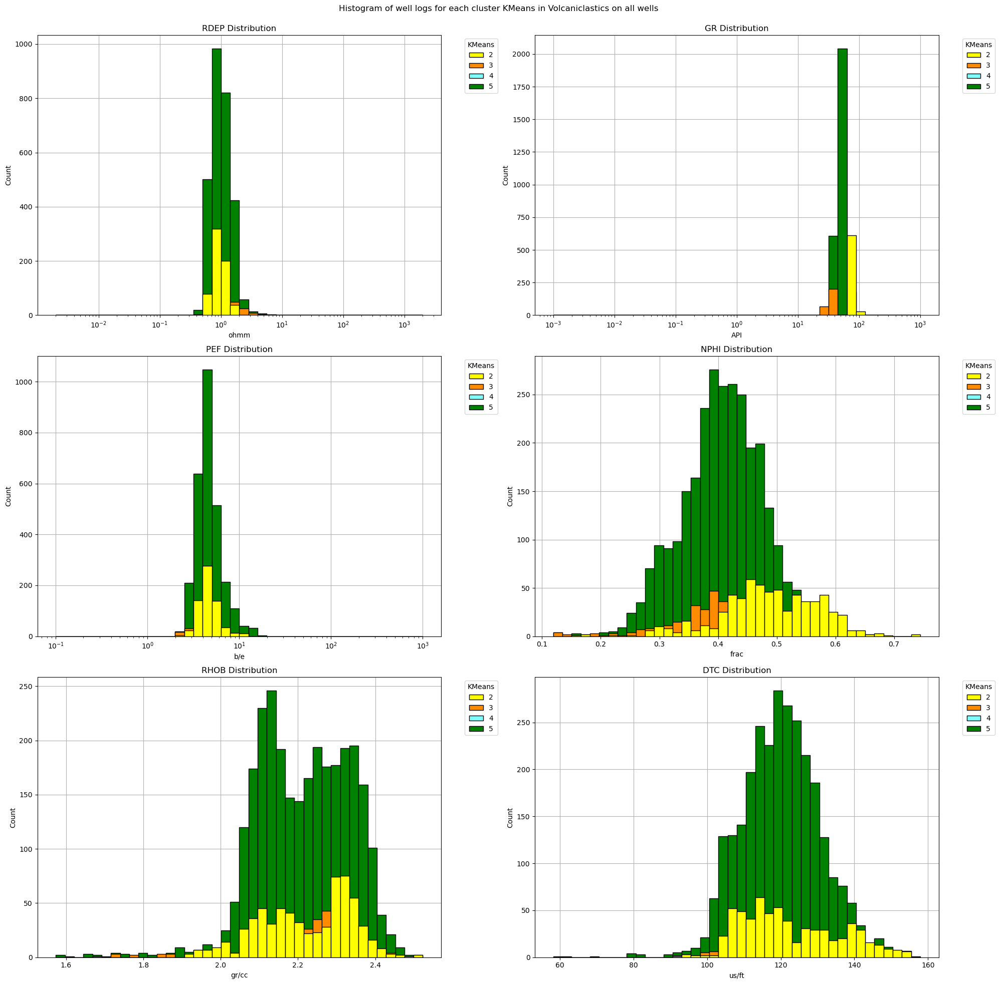

...

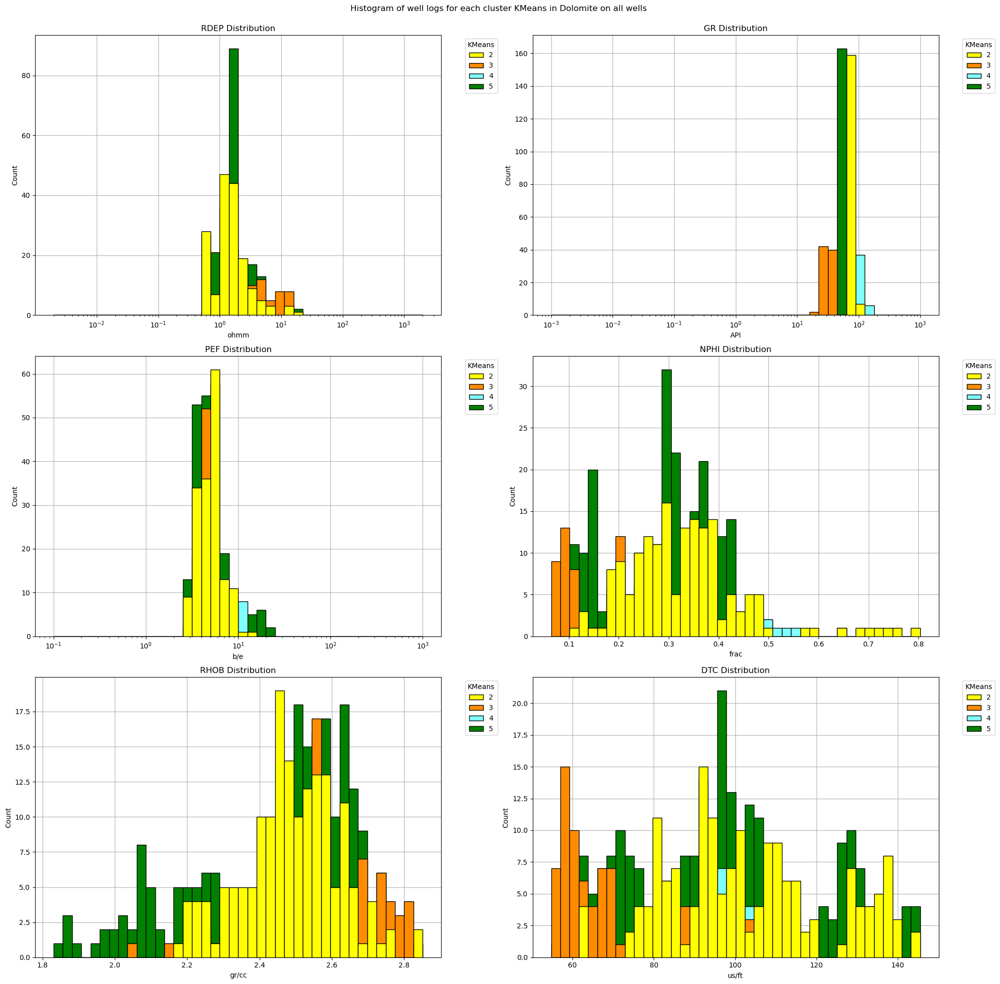

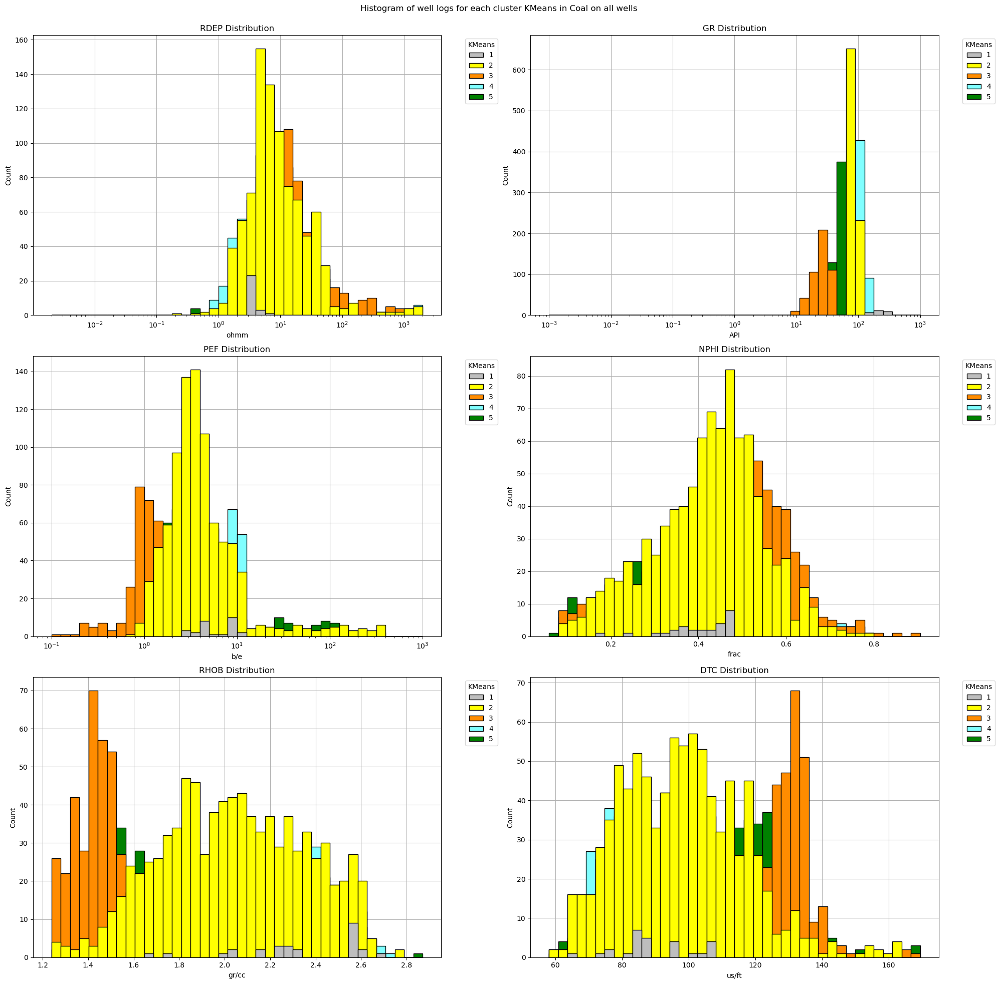

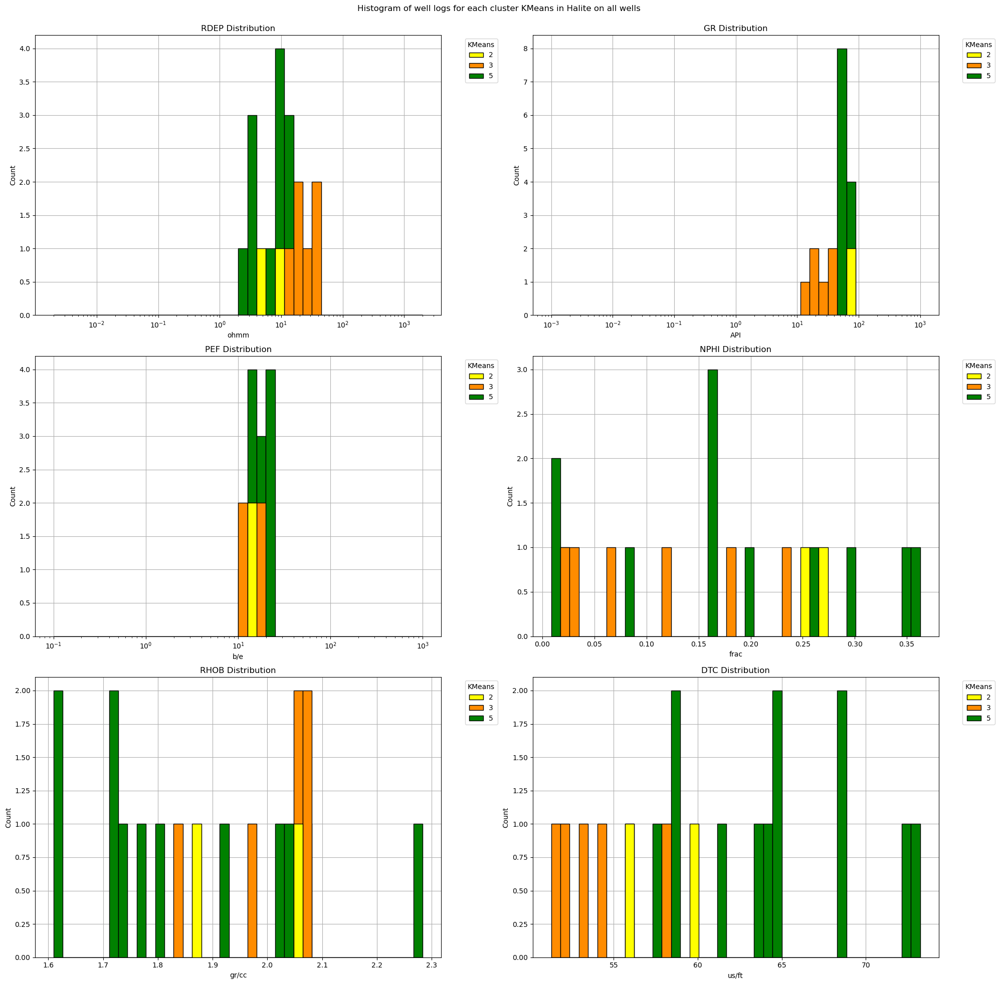

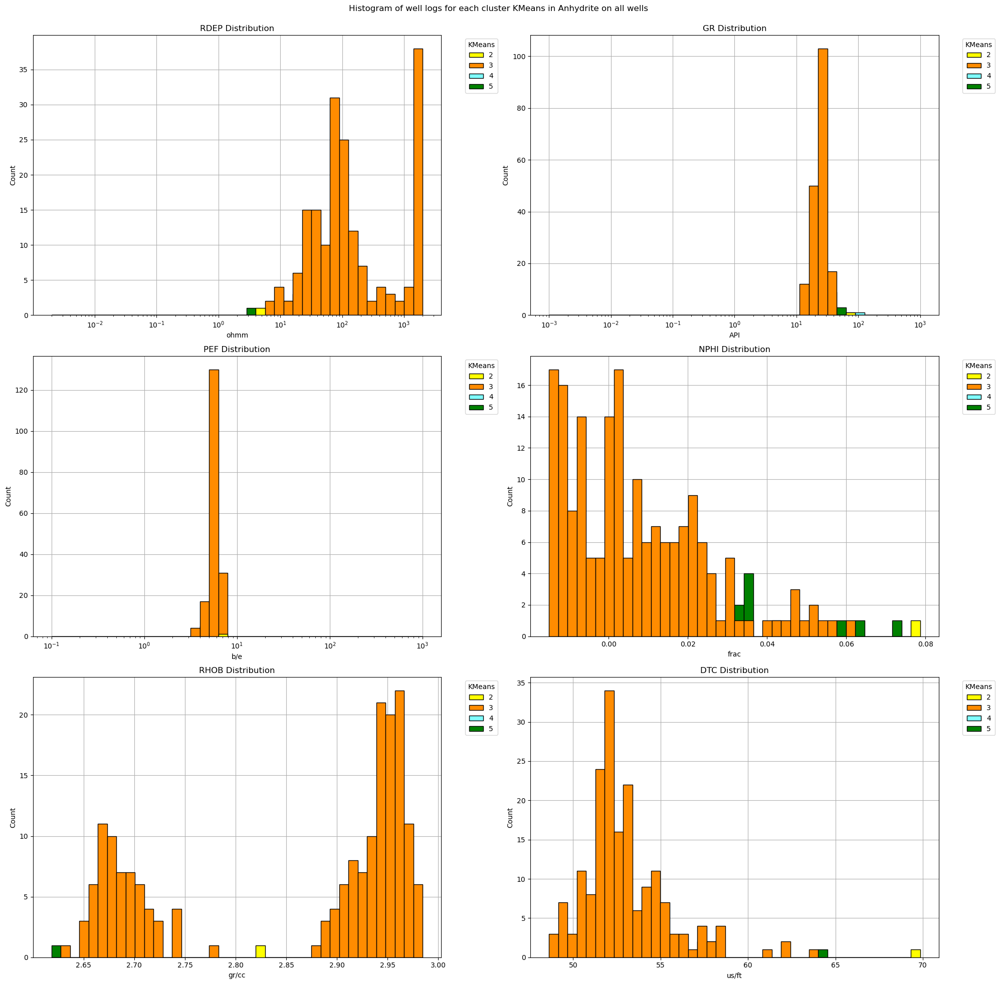

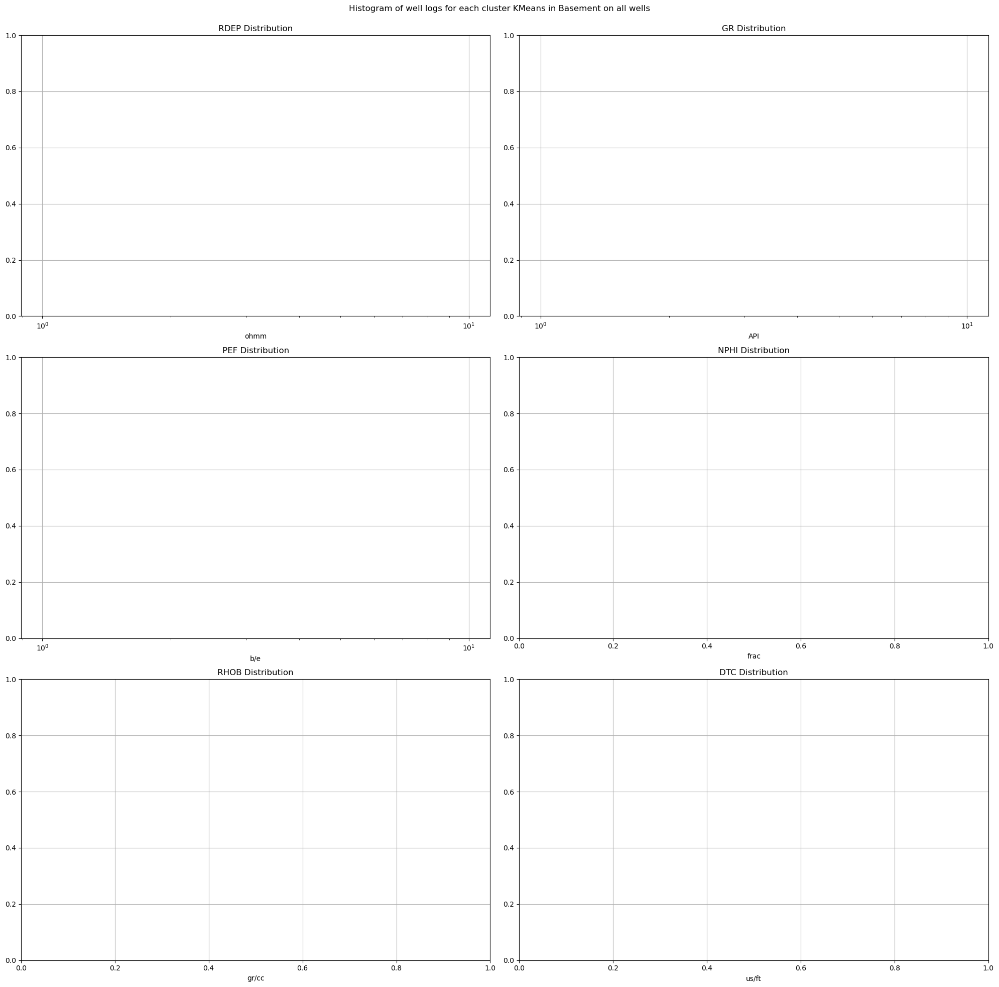

In [143]:
for i, litho in enumerate(keys_lithology):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each cluster KMeans in '+str(litho)+ ' on all wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                #pass
            #else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                #ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwelllogkmeans_'+str(litho)+'_layercount_mergedata_old.png', bbox_inches='tight')
    plt.show()

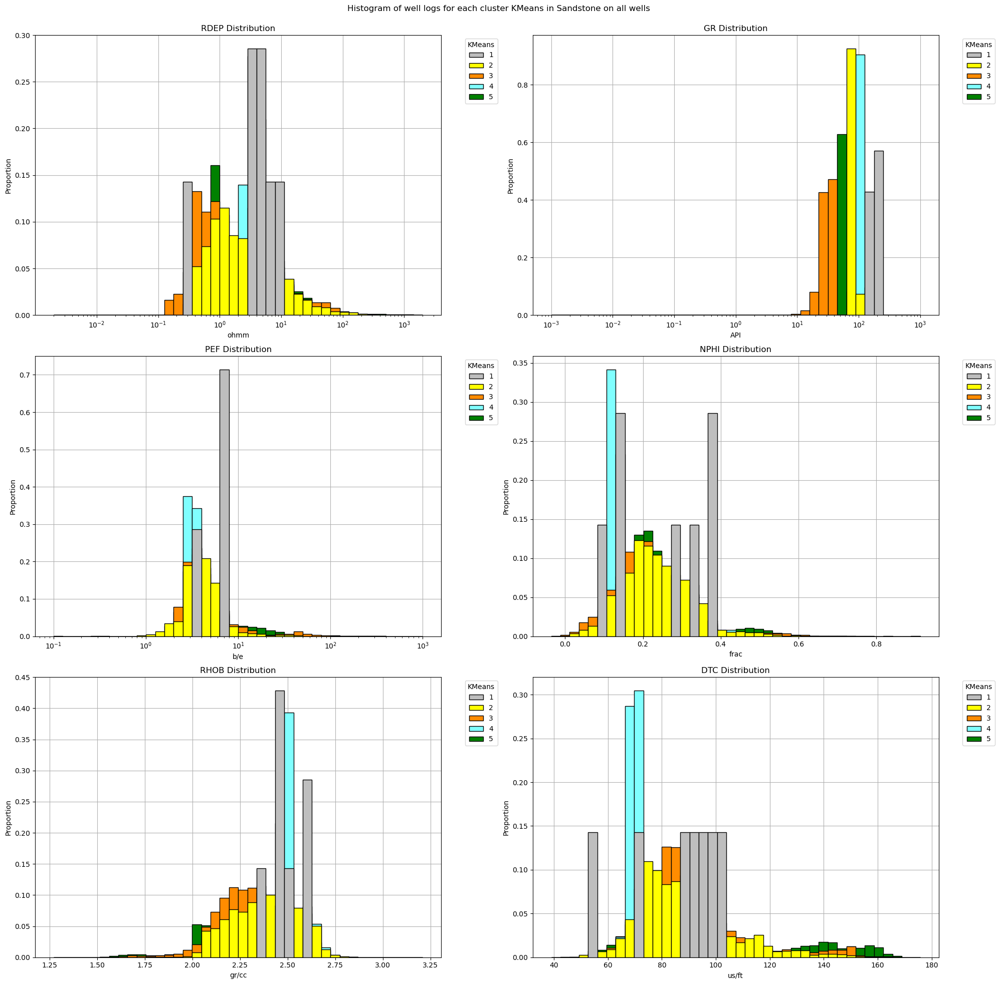

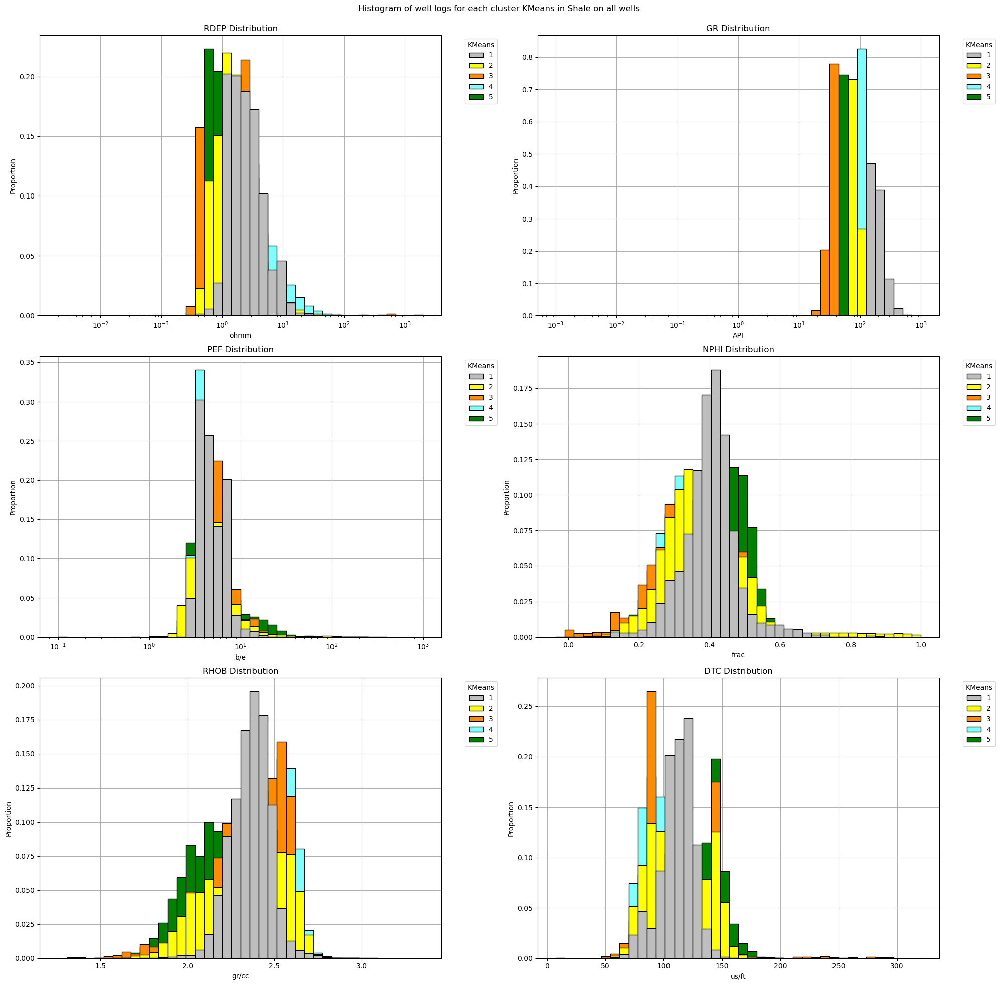

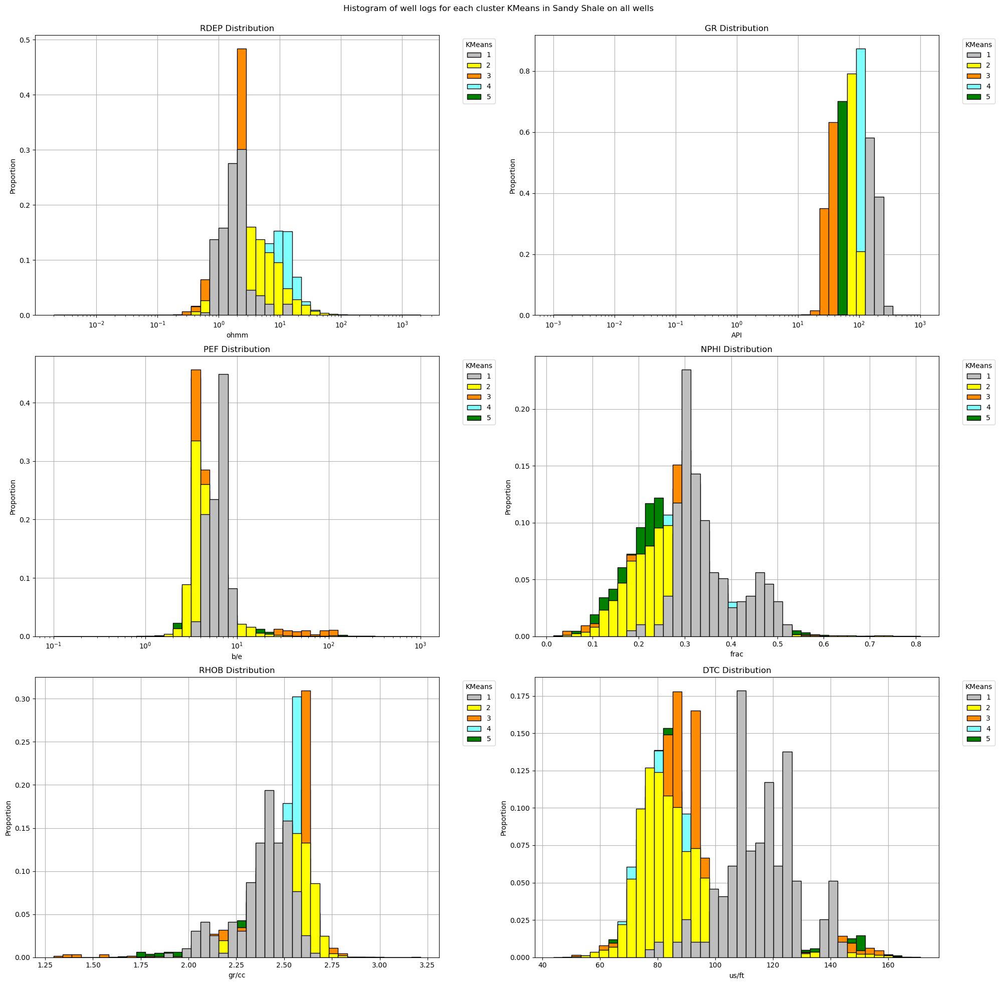

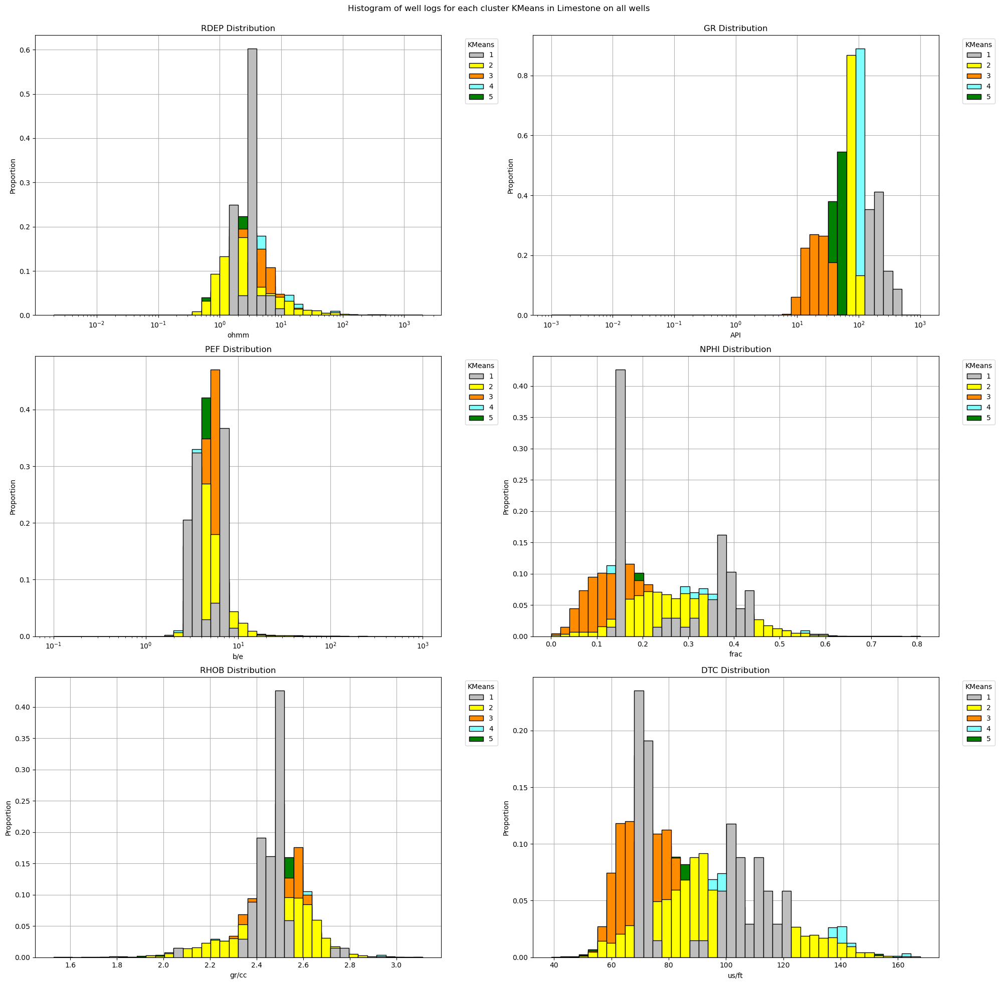

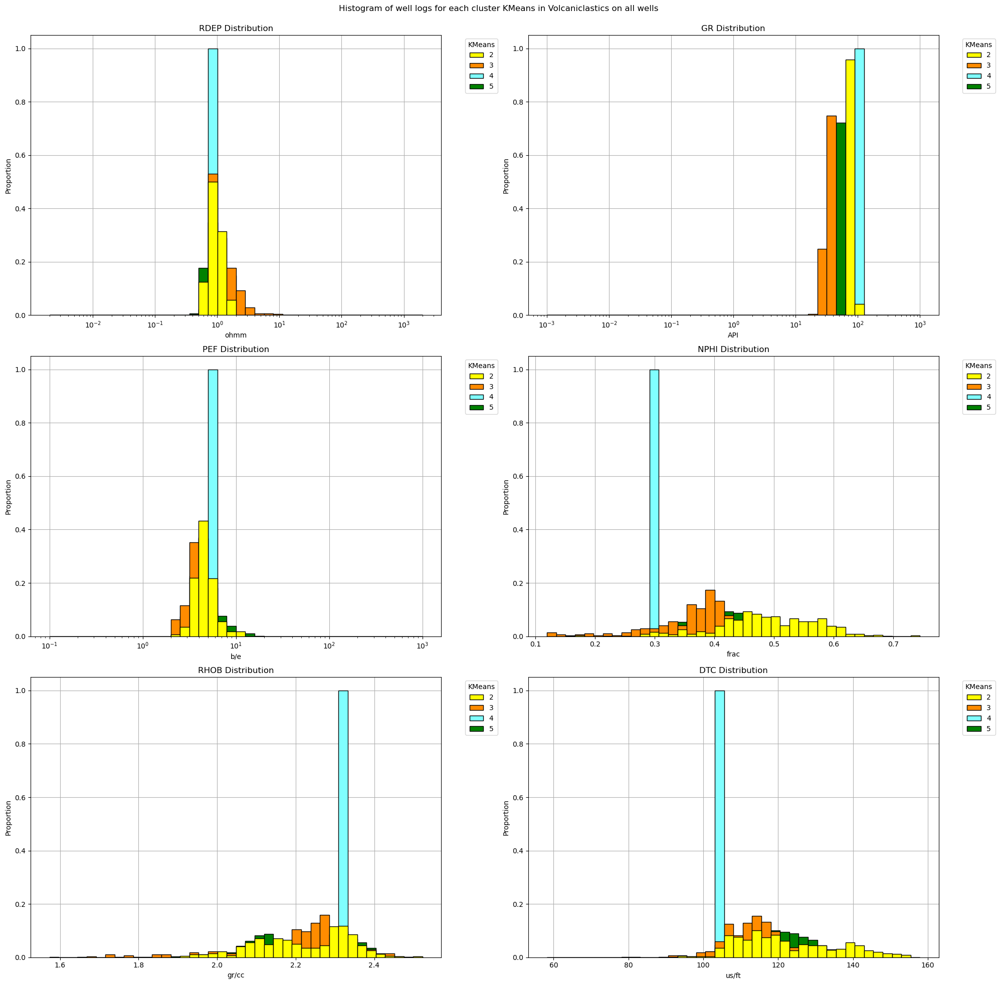

...

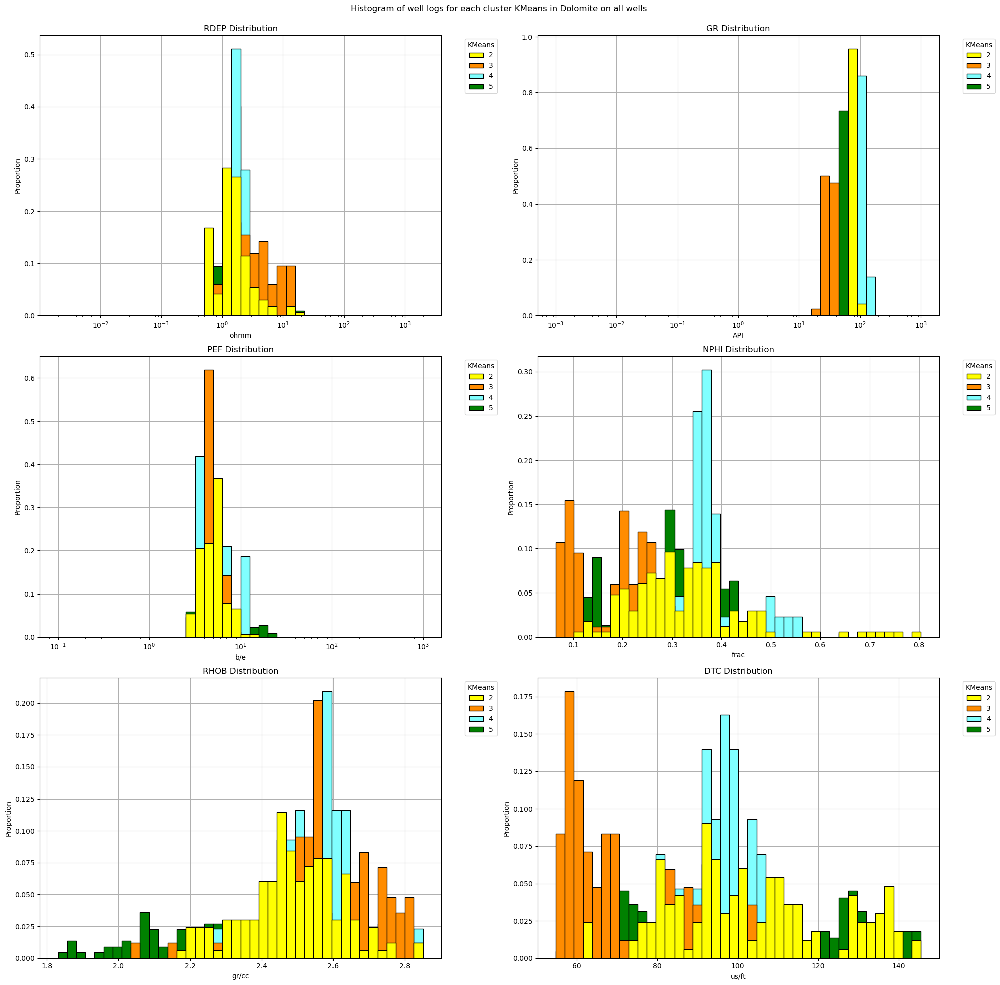

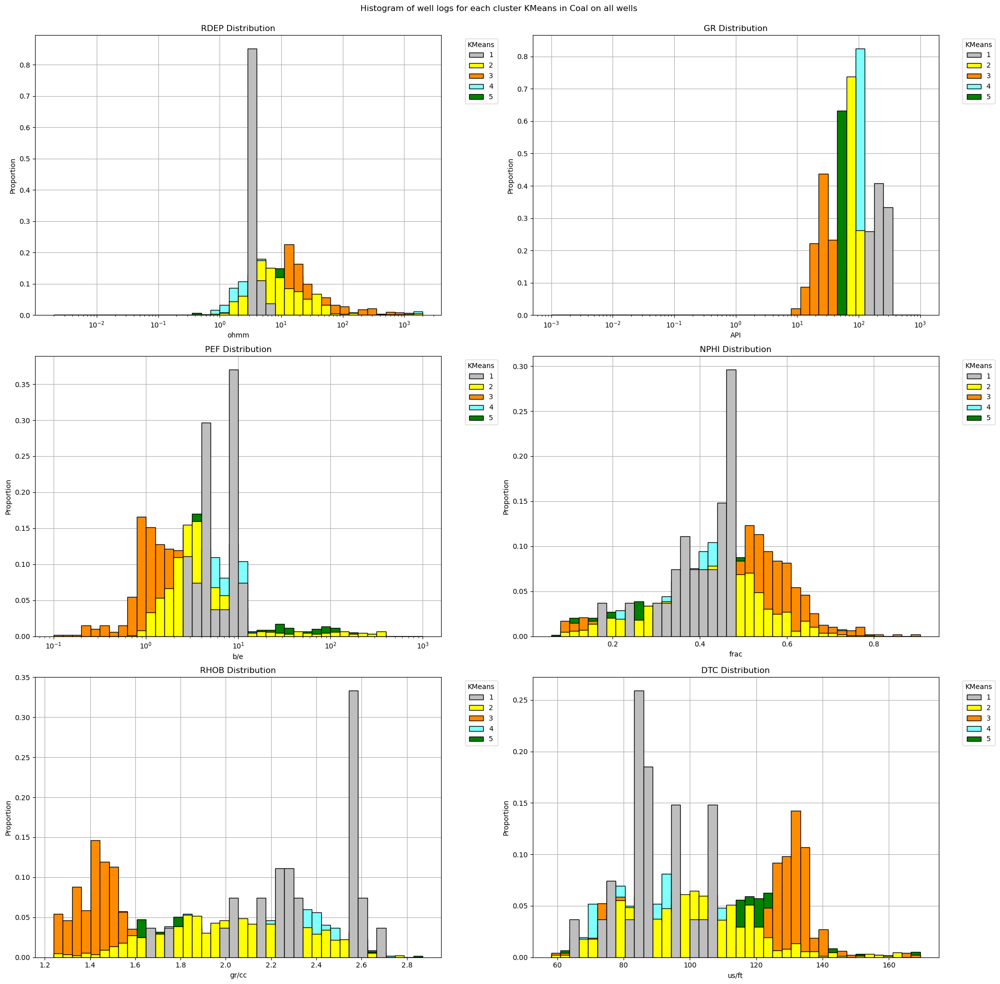

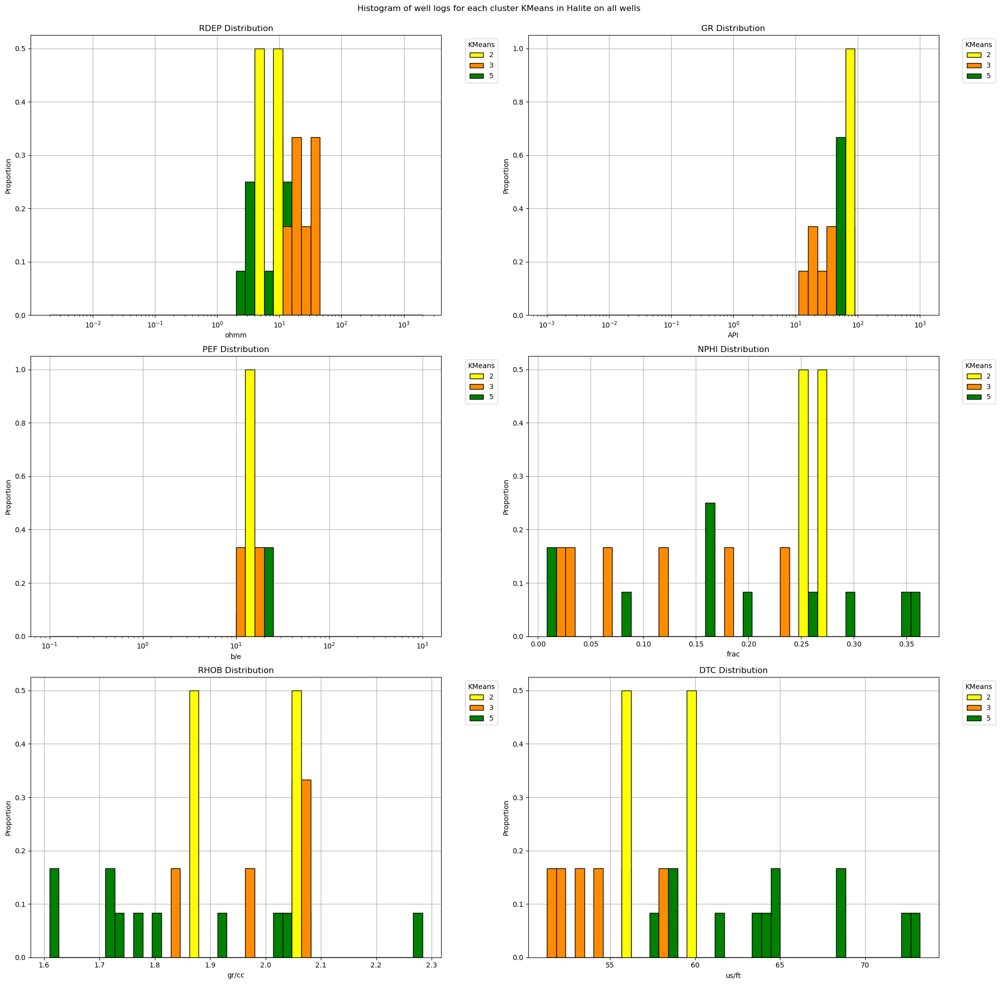

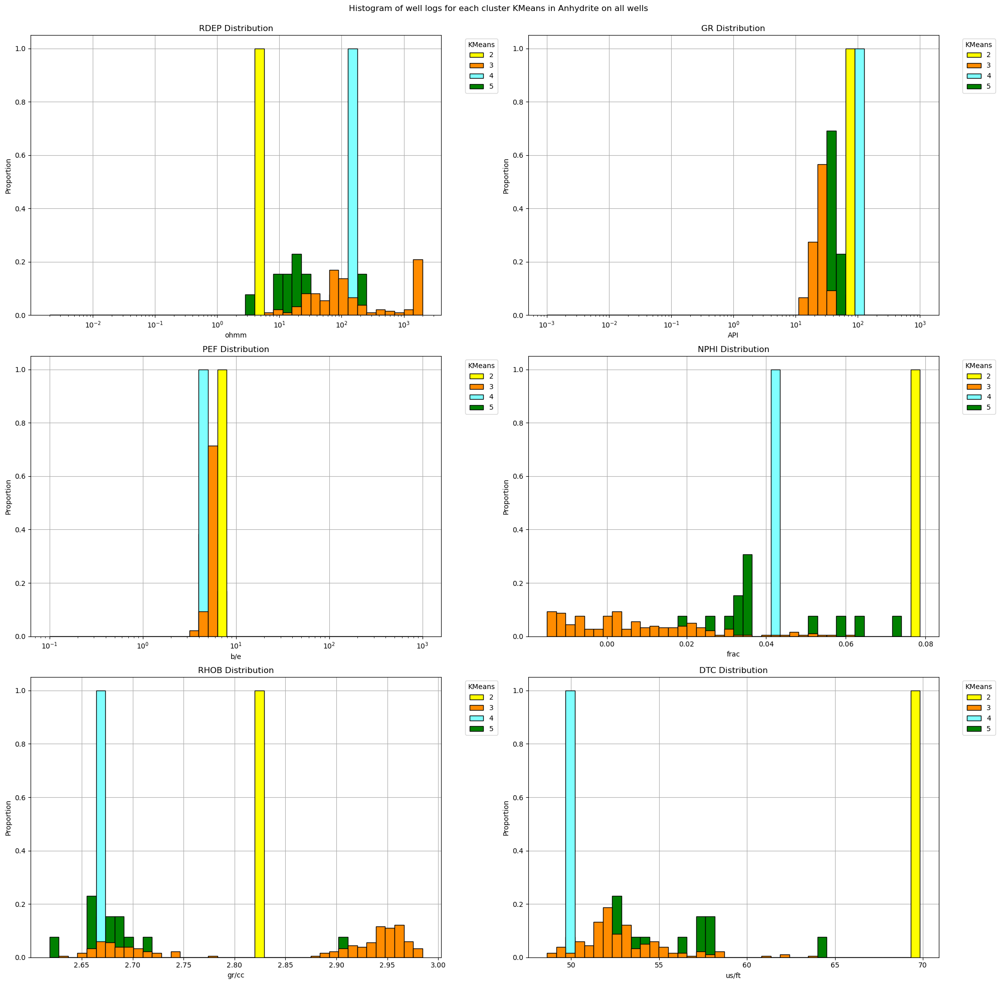

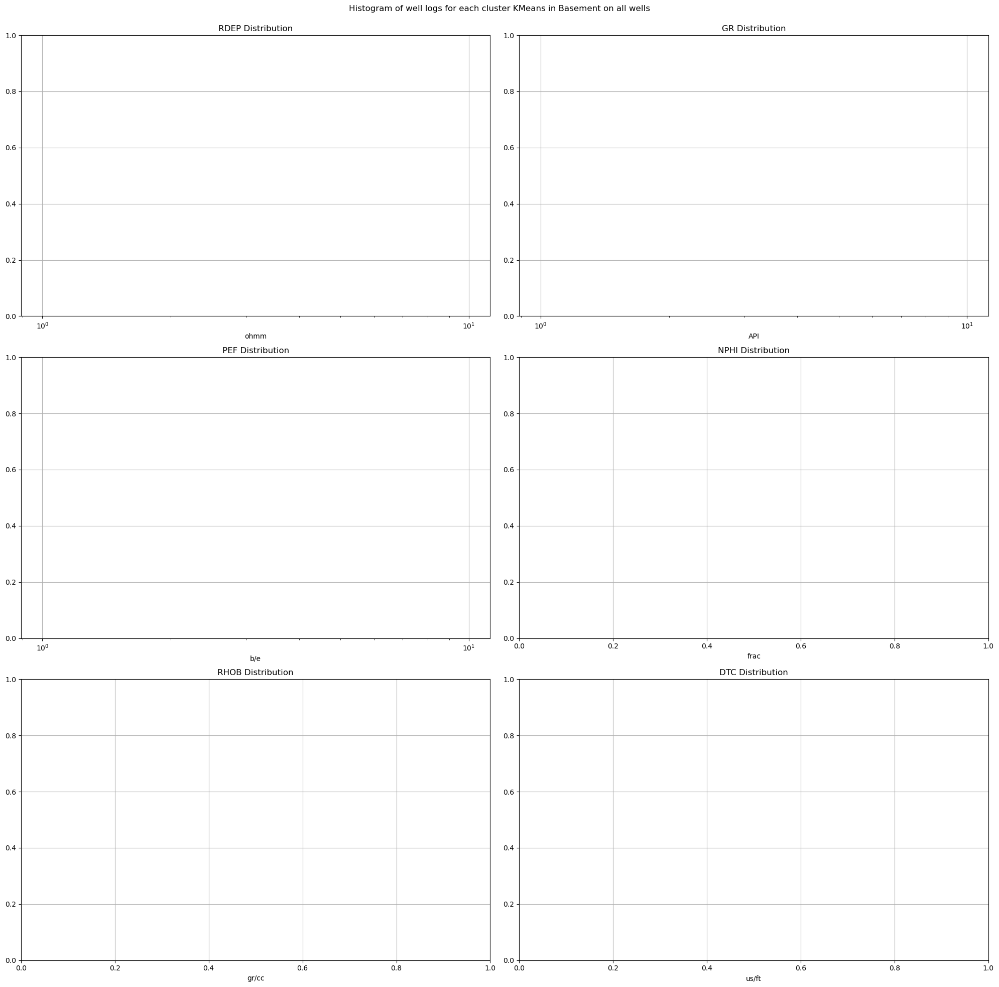

In [144]:
for i, litho in enumerate(keys_lithology):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each cluster KMeans in '+str(litho)+ ' on all wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                #pass
            #else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                #ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwelllogkmeans_'+str(litho)+'_layerproportion_mergedata_old.png', bbox_inches='tight')
    plt.show()

### KDEs


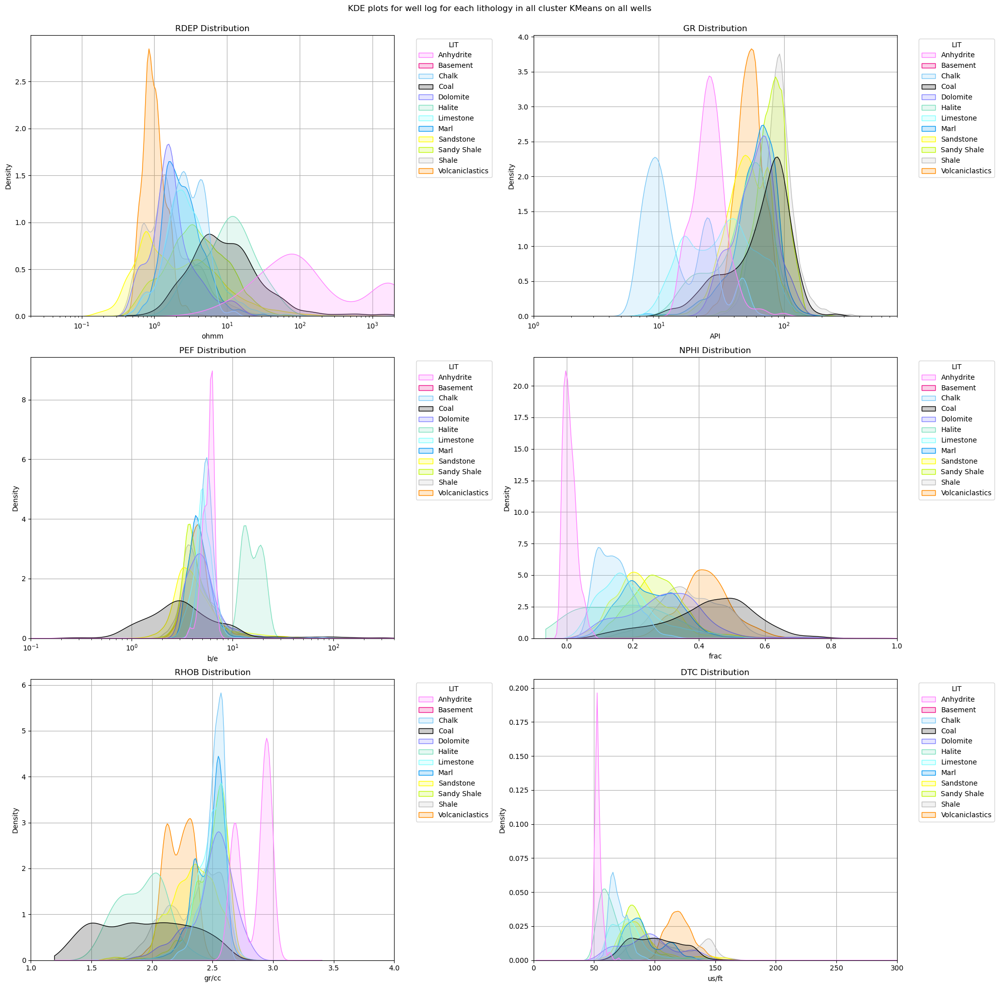

In [145]:
# KDE plots for each cluster group, lithology hue
fig = plt.figure(figsize=(20,20))
fig.suptitle('KDE plots for well log for each lithology in all cluster KMeans on all wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    
    if i==0:
        #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
        ax.set_xlim(0.02, 2000)
    elif i==1:
        #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(1),np.log10(1000),40), ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("log")
        ax.set_xlabel('API')
        ax.set_xlim(1, 800)
    elif i==2:
        #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(1),np.log10(1000),40), ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
        ax.set_xlim(0.1, 400)
    elif i==3:
        #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
        ax.set_xlim(-0.1, 1)
    elif i==4:
        #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
        ax.set_xlim(1, 4)
    #elif i==5:
        #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
        #ax=sns.kdeplot(data=well_clustered, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')
        #ax.set_xlim(-500, 500)
    else:
        #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')
        ax.set_xlim(0, 300)

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('kdewellloglithology_allclusters_mergedata_old.png', bbox_inches='tight')
plt.show()

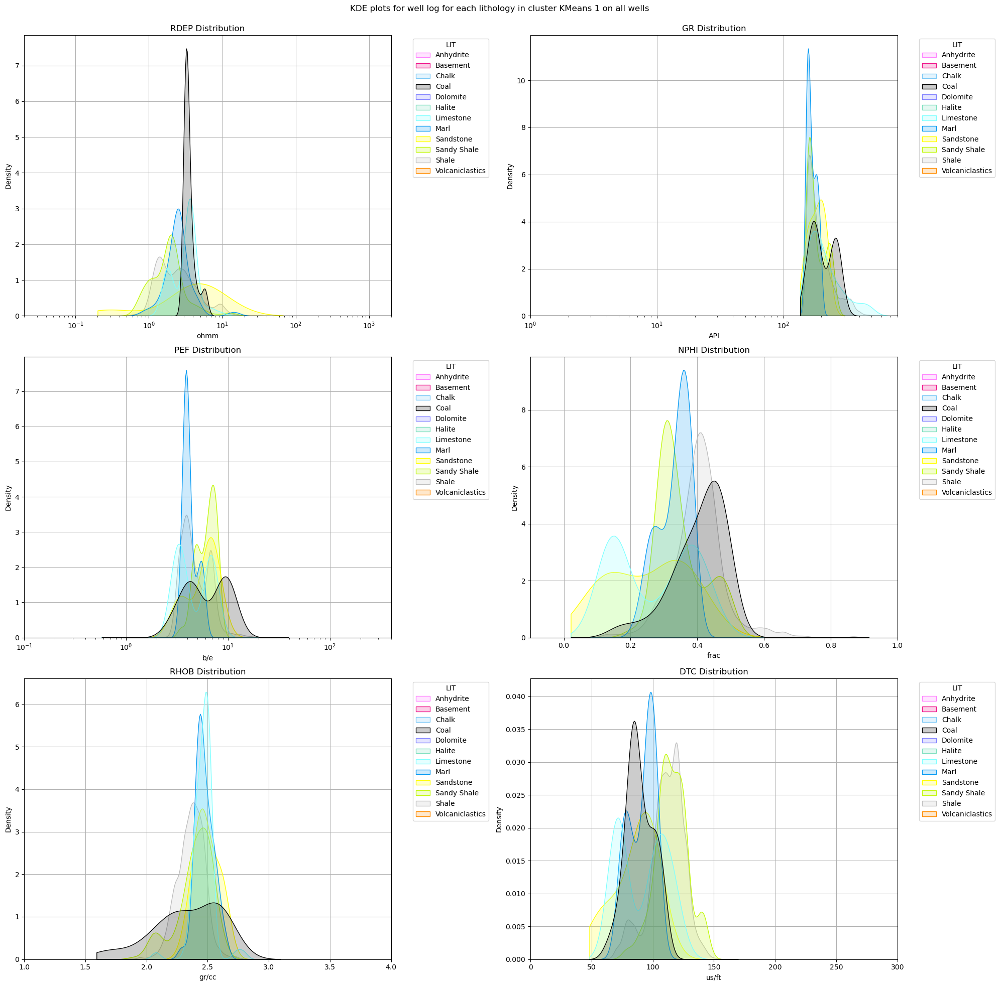

C:\Users\V330\AppData\Local\Temp\ipykernel_1728\417236618.py:13: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
C:\Users\V330\AppData\Local\Temp\ipykernel_1728\417236618.py:19: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
C:\Users\V330\AppData\Local\Temp\ipykernel_1728\417236618.py:25: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature

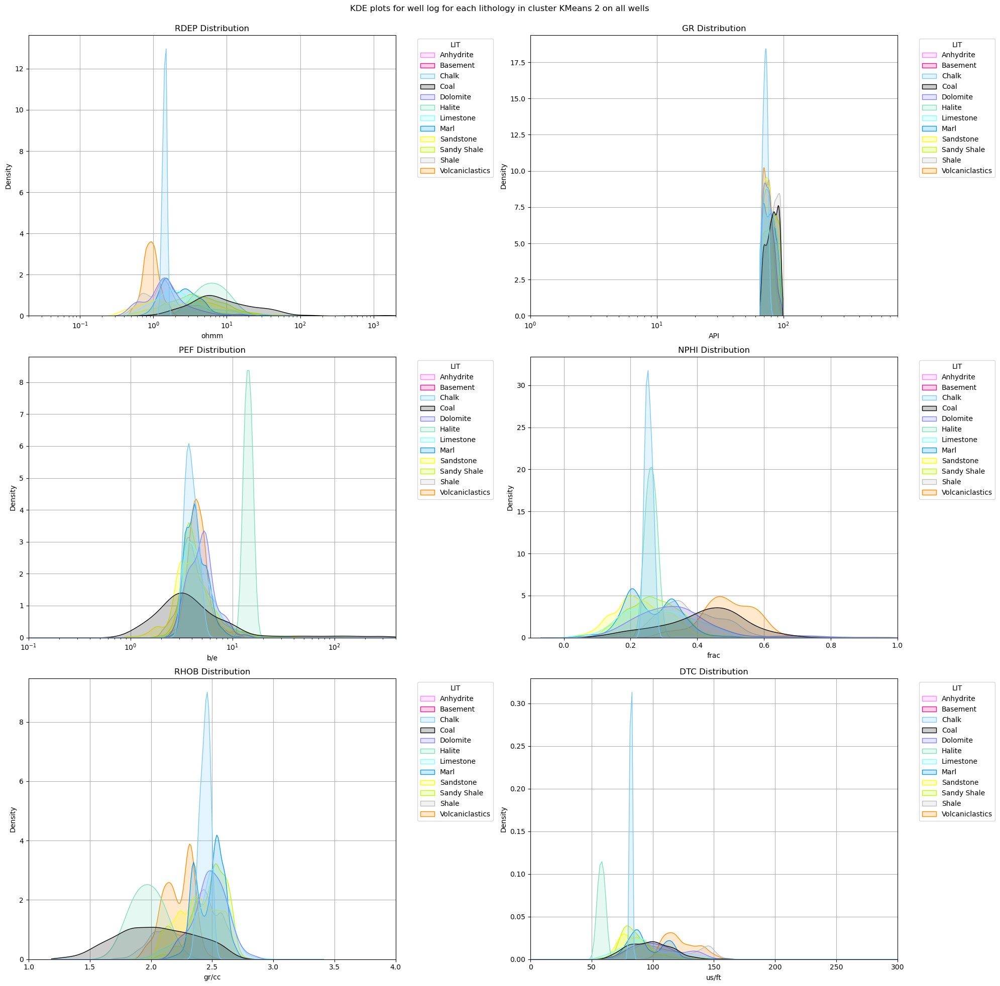

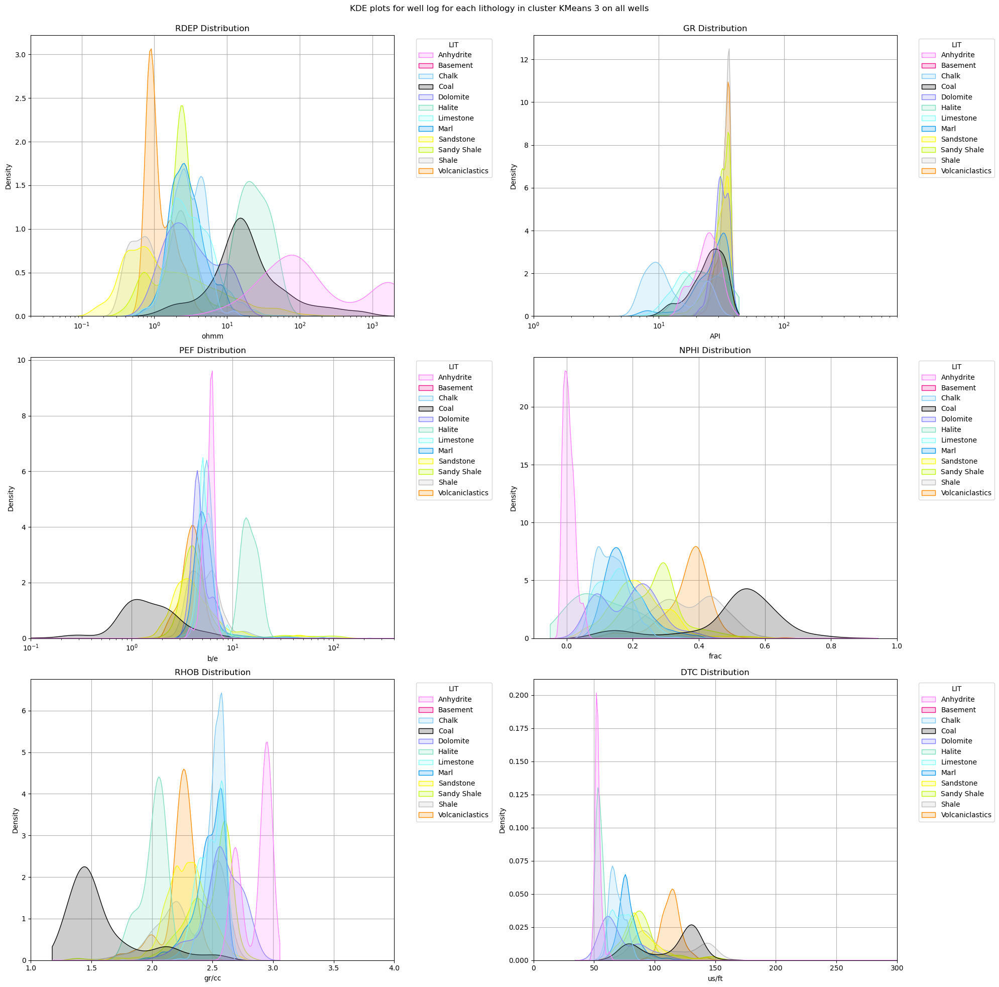

C:\Users\V330\AppData\Local\Temp\ipykernel_1728\417236618.py:13: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
C:\Users\V330\AppData\Local\Temp\ipykernel_1728\417236618.py:13: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
C:\Users\V330\AppData\Local\Temp\ipykernel_1728\417236618.py:19: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature

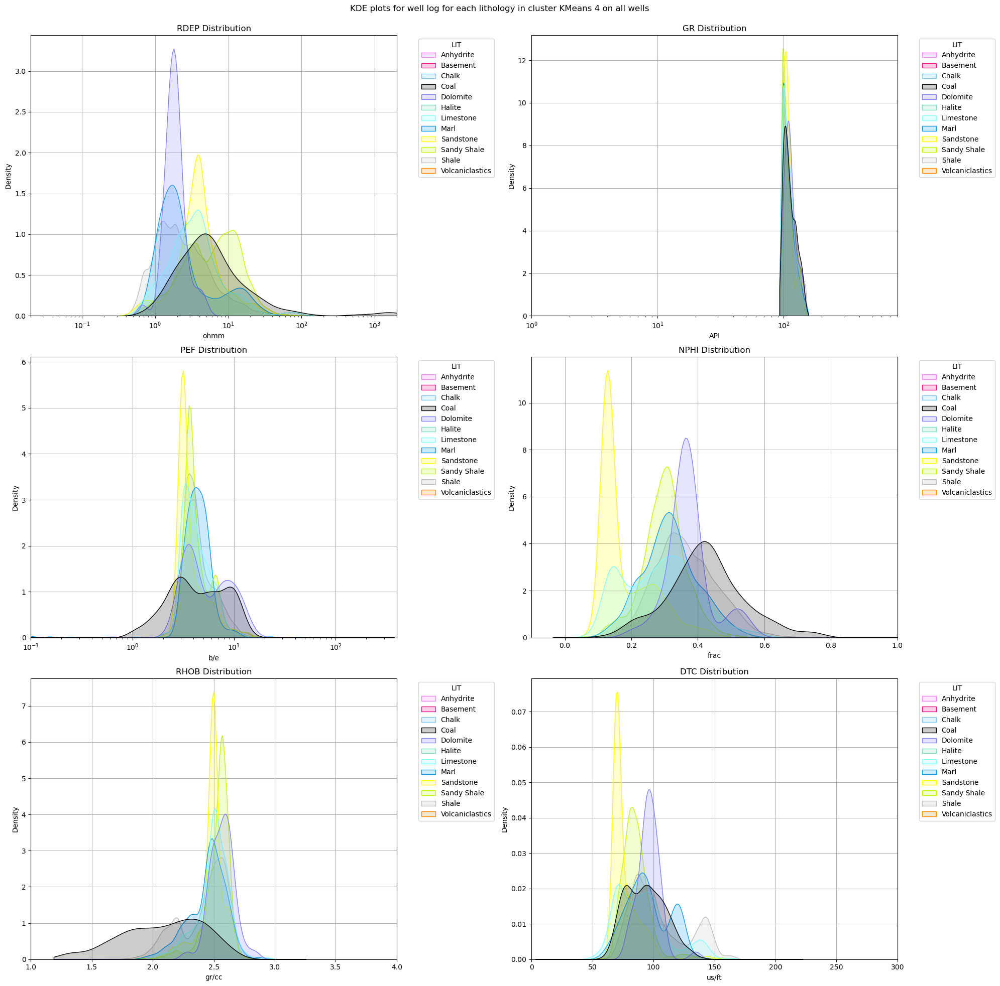

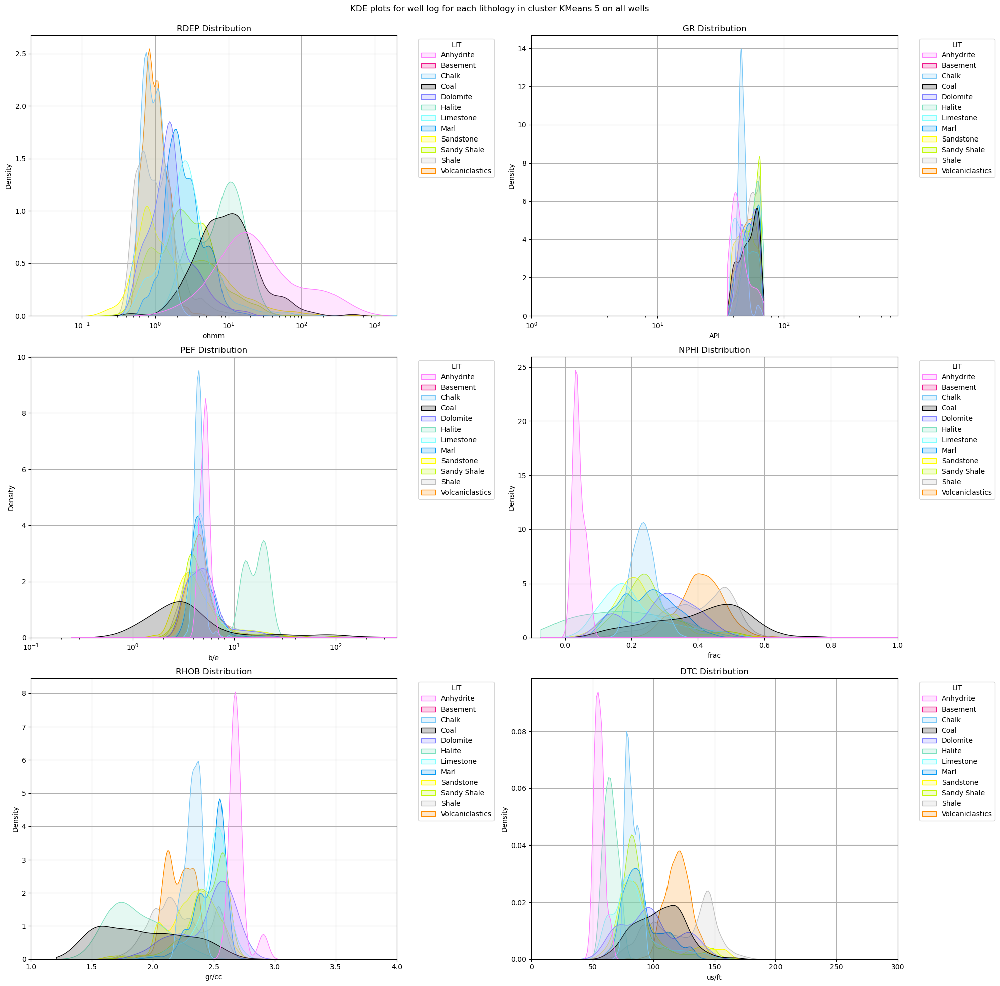

In [146]:
# KDE plots for each cluster group, lithology hue
for i, kmeans in enumerate(keys_kmeans):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('KDE plots for well log for each lithology in cluster KMeans '+str(kmeans)+ ' on all wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
        
        if i==0:
            #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=False ,grid=True)
            ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
            ax.set_xlim(0.02, 2000)
        elif i==1:
            #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(1),np.log10(1000),40), ax=ax, legend=False ,grid=True)
            ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
            ax.set_xscale("log")
            ax.set_xlabel('API')
            ax.set_xlim(1, 800)
        elif i==2:
            #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(1),np.log10(1000),40), ax=ax, legend=False ,grid=True)
            ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
            ax.set_xlim(0.1, 400)
        elif i==3:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
            ax.set_xlim(-0.1, 1)
        elif i==4:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
            ax.set_xlim(1, 4)
        #elif i==5:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            #ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
            #ax.set_xlim(-500, 500)
        else:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')
            ax.set_xlim(0, 300)

        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.grid()
    
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.95)#plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('kdewellloglithology_kmeanscluster'+str(kmeans)+'_mergedata_old.png', bbox_inches='tight')
    plt.show()

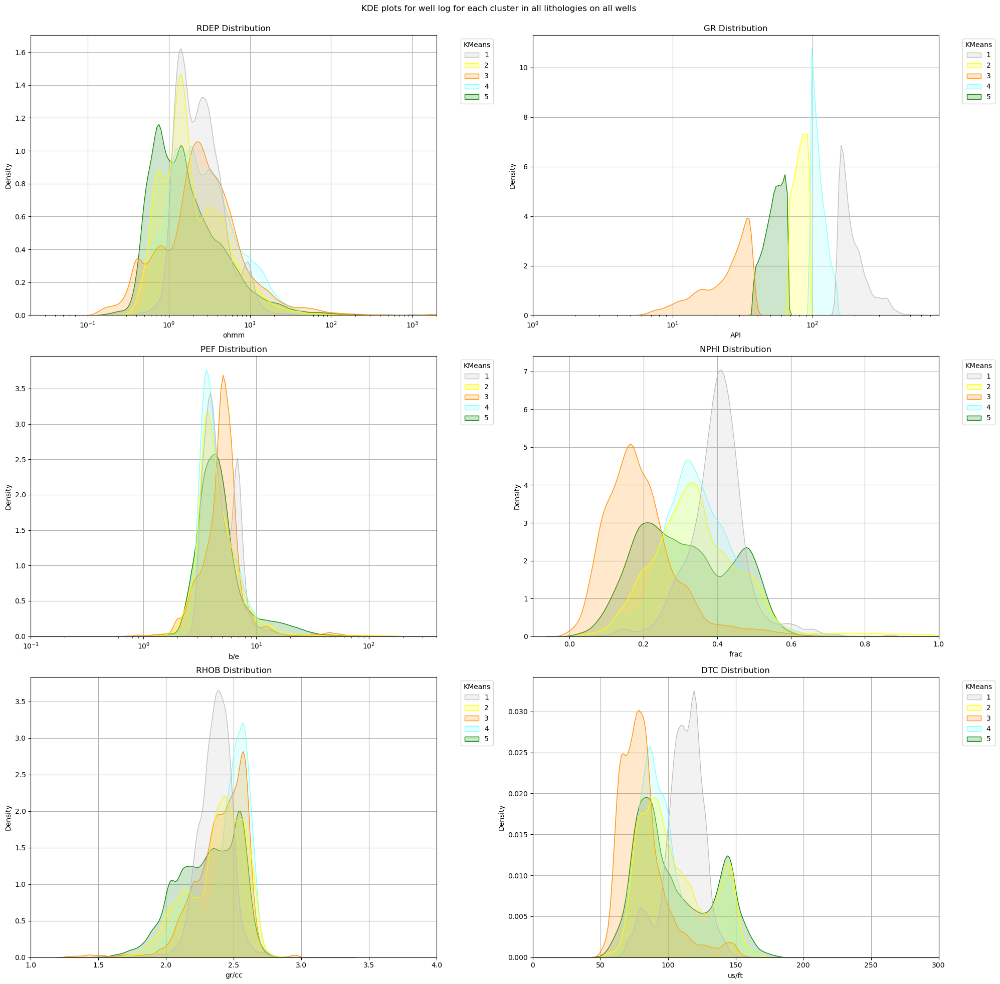

In [147]:
# KDE plots for each lithology group, cluster KMeans hue
fig = plt.figure(figsize=(20,20))
fig.suptitle('KDE plots for well log for each cluster in all lithologies on all wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    
    if i==0:
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
        ax.set_xlim(0.02, 2000)
        
    elif i==1:
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('API')
        ax.set_xlim(1, 800)
        
    elif i==2:
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
        ax.set_xlim(0.1, 400)
    elif i==3:
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
        ax.set_xlim(-0.1, 1)
    elif i==4:
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
        ax.set_xlim(1, 4)
        
    #elif i==5:
        #ax=sns.kdeplot(data=well_clustered, x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
        #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')
        #ax.set_xlim(-500, 500)
        
    else:
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')
        ax.set_xlim(0, 300)
        
    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('kdewelllogkmeans_alllithology_mergedata_old.png', bbox_inches='tight')
plt.show()

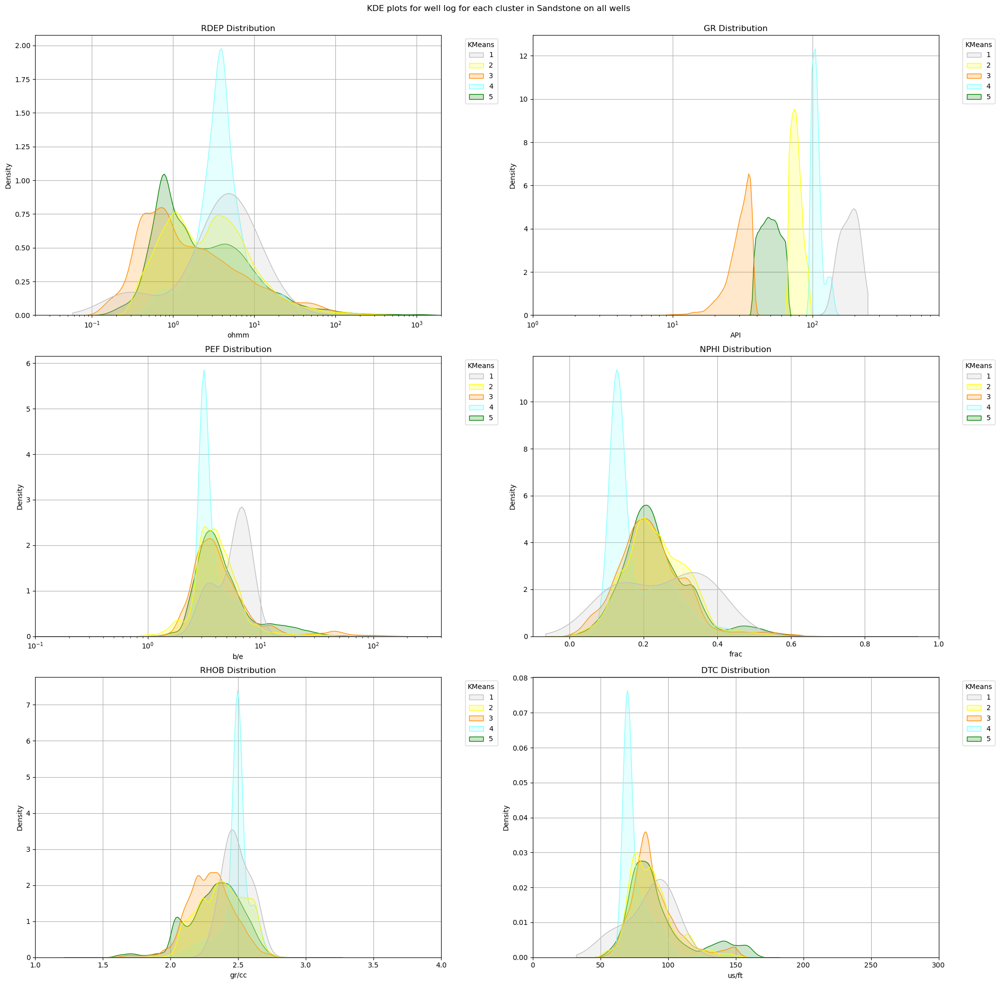

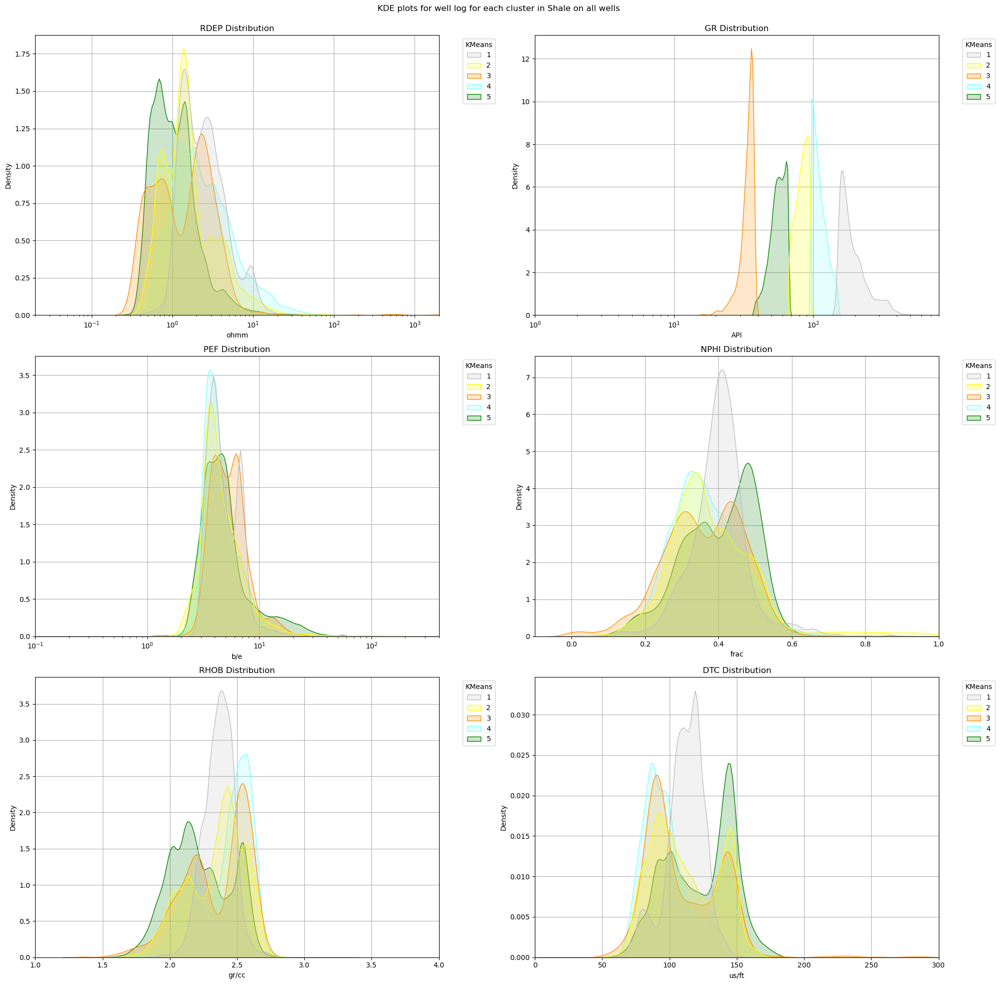

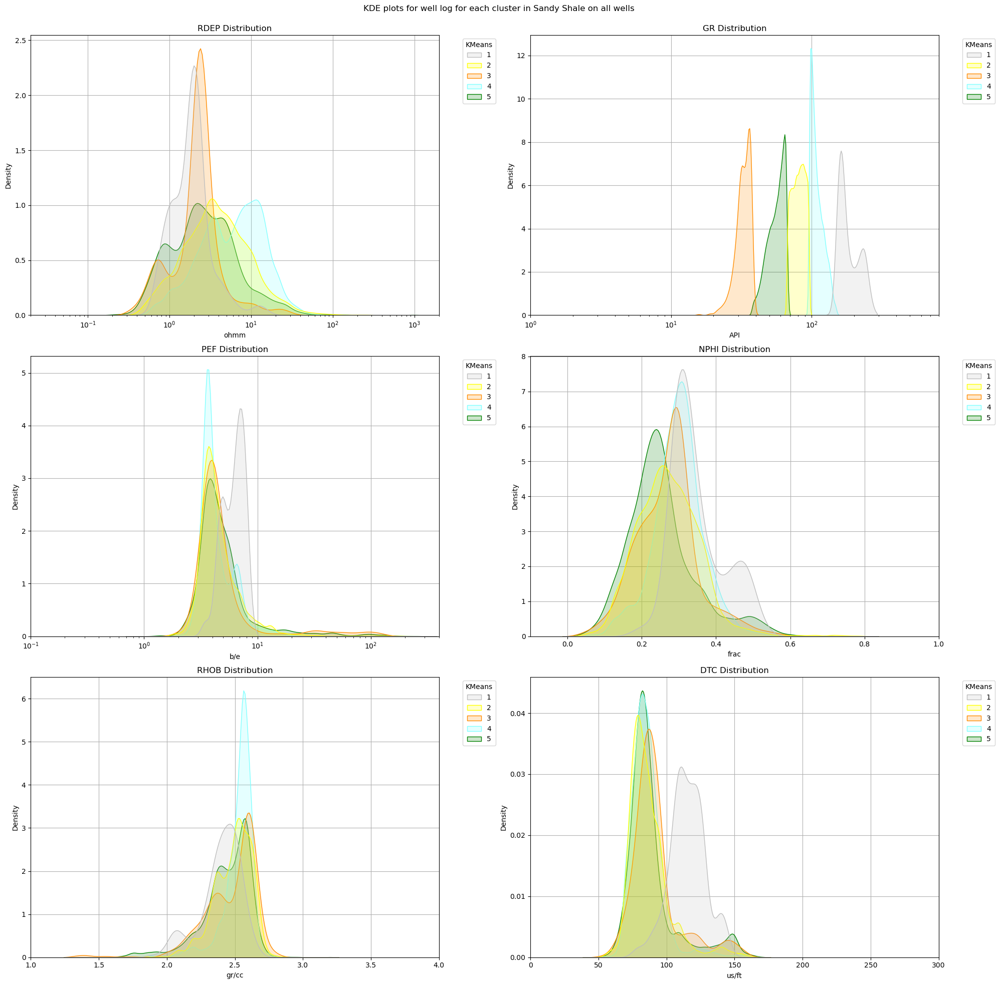

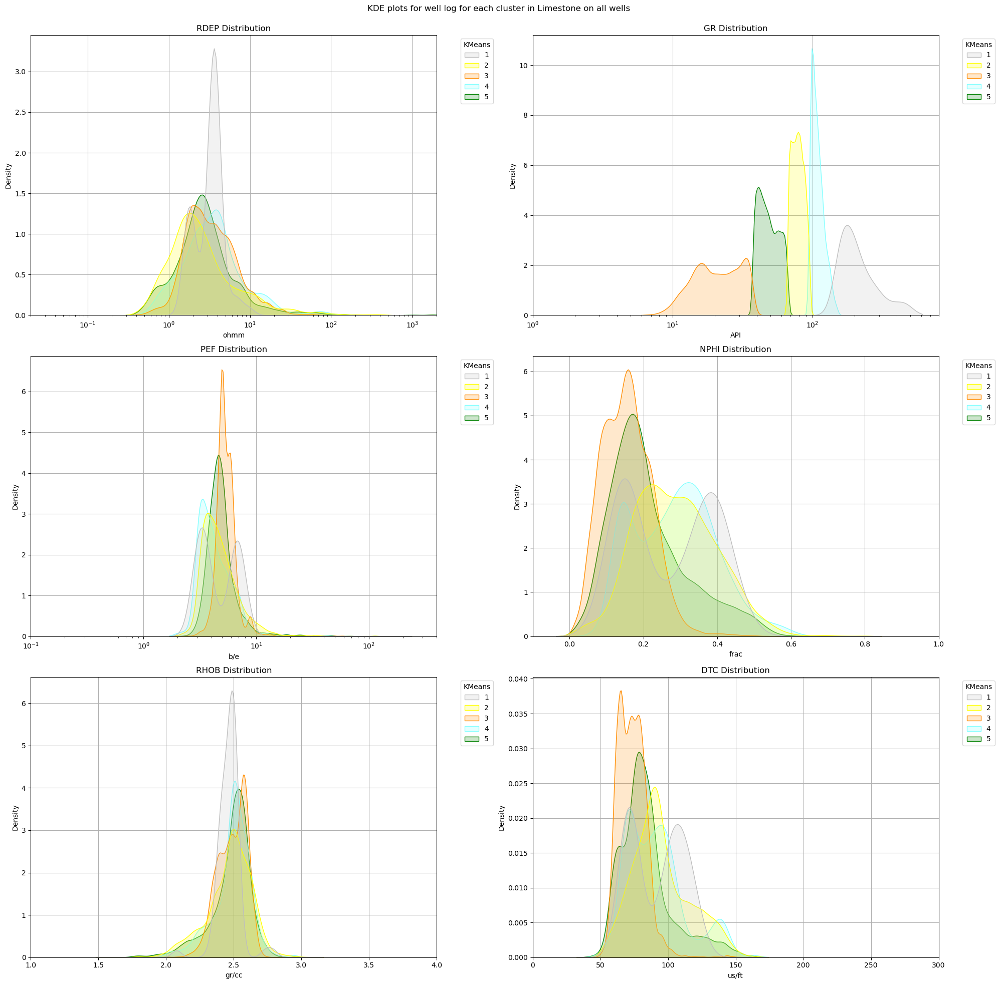

C:\Users\V330\AppData\Local\Temp\ipykernel_1728\1227055698.py:16: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
C:\Users\V330\AppData\Local\Temp\ipykernel_1728\1227055698.py:27: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
C:\Users\V330\AppData\Local\Temp\ipykernel_1728\1227055698.py:38: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=featur

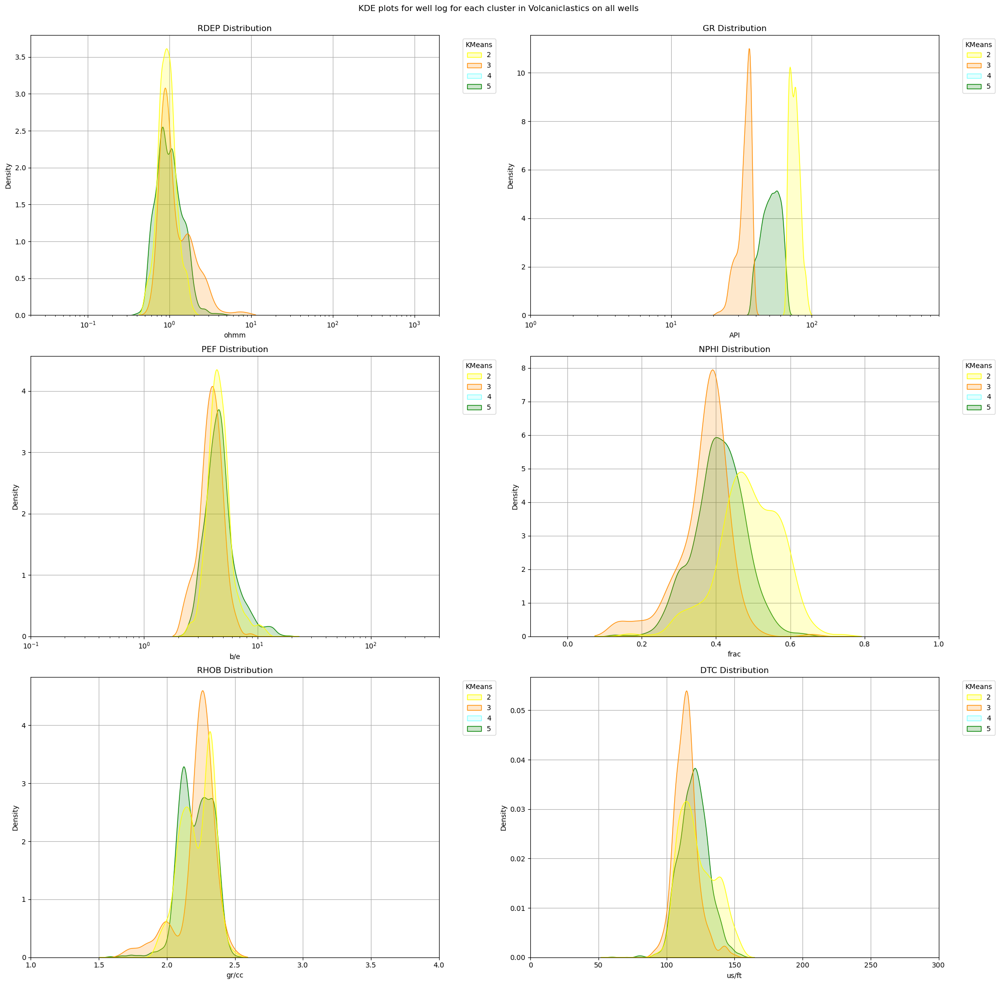

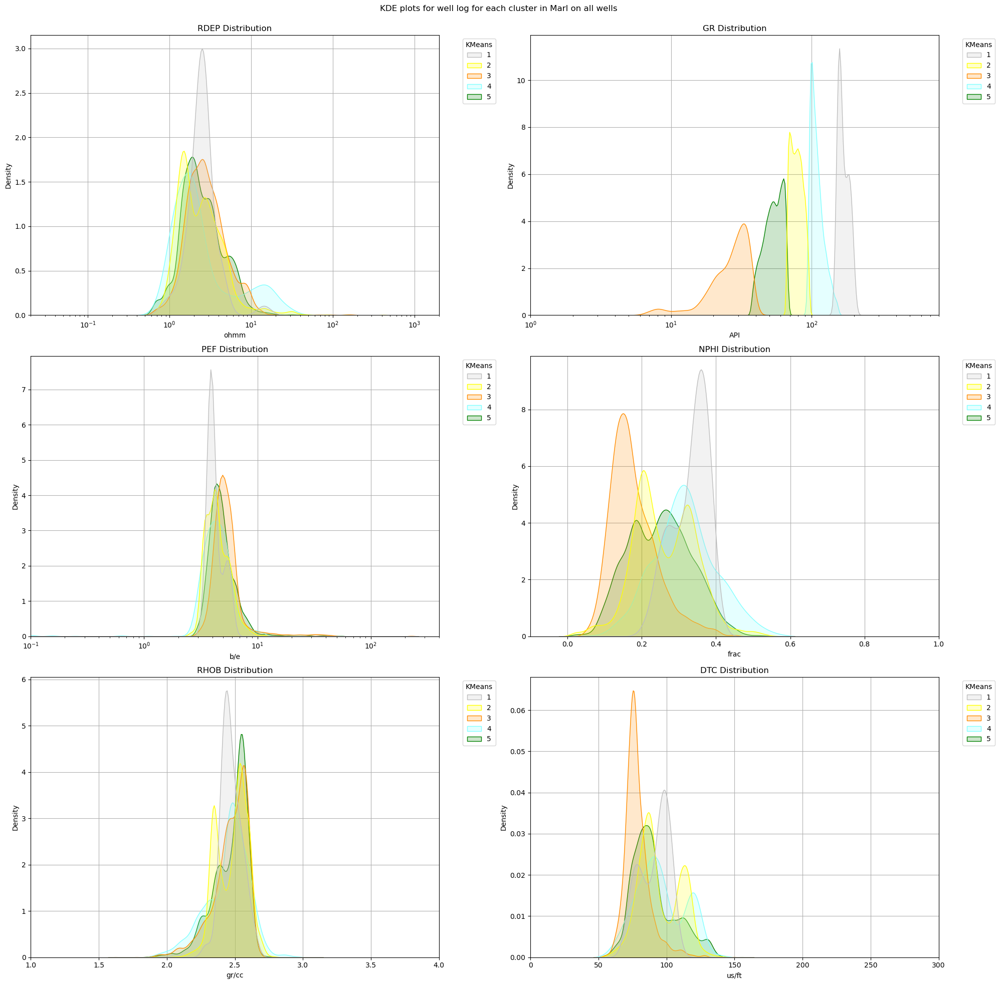

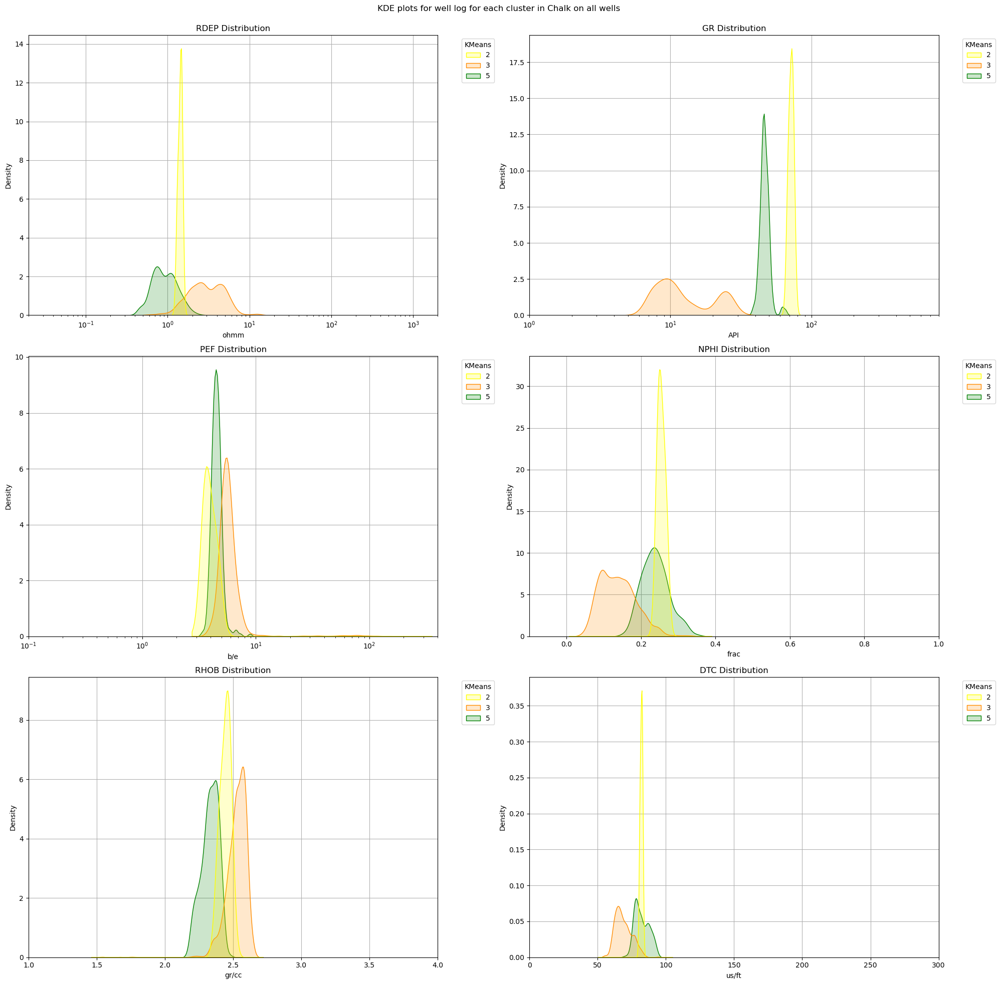

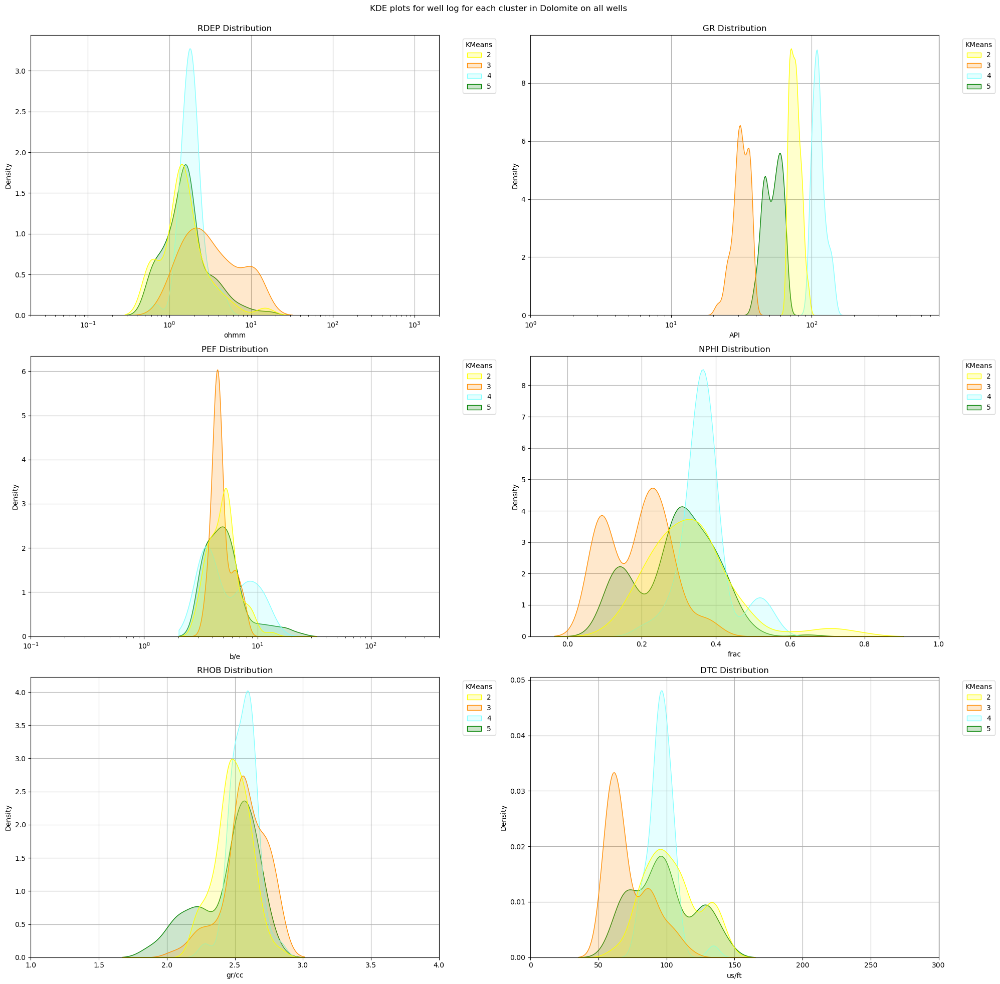

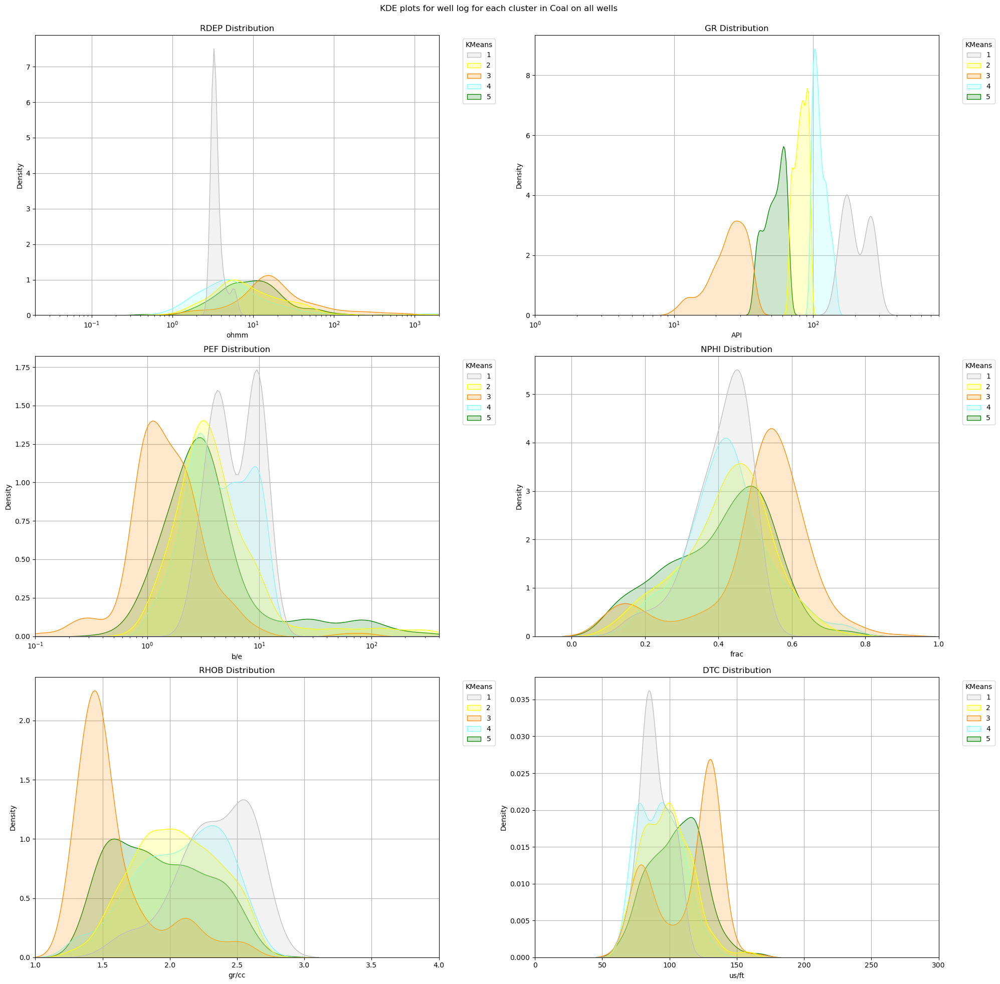

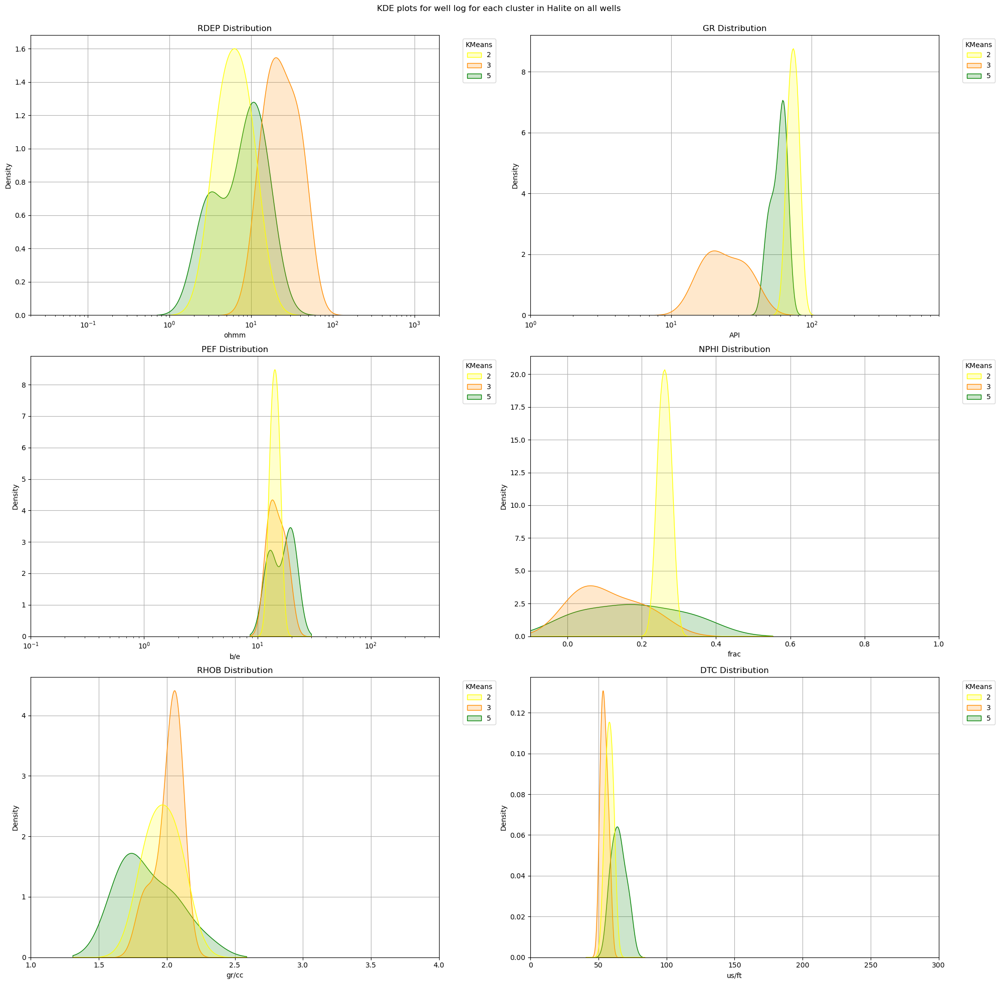

C:\Users\V330\AppData\Local\Temp\ipykernel_1728\1227055698.py:16: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
C:\Users\V330\AppData\Local\Temp\ipykernel_1728\1227055698.py:27: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
C:\Users\V330\AppData\Local\Temp\ipykernel_1728\1227055698.py:38: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=featur

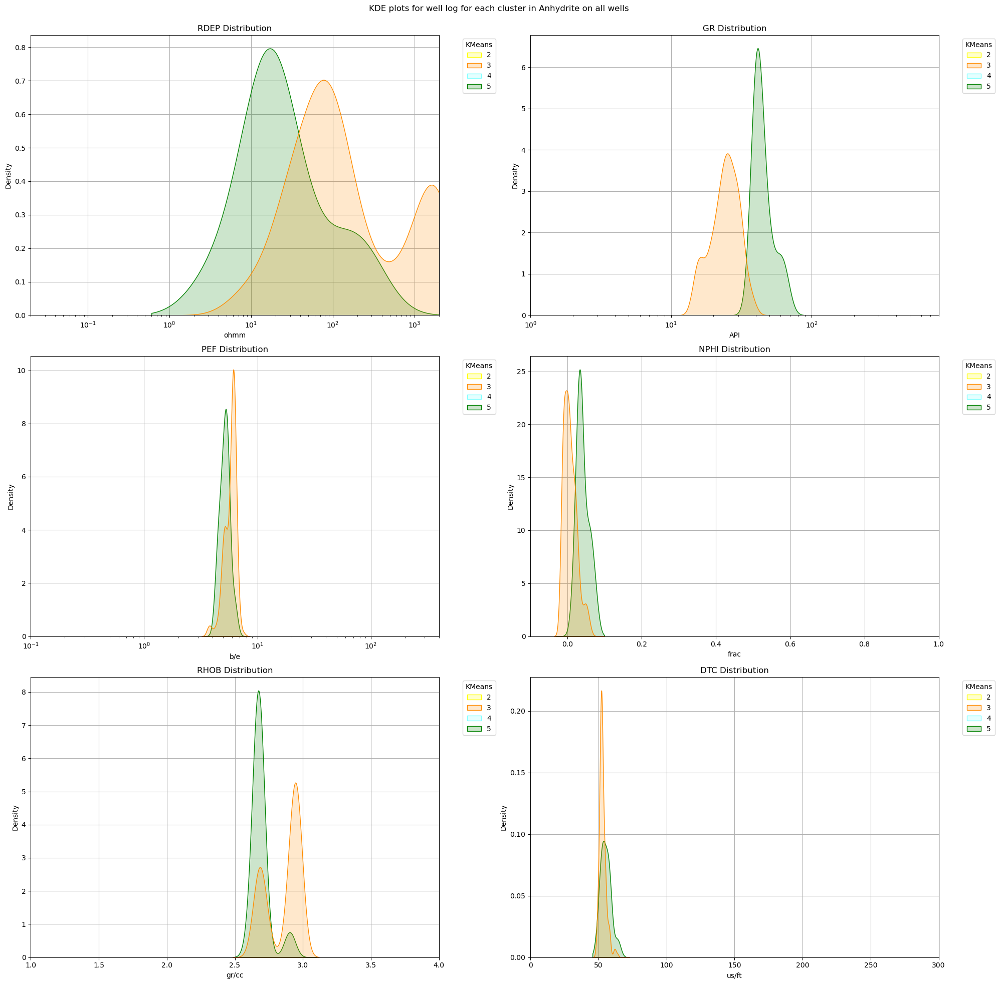

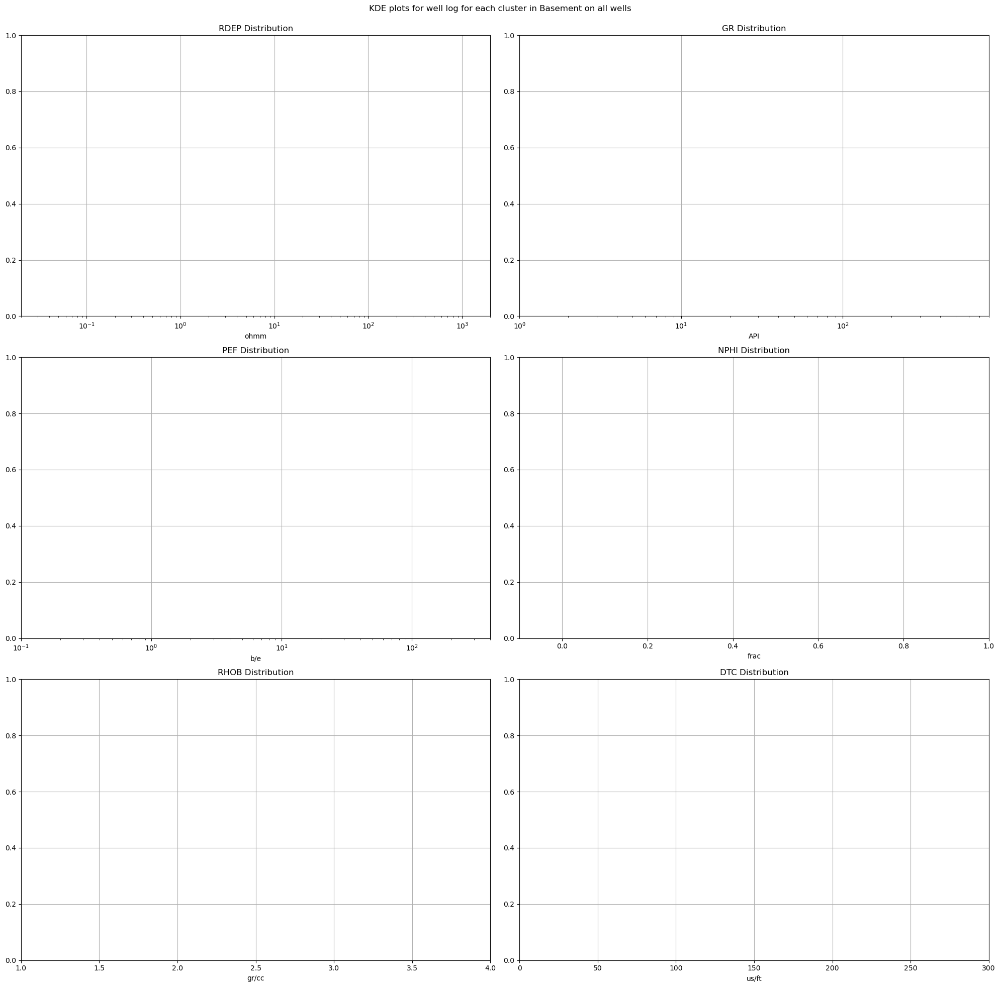

In [148]:
# KDE plots for each lithology group, cluster KMeans hue
for i, litho in enumerate(keys_lithology):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('KDE plots for well log for each cluster in '+str(litho)+ ' on all wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
        
        if i==0:
            #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=False ,grid=True)
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
            ax.set_xlim(0.02, 2000)
            
        elif i==1:
            #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(1),np.log10(1000),40), ax=ax, legend=False ,grid=True)
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('API')
            ax.set_xlim(1, 800)
            
        elif i==2:
            #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(1),np.log10(1000),40), ax=ax, legend=False ,grid=True)
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
            ax.set_xlim(0.1, 400)
        elif i==3:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
            ax.set_xlim(-0.1, 1)
        elif i==4:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
            ax.set_xlim(1, 4)
            
        #elif i==5:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            #if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                #pass
            #else:
                #ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
                #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
            #ax.set_xlim(-500, 500)
            
        else:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')
            ax.set_xlim(0, 300)
            
        ax.grid()
    
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.95)#plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('kdewelllogkmeans_'+str(litho)+'_mergedata_old.png', bbox_inches='tight')
    plt.show()

## Logplot

The well log display will be created in triple-combo style in matplotlib to visualize the curves. The template will be incorporated into **triple_combo_plot** function, so it can be used depending on the selection of top and bottom depths of the graph.

The triple combo display will consists of:

- First track: Gamma Ray - Spectral Gamma Ray, Caliper, Bit size, SP
- Second track: Resistivities
- Third track: Density, Neutron, PEF
- Fourth track: Sonic (Compressional and Shear)
- Fifth track: Lithology log labels
- Sixth track: Clustering results


### Lithology labels


In [149]:
well_clustered['LITHOLOGY'].unique()

array([30000, 65000, 65030, 70000, 99000, 80000, 70032, 74000, 90000,
       88000, 86000], dtype=int64)

In [150]:
lithology_numbers = {30000: {'lith':'Sandstone', 'lith_num':1, 'hatch': '', 'color':'#ffff00'},
                 65030: {'lith':'Sandy Shale', 'lith_num':2, 'hatch':'', 'color':'#c1f80a'},
                 65000: {'lith':'Shale', 'lith_num':3, 'hatch':'', 'color':'#bebebe'},
                 80000: {'lith':'Marl', 'lith_num':4, 'hatch':'', 'color':'#069af3'},
                 74000: {'lith':'Dolomite', 'lith_num':5, 'hatch':'', 'color':'#8080ff'},
                 70000: {'lith':'Limestone', 'lith_num':6, 'hatch':'', 'color':'#80ffff'},
                 70032: {'lith':'Chalk', 'lith_num':7, 'hatch':'', 'color':'#7bc8f6'},
                 88000: {'lith':'Halite', 'lith_num':8, 'hatch':'', 'color':'#7ddfbe'},
                 86000: {'lith':'Anhydrite', 'lith_num':9, 'hatch':'', 'color':'#ff80ff'},
                 99000: {'lith':'Volcaniclastics', 'lith_num':10, 'hatch':'', 'color':'#ff8c00'},
                 90000: {'lith':'Coal', 'lith_num':11, 'hatch':'', 'color':'black'},
                 93000: {'lith':'Basement', 'lith_num':12, 'hatch':'', 'color':'#ef138a'}}

df_lith = pd.DataFrame.from_dict(lithology_numbers, orient='index')
df_lith.index.name = 'LITHOLOGY'
df_lith

,lith,lith_num,hatch,color
LITHOLOGY,,,,
30000,Sandstone,1,,#ffff00
65030,Sandy Shale,2,,#c1f80a
65000,Shale,3,,#bebebe
80000,Marl,4,,#069af3
74000,Dolomite,5,,#8080ff
70000,Limestone,6,,#80ffff
70032,Chalk,7,,#7bc8f6
88000,Halite,8,,#7ddfbe
86000,Anhydrite,9,,#ff80ff


In [151]:
lith_code = dict(zip(df_lith.lith, df_lith.lith_num))
lith_colors = list(df_lith.color)
lith_cmap = ListedColormap(lith_colors)
lith_hatches = df_lith.hatch.to_list()

In [152]:
print(lith_code)
print(lith_colors)
#print(lith_cmap)
print(lith_hatches)

{'Sandstone': 1, 'Sandy Shale': 2, 'Shale': 3, 'Marl': 4, 'Dolomite': 5, 'Limestone': 6, 'Chalk': 7, 'Halite': 8, 'Anhydrite': 9, 'Volcaniclastics': 10, 'Coal': 11, 'Basement': 12}
['#ffff00', '#c1f80a', '#bebebe', '#069af3', '#8080ff', '#80ffff', '#7bc8f6', '#7ddfbe', '#ff80ff', '#ff8c00', 'black', '#ef138a']
['', '', '', '', '', '', '', '', '', '', '', '']


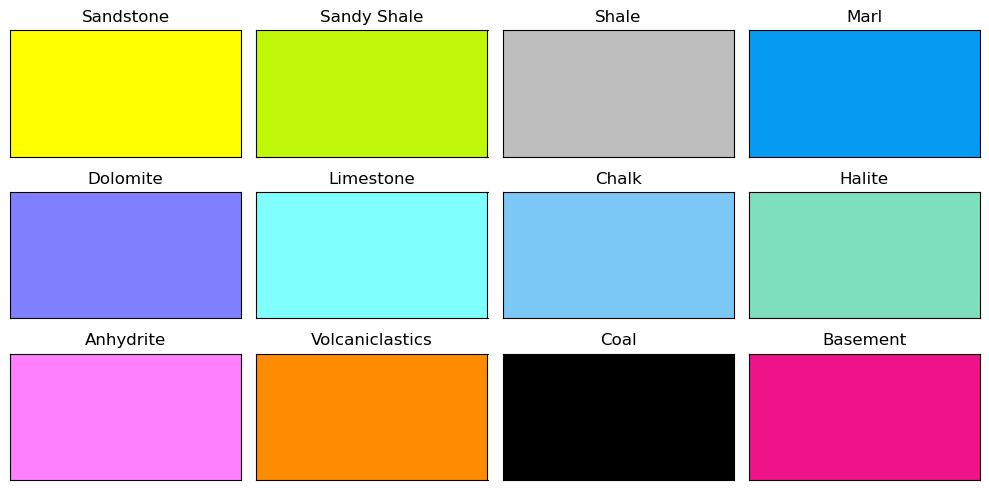

In [153]:
y = [0, 1]
x = [1, 1]

fig, axes = plt.subplots(ncols=4,nrows=3, sharex=True, sharey=True,
                         figsize=(10,5), subplot_kw={'xticks': [], 'yticks': []})

for ax, key in zip(axes.flat, lithology_numbers.keys()):
    ax.plot(x, y)
    ax.fill_betweenx(y, 0, 1, facecolor=lithology_numbers[key]['color'], hatch=lithology_numbers[key]['hatch'])
    ax.set_xlim(0, 0.1)
    ax.set_ylim(0, 1)
    ax.set_title(str(lithology_numbers[key]['lith']))

plt.tight_layout()

plt.show()

### Cluster labels


In [154]:
well_clustered['KMeans'].unique()

array([5, 2, 3, 4, 1], dtype=int64)

In [155]:
kmeans_numbers = {1: {'kmeans_num':1, 'hatch': '', 'color':'#bebebe'},
                 2: {'kmeans_num':2, 'hatch':'', 'color':'#ffff00'},
                 3: {'kmeans_num':3, 'hatch':'', 'color':'#ff8c00'},
                 4: {'kmeans_num':4, 'hatch':'', 'color':'#80ffff'},
                 5: {'kmeans_num':5, 'hatch':'', 'color':'#008100'}}

df_kmeans = pd.DataFrame.from_dict(kmeans_numbers, orient='index')
df_kmeans.index.name = 'KMeans'
df_kmeans

,kmeans_num,hatch,color
KMeans,,,
1,1,,#bebebe
2,2,,#ffff00
3,3,,#ff8c00
4,4,,#80ffff
5,5,,#008100


In [156]:
kmeans_code = dict(zip(df_kmeans.index, df_kmeans.kmeans_num))
kmeans_colors = list(df_kmeans.color)
kmeans_cmap = ListedColormap(kmeans_colors)
kmeans_hatches = df_kmeans.hatch.to_list()

In [157]:
print(kmeans_code)
print(kmeans_colors)
#print(kmeans_cmap)
print(kmeans_hatches)

{1: 1, 2: 2, 3: 3, 4: 4, 5: 5}
['#bebebe', '#ffff00', '#ff8c00', '#80ffff', '#008100']
['', '', '', '', '']


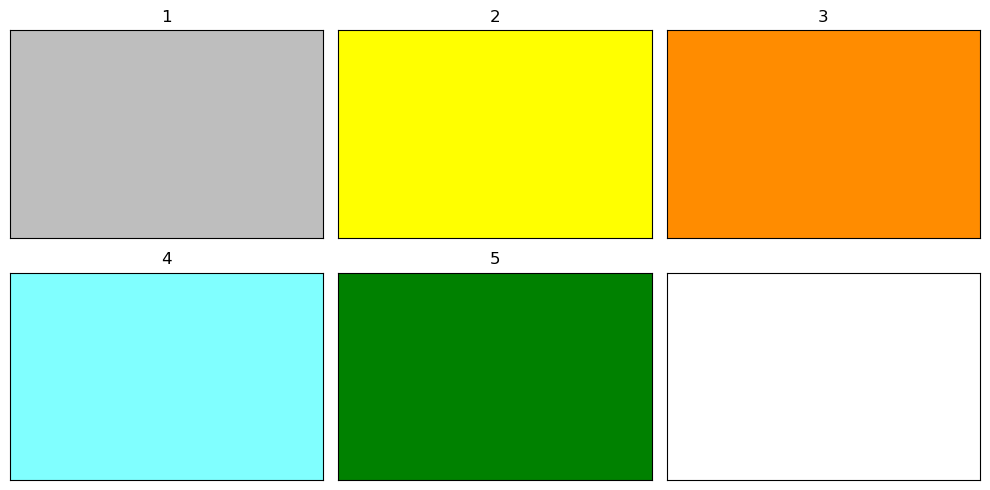

In [158]:
y = [0, 1]
x = [1, 1]

fig, axes = plt.subplots(ncols=3,nrows=2, sharex=True, sharey=True,
                         figsize=(10,5), subplot_kw={'xticks': [], 'yticks': []})

for ax, key in zip(axes.flat, kmeans_numbers.keys()):
    ax.plot(x, y)
    ax.fill_betweenx(y, 0, 1, facecolor=kmeans_numbers[key]['color'], hatch=kmeans_numbers[key]['hatch'])
    ax.set_xlim(0, 0.1)
    ax.set_ylim(0, 1)
    ax.set_title(str(kmeans_numbers[key]['kmeans_num']))

plt.tight_layout()

plt.show()

### Plotting


In [159]:
def triple_combo_plot(well_name, top_depth, bottom_depth):
    #Set well data
    well_data = well_clustered[well_clustered['WELL'] == well_name]
    logs=well_data[(well_data.DEPTH >= top_depth) & (well_data.DEPTH <= bottom_depth)]

    #Set plot axes
    fig, ax = plt.subplots(1,6, figsize=(24,48), sharey=True)
    fig.suptitle("Well " + str(well_name) + " Composite on all interval", fontsize=22, va='baseline', y=1)
    fig.subplots_adjust(wspace=0.1)

    #General setting
    for axes in ax:
        axes.set_ylim(top_depth, bottom_depth)
        axes.invert_yaxis()
        axes.yaxis.grid(True, which='both')
        axes.get_yaxis().set_minor_locator(matplotlib.ticker.LogLocator())
        axes.get_xaxis().set_visible(False)
        axes.get_yaxis().set_visible(True)

        
    ## Track 1
    #Gamma Ray -- Main track
    ax11 = ax[0].twiny()
    ax11.plot("GR","DEPTH", data=logs, color="green")
    ax11.set_xlim(0, 250)
    ax11.set_xlabel("GR (API)", position='top',color='green')
    ax11.spines["top"].set_position(("outward", 5))
    ax11.spines["top"].set_edgecolor("green")
    ax11.tick_params(axis='x', colors="green")
    ax11.grid(True)

    #Caliper
    if logs['CALI'].count()==0:
        pass
    else:
        ax12 = ax[0].twiny()
        ax12.plot("CALI","DEPTH",'--', data=logs, color="black")
        ax12.set_xlim(6, 36)
        ax12.set_xlabel("CALI (inch)", position='top',color='black')
        ax12.spines["top"].set_position(("outward", 35))
        ax12.spines["top"].set_edgecolor("black")
        ax12.tick_params(axis='x', colors="black")
        ax12.set_xticks([6, 12, 18, 24, 30, 36])

    '''
    #SP
    if logs['SP'].count()==0:
        pass
    else:
        ax13 = ax[0].twiny()
        ax13.plot("SP","DEPTH", data=logs, color="blue")
        ax13.set_xlim(-600, 500)
        ax13.set_xlabel("SP (mV)", position='top',color='blue')
        ax13.spines["top"].set_position(("outward", 65))
        ax13.spines["top"].set_edgecolor("blue")
        ax13.tick_params(axis='x', colors="blue")
        ax13.set_xticks([-200, -100, 0, 100, 200])
    '''

    ##Track 2
    #Deep resistivity -- Main track
    ax21=ax[1].twiny()
    ax21.plot("RDEP","DEPTH", data=logs, color="red")
    ax21.set_xlim(0.2, 2000)
    ax21.set_xlabel("RDEP (ohmm)", position='top',color='red')
    ax21.set_xscale('log')
    ax21.spines["top"].set_position(("outward", 5))
    ax21.spines["top"].set_edgecolor("red")
    ax21.tick_params(axis='x', colors="red")
    ax21.set_xticks([0.2, 2, 20, 200, 2000])
    ax21.get_xaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
    ax21.grid(True, which='both')
        
        
    ##Track 3
    #Density -- Main track
    ax31=ax[2].twiny()
    ax31.plot("RHOB","DEPTH", data=logs, color="red")
    ax31.set_xlim(1.95, 2.95)
    ax31.set_xlabel("RHOB (g/cm3)", position='top',color='red')
    ax31.spines["top"].set_position(("outward", 5))
    ax31.spines["top"].set_edgecolor("red")
    ax31.tick_params(axis='x', colors="red")
    ax31.set_xticks([1.95, 2.2, 2.45, 2.7, 2.95])
    ax31.grid(True)
        
    #Neutron
    ax32=ax[2].twiny()
    ax32.plot("NPHI","DEPTH", data=logs, color="green")
    ax32.set_xlim(-0.15, 0.45)
    ax32.invert_xaxis()
    ax32.set_xlabel("NPHI (frac)", position='top',color='green')
    ax32.spines["top"].set_position(("outward", 35))
    ax32.spines["top"].set_edgecolor("green")
    ax32.tick_params(axis='x', colors="green")
    ax32.set_xticks([-0.15, 0, 0.15, 0.30, 0.45])

    #PEF
    if logs['PEF'].count()==0:
        pass
    else:
        ax33=ax[2].twiny()
        ax33.plot("PEF","DEPTH", data=logs, color="purple")
        ax33.set_xlim(0, 20)
        ax33.set_xlabel("PEF (b/e)", position='top',color='purple')
        ax33.spines["top"].set_position(("outward", 65))
        ax33.spines["top"].set_edgecolor("purple")
        ax33.tick_params(axis='x', colors="purple")
        #ax33.set_xticks([140, 120, 100, 80, 60, 40])
        
        
    ##Track 4
    #Sonic compressional
    ax41=ax[3].twiny()
    ax41.plot("DTC","DEPTH", data=logs, color="purple")
    ax41.set_xlim(240, 40)
    ax41.set_xlabel("DTC (us/ft)", position='top',color='purple')
    ax41.spines["top"].set_position(("outward", 5))
    ax41.spines["top"].set_edgecolor("purple")
    ax41.tick_params(axis='x', colors="purple")
    #ax41.set_xticks([140, 120, 100, 80, 60, 40])
    ax41.grid(True)
    
        
    #Track 5
    ##Lithology log
    if logs['LIT'].count()==0:
        pass
    else:
        ax51=ax[4].twiny()
        #ax51.plot("LITHOLOGY","DEPTH", data=logs,  color = 'black', linewidth = 0.5)
        lithcode_values = logs['LIT'][:-1].map(lith_code).fillna(2).to_numpy(dtype=int)
        polycollection = ax51.pcolor( [0, 1], logs['DEPTH'], lithcode_values.reshape(-1, 1), cmap=lith_cmap, vmin=1, vmax=len(lith_colors))
        #ax51.set_xlim(0, 1)
        ax51.set_xlabel("LITHOLOGY", position='top',color='black')
        ax51.spines["top"].set_position(("outward", 0))
        ax51.spines["top"].set_edgecolor("black")
        ax51.tick_params(axis='x', colors="black")
        ax51.set_xticks([0, 1])
        
        for path, d2_val in zip(polycollection.get_paths(), lithcode_values):
            hatch = lith_hatches[d2_val - 1]
            if hatch != '':
                ax51.add_patch(PathPatch(path, hatch=hatch, facecolor='none', edgecolor='black'))

        hands = [Patch(facecolor=col, label=k, edgecolor='black') 
                 for k, col in zip(lith_code.keys(), lith_colors)]
        ax51.legend(handles=hands, bbox_to_anchor=(0.5, 1.05), loc='upper center', ncol=2, fontsize=12, facecolor=None)

    
    #Track 6
    ##KMeans log
    if logs['KMeans'].count()==0:
        pass
    else:
        ax61=ax[5].twiny()
        #ax51.plot("LITHOLOGY","DEPTH", data=logs,  color = 'black', linewidth = 0.5)
        #kmeanscode_values = logs['KMeans'][:-1].map(kmeans_code).fillna(2).to_numpy(dtype=int)
        kmeanscode_values = logs['KMeans'][:-1].map(kmeans_code).to_numpy()
        polycollection2 = ax61.pcolor( [0, 1], logs['DEPTH'], kmeanscode_values.reshape(-1, 1), cmap=kmeans_cmap, vmin=1, vmax=len(kmeans_colors))
        #ax51.set_xlim(0, 1)
        ax61.set_xlabel("KMeans Clusters", position='top',color='black')
        ax61.spines["top"].set_position(("outward", 0))
        ax61.spines["top"].set_edgecolor("black")
        ax61.tick_params(axis='x', colors="black")
        ax61.set_xticks([0, 1])
        
        for path, d2_val in zip(polycollection2.get_paths(), kmeanscode_values):
            hatch = kmeans_hatches[d2_val - 1]
            if hatch != '':
                ax61.add_patch(PathPatch(path, hatch=hatch, facecolor='none', edgecolor='black'))

        hands2 = [Patch(facecolor=col, label=k, edgecolor='black') 
                 for k, col in zip(kmeans_code.keys(), kmeans_colors)]
        ax61.legend(handles=hands2, bbox_to_anchor=(0.5, 1.04), loc='upper center', ncol=2, fontsize=14, facecolor=None)
    
    '''
    #Track 7
    ##GMM log
    if logs['GMM'].count()==0:
        pass
    else:
        ax71=ax[6].twiny()
        #ax51.plot("LITHOLOGY","DEPTH", data=logs,  color = 'black', linewidth = 0.5)
        #kmeanscode_values = logs['KMeans'][:-1].map(kmeans_code).fillna(2).to_numpy(dtype=int)
        gmmcode_values = logs['GMM'][:-1].map(kmeans_code).to_numpy()
        polycollection3 = ax71.pcolor( [0, 1], logs['DEPTH'], gmmcode_values.reshape(-1, 1), cmap=kmeans_cmap, vmin=1, vmax=len(kmeans_colors))
        #ax51.set_xlim(0, 1)
        ax71.set_xlabel("GMM Clusters", position='top',color='black')
        ax71.spines["top"].set_position(("outward", 0))
        ax71.spines["top"].set_edgecolor("black")
        ax71.tick_params(axis='x', colors="black")
        ax71.set_xticks([0, 1])
        
        for path, d2_val in zip(polycollection3.get_paths(), gmmcode_values):
            hatch = kmeans_hatches[d2_val - 1]
            if hatch != '':
                ax71.add_patch(PathPatch(path, hatch=hatch, facecolor='none', edgecolor='black'))

        hands2 = [Patch(facecolor=col, label=k, edgecolor='black') 
                 for k, col in zip(kmeans_code.keys(), kmeans_colors)]
        ax71.legend(handles=hands2, bbox_to_anchor=(0.5, 1.04), loc='upper center', ncol=2, fontsize=14, facecolor=None)
    '''
               
    fig.tight_layout()

In [160]:
well_clustered['WELL'].unique()

array(['15/9-13', '15/9-15', '15/9-17', '16/1-6 A', '16/10-1', '16/10-2',
       '16/10-3', '16/10-5', '16/2-11 A', '16/2-16', '16/2-6', '16/4-1',
       '16/5-3', '16/7-5', '25/11-19 S', '25/2-13 T4', '25/2-14',
       '25/2-7', '25/3-1', '25/4-5', '25/5-1', '25/5-4', '25/8-5 S',
       '25/8-7', '25/9-1', '26/4-1', '29/6-1', '30/3-5 S', '30/6-5',
       '31/2-19 S', '31/2-7', '31/2-8', '31/2-9', '31/3-2', '31/3-4',
       '31/4-5', '32/2-1', '33/6-3 S', '33/9-17', '34/10-21', '34/10-35',
       '34/11-2 S', '34/12-1', '34/2-4', '34/3-1 A', '34/4-10 R',
       '34/5-1 A', '34/5-1 S', '34/7-21', '34/8-1', '35/11-1', '35/11-11',
       '35/11-12', '35/11-13', '35/11-15 S', '35/11-6', '35/11-7',
       '35/12-1', '35/3-7 S', '35/4-1', '35/8-6 S', '35/9-10 S', '35/9-5',
       '35/9-6 S', '36/7-3', '7/1-2 S', '15/9-23', '16/2-7', '16/7-6',
       '25/10-9', '31/2-10', '31/2-21 S', '34/3-2 S', '35/11-5', '35/9-7'],
      dtype=object)

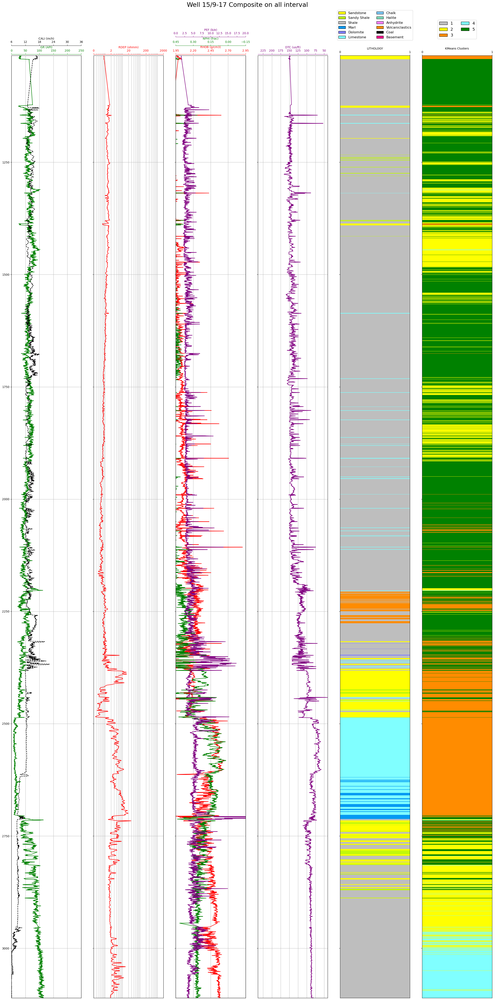

In [161]:
#Display logs for the whole well
triple_combo_plot('15/9-17',well_clustered[well_clustered['WELL'] == '15/9-17'].DEPTH.min(),well_clustered[well_clustered['WELL'] == '15/9-17'].DEPTH.max())

In [164]:
#Display logs for the whole well
for i, wellname in enumerate (well_clustered['WELL'].unique()):
    well_plot = triple_combo_plot(wellname,well_clustered[well_clustered['WELL'] == wellname].DEPTH.min(),well_clustered[well_clustered['WELL'] == wellname].DEPTH.max())
    well_name = wellname.replace('/', '-')
    plt.savefig('../improving-lithology-label-well-logs/Clustered well plot/Stratigraphy_old/01 All well/Composite_clustered_well_{}.png'.format(well_name),bbox_inches='tight')
    plt.close()

## Crossplots (not used)


In [ ]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection="3d")

ax.scatter(well_ex["NPHI"], well_ex["RHOB"], well_ex["DTC"], c=well_ex['GR'], cmap='rainbow')
ax.set_xlabel('NPHI')
ax.set_ylabel('RHOB')
ax.set_zlabel('DT')

plt.show()

In [ ]:
fig = go.Figure(data=[go.Scatter3d(
    x=well_ex["NPHI"],
    y=well_ex["RHOB"],
    z=well_ex["DTC"],
    mode='markers',
    marker=dict(
        size=8,
        color=well_ex["GR"],                # set color to an array/list of desired values
        opacity=0.8
    )
)])

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

In [ ]:
fig = plt.figure(figsize=(10, 10), layout="constrained")
spec = fig.add_gridspec(ncols=2, nrows=2)

ax1 = fig.add_subplot(spec[0, 0])
ax1.scatter(x= "NPHI", y= "RHOB", c = 'GR', data= well_ex, vmin)
ax1.set_ylim(3, 1)
ax1.set_ylabel("RHOB (g/cc)")
ax1.set_xlabel("NPHI (dec)")
ax1.grid(True)

ax2 = fig.add_subplot(spec[1, 0])
ax2.scatter(x= "NPHI", y= "DTC", c = 'GR', data= well_ex)
ax1.set_ylim(3, 1)
ax2.set_ylabel("DT (us/ft)")
ax2.set_xlabel("NPHI (dec)")
ax2.grid(True)

ax3 = fig.add_subplot(spec[0, 1])
ax3.scatter(x= "DTC", y= "RHOB", c = 'GR', data= well_ex)
ax3.set_ylim(3, 1)
ax3.set_ylabel("RHOB (g/cc)")
ax3.set_xlabel("DT (us/ft)")
ax3.grid(True)

ax4 = fig.add_subplot(spec[1, 1])
ax4.scatter(x= "GR", y= "DTC", data= well_ex)
ax4.set_ylabel("DT (us/ft)")
ax4.set_xlabel("GR (API)")
ax4.grid(True)

fig.tight_layout()